In [2]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import mpl_toolkits
import pandas as pd 
import netCDF4
import os
os.environ['PROJ_LIB'] = 'C:/Users/renee/anaconda3/Lib/site-packages/mpl_toolkits/basemap'
os.environ['GMT_LIBRARY_PATH']=r'C:\Users\USERNAME\Anaconda3\envs\pygmt\Library\bin'
from mpl_toolkits.basemap import Basemap 
from mpl_toolkits.axes_grid1 import ImageGrid
from scipy.interpolate import griddata
from scipy import stats
from matplotlib.patches import Wedge
import proplot as plot
import pyproj
from astropy.time import Time 
import h5py
import numpy as np 
import matplotlib.pyplot as plt 
import pandas as pd
from netCDF4 import Dataset
from mpl_toolkits.basemap import Basemap
from itertools import chain
import sys
from scipy import interpolate
pd.options.mode.chained_assignment = None


# Say, "the default sans-serif font is COMIC SANS"
mpl.rcParams['font.sans-serif'] = "Arial"
# Then, "ALWAYS use sans-serif fonts"
mpl.rcParams['font.family'] = "sans-serif"
mpl.rcParams['axes.facecolor'] = 'white'
mpl.rcParams['figure.facecolor'] = 'white'

### Load and prep CS

In [3]:
#def load_data(path, fp):
#    nc_file = netCDF4.Dataset(path + '/' + fp, 'r')
#    sea_ice_freeboard = nc_file.variables['freeboard_20_ku'][:]
#    lat = nc_file.variables['lat_poca_20_ku'][:]
#    lon = nc_file.variables['lon_poca_20_ku'][:]
    
#    return  lon, lat, sea_ice_freeboard

def get_valid_freeboard_flag(flag): 
    """
    flag_masks = 1, 2, 4, 8, 16, 32, 64, 128, 256, 512, 1024, 2048, 4096, 8192, 16384, 32768, 65536, 131072, 262144, 524288, 1048576, 2097152, 4194304, 8388608, 16777216, 33554432, 67108864, 134217728, 268435456; // int 
    
    removed flags in dict_error: 
    #        'sarin_bad_velocity'       : 2,
    #        'sarin_out_of_range'       : 4,
    #        'sarin_bad_baseline'       : 8,
    #        'delta_time_error'         :32,
    #        'mispointing_error'        :64,
    #        'sarin_height_ambiguous'   :2048,
    
    """

    dict_error= {
        'calibration_warning'      : 1,
        'sarin_bad_velocity'       : 2,
        'sarin_out_of_range'       : 4,
        'sarin_bad_baseline'       : 8,
        'delta_time_error'         :32,
        'mispointing_error'        :64,
        'sarin_side_redundant'     :256,
        'sarin_rx_2_error'         :512,
        'sarin_rx_1_error'         :1024,
        'sarin_height_ambiguous'   :2048,
        'surf_type_class_ocean'    :32768,
        'freeboard_error'          :65536,
        'peakiness_error'          :131072,
        'ssha_interp_error'        :262144,
        'orbit_discontinuity'      :33554432,
        'orbit_error'              :67108864,
        'height_sea_ice_error'     :268435456,
        }

    all_flag= {
        'calibration_warning'      : 1,
        'sarin_bad_velocity'       : 2,
        'sarin_out_of_range'       : 4,
        'sarin_bad_baseline'       : 8,
        'lrm_slope_model_invalid'  :16,
        'delta_time_error'         :32,
        'mispointing_error'        :64,
        'surface_model_unavailable':128,
        'sarin_side_redundant'     :256,
        'sarin_rx_2_error'         :512,
        'sarin_rx_1_error'         :1024,
        'sarin_height_ambiguous'   :2048,
        'surf_type_class_undefined':4096,
        'surf_type_class_sea_ice'  :8192,
        'surf_type_class_lead'     :16384,
        'surf_type_class_ocean'    :32768,
        'freeboard_error'          :65536,
        'peakiness_error'          :131072,
        'ssha_interp_error'        :262144,
        'sig0_3_error'             :524288,
        'sig0_2_error'             :1048576,
        'sig0_1_error'             :2097152,
        'height_3_error'           :4194304,
        'height_2_error'           :8388608,
        'height_1_error'           :16777216,
        'orbit_discontinuity'      :33554432,
        'orbit_error'              :67108864,
        'block_degraded'           :134217728,
        'height_sea_ice_error'     :268435456,
        }

    # sea ice class
    flag_seaice = np.bitwise_and(flag, all_flag['surf_type_class_sea_ice'])/all_flag['surf_type_class_sea_ice']

    # errors
    flag_error = np.zeros(flag.size)
    for key in dict_error.keys():
        flag0_error = np.bitwise_and(flag,dict_error[key])/dict_error[key]
        flag_error = np.logical_or(flag0_error,flag_error)

    flag_valid_fb = flag_seaice - flag_error
    flag_valid_fb[flag_valid_fb<0] =0


    return flag_valid_fb

def fit2(lat, lat2,  h, degree):
    p_fit = np.polyfit(lat, h, degree)
    p_val = np.polyval(p_fit, lat2)
    return p_val

def NN_search(df_CS2_new, df_IS2):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    query_lats = df_CS2_new[['lat']].to_numpy()
    query_lons = df_CS2_new[['lon']].to_numpy()

    tree = BallTree(np.deg2rad(df_IS2[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    distances, indices = tree.query(np.deg2rad(np.c_[query_lats, query_lons]), k=1)
    
    mss_interp = [], [], [],[]
    for i in indices:
        mss_interp = np.append(mss_interp, df_IS2['mss'][int(i)])

    return mss_interp

def load_data(fp1,fp2):
    from scipy.interpolate import interp1d, UnivariateSpline
    import datetime # Python standard library datetime module
    from netCDF4 import Dataset,num2date # http://unidata.github.io/netcdf4-python/

    ds = netCDF4.Dataset(fp1, 'r')
    
    sea_ice_freeboard = ds.variables['freeboard_20_ku'][:]
    lat = ds.variables['lat_poca_20_ku'][:]
    lon = ds.variables['lon_poca_20_ku'][:]
    time = ds.variables['time_20_ku'][:]
    flag = ds.variables[ 'flag_prod_status_20_ku'][:]
    flag_valid = get_valid_freeboard_flag(flag)
    mss = ds.variables['mean_sea_surf_sea_ice_01'][:]
    lat_01 = ds.variables['lat_01'][:]
    lon_01 = ds.variables['lon_01'][:]
    
    #mss_interp = fit2(lat_01, lat, mss, 2)
    #mss_interp = f(lon, lat)
    #f1 = interp1d(lat_01, mss, kind='cubic')
    #mss_interp = f1(lat)
    #sif_no_mss = sea_ice_freeboard # - mss_interp[0]
    
    df_1hz = pd.DataFrame({'lat':lat_01, 'lon':lon_01, 'mss':mss})
    df_20hz = pd.DataFrame({'lat':lat, 'lon':lon})
    mss_interp = NN_search(df_20hz, df_1hz)
    sif_no_mss = sea_ice_freeboard-mss_interp
    
    tname = "time_20_ku"
    nctime = ds.variables[tname][:] # get values
    t_unit = ds.variables[tname].units # get unit  "days since 1950-01-01T00:00:00Z"
    t_cal = ds.variables[tname].calendar
    tvalue = num2date(nctime,units = t_unit,calendar = t_cal)
    #str_time = [i.strftime("%Y-%m-%d %H:%M:%S") for i in tvalue] # to display dates as string
    str_time = [str(i) for i in tvalue]
    
    ds2 = netCDF4.Dataset(fp2, 'r')
    ssd =  ds2.variables['stack_std_20_ku'][:]
    pwr_waveform = ds2.variables['pwr_waveform_20_ku'][:]
    ppk = []
    #for i in pwr_waveform:
    #    calc_pp = []
    #    pp = np.max(i)/np.mean(i)
    #    ppk = np.append(ppk,pp)

    for i in pwr_waveform:
        calc_pp = []
        noise = np.nanmean(i[10:19])
        i = i[i>noise]

        pp = np.nanmax(i)/np.nanmean(i)
        ppk = np.append(ppk,pp)
    
    df = pd.DataFrame({'sif':sea_ice_freeboard, 'lat':lat, 'lon':lon, 'flag':flag_valid, 'mss':mss_interp, 'ssd':ssd, 'ppk':ppk, 'time':str_time})
    
    df = df[df['lat']>60]
    df = df[df['flag']==1]  
    df=df.reset_index(drop=True)
    
    lon_filtered = np.array(df['lon'])
    lat_filtered = np.array(df['lat'])
    fb_filtered = np.array(df['sif'])
    mss_filtered = np.array(df['mss'])
    ssd_filtered = np.array(df['ssd'])
    ppk_filtered = np.array(df['ppk'])
    time_filtered = np.array(df['time'])
    return lon_filtered, lat_filtered, fb_filtered, mss_filtered, ssd_filtered,ppk_filtered, time_filtered

    

### Read and prepare ICESat-2 data to seperate granules

In [4]:
import pyproj
from astropy.time import Time 
import h5py
import numpy as np 
import matplotlib.pyplot as plt 
import pandas as pd
from netCDF4 import Dataset
from mpl_toolkits.basemap import Basemap
from itertools import chain
import sys

def list_files_local(path):
    ''' Get file list from local folder. '''
    from glob import glob
    return glob(path)

def gps2dyr(time):
    '''Convert GPS time to decimal years'''
    return Time(time, format='gps').decimalyear

def track_type(time, lat, tmax=1):
    '''
    Separate tracks into ascending and descending. 
    
    Defines tracks as segments with time breaks > tmax , 
    and tests whether lat increases or decreases w/time.
    '''
    tracks = np.zeros(lat.shape) # generates track segment
    tracks[0:np.argmax(np.abs(lat))] = 1 # set values for segment
    i_asc = np.zeros(tracks.shape, dtype=bool) # output index array 
    
    # loop through individual segments
    for track in np.unique(tracks):
        
        i_track, = np.where(track == tracks) # get all pts from seg
        
        if len(i_track) < 2: continue
            
        # Test if lat increase (asc) or descreases (des) with time
        i_min = time[i_track].argmin()
        i_max = time[i_track].argmax()
        lat_diff = lat[i_track][i_max] - lat[i_track][i_min]
        
        # Determine track trype
        if lat_diff > 0: i_asc[i_track] = True
            
    return i_asc, np.invert(i_asc)

def transform_coord(proj1, proj2, x, y):
    '''
    Transform coordinates from proj1 to proj2 (EPSG num). 
    
    Example EPSG projs: 
        Geodetic (lon/lat): 4326
        Polar Stereo AnIS (x/y): 3031
        Polar Stereo GrIS (x/y): 3413
    '''
    # Set full EPSG projection strings 
    proj1 = pyproj.Proj("+init=EPSG:"+str(proj1))
    proj2 = pyproj.Proj("+init=EPSG:"+str(proj2))
    return pyproj.transform(proj1, proj2, x, y)  # convert

def read_h5(fname, vnames=[]):
    '''Simple HDF5 reader'''
    with h5py.File(fname, 'r') as f:
        return [f[v][:] for v in vnames]

### Simple reader

In [5]:
def read_data(fname, bbox=None):
    '''
    Read ATL03 data file and output 6 reduced files. 
    
    Extract variables of interest and separate the ATL03 file
    into each beam (ground track) and ascending/descending orbits. 
    '''
    
    # Each beam is a group 
    group = ['/gt1l', '/gt1r', '/gt2l', '/gt2r', '/gt3l', '/gt3r']
    
    # Loop through beams
    for k,g in enumerate(group):
    
        #-----------------------------------#
        # 1) Read in data for a single beam #
        #-----------------------------------#
    
        # Load variables into memory (more can be added!)
        with h5py.File(fname, 'r') as fi:
            #sc = fi['/orbit_info/sc_orient'][:]
            
            #if sc == 1:
            #    g = ['/gt3r', '/gt3l', '/gtl2r', '/gt2l', '/gt1r', '/gt1l']   
                
            lat_fb = fi[g+ '/freeboard_beam_segment/beam_freeboard/latitude'][:]
            lon_fb = fi[g+ '/freeboard_beam_segment/beam_freeboard/longitude'][:]
            fb = fi[g+ '/freeboard_beam_segment/beam_freeboard/beam_fb_height'][:]
            gw_fb = fi[g+ '/freeboard_beam_segment/height_segments/height_segment_w_gaussian'][:]
            mss = fi[g+ '/freeboard_beam_segment/geophysical/height_segment_mss'][:]
            mean_tide = fi[g+ '/freeboard_beam_segment/geophysical/height_segment_geoid_free2mean'][:]
            #SET_corr = fi[g+ '/freeboard_beam_segment/geophysical/height_segment_earth'][:]
            SET_corr = fi[g+ '/freeboard_beam_segment/geophysical/height_segment_earth_free2mean'][:]
            #mss_meantide = mss-(mean_tide+SET_corr)#+SET_corr
            mss_meantide = mss+mean_tide+SET_corr
            
            #lat_lead = fi[g+ '/leads/latitude'][:]
            #lon_lead = fi[g+ '/leads/longitude'][:]
            #orb = np.full_like(h_ph, k)
        #---------------------------------------------#
        # 2) Filter data according region and quality #
        #---------------------------------------------#
       
        # Test for no data
        #if len(lat_fb) == 0: continue

        #-------------------------------------#
        # 3) Convert time and separate tracks #
        #-------------------------------------#
        
        # Time in GPS seconds (secs since 1980...)
        #t_gps, delta_t_gps = t_ref + t_dt, t_ref + delta_t

        # Time in decimal years
        #t_year, delta_t_year = gps2dyr(t_gps), gps2dyr(delta_t_gps)

        # Determine orbit type
        #i_asc, i_des = track_type(t_year, lat)
        
        #-----------------------#
        # 4) Save selected data #
        #-----------------------#
        
        # Define output file name
        ofile = fname.replace('.h5', '_'+g[1:]+'_no_mss_corr_v5.h5')
                
        # Save variables
        with h5py.File(ofile, 'w') as f:
            #f['orbit'] = orb
            f['lon_fb'] = lon_fb
            f['lat_fb'] = lat_fb
            f['fb'] = fb - mss_meantide
            f['gw'] = gw_fb
            f['fb_with_mss'] = fb
            f['mss']=mss_meantide
            #f['lon_lead'] = lon_lead
            #f['lat_lead'] = lat_lead
            
            print('out ->', ofile)

### Preparation 

In [6]:
def plot_panArctic(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=70,lon_0=0, resolution='l',ax=ax, round=True)
    m.drawmeridians(np.arange(0,360,30),labels=[1,1,1,1],linewidth=0.5, fontsize=14, dashes=[1,5])
    m.drawparallels(np.arange(-90,90,5),linewidth=0.5, fontsize=14, dashes=[1,5])
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='gray')
    m.drawmapboundary(fill_color='black')
    x=m.scatter(lon, lat, latlon=True, c=sit, s=0.05,vmin = min_set, vmax=max_set, cmap=cmap_set)
    #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x

def plot_panArctic2(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=70,lon_0=0, resolution='l',ax=ax, round=True)
    #m.drawmeridians(np.arange(0,360,30),labels=[1,1,1,1],linewidth=0.5, fontsize=14, dashes=[1,5])
    #m.drawparallels(np.arange(-90,90,20),linewidth=0.5, fontsize=14, dashes=[1,5])
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='gray')
    m.drawmapboundary(fill_color='black')
    x=m.scatter(lon, lat, latlon=True, c=sit, s=0.05,vmin = min_set, vmax=max_set, cmap=cmap_set)
    #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x

### Prep MMS

In [7]:
def load_data2(path, fp, lon_var, lat_var, fb_var):
    nc_file = netCDF4.Dataset(path + '/' + fp, 'r')
    lon = np.array(nc_file.variables[lon_var][:], dtype=np.float32)
    lat = np.array(nc_file.variables[lat_var][:], dtype=np.float32)
    fb = np.array(nc_file.variables[fb_var][:], dtype=np.float32)
    
    return  lon, lat, fb

def prep_data(path, fp):
    lon, lat,MSS = load_data2(path, fp, 'lon', 'lat', 'mss')

    lon_mesh, lat_mesh = np.meshgrid(lon, lat)
    lat_T, lon_T, MSS_T = lat_mesh.flatten(), lon_mesh.flatten(), MSS.flatten()
    df_DTU21 = pd.DataFrame({'lat':lat_T, 'lon':lon_T, 'MSS':MSS_T})
    df_DTU21 = df_DTU21[(df_DTU21['lat']>60)].reset_index(drop=True)
    del lon, lat, MSS, lon_mesh, lat_mesh, lat_T, lon_T, MSS_T
    
    return df_DTU21

def grid_data(lat_ori, lon_ori, var_ori, ref_lat, ref_lon, method_name):
    grid_var = griddata((lon_ori.flatten(), lat_ori.flatten()), var_ori.flatten(), (ref_lon, ref_lat), method=method_name)
    
    return grid_var

In [238]:
path = r'C:\Users\rmfha\Downloads'
fp = 'DTU21MSS_1min.mss.nc'
df_DTU21 = prep_data(path, fp)

In [239]:
### GENERATE COARSER GRID (0.05 X 0.05 DEGREES)
lon = np.arange(0, 360, 0.05) 
lat = np.arange(60, 90, 0.05) 
lon2d, lat2d = np.meshgrid(lon, lat)   

### GRID DTU21MSS TO COARSER GRID
grid_DTU21 = grid_data(np.array(df_DTU21['lon']), np.array(df_DTU21['lat']), np.array(df_DTU21['MSS']), lon2d, lat2d, 'nearest')

### PREP DATAFRAME WITH DTU21MSS IN COARSER GRID
df_grid_DTU21 = pd.DataFrame({'lat':lat2d.flatten(), 'lon':lon2d.flatten(), 'MSS':grid_DTU21.flatten()})


# Load IS2 ATL10 data and prep with simple reader

In [256]:
files = !ls E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/Monthly_data/November/*_02.h5
files

['E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/Monthly_data/November/ATL10-01_20201102092337_05990901_005_02.h5',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/Monthly_data/November/ATL10-01_20201105001511_06390901_005_02.h5',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/Monthly_data/November/ATL10-01_20201105014928_06400901_005_02.h5',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/Monthly_data/November/ATL10-01_20201106060641_06580901_005_02.h5',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/Monthly_data/November/ATL10-01_20201106074058_06590901_005_02.h5',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/Monthly_data/November/ATL10-01_20201108174942_06960901_005_02.h5',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/Monthly_data/November/ATL10-01_20201108192359_06970901_005_02.h5',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/Monthly_data/November/ATL10-01_20201108223234_06990901_005_02.h5',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/Monthly_data/November/ATL10-01_20201110011530_07160901_005_02.h5',
 'E:/DTU/CRYO2ICE/Data/CRYO2

In [258]:
len(files)

40

In [295]:
njobs = 25

# bbox = [lonmin, lonmax, latmin, latmax]
bbox = [0,360, 60, 90]

if njobs == 1:
    print('running in serial ...')
    [read_data(f, bbox) for f in files]

else:
    print('running in parallel (%d jobs) ...' % njobs)
    from joblib import Parallel, delayed
    Parallel(n_jobs=njobs, verbose=5)(delayed(read_data)(f, bbox) for f in files)

running in parallel (25 jobs) ...


[Parallel(n_jobs=25)]: Using backend LokyBackend with 25 concurrent workers.
[Parallel(n_jobs=25)]: Done   9 out of  40 | elapsed:    7.5s remaining:   26.0s
[Parallel(n_jobs=25)]: Done  18 out of  40 | elapsed:   11.6s remaining:   14.2s
[Parallel(n_jobs=25)]: Done  27 out of  40 | elapsed:   11.9s remaining:    5.7s
[Parallel(n_jobs=25)]: Done  36 out of  40 | elapsed:   12.4s remaining:    1.3s
[Parallel(n_jobs=25)]: Done  40 out of  40 | elapsed:   12.5s finished


In [ ]:
len(files_check_IS2)

# Load prepared IS2 data after processed with simple-reader

In [243]:
files_check_CS2_L1b = !ls E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/CS2/Monthly_data/L1b/April/*.nc
files_check_CS2_L1b

files_check_CS2_L2 = !ls E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/CS2/Monthly_data/L2/April/*.nc
files_check_CS2_L2

files_check_IS2a = !ls E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/Monthly_data/April/*_gt1l_no_mss_corr.h5
files_check_IS2a

files_check_IS2b = !ls E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/Monthly_data/April/*_gt2l_no_mss_corr.h5
files_check_IS2b

files_check_IS2c = !ls E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/Monthly_data/April/*_gt3l_no_mss_corr.h5
files_check_IS2c

['E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/Monthly_data/April/ATL10-01_20210401235002_01251101_005_01_gt3l_no_mss_corr.h5',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/Monthly_data/April/ATL10-01_20210402012419_01261101_005_01_gt3l_no_mss_corr.h5',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/Monthly_data/April/ATL10-01_20210402025837_01271101_005_01_gt3l_no_mss_corr.h5',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/Monthly_data/April/ATL10-01_20210402043254_01281101_005_01_gt3l_no_mss_corr.h5',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/Monthly_data/April/ATL10-01_20210403040715_01431101_005_01_gt3l_no_mss_corr.h5',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/Monthly_data/April/ATL10-01_20210403054133_01441101_005_01_gt3l_no_mss_corr.h5',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/Monthly_data/April/ATL10-01_20210403071550_01451101_005_01_gt3l_no_mss_corr.h5',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/Monthly_data/April/ATL10-01_20210403102425_01471101_005_01_gt3l_no_mss_corr.h5',
 'E:/DTU/CRYO2ICE/Data/C

In [244]:
#files_check_CS2_L2 = !ls E:/DTU/CRYO2ICE/Data/CS2/tool_download/L2/April/*.nc
#files_check_CS2_L2

In [245]:
#files_check_IS2 = !ls E:/DTU/CRYO2ICE/Data/IS2/tool_download/April/*_gt2l_no_mss_corr.h5
#files_check_IS2

# Run all data at once

In [246]:
def load_all_data(k, files_check_IS2a, files_check_IS2b, files_check_IS2c, files_check_CS2_L2, files_check_CS2_L1b):
    
    ### IS2
    #lon_gt2l, lat_gt2l,fb_gt2l, gw_gt2l, fb_mss, mss = read_h5(files_check_IS2[k], ['lon_fb', 'lat_fb', 'fb', 'gw', 'fb_with_mss', 'mss'])
    #gw_gt2l[fb_gt2l>5] = np.nan
    #fb_gt2l[fb_gt2l>5] = np.nan

    #df_IS2 = pd.DataFrame({'lat':lat_gt2l, 'lon':lon_gt2l, 'fb':fb_gt2l, 'gw':gw_gt2l, 'fb_with_mss':fb_mss, 'mss_IS2':mss})
    #df_IS2 = df_IS2.dropna().reset_index()
    
    #lon_gt2l, lat_gt2l,fb_gt2l, gw_gt2l, fb_mss, mss = read_h5(files_check_IS2[k], ['lon_fb', 'lat_fb', 'fb', 'gw', 'fb_with_mss', 'mss'])
    lon_gt2l, lat_gt2l,fb_gt2l, gw_gt2l, fb_mss, mss = read_h5(files_check_IS2a[k], ['lon_fb', 'lat_fb', 'fb', 'gw', 'fb_with_mss', 'mss'])
    gw_gt2l[fb_gt2l>5] = np.nan
    fb_gt2l[fb_gt2l>5] = np.nan
    df_IS2a = pd.DataFrame({'lat':lat_gt2l, 'lon':lon_gt2l, 'fb':fb_gt2l, 'gw':gw_gt2l, 'fb_with_mss':fb_mss, 'mss_IS2':mss})
    df_IS2a['beam_ID']=1

    lon_gt2l, lat_gt2l,fb_gt2l, gw_gt2l, fb_mss, mss = read_h5(files_check_IS2b[k], ['lon_fb', 'lat_fb', 'fb', 'gw', 'fb_with_mss', 'mss'])
    gw_gt2l[fb_gt2l>5] = np.nan
    fb_gt2l[fb_gt2l>5] = np.nan
    df_IS2b = pd.DataFrame({'lat':lat_gt2l, 'lon':lon_gt2l, 'fb':fb_gt2l, 'gw':gw_gt2l, 'fb_with_mss':fb_mss, 'mss_IS2':mss})
    df_IS2b['beam_ID']=2

    lon_gt2l, lat_gt2l,fb_gt2l, gw_gt2l, fb_mss, mss = read_h5(files_check_IS2c[k], ['lon_fb', 'lat_fb', 'fb', 'gw', 'fb_with_mss', 'mss'])
    gw_gt2l[fb_gt2l>5] = np.nan
    fb_gt2l[fb_gt2l>5] = np.nan
    df_IS2c = pd.DataFrame({'lat':lat_gt2l, 'lon':lon_gt2l, 'fb':fb_gt2l, 'gw':gw_gt2l, 'fb_with_mss':fb_mss, 'mss_IS2':mss})
    df_IS2c['beam_ID']=3
    
    frames = [df_IS2a, df_IS2b, df_IS2c]
    df_IS2 = pd.concat(frames)
    df_IS2 = df_IS2.dropna().reset_index()
    
    ### CS2
    fp1 = files_check_CS2_L2[k]
    fp2 = files_check_CS2_L1b[k]
        
    lon, lat,fb, mss, ssd, ppk, time = load_data(fp1, fp2)
    df_CS2 = pd.DataFrame({'lat':lat, 'lon':lon, 'fb':fb, 'mss':mss, 'fb_no_mss':fb-mss, 'ssd':ssd, 'ppk':ppk, 'time':time})
    df_CS2 = df_CS2[(df_CS2['lat']>60)].reset_index()
    
    basename_without_ext = os.path.splitext(os.path.basename(fp1))[0]
    
    print('File '+str(k)+'/'+str(len(list_total)-1)+ ': ' + basename_without_ext)
    
    #fig, ax = plt.subplots(nrows=1, ncols=2,figsize=(10,8), constrained_layout=True)

    #im = plot_panArctic2(np.array(df_CS2['lon']), np.array(df_CS2['lat']), 'r', 0, 0.5, 'viridis', 'radar freeboard (m)','max', ax[0],fig)
    #im=plot_panArctic2(np.array(df_IS2['lon']), np.array(df_IS2['lat']), 'g', 0, 0.5, 'viridis', 'radar freeboard (m)','max', ax[0],fig)

    #plt.colorbar(im, ax=ax[1], orientation = 'vertical', extend='both', shrink=0.5)
    #plt.show()
    
    return df_IS2, df_CS2, fp1

def CRYO2ICE_identify_IS2_data(df_CS2, df_IS2):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    query_lats = df_CS2[['lat']].to_numpy()
    query_lons = df_CS2[['lon']].to_numpy()

    tree = BallTree(np.deg2rad(df_IS2[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    dist_in_metres = 3500
    earth_radius_in_metres = 6371*1000
    radius = dist_in_metres/earth_radius_in_metres

    #distances, indices = bt.query(np.deg2rad(np.c_[query_lats, query_lons]), k=1)
    is_within, distances = tree.query_radius(np.deg2rad(np.c_[query_lats, query_lons]), r=radius, count_only=False, return_distance=True) 
    distances_in_metres = distances*earth_radius_in_metres

    #data['satellite_lat'] = df_IS2['lat'][indices[0][:]]
    #data['satellite_lon'] = df_IS2['lon'][indices[0][:]]
    #data['min_distance'] = distances*6371*1000
    #data['IS2_id'] = df_IS2['GTL'][indices[0][:]]

    data = []
    for j in is_within:
        #print(j)
        for i in j:
            data=np.append(data,i)
            data2 = np.unique(data)

    df_IS2_new = df_IS2.iloc[data2]
    
    return df_IS2_new

def CRYO2ICE_identify_CS2_data(df_CS2, df_IS2):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    query_lats = df_IS2[['lat']].to_numpy()
    query_lons = df_IS2[['lon']].to_numpy()

    tree = BallTree(np.deg2rad(df_CS2[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    dist_in_metres = 3500
    earth_radius_in_metres = 6371*1000
    radius = dist_in_metres/earth_radius_in_metres

    #distances, indices = bt.query(np.deg2rad(np.c_[query_lats, query_lons]), k=1)
    is_within, distances = tree.query_radius(np.deg2rad(np.c_[query_lats, query_lons]), r=radius, count_only=False, return_distance=True) 
    distances_in_metres = distances*earth_radius_in_metres

    data = []
    for j in is_within:
        for i in j:
            data=np.append(data,i)
            data2 = np.unique(data)

    df_CS2_new = df_CS2.iloc[data2]
    
    return df_CS2_new

def CRYO2ICE_identify_NN_IS2_new_data(df_CS2_new,df_IS2):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    ## Only data within 825 m of CryoSat-2 footprint (find approximate area of coincident data)
    query_lats = df_CS2_new[['lat']].to_numpy()
    query_lons = df_CS2_new[['lon']].to_numpy()

    tree = BallTree(np.deg2rad(df_IS2[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    distances, indices = tree.query(np.deg2rad(np.c_[query_lats, query_lons]), k=1)
    
    data_check = df_CS2_new
    data_check['IS2_idx_NN'] = indices
    IS2_lat_NN, IS2_lon_NN, IS2_fb_NN, IS2_gw_NN = [], [], [],[]
    for i in indices:
        IS2_lat_NN = np.append(IS2_lat_NN, df_IS2['lat'][int(i)])
        IS2_lon_NN = np.append(IS2_lon_NN, df_IS2['lon'][int(i)])
        IS2_fb_NN = np.append(IS2_fb_NN, df_IS2['fb'][int(i)])
        IS2_gw_NN = np.append(IS2_gw_NN, df_IS2['gw'][int(i)])

    data_check['IS2_lat_NN'] = IS2_lat_NN
    data_check['IS2_lon_NN'] = IS2_lon_NN
    data_check['IS2_fb_NN'] = IS2_fb_NN
    data_check['IS2_gw_NN'] = IS2_gw_NN
    
    CRYO2ICE_bin_IS2_data_within_footprint(data_check, df_IS2)
    
    return data_check

def CRYO2ICE_bin_IS2_data_within_footprint(data_check, df_IS2):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    query_lats = data_check[['IS2_lat_NN']].to_numpy()
    query_lons = data_check[['IS2_lon_NN']].to_numpy()

    tree = BallTree(np.deg2rad(df_IS2[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    dist_in_metres = 3500
    earth_radius_in_metres = 6371*1000
    radius = dist_in_metres/earth_radius_in_metres

    is_within, distances = tree.query_radius(np.deg2rad(np.c_[query_lats, query_lons]), r=radius, count_only=False, return_distance=True) 
    distances_in_metres = distances*earth_radius_in_metres
    
    mean_fb_IS2, mean_gw_IS2,std_fb_IS2, mss_IS2_mean, comb_fb, comb_std, comb_gw, num = [], [], [], [], [], [], [], []
    for i in is_within:
        data_fb_mean_IS2, data_gw_mean_IS2, data_mss_mean_IS2 = [], [],[]
        for j in i: 
            data_fb_mean_IS2 = np.append(data_fb_mean_IS2, df_IS2['fb'][j])
            data_gw_mean_IS2 = np.append(data_gw_mean_IS2, df_IS2['gw'][j])
            data_mss_mean_IS2 = np.append(data_mss_mean_IS2, df_IS2['mss_IS2'][j])
        
        
        #mean_fb_val = np.nanquantile(data_fb_mean_IS2, 0.80)
        #mean_fb_val = np.median(data_fb_mean_IS2)
        mean_fb_val = np.mean(data_fb_mean_IS2)
        std_fb_val = np.std(data_fb_mean_IS2)
        mean_fb_IS2 = np.append(mean_fb_IS2, mean_fb_val)
        std_fb_IS2 = np.append(std_fb_IS2, std_fb_val)

        mss_IS2_mean_val = np.mean(data_mss_mean_IS2)
        mss_IS2_mean = np.append(mss_IS2_mean,mss_IS2_mean_val)

        #mean_gw_val = np.nanquantile(data_gw_mean_IS2, 0.80)
        #mean_gw_val = np.median(data_gw_mean_IS2)
        mean_gw_val = np.mean(data_gw_mean_IS2)
        mean_gw_IS2 = np.append(mean_gw_IS2, mean_gw_val)

        comb_fb = np.append(comb_fb, data_fb_mean_IS2)
        comb_gw = np.append(comb_gw, data_gw_mean_IS2)
        num = np.append(num, len(data_fb_mean_IS2))
        
        
    data_check['IS2_fb_mean'] = mean_fb_IS2
    data_check['IS2_MSS_mean'] = mss_IS2_mean
    data_check['IS2_gw_mean'] = mean_gw_IS2
    data_check['IS2_std_mean'] = std_fb_IS2
    ds = 0.30
    ns = (1+0.5*ds)**(-1.5)
    data_check['snow_depth_mean']=(data_check['IS2_fb_mean']-data_check['fb'])/ns
    data_check['snow_depth_NN']=(data_check['IS2_fb_NN']-data_check['fb'])/ns  ### Taking into account delay in propagation speed when travelling through the snow pack for CS2
    
    return data_check

def identify_DTU21MSS_along_CRYO2ICE_track(data_check, df_grid_DTU21):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    ## Only data within 825 m of CryoSat-2 footprint (find approximate area of coincident data)
    query_lats = data_check[['lat']].to_numpy()
    query_lons = data_check[['lon']].to_numpy()

    tree = BallTree(np.deg2rad(df_grid_DTU21[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    distances, indices = tree.query(np.deg2rad(np.c_[query_lats, query_lons]), k=1)

    MSS = []
    for i in indices:
        MSS = np.append(MSS, df_grid_DTU21['MSS'][int(i)])

    data_check['MSS_DTU21'] = MSS
    
    return data_check


def CRYO2ICE_identify_IS2_data2(df_CS2, df_IS2):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    query_lats = df_CS2[['lat']].to_numpy()
    query_lons = df_CS2[['lon']].to_numpy()

    tree = BallTree(np.deg2rad(df_IS2[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    dist_in_metres = 3500
    earth_radius_in_metres = 6371*1000
    radius = dist_in_metres/earth_radius_in_metres

    is_within, distances = tree.query_radius(np.deg2rad(np.c_[query_lats, query_lons]), r=radius, count_only=False, return_distance=True) 
    distances_in_metres = distances*earth_radius_in_metres
    

    mean_fb_IS2, mean_gw_IS2, mss_IS2_mean, w_mean_fb_IS2  = [], [], [], []
    k = 0
    for i in is_within:
        data_fb_mean_IS2, data_gw_mean_IS2, data_mss_mean_IS2 = [], [],[],
        if len(i)>10:
            for j in i: 
                data_fb_mean_IS2 = np.append(data_fb_mean_IS2, df_IS2['fb'][j])
                data_gw_mean_IS2 = np.append(data_gw_mean_IS2, df_IS2['gw'][j])
                data_mss_mean_IS2 = np.append(data_mss_mean_IS2, df_IS2['mss_IS2'][j])
        
            mean_fb_val = np.nanmean(data_fb_mean_IS2)


            masked_data = np.ma.masked_array(data_fb_mean_IS2, np.isnan(data_fb_mean_IS2))
            #w_mean_fb_val = np.ma.average(masked_data, weights=(1/distances_in_metres[k]))
            w_mean_fb_val = np.ma.average(masked_data, weights=(1/(distances_in_metres[k]/dist_in_metres)))
            #w_mean_fb_val = sum(np.array(data_fb_mean_IS2)/np.array(distances_in_metres[k]))/sum(1/np.array(distances_in_metres[k]))

            masked_data = np.ma.masked_array(data_mss_mean_IS2, np.isnan(data_fb_mean_IS2))
            #w_mean_fb_val = np.ma.average(masked_data, weights=(1/distances_in_metres[k]))
            mss_IS2_mean_val = np.ma.average(masked_data, weights=(1/(distances_in_metres[k]/dist_in_metres)))
            #w_mean_fb_val = sum(np.array(data_fb_mean_IS2)/np.array(distances_in_metres[k]))/sum(1/np.array(distances_in_metres[k]))

            #mss_IS2_mean_val = np.nanmean(data_mss_mean_IS2)

            masked_data = np.ma.masked_array(data_gw_mean_IS2, np.isnan(data_fb_mean_IS2))
            #w_mean_fb_val = np.ma.average(masked_data, weights=(1/distances_in_metres[k]))
            mean_gw_val = np.ma.average(masked_data, weights=(1/(distances_in_metres[k]/dist_in_metres)))
            #w_mean_fb_val = sum(np.array(data_fb_mean_IS2)/np.array(distances_in_metres[k]))/sum(1/np.array(distances_in_metres[k]))

            #mean_gw_val = np.nanmean(data_gw_mean_IS2)
        else:
            mean_fb_val = np.nan
            w_mean_fb_val = np.nan
            mss_IS2_mean_val = np.nan
            mean_gw_val = np.nan
        
        mean_fb_IS2 = np.append(mean_fb_IS2, mean_fb_val)
        w_mean_fb_IS2 = np.append(w_mean_fb_IS2, w_mean_fb_val)
        mss_IS2_mean = np.append(mss_IS2_mean,mss_IS2_mean_val)
        mean_gw_IS2 = np.append(mean_gw_IS2, mean_gw_val)
        
        k = k+1
    df_IS2_new = pd.DataFrame({'IS2_mean_fb':mean_fb_IS2, 'IS2_w_mean_fb':w_mean_fb_IS2,'IS2_mean_gw':mean_gw_IS2, 'IS2_mean_MSS':mss_IS2_mean})
    
    return df_IS2_new

def CRYO2ICE_identify(df_CS2, df_IS2):
    df_IS2_new = CRYO2ICE_identify_IS2_data2(df_CS2, df_IS2)
    
    frames = [df_CS2, df_IS2_new]
    data_check = pd.concat(frames, axis=1)
    data_check = data_check.dropna()
    
    return data_check

In [247]:
len(files_check_CS2_L1b)

69

In [248]:
list_total = np.arange(0, len(files_check_CS2_L1b)-1)

for k in list_total:
    df_IS2, df_CS2, fp1 = load_all_data(k, files_check_IS2a, files_check_IS2b, files_check_IS2c, files_check_CS2_L2, files_check_CS2_L1b)
    try:
        # Identify CRYO2ICE track
        print('Identifying CRYO2ICE track...')
        
        data_check = CRYO2ICE_identify(df_CS2, df_IS2)
        print('CRYO2ICE track identified and binned. Calculating parameters...')
        #print('CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...')
        
        #df_IS2_new = CRYO2ICE_identify_IS2_data(df_CS2, df_IS2)
        #df_CS2_new = CRYO2ICE_identify_CS2_data(df_CS2, df_IS2_new)
        #print('CRYO2ICE track identified. Data binning beginning...')
        
        # Identify NN IS2 fand perform data binning
        #data_check = CRYO2ICE_identify_NN_IS2_new_data(df_CS2_new,df_IS2)
        #print('CRYO2ICE track binned. Referencing to DTU21MSS beginning...')
        
        ### retrieve DTU21MSS along CRYO2ICE track
        #data_check = identify_DTU21MSS_along_CRYO2ICE_track(data_check, df_grid_DTU21)
        #print('DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...')
        
        # prep CRYO2ICE along-track with new MSS

        C=0.714 # Reference CS2 baseline-D MSS to WGS84 instead of Topex/Poseidon ellipsoid
        ds = 0.30
        ns = (1+0.51*ds)**(-1.5)

        #data_check['IS2_COV']=(data_check['IS2_std_mean']/(data_check['IS2_fb_mean'] +data_check['MSS_DTU21']))*100
        #data_check['snow_depth_DTU21MSS'] =  ((data_check['IS2_fb_mean']+data_check['MSS_DTU21'])-(data_check['fb_no_mss']+data_check['MSS_DTU21']-C))/ns
        #data_check['IS2_fb_DTU21MSS'] = data_check['IS2_fb_mean']+data_check['MSS_DTU21']
        #data_check['snow_depth_DTU21MSS'] =  ((data_check['IS2_w_mean_fb']+data_check['MSS_DTU21'])-(data_check['fb_no_mss']+data_check['MSS_DTU21']-C))/ns
        #data_check['CS2_fb_DTU21MSS'] = data_check['fb_no_mss']+data_check['MSS_DTU21']-C
        #data_check['IS2_fb_DTU21MSS'] = data_check['IS2_mean_fb']+data_check['MSS_DTU21']
        #data_check['IS2_w_fb_DTU21MSS'] = data_check['IS2_w_mean_fb']+data_check['MSS_DTU21']
               
        #data_check['snow_depth_DTU21MSS'] =  ((data_check['IS2_mean_fb']+data_check['MSS_DTU21'])-(data_check['fb_no_mss']+data_check['MSS_DTU21']-C))/ns
        #data_check['snow_depth_w_DTU21MSS'] =  ((data_check['IS2_w_mean_fb']+data_check['MSS_DTU21'])-(data_check['fb_no_mss']+data_check['MSS_DTU21']-C))/ns
        #data_check['CS2_fb_DTU21MSS'] = data_check['fb_no_mss']+data_check['MSS_DTU21']-C
        #data_check['IS2_fb_DTU21MSS'] = data_check['IS2_mean_fb']+data_check['MSS_DTU21']
        #data_check['IS2_w_fb_DTU21MSS'] = data_check['IS2_w_mean_fb']+data_check['MSS_DTU21']
        
        data_check['IS2_w_mean_fb_MSS']=data_check['IS2_w_mean_fb']+data_check['IS2_mean_MSS']
        data_check['snow_depth_original_MSS']=(data_check['IS2_w_mean_fb_MSS']-data_check['fb'])/ns

        
        data_check2 = data_check[(data_check['ppk']<9) & (data_check['ssd']>6.29)]
        
        print('All data has been properly run. Saving data...')
        
        path = r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_DTU21MSS'
        basename_without_ext = os.path.splitext(os.path.basename(fp1))[0]
        basename_without_ext

        data_check.to_csv(path + '/' +'CRYO2ICE_' +basename_without_ext + '_original_MSS_time.csv')
        data_check2.to_csv(path + '/' +'CRYO2ICE_' +basename_without_ext + '_ssd_ppk_filt_original_MSS_time.csv')
        print('Data has been saved in CRYO2ICE_DTU21MSS-folder. Ready for new analysis.')

    except: 
        print('No CRYO2ICE data available... Ready to run new analysis.')
    
print('Analysis finished.')

File 0/67: CS_OFFL_SIR_SAR_2__20210402T024440_20210402T025138_D001
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Calculating parameters...
All data has been properly run. Saving data...
Data has been saved in CRYO2ICE_DTU21MSS-folder. Ready for new analysis.
File 1/67: CS_OFFL_SIR_SAR_2__20210402T042321_20210402T042927_D001
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Calculating parameters...
All data has been properly run. Saving data...
Data has been saved in CRYO2ICE_DTU21MSS-folder. Ready for new analysis.
File 2/67: CS_OFFL_SIR_SAR_2__20210402T060144_20210402T061103_D001
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Calculating parameters...
All data has been properly run. Saving data...
Data has been saved in CRYO2ICE_DTU21MSS-folder. Ready for new analysis.
File 3/67: CS_OFFL_SIR_SAR_2__20210402T073838_20210402T074615_D001
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Calculating parameters

CRYO2ICE track identified and binned. Calculating parameters...
All data has been properly run. Saving data...
Data has been saved in CRYO2ICE_DTU21MSS-folder. Ready for new analysis.
File 30/67: CS_OFFL_SIR_SAR_2__20210409T213757_20210409T214607_D001
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Calculating parameters...
All data has been properly run. Saving data...
Data has been saved in CRYO2ICE_DTU21MSS-folder. Ready for new analysis.
File 31/67: CS_OFFL_SIR_SAR_2__20210410T023659_20210410T024347_D001
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Calculating parameters...
All data has been properly run. Saving data...
Data has been saved in CRYO2ICE_DTU21MSS-folder. Ready for new analysis.
File 32/67: CS_OFFL_SIR_SAR_2__20210411T032526_20210411T033225_D001
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Calculating parameters...
All data has been properly run. Saving data...
Data has been saved in CRYO2ICE_DTU21MSS-fo

Data has been saved in CRYO2ICE_DTU21MSS-folder. Ready for new analysis.
File 59/67: CS_OFFL_SIR_SAR_2__20210425T144711_20210425T145031_D001
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Calculating parameters...
All data has been properly run. Saving data...
Data has been saved in CRYO2ICE_DTU21MSS-folder. Ready for new analysis.
File 60/67: CS_OFFL_SIR_SAR_2__20210425T162240_20210425T162945_D001
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Calculating parameters...
All data has been properly run. Saving data...
Data has been saved in CRYO2ICE_DTU21MSS-folder. Ready for new analysis.
File 61/67: CS_OFFL_SIR_SAR_2__20210425T180445_20210425T181014_D001
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Calculating parameters...
All data has been properly run. Saving data...
Data has been saved in CRYO2ICE_DTU21MSS-folder. Ready for new analysis.
File 62/67: CS_OFFL_SIR_SAR_2__20210428T053559_20210428T054554_D001
Identifying C

# Semi-variogram analysis

In [13]:
def CRYO2ICE_identify_IS2_data2_semivariogram(df_CS2, df_IS2, dist):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    query_lats = df_CS2[['lat']].to_numpy()
    query_lons = df_CS2[['lon']].to_numpy()

    tree = BallTree(np.deg2rad(df_IS2[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    #dist_in_metres = 1500
    dist_in_metres = dist
    earth_radius_in_metres = 6371*1000
    radius = dist_in_metres/earth_radius_in_metres

    is_within, distances = tree.query_radius(np.deg2rad(np.c_[query_lats, query_lons]), r=radius, count_only=False, return_distance=True) 
    distances_in_metres = distances*earth_radius_in_metres
    

    mean_fb_IS2, mean_gw_IS2, mss_IS2_mean, w_mean_fb_IS2  = [], [], [], []
    k = 0
    for i in is_within:
        data_fb_mean_IS2, data_gw_mean_IS2, data_mss_mean_IS2 = [], [],[],
        if len(i)>10:
            for j in i: 
                data_fb_mean_IS2 = np.append(data_fb_mean_IS2, df_IS2['fb'][j])
                data_gw_mean_IS2 = np.append(data_gw_mean_IS2, df_IS2['gw'][j])
                data_mss_mean_IS2 = np.append(data_mss_mean_IS2, df_IS2['mss_IS2'][j])
        
            mean_fb_val = np.nanmean(data_fb_mean_IS2)


            masked_data = np.ma.masked_array(data_fb_mean_IS2, np.isnan(data_fb_mean_IS2))
            #w_mean_fb_val = np.ma.average(masked_data, weights=(1/(distances_in_metres[k]))
            w_mean_fb_val = np.ma.average(masked_data, weights=(1/(distances_in_metres[k]/dist_in_metres)))
            #w_mean_fb_val = sum(np.array(data_fb_mean_IS2)/np.array(distances_in_metres[k]))/sum(1/np.array(distances_in_metres[k]))

            mss_IS2_mean_val = np.nanmean(data_mss_mean_IS2)

            mean_gw_val = np.nanmean(data_gw_mean_IS2)
        else:
            mean_fb_val = np.nan
            w_mean_fb_val = np.nan
            mss_IS2_mean_val = np.nan
            mean_gw_val = np.nan
        
        mean_fb_IS2 = np.append(mean_fb_IS2, mean_fb_val)
        w_mean_fb_IS2 = np.append(w_mean_fb_IS2, w_mean_fb_val)
        mss_IS2_mean = np.append(mss_IS2_mean,mss_IS2_mean_val)
        mean_gw_IS2 = np.append(mean_gw_IS2, mean_gw_val)
        
        k = k+1
    df_IS2_new = pd.DataFrame({'IS2_mean_fb':mean_fb_IS2, 'IS2_w_mean_fb':w_mean_fb_IS2,'IS2_mean_gw':mean_gw_IS2, 'IS2_mean_MSS':mss_IS2_mean})
    
    return df_IS2_new

def CRYO2ICE_identify_semivariogram(df_CS2, df_IS2, dist):
    df_IS2_new = CRYO2ICE_identify_IS2_data2_semivariogram(df_CS2, df_IS2, dist)
    
    frames = [df_CS2, df_IS2_new]
    data_check = pd.concat(frames, axis=1)
    data_check = data_check.dropna()
    
    return data_check

## For one entire month

In [14]:
import statistics 

list_total = np.arange(0, len(files_check_CS2_L1b)-1)

for k in list_total:
    N_total, variance_total, distance_total, IS2_variance_total = [],[],[],[]
    df_IS2, df_CS2, fp1 = load_all_data(k, files_check_IS2a, files_check_IS2b, files_check_IS2c, files_check_CS2_L2, files_check_CS2_L1b)
    
    for j in np.arange(850, 3550, 50):
        try:
            print('Radius: '+str(j)+ 'm')
            # Identify CRYO2ICE track
            print('Identifying CRYO2ICE track...')
            data_check = CRYO2ICE_identify_semivariogram(df_CS2, df_IS2, j)

            print('CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...')

            ### retrieve DTU21MSS along CRYO2ICE track
            data_check = identify_DTU21MSS_along_CRYO2ICE_track(data_check, df_grid_DTU21)
            print('DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...')

            # prep CRYO2ICE along-track with new MSS
            C=0.714 # Reference CS2 baseline-D MSS to WGS84 instead of Topex/Poseidon ellipsoid
            ds = 0.30
            ns = (1+0.5*ds)**(-1.5)

            data_check['snow_depth_DTU21MSS'] =  ((data_check['IS2_mean_fb']+data_check['MSS_DTU21'])-(data_check['fb_no_mss']+data_check['MSS_DTU21']-C))/ns
            data_check['snow_depth_w_DTU21MSS'] =  ((data_check['IS2_w_mean_fb']+data_check['MSS_DTU21'])-(data_check['fb_no_mss']+data_check['MSS_DTU21']-C))/ns
            data_check['CS2_fb_DTU21MSS'] = data_check['fb_no_mss']+data_check['MSS_DTU21']-C
            data_check['IS2_fb_DTU21MSS'] = data_check['IS2_mean_fb']+data_check['MSS_DTU21']
            data_check['IS2_w_fb_DTU21MSS'] = data_check['IS2_w_mean_fb']+data_check['MSS_DTU21']

            N = len(data_check)
            vari_difference = statistics.variance(data_check['IS2_w_fb_DTU21MSS']-data_check['CS2_fb_DTU21MSS'])
            vari_IS2 = statistics.variance(data_check['IS2_w_fb_DTU21MSS'])
            vari_CS2 = statistics.variance(data_check['CS2_fb_DTU21MSS'])

            N_total=np.append(N_total, N)
            variance_total = np.append(variance_total, vari_difference)
            distance_total = np.append(distance_total, j)
            IS2_variance_total = np.append(IS2_variance_total, vari_IS2)

        except: 
            N_total=np.append(N_total, np.nan)
            variance_total = np.append(variance_total, np.nan)
            distance_total = np.append(distance_total, j)
            IS2_variance_total = np.append(IS2_variance_total, np.nan)
            
            print('No CRYO2ICE data available... Ready to run new analysis.')
    try: 
        print('All variance data has been properly run. Saving data...')
        
        df_variance = pd.DataFrame({'N_total':N_total, 'variance_total':variance_total, 'distance_total':distance_total, 'IS2_variance_total':IS2_variance_total})
        
        path = r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_DTU21MSS'
        basename_without_ext = os.path.splitext(os.path.basename(fp1))[0]
        basename_without_ext

        df_variance.to_csv(path + '/' +'CRYO2ICE_' +basename_without_ext + '_variance_analysis_semivariogram.csv')
        print('Data has been saved in CRYO2ICE_DTU21MSS-folder. Ready for new analysis.')
    except: 
        print('No data available for save.')
    
print('Analysis finished.')

File 0/38: CS_OFFL_SIR_SAR_2__20201102T123414_20201102T123933_D001
Radius: 850m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 900m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 950m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1000m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1050m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow d

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3050m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3100m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3150m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3200m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3250m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DT

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2450m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2500m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2550m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2600m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2650m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and 

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1900m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1950m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2000m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2050m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2100m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DT

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1300m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1350m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1400m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1450m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1500m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and 

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3500m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
All variance data has been properly run. Saving data...
Data has been saved in CRYO2ICE_DTU21MSS-folder. Ready for new analysis.
File 4/38: CS_OFFL_SIR_SAR_2__20201106T105159_20201106T105849_D001
Radius: 850m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 900m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 950m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing t

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2900m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2950m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3000m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3050m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3100m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and 

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2400m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2450m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2500m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2550m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2600m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DT

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1800m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1850m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1900m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1950m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2000m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and 

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1250m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1300m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1350m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1400m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1450m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DT

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3400m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3450m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3500m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
All variance data has been properly run. Saving data...
Data has been saved in CRYO2ICE_DTU21MSS-folder. Ready for new analysis.
File 8/38: CS_OFFL_SIR_SAR_2__20201110T041026_20201110T041815_D001
Radius: 850m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new an

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 3000m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 3050m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 3100m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 3150m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 3200m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run ne

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 2600m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 2650m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 2700m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 2750m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 2800m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run ne

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2100m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2150m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2200m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2250m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2300m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DT

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1500m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1550m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1600m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1650m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1700m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and 

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 950m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1000m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1050m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1100m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1150m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3100m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3150m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3200m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3250m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3300m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and 

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2550m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2600m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2650m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2700m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2750m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and 

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2000m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2050m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2100m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2150m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2200m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DT

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1400m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1450m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1500m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1550m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1600m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and 

Data has been saved in CRYO2ICE_DTU21MSS-folder. Ready for new analysis.
File 16/38: CS_OFFL_SIR_SAR_2__20201115T095355_20201115T100043_D001
Radius: 850m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 900m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 950m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1000m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1050m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS 

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3000m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3050m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3100m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3150m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3200m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and 

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2450m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2500m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2550m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2600m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2650m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DT

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1850m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1900m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1950m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2000m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2050m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and 

No CRYO2ICE data available... Ready to run new analysis.
Radius: 1300m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1350m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1400m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1450m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1500m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ..

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3500m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
All variance data has been properly run. Saving data...
Data has been saved in CRYO2ICE_DTU21MSS-folder. Ready for new analysis.
File 20/38: CS_OFFL_SIR_SAR_2__20201118T054028_20201118T054205_D001
Radius: 850m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 900m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 950m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
D

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2900m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2950m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3000m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3050m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3100m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and 

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 2450m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 2500m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 2550m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 2600m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 2650m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run ne

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1950m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2000m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2050m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2100m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2150m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DT

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1350m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1400m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1450m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1500m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1550m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and 

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
All variance data has been properly run. Saving data...
Data has been saved in CRYO2ICE_DTU21MSS-folder. Ready for new analysis.
File 24/38: CS_OFFL_SIR_SAR_2__20201119T144407_20201119T145141_D001
Radius: 850m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 900m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 950m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1000m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing 

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2950m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3000m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3050m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3100m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3150m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and 

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 2500m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 2550m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 2600m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 2650m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run new analysis.
Radius: 2700m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
No CRYO2ICE data available... Ready to run ne

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2000m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2050m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2100m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2150m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2200m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DT

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1400m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1450m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1500m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1550m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1600m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and 

Data has been saved in CRYO2ICE_DTU21MSS-folder. Ready for new analysis.
File 28/38: CS_OFFL_SIR_SAR_2__20201123T080658_20201123T081239_D001
Radius: 850m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 900m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 950m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1000m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1050m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS 

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3000m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3050m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3100m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3150m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3200m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and 

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2450m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2500m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2550m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2600m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2650m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DT

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1850m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1900m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1950m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2000m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2050m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and 

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1300m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1350m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1400m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1450m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1500m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DT

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3450m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3500m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
All variance data has been properly run. Saving data...
Data has been saved in CRYO2ICE_DTU21MSS-folder. Ready for new analysis.
File 32/38: CS_OFFL_SIR_SAR_2__20201126T003707_20201126T004136_D001
Radius: 850m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 900m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 f

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2900m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2950m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3000m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3050m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3100m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DT

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2300m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2350m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2400m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2450m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2500m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and 

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1750m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1800m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1850m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1900m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1950m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DT

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1150m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1200m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1250m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1300m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1350m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and 

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3350m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3400m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3450m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3500m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
All variance data has been properly run. Saving data...
Data has been saved in CRYO2ICE_DTU21MSS-fo

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2750m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2800m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2850m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2900m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2950m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and 

CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2200m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2250m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2300m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2350m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 2400m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DT

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1600m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1650m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1700m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1750m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1800m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and 

In [48]:
def run_IS2_CS2_one_track_CRYO2ICE(fpa, fpb, fpc, fp1, fp2):
    
    lon_gt2l, lat_gt2l,fb_gt2l, gw_gt2l, fb_mss, mss = read_h5(fpa, ['lon_fb', 'lat_fb', 'fb', 'gw', 'fb_with_mss', 'mss'])
    gw_gt2l[fb_gt2l>5] = np.nan
    fb_gt2l[fb_gt2l>5] = np.nan
    df_IS2a = pd.DataFrame({'lat':lat_gt2l, 'lon':lon_gt2l, 'fb':fb_gt2l, 'gw':gw_gt2l, 'fb_with_mss':fb_mss, 'mss_IS2':mss})
    df_IS2a['beam_ID']=1

    lon_gt2l, lat_gt2l,fb_gt2l, gw_gt2l, fb_mss, mss = read_h5(fpb, ['lon_fb', 'lat_fb', 'fb', 'gw', 'fb_with_mss', 'mss'])
    gw_gt2l[fb_gt2l>5] = np.nan
    fb_gt2l[fb_gt2l>5] = np.nan
    df_IS2b = pd.DataFrame({'lat':lat_gt2l, 'lon':lon_gt2l, 'fb':fb_gt2l, 'gw':gw_gt2l, 'fb_with_mss':fb_mss, 'mss_IS2':mss})
    df_IS2b['beam_ID']=2

    lon_gt2l, lat_gt2l,fb_gt2l, gw_gt2l, fb_mss, mss = read_h5(fpc, ['lon_fb', 'lat_fb', 'fb', 'gw', 'fb_with_mss', 'mss'])
    gw_gt2l[fb_gt2l>5] = np.nan
    fb_gt2l[fb_gt2l>5] = np.nan
    df_IS2c = pd.DataFrame({'lat':lat_gt2l, 'lon':lon_gt2l, 'fb':fb_gt2l, 'gw':gw_gt2l, 'fb_with_mss':fb_mss, 'mss_IS2':mss})
    df_IS2c['beam_ID']=3

    frames = [df_IS2a, df_IS2b, df_IS2c]
    df_IS2 = pd.concat(frames)
    df_IS2 = df_IS2.dropna().reset_index()
    
    lon, lat,fb, mss, ssd, ppk= load_data(fp1, fp2)
    df_CS2 = pd.DataFrame({'lat':lat, 'lon':lon, 'fb':fb, 'mss':mss, 'fb_no_mss':fb-mss, 'ssd':ssd, 'ppk':ppk})
    df_CS2 = df_CS2[(df_CS2['lat']>60)].reset_index()
    
    return df_IS2, df_CS2

In [49]:
import statistics 

N_total, variance_total, distance_total, IS2_variance_total = [],[],[],[]

df_IS2, df_CS2 = run_IS2_CS2_one_track_CRYO2ICE(fpa, fpb, fpc, fp1, fp2)
for j in np.arange(850, 3550, 50):
    print('Radius: '+str(j)+ 'm')
    try:
        # Identify CRYO2ICE track
        print('Identifying CRYO2ICE track...')
        data_check = CRYO2ICE_identify_semivariogram(df_CS2, df_IS2, j)
        
        print('CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...')

        ### retrieve DTU21MSS along CRYO2ICE track
        data_check = identify_DTU21MSS_along_CRYO2ICE_track(data_check, df_grid_DTU21)
        print('DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...')

        # prep CRYO2ICE along-track with new MSS
        C=0.714 # Reference CS2 baseline-D MSS to WGS84 instead of Topex/Poseidon ellipsoid
        ds = 0.30
        ns = (1+0.5*ds)**(-1.5)

        data_check['snow_depth_DTU21MSS'] =  ((data_check['IS2_mean_fb']+data_check['MSS_DTU21'])-(data_check['fb_no_mss']+data_check['MSS_DTU21']-C))/ns
        data_check['snow_depth_w_DTU21MSS'] =  ((data_check['IS2_w_mean_fb']+data_check['MSS_DTU21'])-(data_check['fb_no_mss']+data_check['MSS_DTU21']-C))/ns
        data_check['CS2_fb_DTU21MSS'] = data_check['fb_no_mss']+data_check['MSS_DTU21']-C
        data_check['IS2_fb_DTU21MSS'] = data_check['IS2_mean_fb']+data_check['MSS_DTU21']
        data_check['IS2_w_fb_DTU21MSS'] = data_check['IS2_w_mean_fb']+data_check['MSS_DTU21']

        N = len(data_check)
        vari_difference = statistics.variance(data_check['IS2_w_fb_DTU21MSS']-data_check['CS2_fb_DTU21MSS'])
        distance_between_CS2_IS2 = j
        vari_IS2 = statistics.variance(data_check['IS2_w_fb_DTU21MSS'])
        vari_CS2 = statistics.variance(data_check['CS2_fb_DTU21MSS'])

        N_total=np.append(N_total, N)
        variance_total = np.append(variance_total, vari_difference)
        distance_total = np.append(distance_total, j)
        IS2_variance_total = np.append(IS2_variance_total, vari_IS2)

    except: 
        print('No CRYO2ICE data available... Ready to run new analysis.')

Radius: 850m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 900m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 950m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1000m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1050m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 1100m
Identifying CRYO2ICE track...
CRYO2ICE track

DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3050m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3100m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3150m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3200m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and snow depth ...
Radius: 3250m
Identifying CRYO2ICE track...
CRYO2ICE track identified and binned. Referencing to DTU21MSS beginning...
DTU21MSS referenced. Computing DTU21MSS CS2/IS2 fb and 

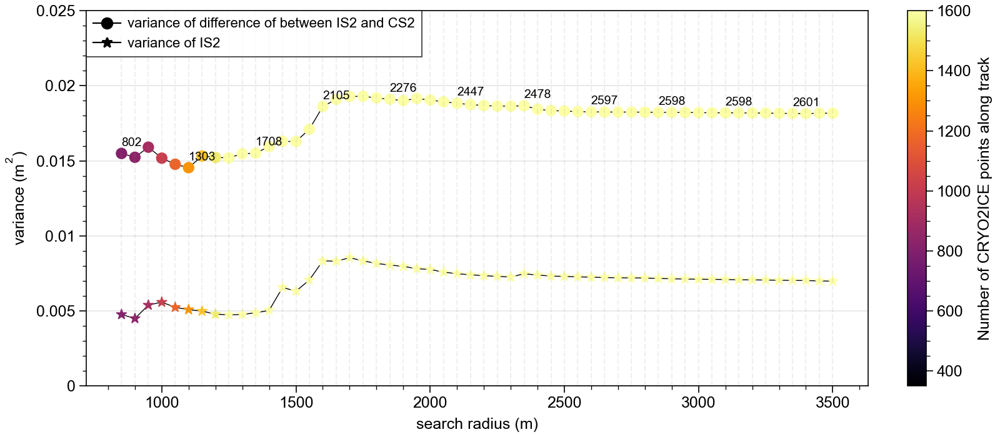

In [59]:
fig,ax = plt.subplots(figsize=(8,3.5), constrained_layout=True)
plt.plot(distance_total, variance_total,ls='-', lw=0.5, c='k',zorder=-1)
im = plt.scatter(distance_total, variance_total, c=N_total, vmin=350, vmax=1600, cmap='inferno', zorder=2)
#plt.ylim([0.032, 0.015])
for i, txt in enumerate(N_total[::5].astype(int)):
    k = 5*i
    plt.annotate(txt, (distance_total[k]+0.0015, variance_total[k]+0.0005), fontsize=7)

plt.plot(distance_total, IS2_variance_total,ls='-', lw=0.5, c='k',zorder=-1)
im = plt.scatter(distance_total, IS2_variance_total, c=N_total,  marker='*',vmin=350, vmax=1600, cmap='inferno', zorder=2)

plt.colorbar(im,label='Number of CRYO2ICE points along track')
plt.ylabel('variance (m$^2$)')
plt.xlabel('search radius (m)')
plt.ylim(0.000, 0.025)

legend_elements = [Line2D([0], [0],  marker='o', color='k', linewidth=0.8,label='variance of difference of between IS2 and CS2'),
                   Line2D([0], [0], marker='*',color='k', linewidth=0.8, label='variance of IS2')]
plt.legend(handles=legend_elements, loc='upper left', fontsize=8)

plt.vlines(distance_total, 0,1, ls='--', color='grey', linewidth=0.8, label='_nolegend_', alpha=0.15)
plt.grid(axis='x')

Text(0.5, 0, 'search radius (m)')

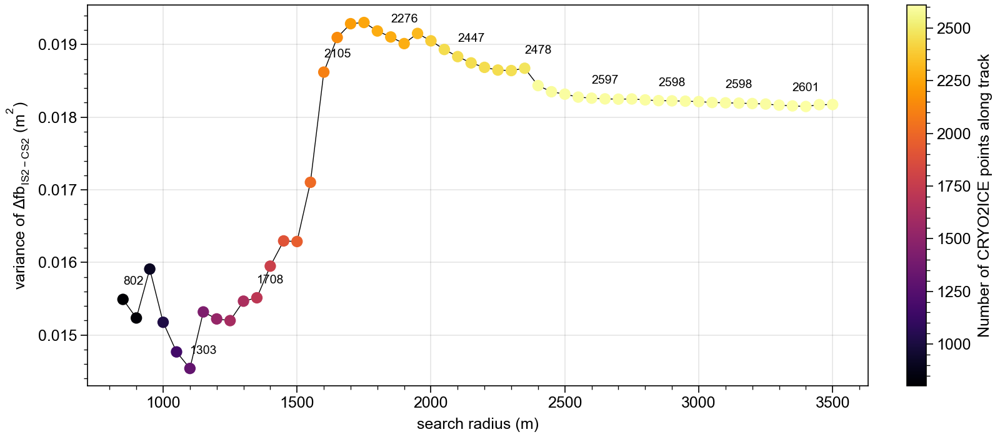

In [58]:
fig,ax = plt.subplots(figsize=(8,3.5), constrained_layout=True)
plt.plot(distance_total, variance_total,ls='-', lw=0.5, c='k',zorder=-1)
im = plt.scatter(distance_total, variance_total, c=N_total, vmin=np.round(np.min(N_total)), vmax=np.round(np.max(N_total)), cmap='inferno', zorder=2)
#plt.ylim([0.032, 0.015])
for i, txt in enumerate(N_total[::5].astype(int)):
    k = 5*i
    plt.annotate(txt, (distance_total[k]+0.0015, variance_total[k]+0.0002), fontsize=7)

plt.colorbar(im,label='Number of CRYO2ICE points along track')
plt.ylabel(r'variance of $\Delta{fb}_{IS2-CS2}$ (m$^2$)')
plt.xlabel('search radius (m)')



In [52]:
df_variance_CS2_IS2 = pd.DataFrame({'difference_variance':variance_total, 'search_radius':distance_total, 'N':N_total, 'IS2_variance':IS2_variance_total})

In [53]:
df_variance_CS2_IS2.to_csv(path + '/' +'CRYO2ICE_CS2_IS2_variance_test_track_january.csv')


In [54]:
print(distance_total[15])
print(variance_total[15])
print(N_total[15])

1600.0
0.01862058226033939
2105.0


In [55]:
variance_total

array([0.01549118, 0.01523495, 0.01590892, 0.01517602, 0.01476793,
       0.01454013, 0.01531852, 0.01522201, 0.01519887, 0.01546675,
       0.01551312, 0.01594912, 0.0162963 , 0.01628785, 0.01710317,
       0.01862058, 0.01909757, 0.01928748, 0.01930401, 0.01918721,
       0.01910467, 0.01901339, 0.01915333, 0.01905152, 0.01893257,
       0.01883446, 0.01874768, 0.01868614, 0.01864901, 0.01864203,
       0.01867409, 0.01843539, 0.01835058, 0.01831741, 0.0182766 ,
       0.01826206, 0.01825251, 0.01824833, 0.01825097, 0.01823846,
       0.01822826, 0.01822519, 0.01822085, 0.01821479, 0.01820241,
       0.01819799, 0.01819392, 0.01818794, 0.01818111, 0.01816588,
       0.01815564, 0.01814733, 0.01817242, 0.01817418])

In [64]:
14*0.7 * (28365.85 * (12/365))

9139.243726027395

In [40]:
files_check_radii = !ls E:/DTU/CRYO2ICE/Data/CRYO2ICE_DTU21MSS/*semivariogram.csv
files_check_radii

['E:/DTU/CRYO2ICE/Data/CRYO2ICE_DTU21MSS/CRYO2ICE_CS_OFFL_SIR_SAR_2__20201102T123414_20201102T123933_D001_variance_analysis_semivariogram.csv',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_DTU21MSS/CRYO2ICE_CS_OFFL_SIR_SAR_2__20201105T032414_20201105T033327_D001_variance_analysis_semivariogram.csv',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_DTU21MSS/CRYO2ICE_CS_OFFL_SIR_SAR_2__20201105T050433_20201105T051225_D001_variance_analysis_semivariogram.csv',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_DTU21MSS/CRYO2ICE_CS_OFFL_SIR_SAR_2__20201106T091244_20201106T091824_D001_variance_analysis_semivariogram.csv',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_DTU21MSS/CRYO2ICE_CS_OFFL_SIR_SAR_2__20201106T105159_20201106T105849_D001_variance_analysis_semivariogram.csv',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_DTU21MSS/CRYO2ICE_CS_OFFL_SIR_SAR_2__20201108T204331_20201108T204757_D001_variance_analysis_semivariogram.csv',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_DTU21MSS/CRYO2ICE_CS_OFFL_SIR_SAR_2__20201108T222250_20201108T222813_D001_variance_analysis_semivariogra

In [41]:
li = []
k = 0
for filename in files_check_radii:
    df = pd.read_csv(filename, index_col=None, header=0)
    df['ID']=k
    li.append(df)
    k = k+1
    
frame = pd.concat(li, axis=0, ignore_index=True)

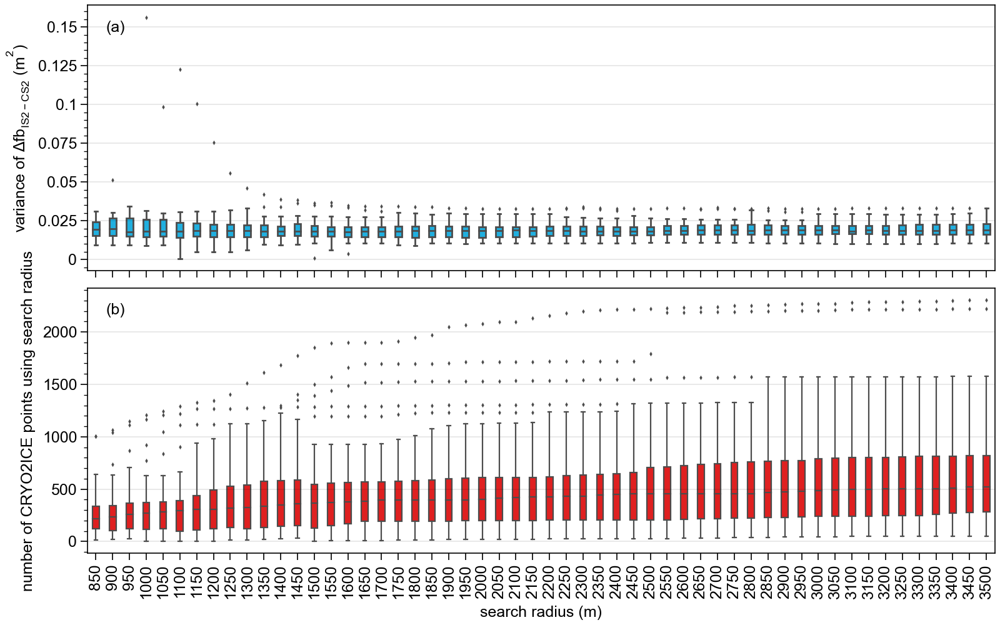

In [94]:
import seaborn as sns

fig,ax = plt.subplots(nrows=2, figsize=(8,5), constrained_layout=True, sharex=True)
g=sns.boxplot(x="distance_total", y="variance_total",
                 data=frame, color='deepskyblue', ax = ax[0], width=0.4, linewidth=1, fliersize=0.5)
ax[0].set_xlabel('')

g=sns.boxplot(x="distance_total", y="N_total",
                 data=frame, color='red', ax=ax[1], width=0.4, linewidth=0.8, fliersize=0.5)
#g.set_xticklabels(ax.get_xticklabels(),rotation=90)
g.set_xticklabels(np.arange(850, 3550, 50),rotation=90)

ax[0].set_ylabel(r'variance of $\Delta{fb}_{IS2-CS2}$ (m$^2$)')
ax[1].set_ylabel(r'number of CRYO2ICE points using search radius')
plt.xlabel('search radius (m)')

ax[0].tick_params(axis='x', which='minor', bottom=False)
ax[1].tick_params(axis='x', which='minor', bottom=False)
#ax[0].set_ylim([0, 0.05])

ax[0].text(0.02, 0.90,'(a)',transform = ax[0].transAxes)
ax[1].text(0.02, 0.90,'(b)',transform = ax[1].transAxes)

plt.show()


Text(0.5, 0, 'search radius (m)')

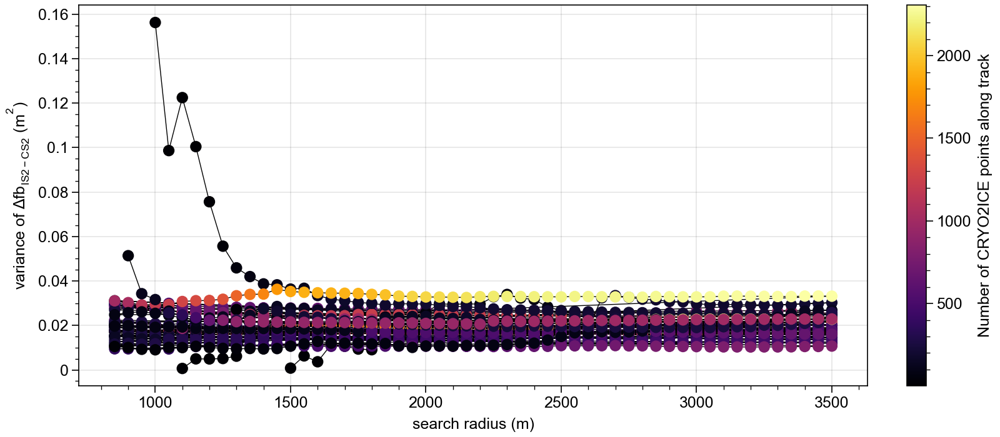

In [24]:
fig,ax = plt.subplots(figsize=(8,3.5), constrained_layout=True)
plt.plot(frame['distance_total'], frame['variance_total'],ls='-', lw=0.5, c='k',zorder=-1)
im = plt.scatter(frame['distance_total'], frame['variance_total'], c=frame['N_total'], vmin=np.round(np.min(frame['N_total'])), vmax=np.round(np.max(frame['N_total'])), cmap='inferno', zorder=2)
#plt.ylim([0.032, 0.015])
#for i, txt in enumerate(N_total[::5].astype(int)):
#    k = 5*i
#    plt.annotate(txt, (distance_total[k]+0.0015, variance_total[k]+0.0002), fontsize=7)

plt.colorbar(im,label='Number of CRYO2ICE points along track')
plt.ylabel(r'variance of $\Delta{fb}_{IS2-CS2}$ (m$^2$)')
plt.xlabel('search radius (m)')

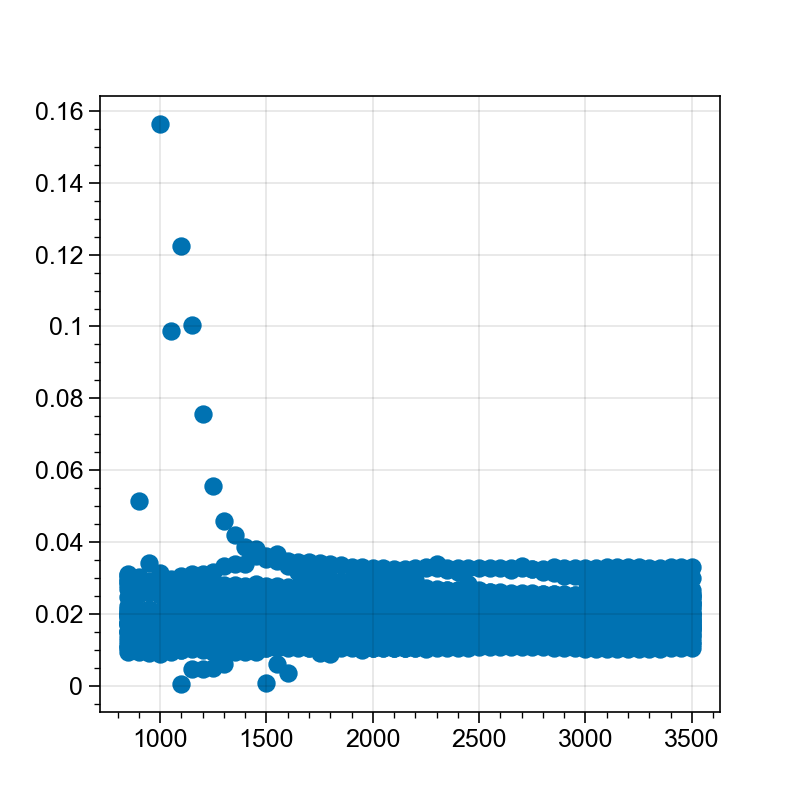

In [92]:
plt.scatter(frame['distance_total'], frame['variance_total'])

In [439]:
ds = 0.4
ns = (1+0.5*ds)**(-1.5)
sd = (0.5-0.3)/ns
print(ns)
print(sd)

0.7607257743127308
0.26290682760247974


In [432]:
0.2/0.9

0.22222222222222224

# Prep for running code once at a time

In [ ]:
k = 77
l = 5
l2 = l+0
print(files_check_CS2_L1b[k+l])
print(files_check_CS2_L2[k+l2])
print(files_check_IS2[k])

In [30]:
fpa = r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_data\IS2\Monthly_data\March\ATL10-01_20210313051432_12101001_005_01_gt1l_no_mss_corr.h5'
fpb = r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_data\IS2\Monthly_data\March\ATL10-01_20210313051432_12101001_005_01_gt2l_no_mss_corr.h5'
fpc = r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_data\IS2\Monthly_data\March\ATL10-01_20210313051432_12101001_005_01_gt3l_no_mss_corr.h5'


fp2 = r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_data\CS2\Monthly_data\L1b\March\CS_OFFL_SIR_SAR_1B_20210313T075845_20210313T080636_D001.nc'
fp1 =r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_data\CS2\Monthly_data\L2\March\CS_OFFL_SIR_SAR_2__20210313T075845_20210313T080636_D001.nc'

# Run code one at a time

In [31]:
#lon_gt2l, lat_gt2l,fb_gt2l, gw_gt2l, fb_mss, mss = read_h5(files_check_IS2[k], ['lon_fb', 'lat_fb', 'fb', 'gw', 'fb_with_mss', 'mss'])
lon_gt2l, lat_gt2l,fb_gt2l, gw_gt2l, fb_mss, mss = read_h5(fpa, ['lon_fb', 'lat_fb', 'fb', 'gw', 'fb_with_mss', 'mss'])
gw_gt2l[fb_gt2l>5] = np.nan
fb_gt2l[fb_gt2l>5] = np.nan
df_IS2a = pd.DataFrame({'lat':lat_gt2l, 'lon':lon_gt2l, 'fb':fb_gt2l, 'gw':gw_gt2l, 'fb_with_mss':fb_mss, 'mss_IS2':mss})
df_IS2a['beam_ID']=1

lon_gt2l, lat_gt2l,fb_gt2l, gw_gt2l, fb_mss, mss = read_h5(fpb, ['lon_fb', 'lat_fb', 'fb', 'gw', 'fb_with_mss', 'mss'])
gw_gt2l[fb_gt2l>5] = np.nan
fb_gt2l[fb_gt2l>5] = np.nan
df_IS2b = pd.DataFrame({'lat':lat_gt2l, 'lon':lon_gt2l, 'fb':fb_gt2l, 'gw':gw_gt2l, 'fb_with_mss':fb_mss, 'mss_IS2':mss})
df_IS2b['beam_ID']=2

lon_gt2l, lat_gt2l,fb_gt2l, gw_gt2l, fb_mss, mss = read_h5(fpc, ['lon_fb', 'lat_fb', 'fb', 'gw', 'fb_with_mss', 'mss'])
gw_gt2l[fb_gt2l>5] = np.nan
fb_gt2l[fb_gt2l>5] = np.nan
df_IS2c = pd.DataFrame({'lat':lat_gt2l, 'lon':lon_gt2l, 'fb':fb_gt2l, 'gw':gw_gt2l, 'fb_with_mss':fb_mss, 'mss_IS2':mss})
df_IS2c['beam_ID']=3

frames = [df_IS2a, df_IS2b, df_IS2c]
df_IS2 = pd.concat(frames)
df_IS2 = df_IS2.dropna().reset_index()

# Load CS2 data 

In [32]:
#path = r'E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/CS2'
#fp = r'L2\CS_OFFL_SIR_SAR_2__20201116T221610_20201116T221813_D001.nc'
#fpname = path + '/'+r'L1b\CS_OFFL_SIR_SAR_1B_20201116T221610_20201116T221813_D001.nc'
#lon, lat,fb = load_data(path, fp, 'lon_poca_20_ku', 'lat_poca_20_ku', 'freeboard_20_ku')
#fp1 = files_check_CS2_L2[k+l]
#fp2 = files_check_CS2_L1b[k+l]
lon, lat,fb, mss, ssd, ppk= load_data(fp1, fp2)
df_CS2 = pd.DataFrame({'lat':lat, 'lon':lon, 'fb':fb, 'mss':mss, 'fb_no_mss':fb-mss, 'ssd':ssd, 'ppk':ppk})
df_CS2 = df_CS2[(df_CS2['lat']>60)].reset_index()

# Plot IS2 and CS2 track

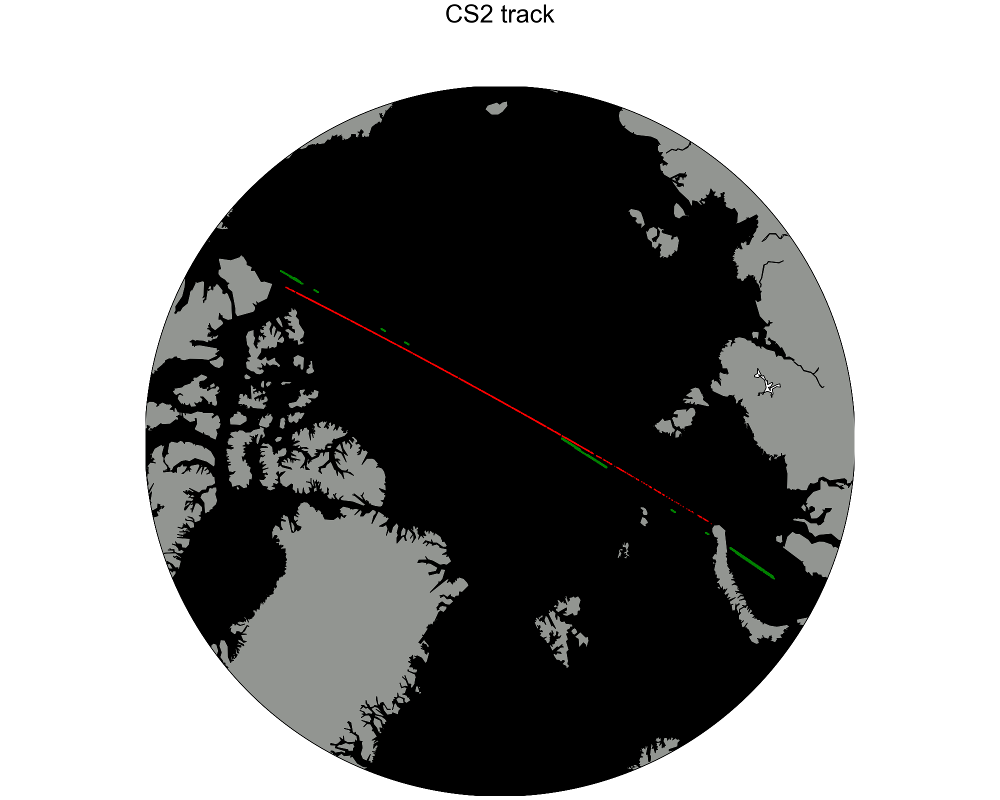

In [33]:
fig, ax = plt.subplots(figsize=(10,8), constrained_layout=True)
title = 'IS2 track'
#plot_panArctic2(lon_gt2l, lat_gt2l, 'grey', 0, 0.5, 'viridis', 'radar freeboard (m)','max', ax[1],fig)
#plt.colorbar(im, ax=ax[0], orientation = 'vertical', extend='max', shrink=0.5)

title = 'CS2 track'
#plot_panArctic2(lon_gt2l, lat_gt2l, 'grey', 0, 0.5, 'viridis', 'radar freeboard (m)','max', ax[1],fig)
im = plot_panArctic2(np.array(df_CS2['lon']), np.array(df_CS2['lat']), 'r', 0, 0.5, 'viridis', 'radar freeboard (m)','max', ax,fig)
im=plot_panArctic2(np.array(df_IS2['lon']), np.array(df_IS2['lat']), 'g', 0, 0.5, 'viridis', 'radar freeboard (m)','max', ax,fig)

#plt.colorbar(im, ax=ax[1], orientation = 'vertical', extend='both', shrink=0.5)
plt.show()

# Binning of IS2 data to CS2 footprint

### Prep of identification of CRYO2ICE part of tracks (based on this study's methodology)

In [13]:
def CRYO2ICE_identify_IS2_data(df_CS2, df_IS2):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    query_lats = df_CS2[['lat']].to_numpy()
    query_lons = df_CS2[['lon']].to_numpy()

    tree = BallTree(np.deg2rad(df_IS2[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    dist_in_metres = 1600
    earth_radius_in_metres = 6371*1000
    radius = dist_in_metres/earth_radius_in_metres

    #distances, indices = bt.query(np.deg2rad(np.c_[query_lats, query_lons]), k=1)
    is_within, distances = tree.query_radius(np.deg2rad(np.c_[query_lats, query_lons]), r=radius, count_only=False, return_distance=True) 
    distances_in_metres = distances*earth_radius_in_metres

    #data['satellite_lat'] = df_IS2['lat'][indices[0][:]]
    #data['satellite_lon'] = df_IS2['lon'][indices[0][:]]
    #data['min_distance'] = distances*6371*1000
    #data['IS2_id'] = df_IS2['GTL'][indices[0][:]]

    data = []
    for j in is_within:
        #print(j)
        for i in j:
            data=np.append(data,i)
            data2 = np.unique(data)

    df_IS2_new = df_IS2.iloc[data2]
    
    return df_IS2_new

def CRYO2ICE_identify_CS2_data(df_CS2, df_IS2):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    query_lats = df_IS2[['lat']].to_numpy()
    query_lons = df_IS2[['lon']].to_numpy()

    tree = BallTree(np.deg2rad(df_CS2[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    dist_in_metres = 1500
    earth_radius_in_metres = 6371*1000
    radius = dist_in_metres/earth_radius_in_metres

    #distances, indices = bt.query(np.deg2rad(np.c_[query_lats, query_lons]), k=1)
    is_within, distances = tree.query_radius(np.deg2rad(np.c_[query_lats, query_lons]), r=radius, count_only=False, return_distance=True) 
    distances_in_metres = distances*earth_radius_in_metres

    data = []
    for j in is_within:
        for i in j:
            data=np.append(data,i)
            data2 = np.unique(data)

    df_CS2_new = df_CS2.iloc[data2]
    
    return df_CS2_new

def CRYO2ICE_identify_NN_IS2_new_data(df_CS2_new,df_IS2):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    ## Only data within 825 m of CryoSat-2 footprint (find approximate area of coincident data)
    query_lats = df_CS2_new[['lat']].to_numpy()
    query_lons = df_CS2_new[['lon']].to_numpy()

    tree = BallTree(np.deg2rad(df_IS2[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    distances, indices = tree.query(np.deg2rad(np.c_[query_lats, query_lons]), k=1)
    
    data_check = df_CS2_new
    data_check['IS2_idx_NN'] = indices
    IS2_lat_NN, IS2_lon_NN, IS2_fb_NN, IS2_gw_NN = [], [], [],[]
    for i in indices:
        IS2_lat_NN = np.append(IS2_lat_NN, df_IS2['lat'][int(i)])
        IS2_lon_NN = np.append(IS2_lon_NN, df_IS2['lon'][int(i)])
        IS2_fb_NN = np.append(IS2_fb_NN, df_IS2['fb'][int(i)])
        IS2_gw_NN = np.append(IS2_gw_NN, df_IS2['gw'][int(i)])

    data_check['IS2_lat_NN'] = IS2_lat_NN
    data_check['IS2_lon_NN'] = IS2_lon_NN
    data_check['IS2_fb_NN'] = IS2_fb_NN
    data_check['IS2_gw_NN'] = IS2_gw_NN
    
    CRYO2ICE_bin_IS2_data_within_footprint(data_check, df_IS2)
    
    return data_check

def identify_DTU21MSS_along_CRYO2ICE_track(data_check, df_grid_DTU21):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    ## Only data within 825 m of CryoSat-2 footprint (find approximate area of coincident data)
    query_lats = data_check[['lat']].to_numpy()
    query_lons = data_check[['lon']].to_numpy()

    tree = BallTree(np.deg2rad(df_grid_DTU21[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    distances, indices = tree.query(np.deg2rad(np.c_[query_lats, query_lons]), k=1)

    MSS = []
    for i in indices:
        MSS = np.append(MSS, df_grid_DTU21['MSS'][int(i)])

    data_check['MSS_DTU21'] = MSS
    
    return data_check

def CRYO2ICE_bin_IS2_data_within_footprint(data_check, df_IS2):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    query_lats = data_check[['IS2_lat_NN']].to_numpy()
    query_lons = data_check[['IS2_lon_NN']].to_numpy()

    tree = BallTree(np.deg2rad(df_IS2[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    dist_in_metres = 1600
    earth_radius_in_metres = 6371*1000
    radius = dist_in_metres/earth_radius_in_metres

    is_within, distances = tree.query_radius(np.deg2rad(np.c_[query_lats, query_lons]), r=radius, count_only=False, return_distance=True) 
    distances_in_metres = distances*earth_radius_in_metres
    
    mean_fb_IS2, mean_gw_IS2,std_fb_IS2, mss_IS2_mean, comb_fb, comb_std, comb_gw, num = [], [], [], [], [], [], [], []
    for i in is_within:
        data_fb_mean_IS2, data_gw_mean_IS2, data_mss_mean_IS2 = [], [],[]
        for j in i: 
            data_fb_mean_IS2 = np.append(data_fb_mean_IS2, df_IS2['fb'][j])
            data_gw_mean_IS2 = np.append(data_gw_mean_IS2, df_IS2['gw'][j])
            data_mss_mean_IS2 = np.append(data_mss_mean_IS2, df_IS2['mss_IS2'][j])
        
        
        #mean_fb_val = np.nanquantile(data_fb_mean_IS2, 0.80)
        #mean_fb_val = np.median(data_fb_mean_IS2)
        mean_fb_val = np.mean(data_fb_mean_IS2)
        std_fb_val = np.std(data_fb_mean_IS2)
        mean_fb_IS2 = np.append(mean_fb_IS2, mean_fb_val)
        std_fb_IS2 = np.append(std_fb_IS2, std_fb_val)

        mss_IS2_mean_val = np.mean(data_mss_mean_IS2)
        mss_IS2_mean = np.append(mss_IS2_mean,mss_IS2_mean_val)

        #mean_gw_val = np.nanquantile(data_gw_mean_IS2, 0.80)
        #mean_gw_val = np.median(data_gw_mean_IS2)
        mean_gw_val = np.mean(data_gw_mean_IS2)
        mean_gw_IS2 = np.append(mean_gw_IS2, mean_gw_val)

        comb_fb = np.append(comb_fb, data_fb_mean_IS2)
        comb_gw = np.append(comb_gw, data_gw_mean_IS2)
        num = np.append(num, len(data_fb_mean_IS2))
        
        
    data_check['IS2_fb_mean'] = mean_fb_IS2
    data_check['IS2_MSS_mean'] = mss_IS2_mean
    data_check['IS2_gw_mean'] = mean_gw_IS2
    data_check['IS2_std_mean'] = std_fb_IS2
    ds = 0.30
    ns = (1+0.5*ds)**(-1.5)
    data_check['snow_depth_mean']=(data_check['IS2_fb_mean']-data_check['fb'])/ns
    data_check['snow_depth_NN']=(data_check['IS2_fb_NN']-data_check['fb'])/ns  ### Taking into account delay in propagation speed when travelling through the snow pack for CS2
    
    return data_check

def CRYO2ICE_identify_IS2_data2(df_CS2, df_IS2):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    query_lats = df_CS2[['lat']].to_numpy()
    query_lons = df_CS2[['lon']].to_numpy()

    tree = BallTree(np.deg2rad(df_IS2[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    dist_in_metres = 1600
    earth_radius_in_metres = 6371*1000
    radius = dist_in_metres/earth_radius_in_metres

    is_within, distances = tree.query_radius(np.deg2rad(np.c_[query_lats, query_lons]), r=radius, count_only=False, return_distance=True) 
    distances_in_metres = distances*earth_radius_in_metres
    

    mean_fb_IS2, mean_gw_IS2, mss_IS2_mean, w_mean_fb_IS2  = [], [], [], []
    k = 0
    for i in is_within:
        data_fb_mean_IS2, data_gw_mean_IS2, data_mss_mean_IS2 = [], [],[],
        if len(i)>10:
            for j in i: 
                data_fb_mean_IS2 = np.append(data_fb_mean_IS2, df_IS2['fb'][j])
                data_gw_mean_IS2 = np.append(data_gw_mean_IS2, df_IS2['gw'][j])
                data_mss_mean_IS2 = np.append(data_mss_mean_IS2, df_IS2['mss_IS2'][j])
        
            mean_fb_val = np.nanmean(data_fb_mean_IS2)


            masked_data = np.ma.masked_array(data_fb_mean_IS2, np.isnan(data_fb_mean_IS2))
            #w_mean_fb_val = np.ma.average(masked_data, weights=(1/distances_in_metres[k]))
            w_mean_fb_val = np.ma.average(masked_data, weights=(1/(distances_in_metres[k]/dist_in_metres)))
            #w_mean_fb_val = sum(np.array(data_fb_mean_IS2)/np.array(distances_in_metres[k]))/sum(1/np.array(distances_in_metres[k]))

            mss_IS2_mean_val = np.nanmean(data_mss_mean_IS2)

            mean_gw_val = np.nanmean(data_gw_mean_IS2)
        else:
            mean_fb_val = np.nan
            w_mean_fb_val = np.nan
            mss_IS2_mean_val = np.nan
            mean_gw_val = np.nan
        
        mean_fb_IS2 = np.append(mean_fb_IS2, mean_fb_val)
        w_mean_fb_IS2 = np.append(w_mean_fb_IS2, w_mean_fb_val)
        mss_IS2_mean = np.append(mss_IS2_mean,mss_IS2_mean_val)
        mean_gw_IS2 = np.append(mean_gw_IS2, mean_gw_val)
        
        k = k+1
    df_IS2_new = pd.DataFrame({'IS2_mean_fb':mean_fb_IS2, 'IS2_w_mean_fb':w_mean_fb_IS2,'IS2_mean_gw':mean_gw_IS2, 'IS2_mean_MSS':mss_IS2_mean})
    
    return df_IS2_new

def CRYO2ICE_identify(df_CS2, df_IS2):
    df_IS2_new = CRYO2ICE_identify_IS2_data2(df_CS2, df_IS2)
    
    frames = [df_CS2, df_IS2_new]
    data_check = pd.concat(frames, axis=1)
    data_check = data_check.dropna()
    
    return data_check



### Retrieve CRYO2ICE tracks

In [14]:
try:
    data_check = CRYO2ICE_identify(df_CS2, df_IS2)
except: 
    print('No data.')

### Plot IS2, CS2 and identified CRYO2ICE track

Text(0.5, 1.0, 'CRYO2ICE location')

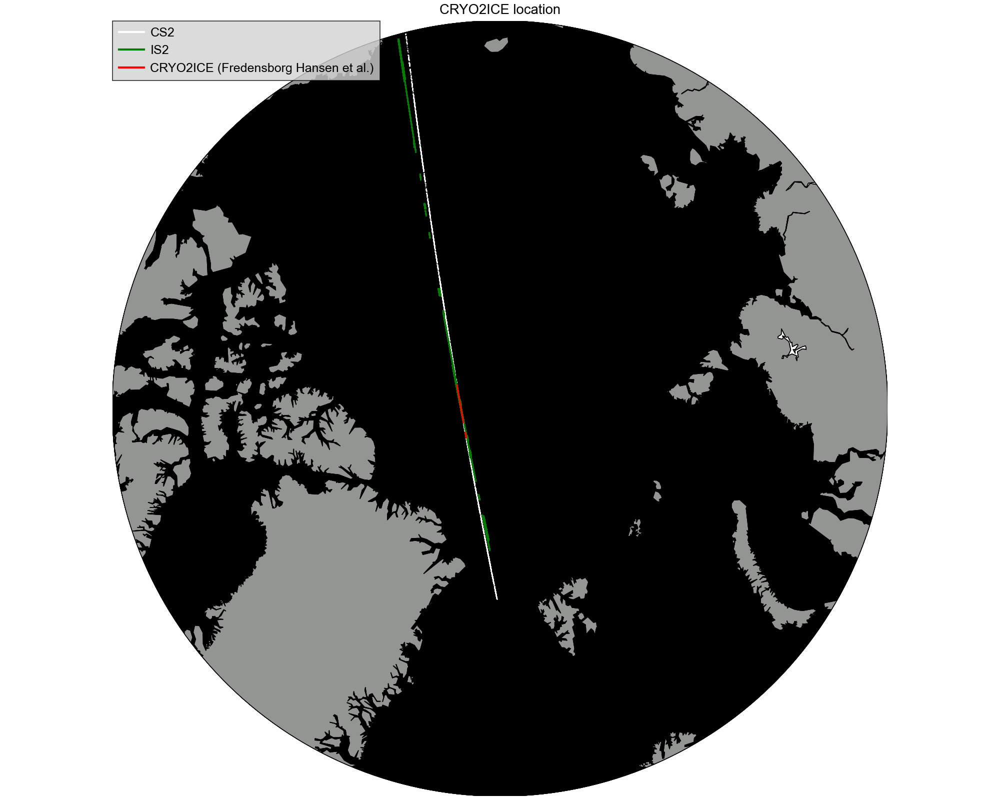

In [17]:
fig, ax = plt.subplots(figsize=(10,8), constrained_layout=True)
from matplotlib.lines import Line2D
#plot_panArctic2(lon_gt2l, lat_gt2l, 'grey', 0, 0.5, 'viridis', 'radar freeboard (m)','max', ax[1],fig)
im=plot_panArctic2(np.array(df_CS2['lon']), np.array(df_CS2['lat']), 'w', 0, 0.5, 'viridis', 'radar freeboard (m)','max', ax,fig)
im=plot_panArctic2(np.array(df_IS2['lon']), np.array(df_IS2['lat']), 'g', 0, 0.5, 'viridis', 'radar freeboard (m)','max', ax,fig)
im=plot_panArctic2(np.array(data_check['lon']), np.array(data_check['lat']), 'r', 0, 0.5, 'viridis', 'radar freeboard (m)','max', ax,fig)
#ax[0].legend(['CS2', 'IS2', 'CRYO2ICE'])

legend_elements = [Line2D([0], [0], color='w', label='CS2'),
                   Line2D([0], [0], color='g',  label='IS2'),
                  Line2D([0], [0], color='r',  label='CRYO2ICE (Fredensborg Hansen et al.)')]
ax.legend(handles=legend_elements, loc='best', facecolor='lightgrey')
ax.set_title('CRYO2ICE location')

In [16]:
data_check

,index,lat,lon,fb,mss,fb_no_mss,ssd,ppk,IS2_mean_fb,IS2_w_mean_fb,IS2_mean_gw,IS2_mean_MSS
1793,1793,87.670974,-49.669821,0.345,17.411,-17.066,40.65,7.003529,-17.581951,-17.580027,0.161261,18.128216
1794,1794,87.672351,-49.728193,0.216,17.411,-17.195,45.28,6.847748,-17.577968,-17.578037,0.168197,18.127628
1795,1795,87.673727,-49.786635,0.274,17.411,-17.137,43.58,7.350166,-17.566737,-17.568567,0.174739,18.127057
1796,1796,87.675100,-49.845145,0.187,17.411,-17.224,46.83,6.979472,-17.562587,-17.563433,0.175687,18.126480
1797,1797,87.676470,-49.903726,0.220,17.411,-17.191,46.31,7.760505,-17.593169,-17.590808,0.170781,18.125435
...,...,...,...,...,...,...,...,...,...,...,...,...
2469,2469,87.443397,-118.282141,0.150,13.836,-13.686,36.02,10.681193,-14.243722,-14.243434,0.191143,14.676124
2470,2470,87.441708,-118.330575,0.068,13.836,-13.768,32.06,10.224960,-14.275955,-14.275766,0.157312,14.676861
2471,2471,87.440016,-118.378944,-0.171,13.836,-14.007,18.97,12.252981,-14.221631,-14.222570,0.176943,14.677832
2472,2472,87.434930,-118.523672,-0.025,13.830,-13.855,27.82,9.585663,-14.184292,-14.184226,0.241500,14.680877


### Retrieve new data using NN IS2 and bin to CS2 using mean/footprint search

In [1080]:
#data_check = CRYO2ICE_identify_NN_IS2_new_data(df_CS2_new,df_IS2)

In [1081]:
#len(df_IS2)

### Reference IS2 and CS2 (CRYO2ICE) to same MSS (DTU21MSS)

#### Prep MSS

In [1082]:
def identify_DTU21MSS_along_CRYO2ICE_track(data_check, df_grid_DTU21):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    ## Only data within 825 m of CryoSat-2 footprint (find approximate area of coincident data)
    query_lats = data_check[['lat']].to_numpy()
    query_lons = data_check[['lon']].to_numpy()

    tree = BallTree(np.deg2rad(df_grid_DTU21[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    distances, indices = tree.query(np.deg2rad(np.c_[query_lats, query_lons]), k=1)

    MSS = []
    for i in indices:
        MSS = np.append(MSS, df_grid_DTU21['MSS'][int(i)])

    data_check['MSS_DTU21'] = MSS
    
    return data_check

In [1083]:
### retrieve DTU21MSS along CRYO2ICE track
data_check = identify_DTU21MSS_along_CRYO2ICE_track(data_check, df_grid_DTU21)

KeyboardInterrupt: 

In [ ]:
# prep CRYO2ICE along-track with new MSS

C=0.714 # Reference CS2 baseline-D MSS to WGS84 instead of Topex/Poseidon ellipsoid
ds = 0.30
ns = (1+0.5*ds)**(-1.5)
    
#data_check['IS2_COV']=(data_check['IS2_std_mean']/(data_check['IS2_fb_mean'] +data_check['MSS_DTU21']))*100
data_check['snow_depth_DTU21MSS'] =  ((data_check['IS2_mean_fb']+data_check['MSS_DTU21'])-(data_check['fb_no_mss']+data_check['MSS_DTU21']-C))/ns
data_check['CS2_fb_DTU21MSS'] = data_check['fb_no_mss']+data_check['MSS_DTU21']-C
data_check['IS2_fb_DTU21MSS'] = data_check['IS2_mean_fb']+data_check['MSS_DTU21']
data_check['IS2_w_fb_DTU21MSS'] = data_check['IS2_w_mean_fb']+data_check['MSS_DTU21']

### Plot change to DTU21 MSS and difference in MSS

In [ ]:
fig, axs = plt.subplots(3, figsize=(10,7), constrained_layout=True)
#axs[0].plot(df_IS2_new['lat'], df_IS2_new['fb'], c='grey', ls='', marker='.', markersize=0.8)
axs[0].plot(data_check['lat'], data_check['IS2_mean_fb'], c='orange', ls='', marker='x', markersize=3)
axs[0].plot(data_check['lat'], data_check['IS2_mean_fb']+data_check['IS2_mean_MSS'], c='magenta', ls='', marker='x', markersize=3)
axs[0].plot(data_check['lat'], data_check['IS2_fb_DTU21MSS'], c='green', ls='', marker='x', markersize=3)
axs[0].plot(data_check['lat'], data_check['fb_no_mss'], c='b', ls='', marker='+', markersize=5)
axs[0].plot(data_check['lat'], data_check['fb'], c='r', ls='', marker='+', markersize=5)
axs[0].plot(data_check['lat'], data_check['CS2_fb_DTU21MSS'], c='k', ls='', marker='+', markersize=5)
#axs[1].plot(data_check['lat'], data_check['snow_depth_mean'], c='k',ls='-')
#axs[2].plot(data_check['lat'], data_check['IS2_gw_mean'], c='k',ls='-')
#axs[0].set_ylim([-0.3, 1.5])
#axs[0].set_xlim([float(data_check['lat'].head(1)), float(data_check['lat'].tail(1))])

axs[1].plot(data_check['lat'], data_check['MSS_DTU21'], c='k', ls='-', markersize=0.8)
axs[1].plot(data_check['lat'], data_check['mss']+C, c='b', ls='-', markersize=0.8)
axs[1].plot(data_check['lat'], data_check['IS2_mean_MSS'], c='g', ls='-', markersize=0.8)

axs[2].plot(data_check['lat'], data_check['MSS_DTU21']-data_check['IS2_mean_MSS'], c='green', ls='-', markersize=0.8)
axs[2].plot(data_check['lat'], data_check['MSS_DTU21']-data_check['mss']-C, c='red', ls='-', markersize=0.8)
axs[2].plot(data_check['lat'], data_check['mss']+C-data_check['IS2_mean_MSS'], c='blue', ls='-', markersize=0.8)

axs[0].set_ylabel('freeboards (m)')
axs[1].set_ylabel('MSS (m)')
axs[2].set_ylabel('difference in MSS (m)')

axs[0].legend(['IS2 fb original no MSS','IS2 mean fb no MSS','IS2 with IS2 MSS', 'IS2 mean fb DTU21MSS','CS2 fb no MSS','CS2 fb Baseline-D (BS-D) MSS','CS2 fb DTU21 MSS'],  bbox_to_anchor=[1.02,1])

axs[1].legend(['DTU21 MSS', 'BS-D MSS + C', 'IS2 MSS'],  bbox_to_anchor=[1.2,1])

axs[2].legend(['DTU21 MSS - IS2 MM', 'DTU21 MSS - (BS-D MSS - C)', '(BS-D MSS+C) - IS2 MSS'],  bbox_to_anchor=[1.02,1])
fig.suptitle('Comparison between MSS')

### Plot new data, snow pepth and potential roughness parameters

In [ ]:
fig, axs = plt.subplots(6, figsize=(10,12), constrained_layout=True, sharex=True)
#axs[0].plot(df_IS2_new['lat'], df_IS2_new['fb'], c='grey', ls='', marker='.', markersize=0.8)
axs[0].plot(data_check['lat'], data_check['CS2_fb_DTU21MSS'] , c='k', ls='', marker='+', markersize=5)
axs[0].plot(data_check['lat'], data_check['IS2_fb_DTU21MSS'], c='green', ls='', marker='x', markersize=3)
axs[1].plot(data_check['lat'], data_check['snow_depth_DTU21MSS'] , c='k',ls='-')
axs[2].plot(data_check['lat'], data_check['IS2_mean_gw'], c='k',ls='-')
#axs[3].plot(data_check['lat'], data_check['IS2_COV'], c='k',ls='-')
axs[4].plot(data_check['lat'], data_check['ssd'], c='k',ls='-')
axs[4].axhline(y=4, c='b',ls='--', linewidth=1)
axs[4].axhline(y=6.29, c='r',ls='--', linewidth=1)
#axs[4].text(79.5,4.6, 'lead cut-off threshold (Ricker et al., 2014)',color='b')
#axs[4].text(76.9,6.9, 'specular waveform cut-off (Tilling et al., 2018)',color='r')
axs[5].plot(data_check['lat'], data_check['ppk'], c='k',ls='-')
axs[5].axhspan(0,9, facecolor='green', alpha=0.5)
#axs[0].set_ylim([-0.3, 1.5])
#axs[0].set_xlim([float(data_check['lat'].head(1)), float(data_check['lat'].tail(1))])

axs[0].set_ylabel('freeboards (m)')
axs[1].set_ylabel('snow depth (m)')
axs[2].set_ylabel('IS2 gaussian-width (m)')
axs[3].set_ylabel('IS2 coefficient of variance (%)')
axs[4].set_ylabel('CS2 stack standard deviation')
axs[5].set_ylabel('CS2 pulse peakiness')

axs[0].legend(['CS2 fb', 'IS2 fb'], loc='best')
fig.suptitle(fp + ' - no MSS pre-processing')
plt.xlabel('longitude (degrees North)')
#axs[0].set_xlim([77, 78])

In [ ]:
fig= plt.figure(figsize=(10,4), constrained_layout=True)
plt.scatter(data_check['lat'],(data_check['IS2_w_mean_fb']-data_check['IS2_mean_fb'])*100)
#plt.scatter(data_check['lat'],data_check['IS2_fb_DTU21MSS'])
#plt.ylim([-0.05, 0.05])
plt.title('IS2 weighted mean - IS2 arithmetic mean, r = 3500 m')
plt.ylabel('difference (cm)')
plt.xlabel('latitude')

### Prep CRYO2ICE data using CS2 thresholds on PP and SSD for useful data

In [ ]:
data_check2 = data_check[(data_check['ppk']<9) & (data_check['ssd']>6.29)]

In [ ]:
fig, axs = plt.subplots(6, figsize=(10,12), constrained_layout=True, sharex=True)
#axs[0].plot(df_IS2_new['lat'], df_IS2_new['fb'], c='grey', ls='', marker='.', markersize=0.8)
axs[0].plot(data_check2['lat'], data_check2['CS2_fb_DTU21MSS'], c='k', ls='', marker='+', markersize=5)
axs[0].plot(data_check2['lat'], data_check2['IS2_fb_DTU21MSS'], c='green', ls='', marker='x', markersize=3)
axs[1].plot(data_check2['lat'], data_check2['snow_depth_DTU21MSS'], c='k',ls='-')
axs[2].plot(data_check2['lat'], data_check2['IS2_mean_gw'], c='k',ls='-')
#axs[3].plot(data_check2['lat'], data_check2['IS2_COV'], c='k',ls='-')
axs[4].plot(data_check2['lat'], data_check2['ssd'], c='k',ls='-')
axs[4].axhline(y=4, c='b',ls='--', linewidth=1)
axs[4].axhline(y=6.29, c='r',ls='--', linewidth=1)
#axs[4].text(79.5,4.6, 'lead cut-off threshold (Ricker et al., 2014)',color='b')
#axs[4].text(76.9,6.9, 'specular waveform cut-off (Tilling et al., 2018)',color='r')
axs[5].plot(data_check2['lat'], data_check2['ppk'], c='k',ls='-')
axs[5].axhspan(0,9, facecolor='green', alpha=0.5)
#axs[0].set_ylim([-0.3, 1.5])
#axs[0].set_xlim([float(data_check['lat'].head(1)), float(data_check['lat'].tail(1))])

axs[0].set_ylabel('freeboards (m)')
axs[1].set_ylabel('snow depth (m)')
axs[2].set_ylabel('IS2 gaussian-width (m)')
axs[3].set_ylabel('IS2 coefficient of variance (%)')
axs[4].set_ylabel('CS2 stack standard deviation')
axs[5].set_ylabel('CS2 pulse peakiness')

axs[0].legend(['CS2 fb', 'IS2 fb'], loc='best')
fig.suptitle(fp + ' - no MSS pre-processing')
plt.xlabel('longitude (degrees North)')
#axs[0].set_xlim([77, 78])

### Save data to CSV

In [ ]:
path = r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_DTU21MSS'
basename_without_ext = os.path.splitext(os.path.basename(fp1))[0]
basename_without_ext

data_check.to_csv(path + '/' +'CRYO2ICE_' +basename_without_ext + 'TESTr1600.csv')
data_check2.to_csv(path + '/' +'CRYO2ICE_' +basename_without_ext + '_ssd_ppk_filt_TESTr1600.csv')
print('Data has been saved in CRYO2ICE_DTU21MSS-folder.')

### Visualisation of CRYO2ICE data with different MSS 

In [ ]:
#plt.axhspan(0,10, color='green', linewidth=1, alpha=0.5)

#plt.axvspan(ymin=0, ymax=60, xmin= 0, xmax=10, color='green',alpha=0.2)
#plt.axvspan(ymin=0, ymax=60, xmin= 10, xmax=30, color='orange', alpha=0.2)
#plt.axvspan(ymin=0, ymax=60, xmin= 30, xmax=100, color='red',  alpha=0.2)

plt.hist(data_check['IS2_COV'], edgecolor='k', bins=10)
#plt.ylim([0,55])
#plt.xlim([0,100])

plt.xlabel('Coefficient of variation (%)')
plt.title('IS2 (laser) freeboards COV')

In [ ]:
fig, axs = plt.subplots(2,2, figsize=(6,6), constrained_layout=True, sharex=True, sharey=True)

y, x, _=axs[0,0].hist(data_check['CS2_fb_DTU21MSS'])
max_counts = y.max()+20
axs[0,0].vlines(np.mean(data_check['CS2_fb_DTU21MSS']), 0, max_counts, ls='--', color='grey', linewidth=0.8, label='mean')
axs[0,0].vlines(np.median(data_check['CS2_fb_DTU21MSS']), 0, max_counts, ls='--', color='k', linewidth=0.8, label ='median')
axs[0,0].vlines(np.nanquantile(data_check['CS2_fb_DTU21MSS'], 0.80), 0, max_counts, ls='--', color='blue', linewidth=0.8, label='quantile = 0.80')
axs[0,0].vlines(np.nanquantile(data_check['CS2_fb_DTU21MSS'], 0.90), 0, max_counts, ls='--', color='green', linewidth=0.8, label = 'quantile = 0.90')
#axs[0,0].set_ylim(0, 60)
axs[0,0].set_title('CS2 freeboards, DTU21 MSS (m)')


axs[1,0].hist(data_check['fb'])
axs[1,0].vlines(np.mean(data_check['fb']), 0, max_counts, ls='--', color='grey', linewidth=0.8, label='mean')
axs[1,0].vlines(np.median(data_check['fb']), 0, max_counts, ls='--', color='k', linewidth=0.8, label ='median')
axs[1,0].vlines(np.nanquantile(data_check['fb'], 0.80), 0, max_counts, ls='--', color='blue', linewidth=0.8, label='quantile = 0.80')
axs[1,0].vlines(np.nanquantile(data_check['fb'], 0.90), 0, max_counts, ls='--', color='green', linewidth=0.8, label = 'quantile = 0.90')
#axs[1,0].set_ylim(0, 60)
axs[1,0].set_title('CS2 freeboards, BS-D MSS (m)')

axs[0,1].hist(data_check['IS2_fb_DTU21MSS'])
axs[0,1].vlines(np.mean(data_check['IS2_fb_DTU21MSS']), 0, max_counts, ls='--', color='grey', linewidth=0.8, label='mean')
axs[0,1].vlines(np.median(data_check['IS2_fb_DTU21MSS']), 0, max_counts, ls='--', color='k', linewidth=0.8, label ='median')
axs[0,1].vlines(np.nanquantile(data_check['IS2_fb_DTU21MSS'], 0.80), 0, max_counts, ls='--', color='blue', linewidth=0.8, label='quantile = 0.80')
axs[0,1].vlines(np.nanquantile(data_check['IS2_fb_DTU21MSS'], 0.90), 0, max_counts, ls='--', color='green', linewidth=0.8, label = 'quantile = 0.90')
#axs[0,1].set_ylim(0, 60)
#plt.legend()
axs[0,1].set_title('IS2 freeboards, DTU21 MSS (m)')

axs[1,1].hist(data_check['IS2_fb_mean']+data_check['IS2_MSS_mean'])
axs[1,1].vlines(np.mean(data_check['IS2_fb_mean']+data_check['IS2_MSS_mean']), 0, max_counts, ls='--', color='grey', linewidth=0.8, label='mean')
axs[1,1].vlines(np.median(data_check['IS2_fb_mean']+data_check['IS2_MSS_mean']), 0, max_counts, ls='--', color='k', linewidth=0.8, label ='median')
axs[1,1].vlines(np.nanquantile(data_check['IS2_fb_mean']+data_check['IS2_MSS_mean'], 0.80), 0, max_counts, ls='--', color='blue', linewidth=0.8, label='quantile = 0.80')
axs[1,1].vlines(np.nanquantile(data_check['IS2_fb_mean']+data_check['IS2_MSS_mean'], 0.90), 0, max_counts, ls='--', color='green', linewidth=0.8, label = 'quantile = 0.90')
#axs[1,1].set_ylim(0, 60)
axs[1,1].set_title('IS2 (laser) freeboards, IS2 MSS (m)')
axs[1,1].legend()

axs[0,0].set_ylabel('counts')
axs[1,0].set_ylabel('counts')
axs[0,0].set_ylim([0, max_counts-5])

In [ ]:
fig, axs = plt.subplots(1,3, figsize=(8,3), constrained_layout=True, sharex=True, sharey=True)

y, x, _ = axs[0].hist(data_check['mss']+C)
max_counts = y.max()+20
axs[0].vlines(np.mean(data_check['mss']+C), 0, max_counts, ls='--', color='grey', linewidth=0.8, label='mean')
axs[0].vlines(np.median(data_check['mss']+C), 0, max_counts, ls='--', color='k', linewidth=0.8, label ='median')
axs[0].vlines(np.nanquantile(data_check['mss']+C, 0.80), 0, max_counts, ls='--', color='blue', linewidth=0.8, label='quantile = 0.80')
axs[0].vlines(np.nanquantile(data_check['mss']+C, 0.90), 0, max_counts, ls='--', color='green', linewidth=0.8, label = 'quantile = 0.90')
#axs[0].set_ylim(0, 60)
axs[0].legend()
axs[0].set_title('Baseline-D MSS  (m)')

axs[1].hist(data_check['IS2_MSS_mean'])
axs[1].vlines(np.mean(data_check['IS2_MSS_mean']), 0, max_counts, ls='--', color='grey', linewidth=0.8, label='mean')
axs[1].vlines(np.median(data_check['IS2_MSS_mean']), 0, max_counts, ls='--', color='k', linewidth=0.8, label ='median')
axs[1].vlines(np.nanquantile(data_check['IS2_MSS_mean'], 0.80), 0, max_counts, ls='--', color='blue', linewidth=0.8, label='quantile = 0.80')
axs[1].vlines(np.nanquantile(data_check['IS2_MSS_mean'], 0.90), 0, max_counts, ls='--', color='green', linewidth=0.8, label = 'quantile = 0.90')
#axs[1].set_ylim(0, 60)
#plt.legend()
axs[1].set_title('IS2 mean MSS  (m)')

axs[2].hist(data_check['MSS_DTU21'])
axs[2].vlines(np.mean(data_check['MSS_DTU21']), 0, max_counts, ls='--', color='grey', linewidth=0.8, label='mean')
axs[2].vlines(np.median(data_check['MSS_DTU21']), 0, max_counts, ls='--', color='k', linewidth=0.8, label ='median')
axs[2].vlines(np.nanquantile(data_check['MSS_DTU21'], 0.80), 0, max_counts, ls='--', color='blue', linewidth=0.8, label='quantile = 0.80')
axs[2].vlines(np.nanquantile(data_check['MSS_DTU21'], 0.90), 0, max_counts, ls='--', color='green', linewidth=0.8, label = 'quantile = 0.90')
#axs[2].set_ylim(0, 60)
#plt.legend()
axs[2].set_title('DTU21 MSS  (m)')


axs[0].set_ylabel('counts')

axs[0].set_ylim([0, max_counts-5])

### Correlation matrix

In [ ]:
import seaborn as sns

data_check_corr = data_check.drop(['index', 'lat', 'lon','IS2_idx_NN', 'IS2_lat_NN','IS2_lon_NN',], axis=1)

figure = plt.figure(figsize=(12,12))
sns.heatmap(data_check_corr.corr(),annot=True,cmap='mako', vmin = -1, vmax=1);

### Calculate along-track distance

In [ ]:
from math import radians, cos, sin, asin, sqrt

def haversine(lon1, lat1, lon2, lat2):
    """
    Calculate the great circle distance in kilometers between two points 
    on the earth (specified in decimal degrees)
    """
    # convert decimal degrees to radians 
    lon1, lat1, lon2, lat2 = map(radians, [lon1, lat1, lon2, lat2])

    # haversine formula 
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a)) 
    r = 6371 # Radius of earth in kilometers. Use 3956 for miles. Determines return value units.
    return c * r



haversine(data_check['lon'].head(1), data_check['lat'].head(1), data_check['lon'].tail(1), data_check['lat'].tail(1))

In [ ]:
def CRYO2ICE_identify_IS2_data2(df_CS2, df_IS2):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    query_lats = df_CS2[['lat']].to_numpy()
    query_lons = df_CS2[['lon']].to_numpy()

    tree = BallTree(np.deg2rad(df_IS2[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    dist_in_metres = 825
    earth_radius_in_metres = 6371*1000
    radius = dist_in_metres/earth_radius_in_metres

    is_within, distances = tree.query_radius(np.deg2rad(np.c_[query_lats, query_lons]), r=radius, count_only=False, return_distance=True) 
    distances_in_metres = distances*earth_radius_in_metres
    
    mean_fb_IS2, mean_gw_IS2, mss_IS2_mean  = [], [], [],
    for i in is_within:
        data_fb_mean_IS2, data_gw_mean_IS2, data_mss_mean_IS2 = [], [],[]
        for j in i: 
            data_fb_mean_IS2 = np.append(data_fb_mean_IS2, df_IS2['fb'][j])
            data_gw_mean_IS2 = np.append(data_gw_mean_IS2, df_IS2['gw'][j])
            data_mss_mean_IS2 = np.append(data_mss_mean_IS2, df_IS2['mss_IS2'][j])
        
        mean_fb_val = np.nanmean(data_fb_mean_IS2)
        mean_fb_IS2 = np.append(mean_fb_IS2, mean_fb_val)

        mss_IS2_mean_val = np.nanmean(data_mss_mean_IS2)
        mss_IS2_mean = np.append(mss_IS2_mean,mss_IS2_mean_val)

        mean_gw_val = np.nanmean(data_gw_mean_IS2)
        mean_gw_IS2 = np.append(mean_gw_IS2, mean_gw_val)
        
    df_IS2_new = pd.DataFrame({'IS2_mean_fb':mean_fb_IS2, 'IS2_mean_gw':mean_gw_IS2, 'IS2_mean_MSS':mss_IS2_mean})
    
    return df_IS2_new

def CRYO2ICE_identify(df_CS2, df_IS2):
    df_IS2_new = CRYO2ICE_identify_IS2_data2(df_CS2, df_IS2)
    
    frames = [df_CS2, df_IS2_new]
    data_check = pd.concat(frames, axis=1)
    data_check = data_check.dropna()
    
    return data_check

In [ ]:
try:
    data_check = CRYO2ICE_identify(df_CS2, df_IS2)
except: 
    print('No data.')

In [ ]:
len(df_CS2)

In [ ]:
len(df_IS2)

In [ ]:
frames = [df_CS2, df_IS2_new]

data_check = pd.concat(frames, axis=1)

In [ ]:
data_check=data_check.dropna()

In [ ]:
fig, ax = plt.subplots(nrows=1, ncols=2,figsize=(10,8), constrained_layout=True)
from matplotlib.lines import Line2D
#plot_panArctic2(lon_gt2l, lat_gt2l, 'grey', 0, 0.5, 'viridis', 'radar freeboard (m)','max', ax[1],fig)
im=plot_panArctic2(np.array(df_CS2['lon']), np.array(df_CS2['lat']), 'w', 0, 0.5, 'viridis', 'radar freeboard (m)','max', ax[0],fig)
im=plot_panArctic2(np.array(df_IS2['lon']), np.array(df_IS2['lat']), 'g', 0, 0.5, 'viridis', 'radar freeboard (m)','max', ax[0],fig)
im=plot_panArctic2(np.array(data_check['lon']), np.array(data_check['lat']), 'r', 0, 0.5, 'viridis', 'radar freeboard (m)','max', ax[0],fig)
#ax[0].legend(['CS2', 'IS2', 'CRYO2ICE'])

legend_elements = [Line2D([0], [0], color='w', label='CS2'),
                   Line2D([0], [0], color='g',  label='IS2'),
                  Line2D([0], [0], color='r',  label='CRYO2ICE (Fredensborg Hansen et al.)')]
ax[0].legend(handles=legend_elements, loc='best', facecolor='lightgrey')
ax[0].set_title('CRYO2ICE location')

# Comparison of roughness parameters

In [ ]:
plt.scatter(data_check['IS2_fb_DTU21MSS'], data_check['IS2_gw_mean'])

In [ ]:
plt.scatter(data_check['CS2_fb_DTU21MSS'], data_check['ssd'])

In [ ]:
plt.scatter(data_check['snow_depth_DTU21MSS'], data_check['ssd'])

In [ ]:
plt.scatter(data_check['ppk'], data_check['CS2_fb_DTU21MSS'])

In [ ]:
plt.scatter(data_check['ppk'], data_check['IS2_fb_DTU21MSS']-data_check['CS2_fb_DTU21MSS'] )

In [ ]:
plt.scatter(data_check['ppk'], data_check['IS2_fb_DTU21MSS'] )

In [ ]:
plt.scatter(data_check['IS2_gw_mean'], data_check['CS2_fb_DTU21MSS'] )

In [ ]:
files_check = !ls E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/CS2/L1b/*.nc
files_check

In [ ]:
files_check = !ls E:/DTU/CRYO2ICE/Data/CRYO2ICE_data/IS2/*_02.h5
files_check

In [ ]:
head, tail = os.path.split(files_check)
print(tail)



In [ ]:
new_path = r'E:\DTU\CRYO2ICE\Data\data_check'

In [ ]:
completeName = os.path.join(new_path, tail)
print(completeName)

In [ ]:
file1 = open(completeName, "w")
file1.write("file information")
file1.close()

In [ ]:
df2

In [172]:
df = pd.read_csv(r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_DTU21MSS\test_radius\CRYO2ICE_CS_OFFL_SIR_SAR_2__20201110T090903_20201110T091432_D001TESTr825.csv', index_col=None, header=0)
df

,Unnamed: 0,index,lat,lon,fb,mss,fb_no_mss,ssd,ppk,IS2_mean_fb,IS2_w_mean_fb,IS2_mean_gw,IS2_mean_MSS,MSS_DTU21,snow_depth_DTU21MSS,CS2_fb_DTU21MSS,IS2_fb_DTU21MSS,IS2_w_fb_DTU21MSS
0,0,0,83.864174,-63.222596,0.304,20.705,-20.401,38.60,8.444045,-21.068602,-21.077209,0.190834,21.534132,21.535,0.057220,0.420,0.466398,0.457791
1,1,1,83.866734,-63.231089,0.335,20.705,-20.370,44.63,5.842980,-21.057982,-21.066928,0.182201,21.525725,21.521,0.032086,0.437,0.463018,0.454072
2,2,2,83.869294,-63.239589,0.284,20.705,-20.421,44.26,6.861725,-21.078606,-21.066643,0.161603,21.516857,21.521,0.069547,0.386,0.442393,0.454357
3,3,3,83.871854,-63.248097,0.126,20.705,-20.579,45.45,7.306298,-21.107401,-21.086983,0.158995,21.507930,21.521,0.228888,0.228,0.413599,0.434017
4,4,4,83.874413,-63.256611,0.286,20.705,-20.419,43.65,5.559673,-21.131433,-21.133119,0.158835,21.498322,21.521,0.001932,0.388,0.389567,0.387881
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
366,2147,2147,77.619604,143.729910,0.001,1.482,-1.481,23.61,12.729966,-2.176119,-2.176026,0.081012,2.254593,2.307,0.023285,0.112,0.130881,0.130974
367,2148,2148,76.516996,142.870864,0.173,0.877,-0.704,33.43,8.310737,-1.568983,-1.568659,0.086276,1.620678,1.613,-0.186198,0.195,0.044017,0.044341
368,2149,2149,76.514317,142.868932,0.113,0.877,-0.764,23.52,12.152392,-1.553997,-1.555563,0.084939,1.616382,1.613,-0.093722,0.135,0.059003,0.057437
369,2150,2150,76.498243,142.857354,0.150,0.877,-0.727,21.41,14.574363,-1.508428,-1.508576,0.079101,1.596540,1.613,-0.083155,0.172,0.104572,0.104425


Text(0.5, 0, 'latitude')

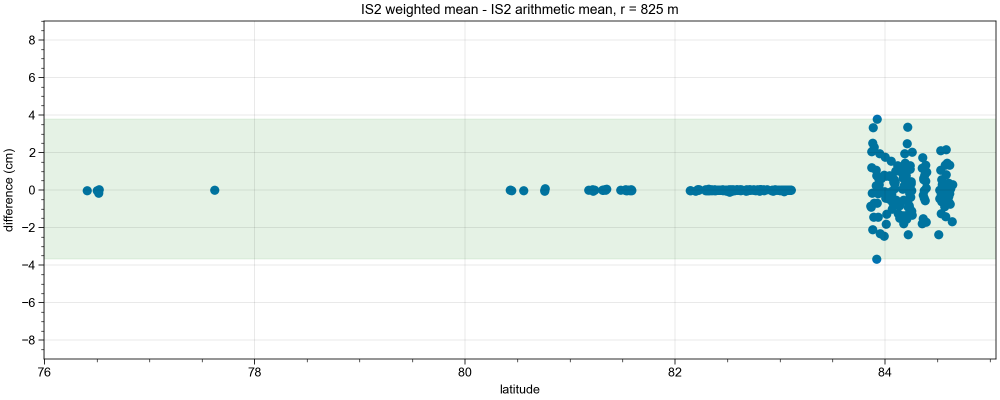

In [17]:
fig= plt.figure(figsize=(10,4), constrained_layout=True)
plt.scatter(df['lat'],(df['IS2_w_mean_fb']-df['IS2_mean_fb'])*100)
#plt.scatter(data_check['lat'],data_check['IS2_fb_DTU21MSS'])
plt.ylim([-9,9])
plt.axhspan(np.nanmin((df['IS2_w_mean_fb']-df['IS2_mean_fb'])*100),np.nanmax((df['IS2_w_mean_fb']-df['IS2_mean_fb'])*100),color='g',alpha=0.1)
plt.title('IS2 weighted mean - IS2 arithmetic mean, r = 825 m')
plt.ylabel('difference (cm)')
plt.xlabel('latitude')

In [18]:
np.nanmin((df['IS2_w_mean_fb']-df['IS2_mean_fb'])*100)

-3.6832069449808102

In [173]:
df2 = pd.read_csv(r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_DTU21MSS\test_radius\CRYO2ICE_CS_OFFL_SIR_SAR_2__20201110T090903_20201110T091432_D001TESTr1500.csv', index_col=None, header=0)
df2

,Unnamed: 0,index,lat,lon,fb,mss,fb_no_mss,ssd,ppk,IS2_mean_fb,IS2_w_mean_fb,IS2_mean_gw,IS2_mean_MSS,MSS_DTU21,snow_depth_DTU21MSS,CS2_fb_DTU21MSS,IS2_fb_DTU21MSS,IS2_w_fb_DTU21MSS
0,0,0,83.864174,-63.222596,0.304,20.705,-20.401,38.60,8.444045,-21.084162,-21.083726,0.191133,21.533964,21.535,0.038030,0.420,0.450838,0.451274
1,1,1,83.866734,-63.231089,0.335,20.705,-20.370,44.63,5.842980,-21.112051,-21.093444,0.168632,21.525286,21.521,-0.034594,0.437,0.408949,0.427556
2,2,2,83.869294,-63.239589,0.284,20.705,-20.421,44.26,6.861725,-21.108151,-21.088749,0.167795,21.516019,21.521,0.033112,0.386,0.412849,0.432251
3,3,3,83.871854,-63.248097,0.126,20.705,-20.579,45.45,7.306298,-21.072939,-21.078057,0.170306,21.506858,21.521,0.271387,0.228,0.448061,0.442943
4,4,4,83.874413,-63.256611,0.286,20.705,-20.419,43.65,5.559673,-21.054271,-21.087182,0.171160,21.497777,21.521,0.097091,0.388,0.466729,0.433817
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1387,2147,2147,77.619604,143.729910,0.001,1.482,-1.481,23.61,12.729966,-2.178188,-2.177507,0.079964,2.254401,2.307,0.020733,0.112,0.128812,0.129493
1388,2148,2148,76.516996,142.870864,0.173,0.877,-0.704,33.43,8.310737,-1.554262,-1.557229,0.087350,1.620522,1.613,-0.168044,0.195,0.058738,0.055771
1389,2149,2149,76.514317,142.868932,0.113,0.877,-0.764,23.52,12.152392,-1.545980,-1.548492,0.085868,1.616474,1.613,-0.083836,0.135,0.067020,0.064508
1390,2150,2150,76.498243,142.857354,0.150,0.877,-0.727,21.41,14.574363,-1.508485,-1.508534,0.079532,1.596589,1.613,-0.083225,0.172,0.104515,0.104466


Text(0.5, 0, 'latitude')

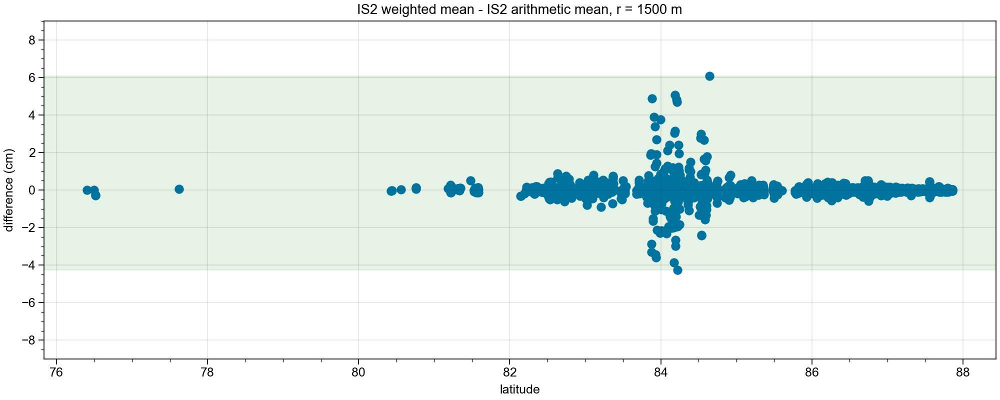

In [20]:
fig= plt.figure(figsize=(10,4), constrained_layout=True)
plt.scatter(df2['lat'],(df2['IS2_w_mean_fb']-df2['IS2_mean_fb'])*100)
#plt.scatter(data_check['lat'],data_check['IS2_fb_DTU21MSS'])
plt.axhspan(np.nanmin((df2['IS2_w_mean_fb']-df2['IS2_mean_fb'])*100),np.nanmax((df2['IS2_w_mean_fb']-df2['IS2_mean_fb'])*100),color='g',alpha=0.1)

plt.ylim([-9,9])
plt.title('IS2 weighted mean - IS2 arithmetic mean, r = 1500 m')
plt.ylabel('difference (cm)')
plt.xlabel('latitude')

In [374]:
df3 = pd.read_csv(r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_DTU21MSS\test_radius\CRYO2ICE_CS_OFFL_SIR_SAR_2__20201110T090903_20201110T091432_D001TESTr1600.csv', index_col=None, header=0)
df3

,Unnamed: 0,index,lat,lon,fb,mss,fb_no_mss,ssd,ppk,IS2_mean_fb,IS2_w_mean_fb,IS2_mean_gw,IS2_mean_MSS,MSS_DTU21,snow_depth_DTU21MSS,CS2_fb_DTU21MSS,IS2_fb_DTU21MSS,IS2_w_fb_DTU21MSS
0,0,0,83.864174,-63.222596,0.304,20.705,-20.401,38.60,8.444045,-21.090385,-21.086557,0.189343,21.533983,21.535,0.030356,0.420,0.444615,0.448442
1,1,1,83.866734,-63.231089,0.335,20.705,-20.370,44.63,5.842980,-21.115220,-21.095448,0.171515,21.525171,21.521,-0.038502,0.437,0.405780,0.425552
2,2,2,83.869294,-63.239589,0.284,20.705,-20.421,44.26,6.861725,-21.099749,-21.085574,0.169356,21.515912,21.521,0.043473,0.386,0.421251,0.435426
3,3,3,83.871854,-63.248097,0.126,20.705,-20.579,45.45,7.306298,-21.069651,-21.076430,0.168657,21.506866,21.521,0.275442,0.228,0.451349,0.444570
4,4,4,83.874413,-63.256611,0.286,20.705,-20.419,43.65,5.559673,-21.054134,-21.086160,0.168942,21.497671,21.521,0.097260,0.388,0.466865,0.434840
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1485,2147,2147,77.619604,143.729910,0.001,1.482,-1.481,23.61,12.729966,-2.177901,-2.177371,0.080005,2.254366,2.307,0.021087,0.112,0.129099,0.129629
1486,2148,2148,76.516996,142.870864,0.173,0.877,-0.704,33.43,8.310737,-1.552997,-1.556328,0.088260,1.620613,1.613,-0.166483,0.195,0.060003,0.056672
1487,2149,2149,76.514317,142.868932,0.113,0.877,-0.764,23.52,12.152392,-1.545628,-1.548171,0.086326,1.616544,1.613,-0.083401,0.135,0.067372,0.064829
1488,2150,2150,76.498243,142.857354,0.150,0.877,-0.727,21.41,14.574363,-1.509180,-1.508925,0.079681,1.596564,1.613,-0.084082,0.172,0.103820,0.104075


Text(0.5, 0, 'latitude')

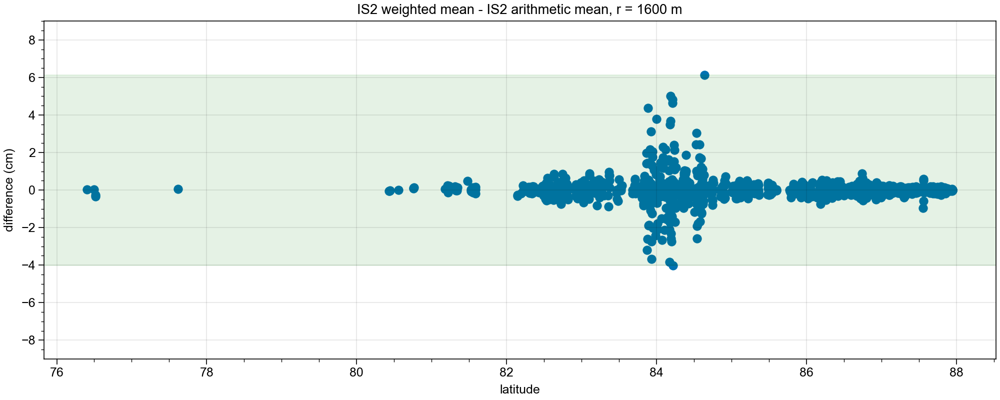

In [376]:
fig= plt.figure(figsize=(10,4), constrained_layout=True)
plt.scatter(df3['lat'],(df3['IS2_w_mean_fb']-df3['IS2_mean_fb'])*100)
plt.axhspan(np.nanmin((df3['IS2_w_mean_fb']-df3['IS2_mean_fb'])*100),np.nanmax((df3['IS2_w_mean_fb']-df3['IS2_mean_fb'])*100),color='g',alpha=0.1)
#plt.scatter(data_check['lat'],data_check['IS2_fb_DTU21MSS'])
plt.ylim([-9,9])
plt.title('IS2 weighted mean - IS2 arithmetic mean, r = 1600 m')
plt.ylabel('difference (cm)')
plt.xlabel('latitude')

In [377]:
df1=df.merge(df2, left_on=['lat', 'lon'], right_on=['lat', 'lon'])
df1=df1.merge(df3, left_on=['lat', 'lon'], right_on=['lat', 'lon'])

In [378]:
df1

,Unnamed: 0_x,index_x,lat,lon,fb_x,mss_x,fb_no_mss_x,ssd_x,ppk_x,IS2_mean_fb_x,...,ppk,IS2_mean_fb,IS2_w_mean_fb,IS2_mean_gw,IS2_mean_MSS,MSS_DTU21,snow_depth_DTU21MSS,CS2_fb_DTU21MSS,IS2_fb_DTU21MSS,IS2_w_fb_DTU21MSS
0,0,0,83.864174,-63.222596,0.304,20.705,-20.401,38.60,8.444045,-21.068602,...,8.444045,-21.090385,-21.086557,0.189343,21.533983,21.535,0.030356,0.420,0.444615,0.448442
1,1,1,83.866734,-63.231089,0.335,20.705,-20.370,44.63,5.842980,-21.057982,...,5.842980,-21.115220,-21.095448,0.171515,21.525171,21.521,-0.038502,0.437,0.405780,0.425552
2,2,2,83.869294,-63.239589,0.284,20.705,-20.421,44.26,6.861725,-21.078606,...,6.861725,-21.099749,-21.085574,0.169356,21.515912,21.521,0.043473,0.386,0.421251,0.435426
3,3,3,83.871854,-63.248097,0.126,20.705,-20.579,45.45,7.306298,-21.107401,...,7.306298,-21.069651,-21.076430,0.168657,21.506866,21.521,0.275442,0.228,0.451349,0.444570
4,4,4,83.874413,-63.256611,0.286,20.705,-20.419,43.65,5.559673,-21.131433,...,5.559673,-21.054134,-21.086160,0.168942,21.497671,21.521,0.097260,0.388,0.466865,0.434840
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
366,2147,2147,77.619604,143.729910,0.001,1.482,-1.481,23.61,12.729966,-2.176119,...,12.729966,-2.177901,-2.177371,0.080005,2.254366,2.307,0.021087,0.112,0.129099,0.129629
367,2148,2148,76.516996,142.870864,0.173,0.877,-0.704,33.43,8.310737,-1.568983,...,8.310737,-1.552997,-1.556328,0.088260,1.620613,1.613,-0.166483,0.195,0.060003,0.056672
368,2149,2149,76.514317,142.868932,0.113,0.877,-0.764,23.52,12.152392,-1.553997,...,12.152392,-1.545628,-1.548171,0.086326,1.616544,1.613,-0.083401,0.135,0.067372,0.064829
369,2150,2150,76.498243,142.857354,0.150,0.877,-0.727,21.41,14.574363,-1.508428,...,14.574363,-1.509180,-1.508925,0.079681,1.596564,1.613,-0.084082,0.172,0.103820,0.104075


In [379]:
std_xy=np.std(df1['IS2_w_mean_fb_x']-df1['IS2_w_mean_fb_y'])*100
std_xz = np.std((df1['IS2_w_mean_fb_x']-df1['IS2_w_mean_fb'])*100)
std_yz = np.std((df1['IS2_w_mean_fb_y']-df1['IS2_w_mean_fb'])*100)

In [380]:
std_x = np.std((df1['IS2_fb_DTU21MSS_x'])*100)
std_y = np.std((df1['IS2_fb_DTU21MSS_y'])*100)
std_z = np.std((df1['IS2_fb_DTU21MSS'])*100)
std_xw = np.std((df1['IS2_w_fb_DTU21MSS_x'])*100)
std_yw = np.std((df1['IS2_w_fb_DTU21MSS_y'])*100)
std_zw = np.std((df1['IS2_w_fb_DTU21MSS'])*100)
std_CS2 = np.std((df1['CS2_fb_DTU21MSS_x'])*100)

In [381]:
std_xyw=np.std(df1['IS2_w_mean_fb_x']-df1['IS2_mean_fb_x'])*100
std_xzw = np.std((df1['IS2_w_mean_fb_y']-df1['IS2_mean_fb_y'])*100)
std_yzw = np.std((df1['IS2_w_mean_fb']-df1['IS2_mean_fb'])*100)

Text(0, 0.5, 'difference (cm)')

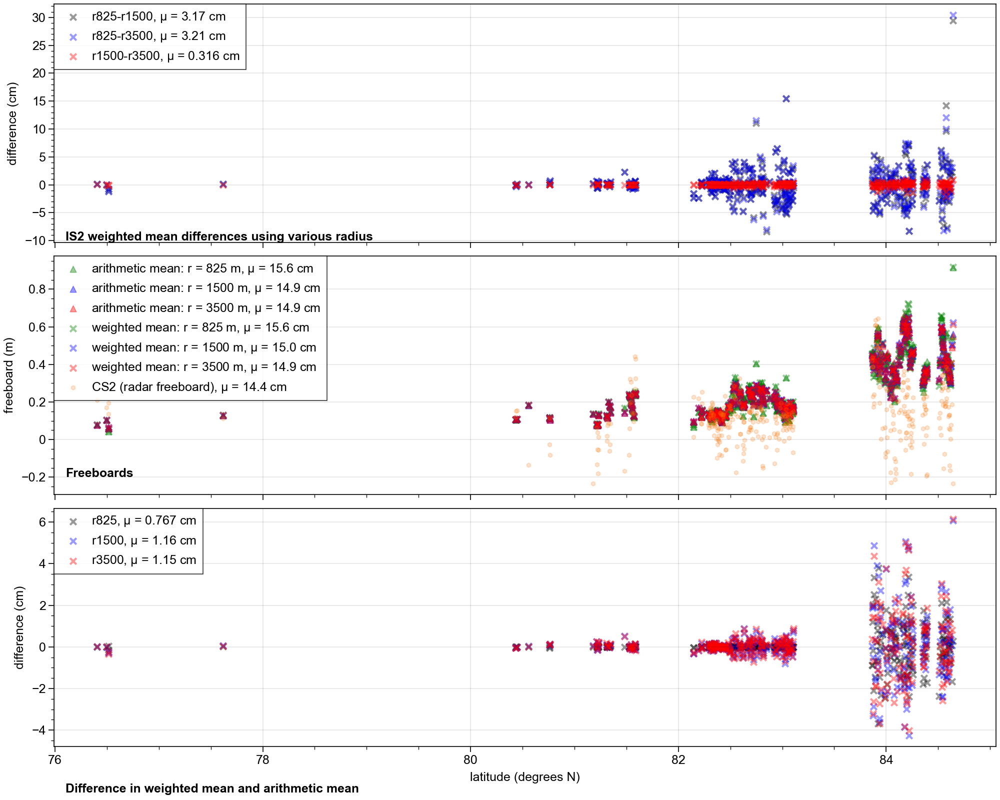

In [382]:
fig, axs= plt.subplots(3, 1,figsize=(10,8), constrained_layout=True, sharex=True)
axs[0].text(76.1, -10,'IS2 weighted mean differences using various radius', weight='bold')
axs[0].set_ylabel('difference (cm)')
axs[2].set_xlabel('latitude (degrees N)')
axs[0].scatter(df1['lat'],(df1['IS2_w_mean_fb_x']-df1['IS2_w_mean_fb_y'])*100, s= 20, marker="x", color='k', label =f'r825-r1500, $\mu$ = {std_xy:.3} cm',alpha=0.4)
axs[0].scatter(df1['lat'],(df1['IS2_w_mean_fb_x']-df1['IS2_w_mean_fb'])*100, s= 20, marker="x", color='b', label = f'r825-r3500, $\mu$ = {std_xz:.3} cm',alpha=0.4)
axs[0].scatter(df1['lat'],(df1['IS2_w_mean_fb_y']-df1['IS2_w_mean_fb'])*100, s= 20, marker="x", color='r', label = f'r1500-r3500, $\mu$ = {std_yz:.3} cm',alpha=0.4)
axs[0].legend()

axs[1].scatter(df1['lat'],(df1['IS2_fb_DTU21MSS_x']), s= 20, marker="^", color='g', alpha=0.4, label=f'arithmetic mean: r = 825 m, $\mu$ = {std_x:.3} cm')
axs[1].scatter(df1['lat'],(df1['IS2_fb_DTU21MSS_y']), s= 20, marker="^", color='b', alpha=0.4, label=f'arithmetic mean: r = 1500 m, $\mu$ = {std_y:.3} cm')
axs[1].scatter(df1['lat'],(df1['IS2_fb_DTU21MSS']), s= 20, marker="^", color='r', alpha=0.4, label=f'arithmetic mean: r = 3500 m, $\mu$ = {std_z:.3} cm')
axs[1].scatter(df1['lat'],(df1['IS2_w_fb_DTU21MSS_x']), s= 20, marker="x", color='g', alpha=0.4, label=f'weighted mean: r = 825 m, $\mu$ = {std_xw:.3} cm')
axs[1].scatter(df1['lat'],(df1['IS2_w_fb_DTU21MSS_y']), s= 20, marker="x", color='b', alpha=0.4, label=f'weighted mean: r = 1500 m, $\mu$ = {std_yw:.3} cm')
axs[1].scatter(df1['lat'],(df1['IS2_w_fb_DTU21MSS']), s= 20, marker="x", color='r', alpha=0.4, label=f'weighted mean: r = 3500 m, $\mu$ = {std_zw:.3} cm')

axs[1].scatter(df1['lat'],(df1['CS2_fb_DTU21MSS_x']),s= 10, marker="h", color='orange', alpha=0.2, label=f'CS2 (radar freeboard), $\mu$ = {std_CS2:.3} cm')
axs[1].set_ylabel('freeboard (m)')
axs[1].text(76.1, -0.2,'Freeboards', weight='bold')
axs[1].legend()

axs[2].scatter(df1['lat'],(df1['IS2_w_mean_fb_x']-df1['IS2_mean_fb_x'])*100, s= 20, marker="x", color='k', label =f'r825, $\mu$ = {std_xyw:.3} cm',alpha=0.4)
axs[2].scatter(df1['lat'],(df1['IS2_w_mean_fb_y']-df1['IS2_mean_fb_y'])*100, s= 20, marker="x", color='b', label = f'r1500, $\mu$ = {std_xzw:.3} cm',alpha=0.4)
axs[2].scatter(df1['lat'],(df1['IS2_w_mean_fb']-df1['IS2_mean_fb'])*100, s= 20, marker="x", color='r', label = f'r3500, $\mu$ = {std_yzw:.3} cm',alpha=0.4)
axs[2].legend()
axs[2].text(76.1, -7,'Difference in weighted mean and arithmetic mean', weight='bold')
axs[2].set_ylabel('difference (cm)')


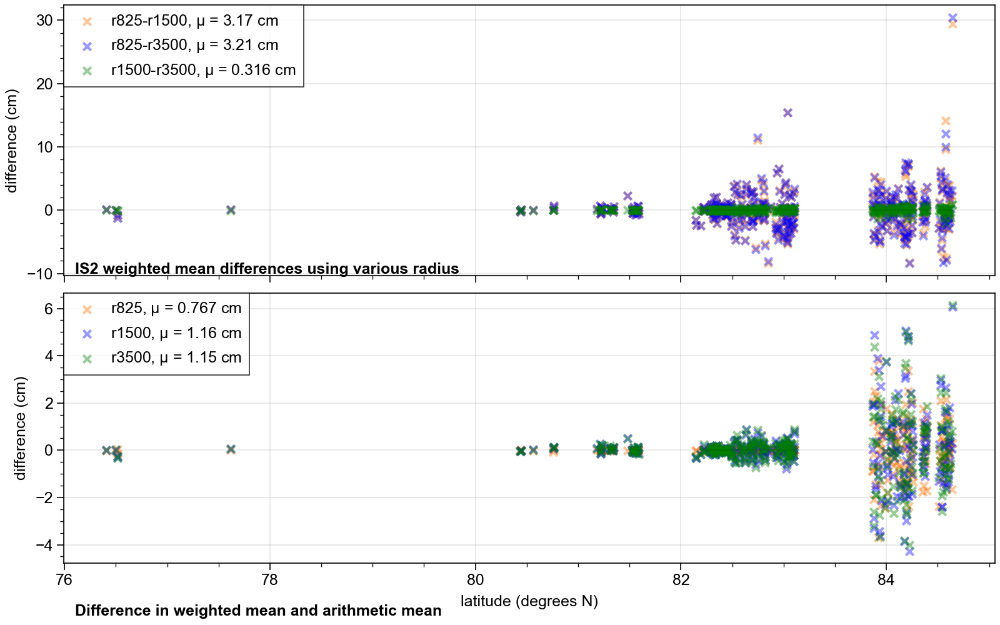

In [383]:
fig, axs= plt.subplots(2, 1,figsize=(8,5), constrained_layout=True, sharex=True)
axs[0].text(76.1, -10,'IS2 weighted mean differences using various radius', weight='bold')
axs[0].set_ylabel('difference (cm)')
axs[1].set_xlabel('latitude (degrees N)')
axs[0].scatter(df1['lat'],(df1['IS2_w_mean_fb_x']-df1['IS2_w_mean_fb_y'])*100, s= 20, marker="x", color='orange', label =f'r825-r1500, $\mu$ = {std_xy:.3} cm',alpha=0.4)
axs[0].scatter(df1['lat'],(df1['IS2_w_mean_fb_x']-df1['IS2_w_mean_fb'])*100, s= 20, marker="x", color='b', label = f'r825-r3500, $\mu$ = {std_xz:.3} cm',alpha=0.4)
axs[0].scatter(df1['lat'],(df1['IS2_w_mean_fb_y']-df1['IS2_w_mean_fb'])*100, s= 20, marker="x", color='g', label = f'r1500-r3500, $\mu$ = {std_yz:.3} cm',alpha=0.4)
axs[0].legend()


axs[1].scatter(df1['lat'],(df1['IS2_w_mean_fb_x']-df1['IS2_mean_fb_x'])*100, s= 20, marker="x", color='orange', label =f'r825, $\mu$ = {std_xyw:.3} cm',alpha=0.4)
axs[1].scatter(df1['lat'],(df1['IS2_w_mean_fb_y']-df1['IS2_mean_fb_y'])*100, s= 20, marker="x", color='b', label = f'r1500, $\mu$ = {std_xzw:.3} cm',alpha=0.4)
axs[1].scatter(df1['lat'],(df1['IS2_w_mean_fb']-df1['IS2_mean_fb'])*100, s= 20, marker="x", color='g', label = f'r3500, $\mu$ = {std_yzw:.3} cm',alpha=0.4)
axs[1].legend()
axs[1].text(76.1, -7,'Difference in weighted mean and arithmetic mean', weight='bold')
axs[1].set_ylabel('difference (cm)')

plt.savefig('E:\demo_CRYO2ICE_radii.png', transparent=True)

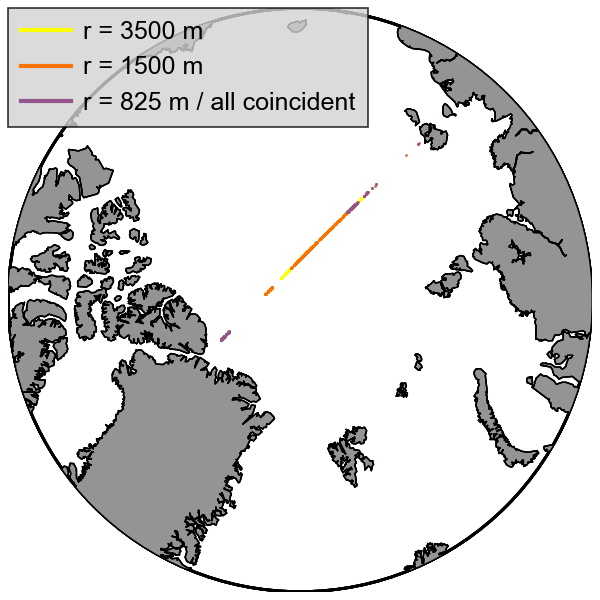

In [211]:
fig, ax = plt.subplots(figsize=(3,3), constrained_layout=True)
from matplotlib.lines import Line2D
im=plot_panArctic2(np.array(df3['lon']), np.array(df3['lat']), 'yellow', 0, 5, 'viridis', 'radar freeboard (m)','max', ax,fig)
im=plot_panArctic2(np.array(df2['lon']), np.array(df2['lat']), 'orange', 0, 5, 'viridis', 'radar freeboard (m)','max', ax,fig)

#plot_panArctic2(lon_gt2l, lat_gt2l, 'grey', 0, 0.5, 'viridis', 'radar freeboard (m)','max', ax[1],fig)
im=plot_panArctic2(np.array(df1['lon']), np.array(df1['lat']), 'purple', 0, 5, 'viridis', 'radar freeboard (m)','max', ax,fig)
#ax[0].legend(['CS2', 'IS2', 'CRYO2ICE'])

legend_elements = [Line2D([0], [0], color='yellow', label='r = 3500 m'),
                  Line2D([0], [0], color='orange', label='r = 1500 m'),
                  Line2D([0], [0], color='purple', label='r = 825 m / all coincident')]
ax.legend(handles=legend_elements, loc='best', facecolor='lightgrey')
#ax.set_title('CRYO2ICE location')

plt.savefig('E:\demo_CRYO2ICE_location_searchradius.png', transparent=True)

In [363]:
df_LARM = pd.read_csv(r'E:\DTU\CRYO2ICE\LARM\UiT_LARM_Cryo2Ice_L2_2021_04.txt', delimiter=',', header=0)

len(df_LARM[' Day'].unique())

24

In [50]:
### November
#fp1 = r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_original_MSS\FINAL_SMLG_AMSR2_CCI_LARM_v2\November\CRYO2ICE_CRYO2ICE_CS_OFFL_SIR_SAR_2__20201110T090903_20201110T091432_D001_original_MSS_time_LARM_AMSR2_SMLG_final_v2.csv'
#df_jan = pd.read_csv(fp1, index_col=None, header=0)
#n1, n2 = 500, 1350
#df_jan_short = df_jan[500:1350]

## January
#fp1 = r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_original_MSS\FINAL_SMLG_AMSR2_CCI_LARM_v2\January\CRYO2ICE_CRYO2ICE_CS_OFFL_SIR_SAR_2__20210130T133202_20210130T134203_D001_original_MSS_time_LARM_AMSR2_SMLG_final_v2.csv'
#df_jan = pd.read_csv(fp1, index_col=None, header=0)
#n1, n2 = 500, 1000
#df_jan_short = df_jan[n1:n2]

## March 
fp1 = r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_original_MSS\FINAL_SMLG_AMSR2_CCI_LARM_v2\March\CRYO2ICE_CRYO2ICE_CS_OFFL_SIR_SAR_2__20210317T093327_20210317T094059_D001_original_MSS_time_LARM_AMSR2_SMLG_final_v2.csv'
df_jan = pd.read_csv(fp1, index_col=None, header=0)
n1, n2 = 500, 1350
df_jan_short = df_jan[500:1350]

basename_without_ext = os.path.splitext(os.path.basename(fp1))[0]
txt1 = basename_without_ext.split('_')[9]
ID_CS2=np.int(txt1.split('T')[1])

#df_jan_short = df_jan_short[df_jan_short['fb']>0]
#df_jan_short['LARM_rfb'][df_jan_short['LARM_rfb']<0]= np.nan
#df_jan_short['CCI_rfb'][df_jan_short['CCI_rfb']<0]= np.nan

from datetime import datetime
# miles/s to m/s (multipy with 1609)
speed_CS2_m_pr_s = 4.35*1609
speed_CS2_m_pr_s

df_test = df_jan_short.reset_index()
diff_t_total = []
for i in df_test['time']:
    diff_t = datetime.strptime(df_test['time'][0],"%Y-%m-%d %H:%M:%S.%f")-datetime.strptime(i,"%Y-%m-%d %H:%M:%S.%f")
    diff_t_total = np.append(diff_t_total, diff_t.total_seconds())
along_track_dist =  np.abs(diff_t_total)*speed_CS2_m_pr_s

df_jan_short['along_track_dist_in_metres'] = along_track_dist
df_jan_short['along_track_dist_in_km'] = along_track_dist/1e3

C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/1853135343.py:21: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  ID_CS2=np.int(txt1.split('T')[1])


In [51]:
#fp1 = r'E:\DTU\CRYO2ICE\Data\CS_OFFL_SIR_SAR_2__20201110T090903_20201110T091432_D001.nc'
#fp1 = r'E:\DTU\CRYO2ICE\Data\CS_OFFL_SIR_SAR_2__20210130T133202_20210130T134203_D001.nc'
fp1 = r'E:\DTU\CRYO2ICE\Data\CS_OFFL_SIR_SAR_2__20210317T093327_20210317T094059_D001.nc'

ds = netCDF4.Dataset(fp1, 'r')
CS2_lead = ds.variables['height_sea_ice_lead_20_ku'][:]
lat_lead = ds.variables['lat_poca_20_ku'][:]
lon_lead = ds.variables['lon_poca_20_ku'][:]
df_CS2_lead_jan = pd.DataFrame({'lead_CS2':CS2_lead, 'lat':lat_lead, 'lon':lon_lead})

df_CS2_lead_check_jan = df_CS2_lead_jan[(df_CS2_lead_jan['lat']>df_jan_short['lat'].min()) & (df_CS2_lead_jan['lat']<df_jan_short['lat'].max()) & (df_CS2_lead_jan['lon']>df_jan_short['lon'].min()) & (df_CS2_lead_jan['lon']<df_jan_short['lon'].max())]

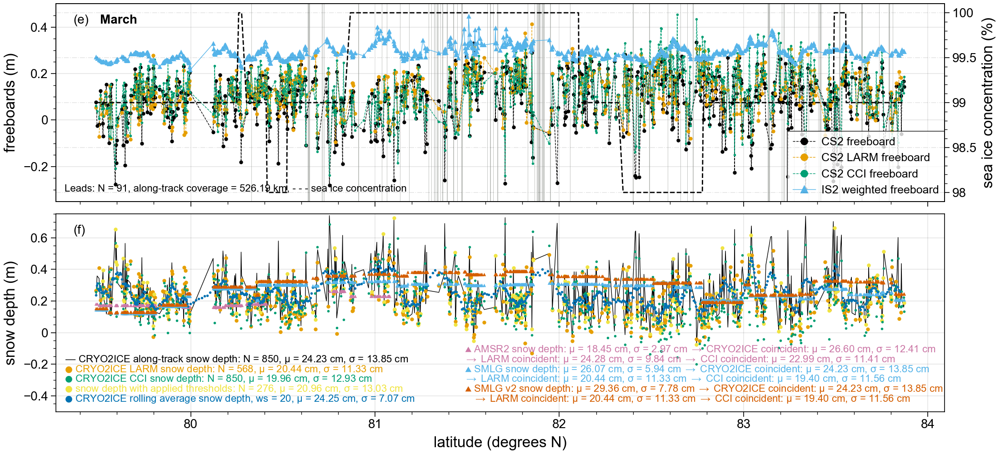

In [53]:
import proplot as pplot
from matplotlib.colors import LinearSegmentedColormap
fig, axs = plt.subplots(2, figsize=(11,5), constrained_layout=True)
#axs[0].plot(df_IS2_new['lat'], df_IS2_new['fb'], c='grey', ls='', marker='.', markersize=0.8)

#cmap_qual = plt.get_cmap('538')
cmap_qual = ['#E69F00', '#56B4E9', '#009E73', '#F0E442', '#0072B2', '#D55E00', '#CC79A7', 'darkorange']
cmap_qual = LinearSegmentedColormap.from_list('list', cmap_qual, N = len(cmap_qual))

ax2 = axs[0].twinx()
axs[0].plot(df_jan_short['lat'], df_jan_short['fb'] ,'o', c='k', markersize=2, ls='--', lw=0.5)
axs[0].plot(df_jan_short['lat'],df_jan_short['LARM_rfb'], 'o',c=cmap_qual(0), markersize=2, ls='--', lw=0.5)
axs[0].plot(df_jan_short['lat'],df_jan_short['CCI_rfb'], 'o',c=cmap_qual(2), markersize=1, ls='--', lw=0.5)
axs[0].plot(df_jan_short['lat'],df_jan_short['IS2_w_mean_fb_MSS'], '^',c=cmap_qual(1), markersize=2, ls='-', lw=0.5)
axs[0].vlines(df_CS2_lead_check_jan[df_CS2_lead_check_jan['lead_CS2']>0]['lat'], -0.5, 1,ls='-', color='grey', linewidth=0.2, label='_nolegend_')
ax2.plot(df_jan_short['lat'],df_jan_short['AMSR2_SIC'], c='k', ls='--', lw=1)
ax2.set_ylabel('sea ice concentration (%)', color='k', fontsize=12)
ax2.grid(ls='-.')

axs[1].plot(df_jan_short['lat'],df_jan_short['snow_depth_original_MSS'] , c='k',ls='-', linewidth=0.5)
axs[1].plot(df_jan_short['lat'],df_jan_short['snow_depth_original_MSS_LARM'] , 'o', c=cmap_qual(0), markersize=2)
axs[1].plot(df_jan_short[(df_jan_short['ppk']<9) & (df_jan_short['ssd']>6.29)]['lat'],df_jan_short[(df_jan_short['ppk']<9) & (df_jan_short['ssd']>6.29)]['snow_depth_original_MSS'] , 'o', c=cmap_qual(3), markersize=2)
axs[1].plot(df_jan_short['lat'],df_jan_short['snow_depth_original_MSS_CCI'] , 'o', c=cmap_qual(2), markersize=1)
axs[1].plot(df_jan_short['lat'],(df_jan_short['AMSR2_snow_depth'])/100 ,'^', c=cmap_qual(6),markersize=1)
rolling_df = df_jan_short.rolling(window=10, min_periods=1).mean()
axs[1].plot(rolling_df['lat'],(rolling_df['snow_depth_original_MSS']) ,'o', c=cmap_qual(4),markersize=1)
axs[1].plot(df_jan_short['lat'],(df_jan_short['SMLG_snow_depth']) ,'^', c=cmap_qual(1),markersize=1)
axs[1].plot(df_jan_short['lat'],(df_jan_short['SMLG_snow_depth_v2']) ,'^', c=cmap_qual(5),markersize=1)


df_jan_short_restrict = df_jan_short[(df_jan_short['ppk']<9) & (df_jan_short['ssd']>6.29)]
rolling_df_restrict = df_jan_short_restrict.rolling(window=20, min_periods=1).mean()
#axs[1].plot(rolling_df_restrict['lat'],(rolling_df_restrict['snow_depth_original_MSS']) ,'o', c=cmap_qual(5),markersize=1)


#axs[1].plot(df3_short['lead_CS2'], 'o')
axs[0].set_ylim(-0.35, 0.5)
axs[1].set_ylim(-0.5, 0.75)


df_jan_AMSR2_points = df_jan_short[df_jan_short['AMSR2_snow_depth'].notna()]
df_jan_SMLG_points = df_jan_short[df_jan_short['SMLG_snow_depth'].notna()]
df_jan_LARM_points = df_jan_SMLG_points[df_jan_SMLG_points['LARM_rfb'].notna()]
df_jan_CCI_points = df_jan_LARM_points[df_jan_LARM_points['LARM_rfb'].notna()]


txt_CRYO2ICE =u"$\u23e4$ "+r'CRYO2ICE along-track snow depth: N = {}, $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(len(df_jan_short['snow_depth_original_MSS']), np.nanmean(df_jan_short['snow_depth_original_MSS'])*100, np.nanstd(df_jan_short['snow_depth_original_MSS'])*100)
txt_CRYO2ICE_LARM =u"$\u26ab$ "+r'CRYO2ICE LARM snow depth: N = {}, $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(len(df_jan_short[df_jan_short['LARM_rfb'].notna()]), np.nanmean(df_jan_short['snow_depth_original_MSS_LARM'])*100, np.nanstd(df_jan_short['snow_depth_original_MSS_LARM'])*100)
txt_CRYO2ICE_CCI =u"$\u26ab$ "+r'CRYO2ICE CCI snow depth: N = {}, $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(len(df_jan_short[df_jan_short['CCI_rfb'].notna()]), np.nanmean(df_jan_short['snow_depth_original_MSS_CCI'])*100, np.nanstd(df_jan_short['snow_depth_original_MSS_CCI'])*100)
txt_CRYO2ICE_thresholds = u"$\u26ab$ "+r'snow depth with applied thresholds: N = {}, $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(len(df_jan_short_restrict['snow_depth_original_MSS']), np.nanmean(df_jan_short_restrict['snow_depth_original_MSS'])*100, np.nanstd(df_jan_short_restrict['snow_depth_original_MSS'])*100)
txt_AMSR2 = r'$\blacktriangle$ AMSR2 snow depth: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm $\rightarrow$ CRYO2ICE coincident: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format( np.nanmean(df_jan_AMSR2_points['AMSR2_snow_depth']), np.nanstd(df_jan_AMSR2_points['AMSR2_snow_depth']), np.nanmean(df_jan_AMSR2_points['snow_depth_original_MSS'])*100, np.nanstd(df_jan_AMSR2_points['snow_depth_original_MSS'])*100)
txt_CRYO2ICE_rolling = u"$\u26ab$ "+'CRYO2ICE rolling average snow depth, ws = 20, $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(rolling_df['snow_depth_original_MSS'])*100, np.nanstd(rolling_df['snow_depth_original_MSS'])*100)
txt_CRYO2ICE_rolling_restrict = u"$\u26ab$ "+'CRYO2ICE rolling average snow depth w/ thresholds, ws = 10, $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(rolling_df_restrict['snow_depth_original_MSS'])*100, np.nanstd(rolling_df_restrict['snow_depth_original_MSS'])*100)
txt_SMLG = r'$\blacktriangle$ SMLG snow depth: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm $\rightarrow$ CRYO2ICE coincident: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format( np.nanmean(df_jan_SMLG_points['SMLG_snow_depth']*100), np.nanstd(df_jan_SMLG_points['SMLG_snow_depth']*100), np.nanmean(df_jan_SMLG_points['snow_depth_original_MSS'])*100, np.nanstd(df_jan_SMLG_points['snow_depth_original_MSS'])*100)
txt_AMSR2_LARM_CCI = r'$\rightarrow$ LARM coincident: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm $\rightarrow$ CCI coincident: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(df_jan_AMSR2_points['snow_depth_original_MSS_LARM'])*100, np.nanstd(df_jan_AMSR2_points['snow_depth_original_MSS_LARM'])*100, np.nanmean(df_jan_AMSR2_points['snow_depth_original_MSS_CCI'])*100, np.nanstd(df_jan_AMSR2_points['snow_depth_original_MSS_CCI'])*100)
txt_SMLG_LARM_CCI = r'$\rightarrow$ LARM coincident: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm $\rightarrow$ CCI coincident: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format( np.nanmean(df_jan_LARM_points['snow_depth_original_MSS_LARM']*100), np.nanstd(df_jan_LARM_points['snow_depth_original_MSS_LARM']*100), np.nanmean(df_jan_CCI_points['snow_depth_original_MSS_CCI']*100), np.nanstd(df_jan_CCI_points['snow_depth_original_MSS_CCI']*100))

txt_SMLG_v2 = r'$\blacktriangle$ SMLG v2 snow depth: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm $\rightarrow$ CRYO2ICE coincident: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format( np.nanmean(df_jan_SMLG_points['SMLG_snow_depth_v2']*100), np.nanstd(df_jan_SMLG_points['SMLG_snow_depth_v2']*100), np.nanmean(df_jan_SMLG_points['snow_depth_original_MSS'])*100, np.nanstd(df_jan_SMLG_points['snow_depth_original_MSS'])*100)
txt_SMLG_LARM_CCI_v2 = r'$\rightarrow$ LARM coincident: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm $\rightarrow$ CCI coincident: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format( np.nanmean(df_jan_LARM_points['snow_depth_original_MSS_LARM']*100), np.nanstd(df_jan_LARM_points['snow_depth_original_MSS_LARM']*100), np.nanmean(df_jan_CCI_points['snow_depth_original_MSS_CCI']*100), np.nanstd(df_jan_CCI_points['snow_depth_original_MSS_CCI']*100))



font_size_snow = 8
axs[1].text(0.01, 0.25, txt_CRYO2ICE, transform = axs[1].transAxes, fontsize=font_size_snow, color='k')
axs[1].text(0.01, 0.2, txt_CRYO2ICE_LARM, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(0))
axs[1].text(0.01, 0.15, txt_CRYO2ICE_CCI, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(2))
axs[1].text(0.01, 0.10, txt_CRYO2ICE_thresholds, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(3))
axs[1].text(0.01, 0.05, txt_CRYO2ICE_rolling, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(4))
#axs[1].text(0.01, 0.05, txt_CRYO2ICE_rolling_restrict, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(5))

axs[1].text(0.46, 0.3, txt_AMSR2, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(6))
axs[1].text(0.46, 0.25, txt_AMSR2_LARM_CCI, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(6))
axs[1].text(0.46, 0.20, txt_SMLG, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(1))
axs[1].text(0.46, 0.15, txt_SMLG_LARM_CCI, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(1))
axs[1].text(0.46, 0.10, txt_SMLG_v2, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(5))
axs[1].text(0.47, 0.05, txt_SMLG_LARM_CCI, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(5))

axs[0].set_ylabel('freeboards (m)', fontsize=12)
axs[1].set_ylabel('snow depth (m)', fontsize=12)


#legend=axs[1].legend([txt_CRYO2ICE,txt_CRYO2ICE_LARM, txt_CRYO2ICE_thresholds, txt_AMSR2], loc='best', scatterpoints=3)
#axs[0].set_ylim(df_jan_short['fb'].min()-0.1, df_jan_short['IS2_w_mean_fb_MSS'].max()+0.1)
#axs[0].set_xlim(87.5, 82.5)
axs[1].set_xlabel('latitude (degrees N)',  fontsize=12)

axs[0].text(0.02, 0.9, '(e)', transform = axs[0].transAxes, fontsize=10)
axs[1].text(0.02, 0.9, '(f)', transform = axs[1].transAxes, fontsize=10)

along_track_dist = np.abs(df_jan_short['along_track_dist_in_km'].iloc[-1])
axs[0].text(0.05, 0.9, 'March', transform = axs[0].transAxes, fontsize=10,weight='bold')
axs[0].text(0.01, 0.05, 'Leads: N = {}, along-track coverage = {:.2f} km'.format(len(df_CS2_lead_check_jan[df_CS2_lead_check_jan['lead_CS2']>0]),along_track_dist)+ ", - - - sea ice concentration", transform = axs[0].transAxes, fontsize=font_size_snow)



axs[0].tick_params(labelsize=10)
axs[1].tick_params(labelsize=10)
ax2.tick_params(labelsize=10)
#ax3.tick_params(labelsize=10)


legend=axs[0].legend(['CS2 freeboard', 'CS2 LARM freeboard', 'CS2 CCI freeboard','IS2 weighted freeboard'], loc='lower right', scatterpoints=3)
legend.legendHandles[0]._legmarker.set_markersize(5)
legend.legendHandles[1]._legmarker.set_markersize(5)
legend.legendHandles[2]._legmarker.set_markersize(5)
legend.legendHandles[3]._legmarker.set_markersize(5)

plt.setp(axs[0].get_xticklabels(), visible=False)
plt.savefig('E:\demo_CRYO2ICE_roughness_including_leads_mar_r3500_original_MSS_v2_final.png', transparent=True)     

In [135]:
print(len(df_jan_AMSR2_points))

238


In [ ]:
def plot_panArctic6(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90
    cmap1 = plt.get_cmap('greys', 4)

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=75,lon_0=0, resolution='i',ax=ax, round=True)
    m.drawmeridians(np.arange(0,360,30),labels=[0,0,0,0],linewidth=0.5, fontsize=10, dashes=[1,5])
    m.drawparallels(np.arange(-90,90,15),linewidth=0.5, fontsize=10, dashes=[1,5],labels=[0,0,0,0])
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='lightgray')
    #m.fillcontinents(color='darkgray')
    m.drawmapboundary(fill_color='black')
    #cbar = m.etopo()
    x=m.scatter(lon, lat, latlon=True, c=sit, s=5,vmin = min_set, vmax=max_set, cmap=cmap_set, zorder=1)
     #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x

def plot_panArctic7(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90
    cmap1 = plt.get_cmap('greys', 4)

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=75,lon_0=0, resolution='i',ax=ax, round=True)
    m.drawmeridians(np.arange(0,360,30),labels=[0,0,0,0],linewidth=0.5, fontsize=10, dashes=[1,5])
    m.drawparallels(np.arange(-90,90,15),linewidth=0.5, fontsize=10, dashes=[1,5],labels=[0,0,0,0])
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='lightgray')
    #m.fillcontinents(color='darkgray')
    m.drawmapboundary(fill_color='black')
    #cbar = m.etopo()
    x=m.scatter(lon, lat, latlon=True, c=sit, s=50,vmin = min_set, vmax=max_set, cmap=cmap_set, zorder=1, marker='X')
     #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x

from matplotlib.lines import Line2D
fig, ax = plt.subplots(figsize=(8,5), constrained_layout=True)
title = ''
cmap_qual = plt.get_cmap('538')
im = plot_panArctic6(np.array(df_jan['lon']), np.array(df_jan['lat']), 'grey', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic6(np.array(df_jan['lon'])[n1:n2], np.array(df_jan['lat'])[n1:n2], 'white', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic7(np.array(df_jan['lon'])[n1], np.array(df_jan['lat'])[n1], cmap_qual(0), 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic7(np.array(df_jan['lon'])[n2], np.array(df_jan['lat'])[n2], cmap_qual(1), 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)

plt.savefig('E:\demo_CRYO2ICE_roughness_location_nov2020_original_MSS.png', transparent=True)

In [16]:
basename_without_ext = os.path.splitext(os.path.basename(fp1))[0]
txt1 = basename_without_ext.split('_')[:]
txt1

['CRYO2ICE',
 'CRYO2ICE',
 'CS',
 'OFFL',
 'SIR',
 'SAR',
 '2',
 '',
 '20201110T090903',
 '20201110T091432',
 'D001',
 'original',
 'MSS',
 'LARM',
 'AMSR2',
 'SMLG',
 'final']

In [122]:
df_LARM = pd.read_csv(r'E:\DTU\CRYO2ICE\LARM\UiT_LARM_Cryo2Ice_L2_2020_11.txt', delimiter=',', header=0)

df_LARM_restrict=df_LARM[(df_LARM[' HHMMSS']==ID_CS2) & (df_LARM[' Sea_Ice_Class']==1)]
df_LARM_new = pd.DataFrame({'lon':df_LARM_restrict[' Longitude'], 'lat':df_LARM_restrict[' Latitude'], 'LARM_rfb':df_LARM_restrict[' Radar_Freeboard'], 'LARM_roughness':df_LARM_restrict[' Sea_Ice_Roughness_Lognormal']})

df_jan_short['lat']=round(df_jan_short['lat'],5)
df_jan_short['lon']=round(df_jan_short['lon'],5)
df_LARM_new['lat']=round(df_LARM_new['lat'],5)
df_LARM_new['lon']=round(df_LARM_new['lon'],5)
df_jan_short=pd.merge(df_jan_short, df_LARM_new, on=["lon", "lat"], how="left")
df_jan_short

,Unnamed: 0,index,lat,lon,fb,mss,fb_no_mss,ssd,ppk,IS2_mean_fb,IS2_w_mean_fb,IS2_mean_gw,IS2_mean_MSS,IS2_w_mean_fb_MSS,snow_depth_original_MSS,LARM_rfb,LARM_roughness
0,1077,1077,87.40797,-174.02542,0.252,10.257,-10.005,48.41,7.837376,-10.687024,-10.683323,0.132611,11.051328,0.368006,0.143062,0.215588,0.441999
1,1078,1078,87.40626,-174.07197,0.146,10.257,-10.111,44.22,7.532206,-10.685947,-10.683436,0.132651,11.050968,0.367532,0.273201,0.169963,0.678282
2,1079,1079,87.40454,-174.11846,0.129,10.257,-10.128,45.93,8.971369,-10.683539,-10.682690,0.133007,11.050640,0.367950,0.294682,0.109355,0.262086
3,1080,1080,87.40282,-174.16488,0.230,10.257,-10.027,23.13,12.653894,-10.686558,-10.685314,0.133109,11.050329,0.365015,0.166506,0.257524,0.110613
4,1081,1081,87.39592,-174.34998,0.139,10.256,-10.117,27.03,10.715370,-10.691316,-10.691669,0.131673,11.049432,0.357763,0.269786,0.112720,0.098702
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
845,1922,1922,83.04214,151.61242,-0.024,3.078,-3.102,30.68,14.802918,-3.707592,-3.706225,0.110138,3.857693,0.151468,0.216394,0.024366,0.108054
846,1923,1923,83.03955,151.60577,0.061,3.078,-3.017,33.40,11.095535,-3.698888,-3.698906,0.111147,3.854076,0.155170,0.116134,0.078230,0.110855
847,1924,1924,83.03695,151.59912,0.084,3.078,-2.994,32.06,7.677520,-3.695196,-3.694169,0.111081,3.850468,0.156299,0.089162,NaN,NaN
848,1925,1925,83.03436,151.59248,0.035,3.078,-3.043,28.81,11.973218,-3.688211,-3.688556,0.111388,3.846834,0.158278,0.152031,0.032855,0.071627


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


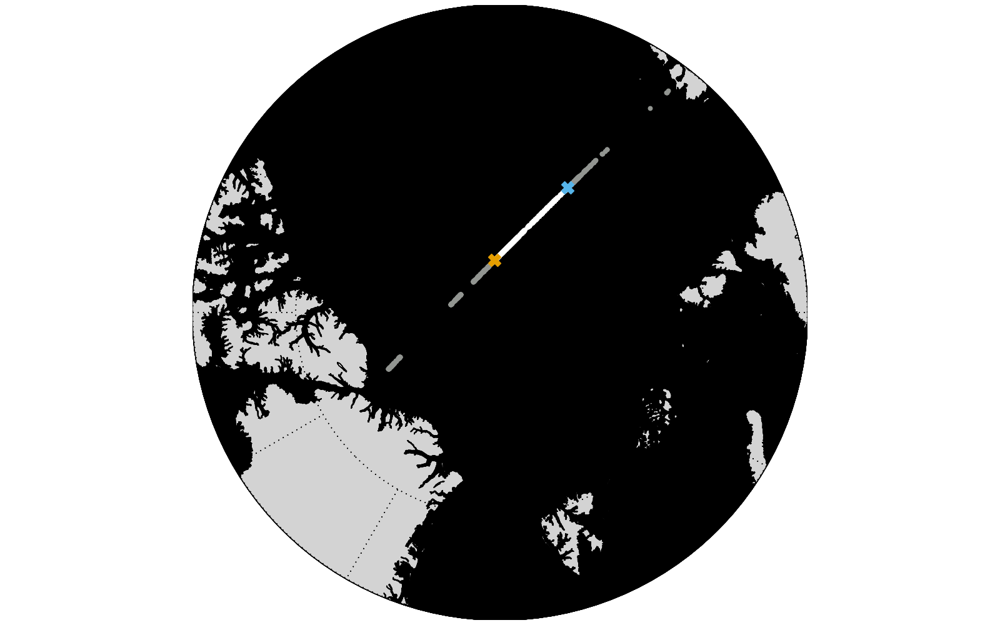

In [105]:
def plot_panArctic6(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90
    cmap1 = plt.get_cmap('greys', 4)

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=75,lon_0=0, resolution='i',ax=ax, round=True)
    m.drawmeridians(np.arange(0,360,30),labels=[0,0,0,0],linewidth=0.5, fontsize=10, dashes=[1,5])
    m.drawparallels(np.arange(-90,90,15),linewidth=0.5, fontsize=10, dashes=[1,5],labels=[0,0,0,0])
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='lightgray')
    #m.fillcontinents(color='darkgray')
    m.drawmapboundary(fill_color='black')
    #cbar = m.etopo()
    x=m.scatter(lon, lat, latlon=True, c=sit, s=5,vmin = min_set, vmax=max_set, cmap=cmap_set, zorder=1)
     #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x

def plot_panArctic7(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90
    cmap1 = plt.get_cmap('greys', 4)

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=75,lon_0=0, resolution='i',ax=ax, round=True)
    m.drawmeridians(np.arange(0,360,30),labels=[0,0,0,0],linewidth=0.5, fontsize=10, dashes=[1,5])
    m.drawparallels(np.arange(-90,90,15),linewidth=0.5, fontsize=10, dashes=[1,5],labels=[0,0,0,0])
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='lightgray')
    #m.fillcontinents(color='darkgray')
    m.drawmapboundary(fill_color='black')
    #cbar = m.etopo()
    x=m.scatter(lon, lat, latlon=True, c=sit, s=50,vmin = min_set, vmax=max_set, cmap=cmap_set, zorder=1, marker='X')
     #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x

from matplotlib.lines import Line2D
fig, ax = plt.subplots(figsize=(8,5), constrained_layout=True)
title = ''
#cmap_qual = plt.get_cmap('538')
im = plot_panArctic6(np.array(df_jan['lon']), np.array(df_jan['lat']), 'grey', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic6(np.array(df_jan['lon'])[n1:n2], np.array(df_jan['lat'])[n1:n2], 'white', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic7(np.array(df_jan['lon'])[n1], np.array(df_jan['lat'])[n1], cmap_qual(0), 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic7(np.array(df_jan['lon'])[n2], np.array(df_jan['lat'])[n2], cmap_qual(1), 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)

plt.savefig('E:\demo_CRYO2ICE_roughness_location_nov2020_original_MSS.png', transparent=True)

In [19]:
print(len(df_jan_short))
print(len(df_jan_short[(df_jan_short['ppk']<9) & (df_jan_short['ssd']>6.29)]))
print((np.mean(df_jan_short['snow_depth_w_DTU21MSS'])*100))
print((np.mean(df_jan_short[(df_jan_short['ppk']<9) & (df_jan_short['ssd']>6.29)]['snow_depth_w_DTU21MSS']))*100)
print((np.std(df_jan_short['snow_depth_w_DTU21MSS']))*100)
print((np.std(df_jan_short[(df_jan_short['ppk']<9) & (df_jan_short['ssd']>6.29)]['snow_depth_w_DTU21MSS']))*100)

850
318


KeyError: 'snow_depth_w_DTU21MSS'

In [49]:
print(df_jan_short['lat'].min())
print(df_jan_short['lat'].max())
print(df_jan_short['lon'].min())
print(df_jan_short['lon'].max())

81.12812
85.01539
164.00622
175.02533


In [124]:
df_jan_short.corr()

,Unnamed: 0,index,lat,lon,fb,mss,fb_no_mss,ssd,ppk,IS2_mean_fb,IS2_w_mean_fb,IS2_mean_gw,IS2_mean_MSS,IS2_w_mean_fb_MSS,snow_depth_original_MSS,LARM_rfb,LARM_roughness
Unnamed: 0,1.000000,1.000000,-0.972956,0.493356,-0.242410,-0.977419,0.976994,-0.466649,0.238884,0.978354,0.978470,-0.641144,-0.978323,-0.781458,-0.203049,-0.320607,-0.276256
index,1.000000,1.000000,-0.972956,0.493356,-0.242410,-0.977419,0.976994,-0.466649,0.238884,0.978354,0.978470,-0.641144,-0.978323,-0.781458,-0.203049,-0.320607,-0.276256
lat,-0.972956,-0.972956,1.000000,-0.364013,0.247303,0.986972,-0.986421,0.482847,-0.212990,-0.986327,-0.986552,0.642840,0.986707,0.798896,0.208078,0.358311,0.264486
lon,0.493356,0.493356,-0.364013,1.000000,-0.113475,-0.370474,0.369270,-0.155562,0.155761,0.373851,0.373849,-0.302187,-0.373732,-0.296379,-0.056231,-0.075673,-0.214927
fb,-0.242410,-0.242410,0.247303,-0.113475,1.000000,0.261523,-0.216232,0.296754,-0.308144,-0.262677,-0.262602,0.118821,0.262999,0.225546,-0.838637,0.771595,0.255757
mss,-0.977419,-0.977419,0.986972,-0.370474,0.261523,1.000000,-0.998912,0.483072,-0.238065,-0.999373,-0.999368,0.614381,0.999663,0.814310,0.202977,0.350769,0.266086
fb_no_mss,0.976994,0.976994,-0.986421,0.369270,-0.216232,-0.998912,1.000000,-0.474314,0.225927,0.998222,0.998221,-0.615735,-0.998500,-0.812817,-0.245836,-0.325781,-0.258072
ssd,-0.466649,-0.466649,0.482847,-0.155562,0.296754,0.483072,-0.474314,1.000000,-0.703916,-0.483348,-0.483501,0.239617,0.484694,0.432051,-0.044732,0.329710,0.655627
ppk,0.238884,0.238884,-0.212990,0.155761,-0.308144,-0.238065,0.225927,-0.703916,1.000000,0.237904,0.237670,-0.004046,-0.239048,-0.241108,0.162476,-0.305284,-0.753611
IS2_mean_fb,0.978354,0.978354,-0.986327,0.373851,-0.262677,-0.999373,0.998222,-0.483348,0.237904,1.000000,0.999995,-0.607980,-0.999860,-0.799183,-0.193406,-0.347046,-0.263409


In [8]:
#fname = 'E:/DTU/CRYO2ICE/Data/AMSR2/AMSR_U2_L3_SeaIce12km_B04_20210130.he5'
fname = 'E:/DTU/CRYO2ICE/Data/AMSR2/AMSR_U2_L3_SeaIce12km_B04_20201110.he5'
#fname = r'E:\DTU\CRYO2ICE\Data\AMSR2\AMSR2_monthly_data\March\AMSR_U2_L3_SeaIce12km_B04_20210317.he5'
file = h5py.File(fname, 'r')
file.keys()
lon = np.array(file['HDFEOS/GRIDS/NpPolarGrid12km/lon'])
lat = np.array(file['HDFEOS/GRIDS/NpPolarGrid12km/lat'])
snow_depth = np.array(file['HDFEOS/GRIDS/NpPolarGrid12km/Data Fields/SI_12km_NH_SNOWDEPTH_5DAY'])
sea_ice_concentration= np.array(file['HDFEOS/GRIDS/NpPolarGrid12km/Data Fields/SI_12km_NH_ICECON_DAY'])
file.close()

FileNotFoundError: [Errno 2] Unable to open file (unable to open file: name = 'E:/DTU/CRYO2ICE/Data/AMSR2/AMSR_U2_L3_SeaIce12km_B04_20201110.he5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

In [126]:
missing_snow_depth  = np.where(snow_depth != 110, np.nan, snow_depth)
land_snow_depth  = np.where(snow_depth != 120, np.nan, snow_depth)
OW_snow_depth  = np.where(snow_depth != 130, np.nan, snow_depth)
MYI_snow_depth  = np.where(snow_depth != 140, np.nan, snow_depth)
variability_snow_depth  = np.where(snow_depth != 150, np.nan, snow_depth)
melt_snow_depth  = np.where(snow_depth != 160, np.nan, snow_depth)
snow_depth_only  = np.where(snow_depth > 100, np.nan, snow_depth)

sea_ice_concentration_only = np.where(sea_ice_concentration > 100, np.nan, sea_ice_concentration)

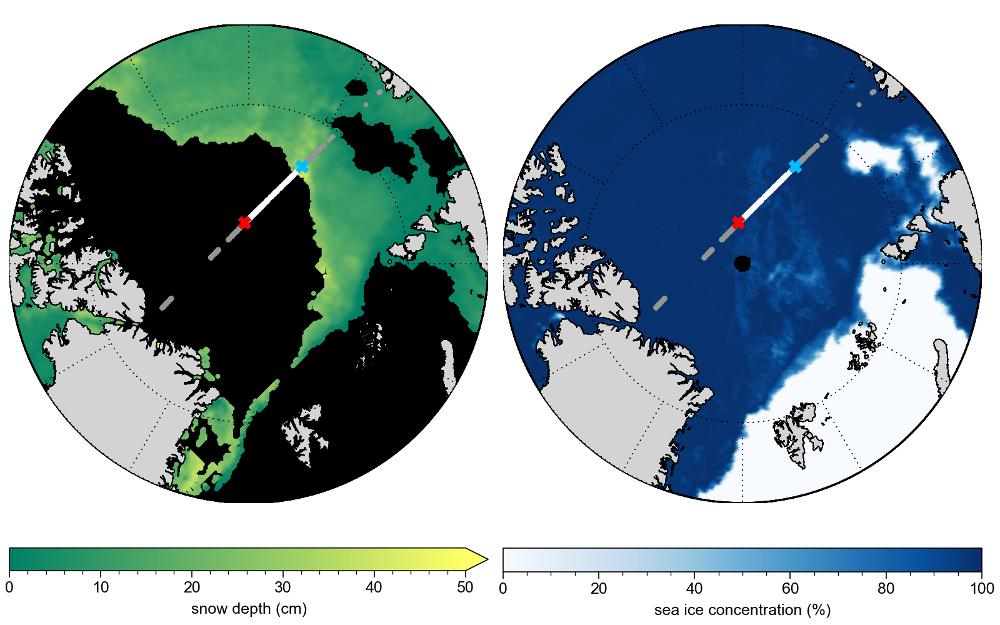

In [365]:
def plot_panArctic8(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90
    
    lat_new = np.where(sit == np.nan, np.nan, lat)
    lon_new = np.where(sit == np.nan, np.nan, lon)

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=75,lon_0=0, resolution='i',ax=ax, round=True)
    m.drawmeridians(np.arange(0,360,30),labels=[0,0,0,0],linewidth=0.5, fontsize=10, dashes=[1,5])
    m.drawparallels(np.arange(-90,90,15),linewidth=0.5, fontsize=10, dashes=[1,5],labels=[0,0,0,0])
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='lightgray')
    #m.fillcontinents(color='darkgray')
    m.drawmapboundary(fill_color='white')
    #cbar = m.etopo()
    x=m.scatter(lon_new, lat_new, latlon=True, c=cmap_set, s=50, zorder=1, marker='.')
     #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x

def plot_panArctic9(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90
    cmap1 = plt.get_cmap('greys', 4)

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=75,lon_0=0, resolution='i',ax=ax, round=True)
    m.drawmeridians(np.arange(0,360,30),labels=[0,0,0,0],linewidth=0.5, fontsize=10, dashes=[1,5])
    m.drawparallels(np.arange(-90,90,15),linewidth=0.5, fontsize=10, dashes=[1,5],labels=[0,0,0,0])
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='lightgray')
    #m.fillcontinents(color='darkgray')
    m.drawmapboundary(fill_color='white')
    #cbar = m.etopo()
    x=m.scatter(lon, lat, latlon=True, c=sit, s=5,vmin = min_set, vmax=max_set, cmap=cmap_set, zorder=1)
     #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x

from matplotlib.lines import Line2D
fig, ax = plt.subplots(ncols=2, figsize=(8,5), constrained_layout=True)
title = ''
#im = plot_panArctic8(lon, lat, missing_snow_depth, 0, 50, 'red', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, land_snow_depth, 0, 50, 'brown', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, OW_snow_depth, 0, 50, 'blue', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, MYI_snow_depth, 0, 50, 'grey', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, variability_snow_depth, 0, 50, 'magenta', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, melt_snow_depth, 0, 50, 'orange', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic6(lon, lat, snow_depth_only, 0, 50, 'summer', 'radar freeboard (m)','max', ax[0],fig)

plt.colorbar(im, ax=ax[0],orientation = 'horizontal', label='snow depth (cm)', extend='max')

im = plot_panArctic6(lon, lat, sea_ice_concentration_only, 0, 100, 'blues', 'radar freeboard (m)','max', ax[1],fig)

plt.colorbar(im, ax=ax[1],orientation = 'horizontal', label='sea ice concentration (%)')

im = plot_panArctic6(np.array(df_jan['lon']), np.array(df_jan['lat']), 'grey', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax[0],fig)
im = plot_panArctic6(np.array(df_jan['lon'][n1:n2]), np.array(df_jan['lat'][n1:n2]), 'white', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax[0],fig)
im = plot_panArctic7(np.array(df_jan['lon'][n1]), np.array(df_jan['lat'][n1]), 'red', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax[0],fig)
im = plot_panArctic7(np.array(df_jan['lon'][n2]), np.array(df_jan['lat'][n2]), 'deepskyblue', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax[0],fig)


im = plot_panArctic6(np.array(df_jan['lon']), np.array(df_jan['lat']), 'grey', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax[1],fig)
im = plot_panArctic6(np.array(df_jan['lon'][n1:n2]), np.array(df_jan['lat'][n1:n2]), 'white', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax[1],fig)
im = plot_panArctic7(np.array(df_jan['lon'][n1]), np.array(df_jan['lat'][n1]), 'red', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax[1],fig)
im = plot_panArctic7(np.array(df_jan['lon'][n2]), np.array(df_jan['lat'][n2]), 'deepskyblue', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax[1],fig)

plt.savefig('E:\CRYO2ICE_AMSR2_jan_comparison.png', transparent=True)

In [127]:
def CRYO2ICE_AMSR2_NN(df3_short,df_AMSR2):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    ## Only data within 825 m of CryoSat-2 footprint (find approximate area of coincident data)
    query_lats = df3_short[['lat']].to_numpy()
    query_lons = df3_short[['lon']].to_numpy()

    tree = BallTree(np.deg2rad(df_AMSR2[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    distances, indices = tree.query(np.deg2rad(np.c_[query_lats, query_lons]), k=1)
    
    data_check = df3_short
    NN_SIC, NN_SD= [], []
    for i in indices:
        NN_SIC = np.append(NN_SIC, df_AMSR2['sea_ice_concentration'][int(i)])
        NN_SD = np.append(NN_SD, df_AMSR2['snow_depth'][int(i)])

    data_check['AMSR2_SIC'] = NN_SIC
    data_check['AMSR2_snow_depth'] = NN_SD
    
    return data_check


df_AMSR2 = pd.DataFrame({'lat':lat.flatten(), 'lon':lon.flatten(), 'snow_depth':snow_depth_only.flatten(), 'sea_ice_concentration':sea_ice_concentration_only.flatten()})

df_jan_short = CRYO2ICE_AMSR2_NN(df_jan_short,df_AMSR2)

### Include SnowModel LG in the product

In [128]:
def proj_polarstereo_to_latlon(X, Y):
    import pyproj
    # Output coordinates are in WGS 84 longitude and latitude
    projOut= pyproj.Proj(init='epsg:4326')

    # Input coordinates are in meters on the Polar Stereographic 
    # projection given in the netCDF file
    #projIn = pyproj.Proj('+proj=stere +lat_0=90 +lat_ts=70 +lon_0=-45 +k=1 +x_0=0 +y_0=0 +datum=WGS84 +units=m +no_defs ',preserve_units=True)
    projIn = pyproj.Proj(init='epsg:3408')
    
    lon, lat = pyproj.transform(projIn, projOut, X, Y)
    
    return lon, lat

def CRYO2ICE_SMLG_NN(df3_short,df_AMSR2):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    ## Only data within 825 m of CryoSat-2 footprint (find approximate area of coincident data)
    query_lats = df3_short[['lat']].to_numpy()
    query_lons = df3_short[['lon']].to_numpy()

    tree = BallTree(np.deg2rad(df_AMSR2[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    distances, indices = tree.query(np.deg2rad(np.c_[query_lats, query_lons]), k=1)
    
    data_check = df3_short
    NN_SD= []
    for i in indices:
        NN_SD = np.append(NN_SD, df_AMSR2['snow_depth'][int(i)])

    data_check['SMLG_snow_depth'] = NN_SD
    
    return data_check

In [100]:
import datetime # Python standard library datetime module
from netCDF4 import Dataset,num2date # http://unidata.github.io/netcdf4-python/
fp1 = r'E:\DTU\CRYO2ICE\Data\SM_snod_ERA5_01Aug1980-31Jul2021_v01.nc'
file_in = Dataset(fp1,"r",format="NETCDF4")
tname = "time"
nctime = file_in.variables[tname][:] # get values
t_unit = file_in.variables[tname].units # get unit  "days since 1950-01-01T00:00:00Z"
t_cal = file_in.variables[tname].calendar
tvalue = num2date(nctime,units = t_unit,calendar = t_cal)
str_time = [i.strftime("%Y-%m-%d %H:%M") for i in tvalue] # to display dates as string


In [57]:
str_time.index(str_comp)

14711

In [129]:
fp1 = r'E:\DTU\CRYO2ICE\Data\SM_snod_ERA5_01Aug1980-31Jul2021_v01.nc'

# nr 14500 is 2020-04-12 00:00
# nr 14800 is 2021-02-06 00:00

str_comp = '2020-11-10 00:00'

ds = netCDF4.Dataset(fp1, 'r')
snow_SMLG = ds.variables['snod'][str_time.index(str_comp)][:][:]


X_coord_SMLG = ds.variables['x'][:]
Y_coord_SMLG = ds.variables['y'][:]

x, y = np.meshgrid(X_coord_SMLG, Y_coord_SMLG)

#df_SMLG = pd.DataFrame({'lead_CS2':CS2_lead, 'lat':lat_lead, 'lon':lon_lead})

lon_SMLG, lat_SMLG = proj_polarstereo_to_latlon(x, y)

df_SMLG= pd.DataFrame({'lat':lat_SMLG.flatten(), 'lon':lon_SMLG.flatten(), 'snow_depth':snow_SMLG.flatten()})

df_jan_short = CRYO2ICE_SMLG_NN(df_jan_short,df_SMLG)

C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_21804/1229127316.py:11: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, la

In [130]:
df_jan_short

,Unnamed: 0,index,lat,lon,fb,mss,fb_no_mss,ssd,ppk,IS2_mean_fb,IS2_w_mean_fb,IS2_mean_gw,IS2_mean_MSS,IS2_w_mean_fb_MSS,snow_depth_original_MSS,LARM_rfb,LARM_roughness,AMSR2_SIC,AMSR2_snow_depth,SMLG_snow_depth
0,1077,1077,87.40797,-174.02542,0.252,10.257,-10.005,48.41,7.837376,-10.687024,-10.683323,0.132611,11.051328,0.368006,0.143062,0.215588,0.441999,99.0,NaN,0.193887
1,1078,1078,87.40626,-174.07197,0.146,10.257,-10.111,44.22,7.532206,-10.685947,-10.683436,0.132651,11.050968,0.367532,0.273201,0.169963,0.678282,99.0,NaN,0.193887
2,1079,1079,87.40454,-174.11846,0.129,10.257,-10.128,45.93,8.971369,-10.683539,-10.682690,0.133007,11.050640,0.367950,0.294682,0.109355,0.262086,99.0,NaN,0.193887
3,1080,1080,87.40282,-174.16488,0.230,10.257,-10.027,23.13,12.653894,-10.686558,-10.685314,0.133109,11.050329,0.365015,0.166506,0.257524,0.110613,99.0,NaN,0.193887
4,1081,1081,87.39592,-174.34998,0.139,10.256,-10.117,27.03,10.715370,-10.691316,-10.691669,0.131673,11.049432,0.357763,0.269786,0.112720,0.098702,99.0,NaN,0.141074
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
845,1922,1922,83.04214,151.61242,-0.024,3.078,-3.102,30.68,14.802918,-3.707592,-3.706225,0.110138,3.857693,0.151468,0.216394,0.024366,0.108054,100.0,30.0,0.090049
846,1923,1923,83.03955,151.60577,0.061,3.078,-3.017,33.40,11.095535,-3.698888,-3.698906,0.111147,3.854076,0.155170,0.116134,0.078230,0.110855,100.0,30.0,0.090049
847,1924,1924,83.03695,151.59912,0.084,3.078,-2.994,32.06,7.677520,-3.695196,-3.694169,0.111081,3.850468,0.156299,0.089162,NaN,NaN,100.0,30.0,0.090049
848,1925,1925,83.03436,151.59248,0.035,3.078,-3.043,28.81,11.973218,-3.688211,-3.688556,0.111388,3.846834,0.158278,0.152031,0.032855,0.071627,100.0,30.0,0.090049


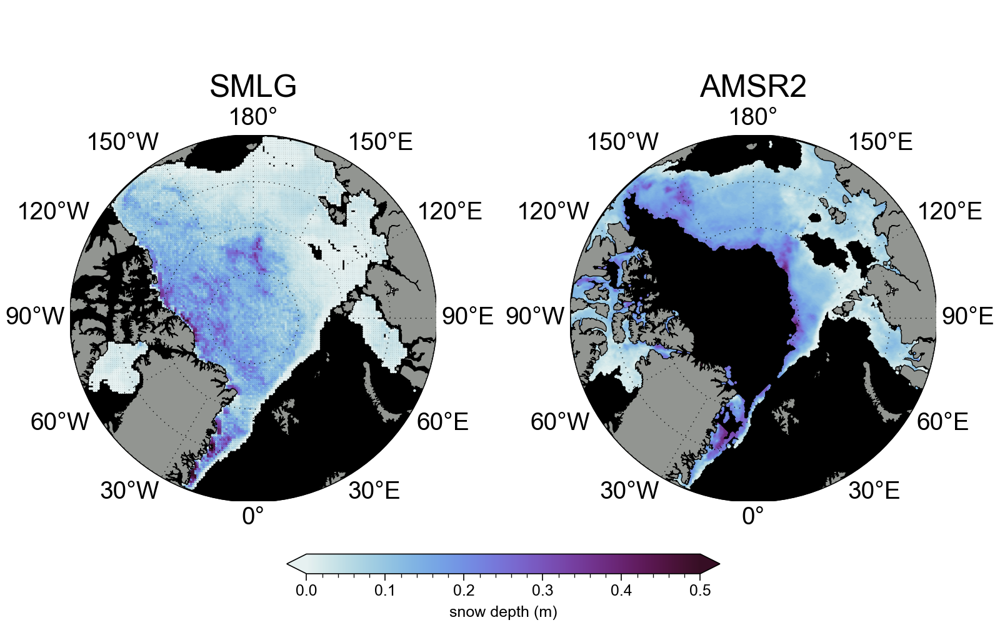

In [396]:
def plot_panArctic_SM(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=70,lon_0=0, resolution='l',ax=ax, round=True)
    m.drawmeridians(np.arange(0,360,30),labels=[1,1,1,1],linewidth=0.5, fontsize=14, dashes=[1,5])
    m.drawparallels(np.arange(-90,90,5),linewidth=0.5, fontsize=14, dashes=[1,5])
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='gray')
    m.drawmapboundary(fill_color='black')
    x=m.scatter(lon, lat, latlon=True, c=sit, s=1,vmin = min_set, vmax=max_set, cmap=cmap_set)
    #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x


from matplotlib.lines import Line2D
import proplot as pplot
fig, ax = plt.subplots(ncols=2, figsize=(8,5), constrained_layout=True)
#im = plot_panArctic8(lon, lat, missing_snow_depth, 0, 50, 'red', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, land_snow_depth, 0, 50, 'brown', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, OW_snow_depth, 0, 50, 'blue', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, MYI_snow_depth, 0, 50, 'grey', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, variability_snow_depth, 0, 50, 'magenta', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, melt_snow_depth, 0, 50, 'orange', 'radar freeboard (m)','max', ax,fig)

cmap_chosen = 'dense'
title = 'SMLG'
im = plot_panArctic_SM(lon_SMLG.flatten(), lat_SMLG.flatten(), snow_SMLG.flatten(), 0, 0.5, cmap_chosen, 'radar freeboard (m)','max', ax[0],fig)
title = 'AMSR2'
im = plot_panArctic_SM(lon, lat, snow_depth_only/100, 0, 0.5, cmap_chosen, 'radar freeboard (m)','max', ax[1],fig)

plt.colorbar(im, ax=ax[:],orientation = 'horizontal', label='snow depth (m)', extend='both', shrink=0.5)


In [131]:
df_jan_short_restrict = df_jan_short[(df_jan_short['ppk']<9) & (df_jan_short['ssd']>6.29)]

# 

C=0.714 # Reference CS2 baseline-D MSS to WGS84 instead of Topex/Poseidon ellipsoid
ds = 0.30
ns = (1+0.5*ds)**(-1.5)
        
#df_jan_short['IS2_w_mean_fb_MSS']=df_jan_short['IS2_w_mean_fb']+df_jan_short['IS2_mean_MSS']
#df_jan_short['snow_depth_original_MSS']=(df_jan_short['IS2_w_mean_fb_MSS']-df_jan_short['fb'])/ns
df_jan_short['snow_depth_original_MSS_LARM']=(df_jan_short['IS2_w_mean_fb_MSS']-df_jan_short['LARM_rfb'])/ns
df_jan_short.corr()

,Unnamed: 0,index,lat,lon,fb,mss,fb_no_mss,ssd,ppk,IS2_mean_fb,...,IS2_mean_gw,IS2_mean_MSS,IS2_w_mean_fb_MSS,snow_depth_original_MSS,LARM_rfb,LARM_roughness,AMSR2_SIC,AMSR2_snow_depth,SMLG_snow_depth,snow_depth_original_MSS_LARM
Unnamed: 0,1.000000,1.000000,-0.972956,0.493356,-0.242410,-0.977419,0.976994,-0.466649,0.238884,0.978354,...,-0.641144,-0.978323,-0.781458,-0.203049,-0.320607,-0.276256,-0.126807,0.892548,-0.476237,-0.247386
index,1.000000,1.000000,-0.972956,0.493356,-0.242410,-0.977419,0.976994,-0.466649,0.238884,0.978354,...,-0.641144,-0.978323,-0.781458,-0.203049,-0.320607,-0.276256,-0.126807,0.892548,-0.476237,-0.247386
lat,-0.972956,-0.972956,1.000000,-0.364013,0.247303,0.986972,-0.986421,0.482847,-0.212990,-0.986327,...,0.642840,0.986707,0.798896,0.208078,0.358311,0.264486,-0.044143,-0.842923,0.584779,0.227318
lon,0.493356,0.493356,-0.364013,1.000000,-0.113475,-0.370474,0.369270,-0.155562,0.155761,0.373851,...,-0.302187,-0.373732,-0.296379,-0.056231,-0.075673,-0.214927,-0.365836,-0.833647,0.072003,-0.137526
fb,-0.242410,-0.242410,0.247303,-0.113475,1.000000,0.261523,-0.216232,0.296754,-0.308144,-0.262677,...,0.118821,0.262999,0.225546,-0.838637,0.771595,0.255757,0.032080,0.219689,0.219378,-0.604061
mss,-0.977419,-0.977419,0.986972,-0.370474,0.261523,1.000000,-0.998912,0.483072,-0.238065,-0.999373,...,0.614381,0.999663,0.814310,0.202977,0.350769,0.266086,0.050557,-0.790294,0.545684,0.246039
fb_no_mss,0.976994,0.976994,-0.986421,0.369270,-0.216232,-0.998912,1.000000,-0.474314,0.225927,0.998222,...,-0.615735,-0.998500,-0.812817,-0.245836,-0.325781,-0.258072,-0.049591,0.775704,-0.541387,-0.269218
ssd,-0.466649,-0.466649,0.482847,-0.155562,0.296754,0.483072,-0.474314,1.000000,-0.703916,-0.483348,...,0.239617,0.484694,0.432051,-0.044732,0.329710,0.655627,0.030902,0.375162,0.349675,-0.052461
ppk,0.238884,0.238884,-0.212990,0.155761,-0.308144,-0.238065,0.225927,-0.703916,1.000000,0.237904,...,-0.004046,-0.239048,-0.241108,0.162476,-0.305284,-0.753611,-0.196596,-0.139491,-0.155918,0.110842
IS2_mean_fb,0.978354,0.978354,-0.986327,0.373851,-0.262677,-0.999373,0.998222,-0.483348,0.237904,1.000000,...,-0.607980,-0.999860,-0.799183,-0.193406,-0.347046,-0.263409,-0.050117,0.790374,-0.546177,-0.237416


KeyboardInterrupt: 

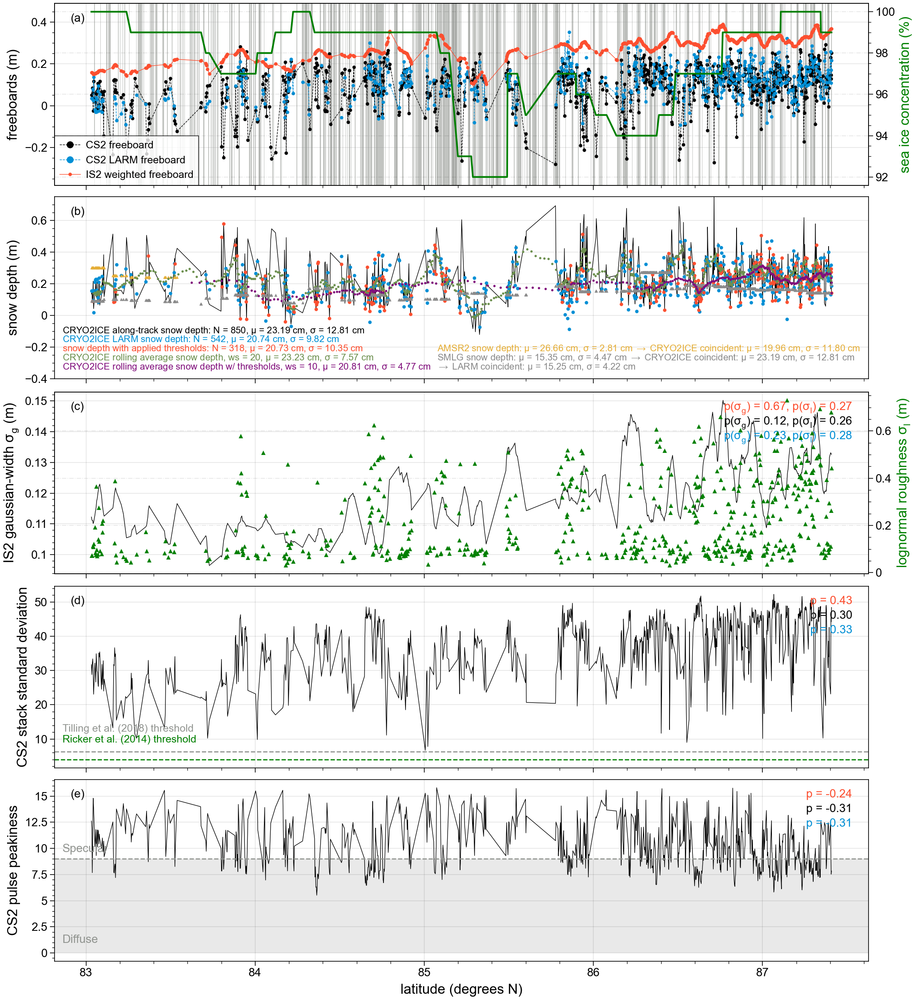

In [19]:
import proplot as pplot
fig, axs = plt.subplots(5, figsize=(11,12), constrained_layout=True, sharex=True)
#axs[0].plot(df_IS2_new['lat'], df_IS2_new['fb'], c='grey', ls='', marker='.', markersize=0.8)

cmap_qual = plt.get_cmap('538')

ax2 = axs[0].twinx()
axs[0].plot(df_jan_short['lat'], df_jan_short['fb'] ,'o', c='k', markersize=2, ls='--', lw=0.5)
axs[0].plot(df_jan_short['lat'],df_jan_short['LARM_rfb'], 'o',c=cmap_qual(0), markersize=2, ls='--', lw=0.5)
axs[0].plot(df_jan_short['lat'],df_jan_short['IS2_w_mean_fb_MSS'], 'o',c=cmap_qual(1), markersize=2, ls='-', lw=0.5)
axs[0].vlines(df_CS2_lead_check_jan[df_CS2_lead_check_jan['lead_CS2']>0]['lat'], -0.5, 1,ls='-', color='grey', linewidth=0.2, label='_nolegend_')
ax2.plot(df_jan_short['lat'],df_jan_short['AMSR2_SIC'], c='green', ls='-')
ax2.set_ylabel('sea ice concentration (%)', color='green', fontsize=12)
ax2.grid(ls='-.')

axs[1].plot(df_jan_short['lat'],df_jan_short['snow_depth_original_MSS'] , c='k',ls='-', linewidth=0.5)
axs[1].plot(df_jan_short['lat'],df_jan_short['snow_depth_original_MSS_LARM'] , 'o', c=cmap_qual(0), markersize=2)
axs[1].plot(df_jan_short[(df_jan_short['ppk']<9) & (df_jan_short['ssd']>6.29)]['lat'],df_jan_short[(df_jan_short['ppk']<9) & (df_jan_short['ssd']>6.29)]['snow_depth_original_MSS'] , 'o', c=cmap_qual(1), markersize=2)
axs[1].plot(df_jan_short['lat'],(df_jan_short['AMSR2_snow_depth'])/100 ,'^', c=cmap_qual(2),markersize=1)
rolling_df = df_jan_short.rolling(window=10, min_periods=1).mean()
axs[1].plot(rolling_df['lat'],(rolling_df['snow_depth_original_MSS']) ,'o', c=cmap_qual(3),markersize=1)
axs[1].plot(df_jan_short['lat'],(df_jan_short['SMLG_snow_depth']) ,'^', c=cmap_qual(4),markersize=1)

df_jan_short_restrict = df_jan_short[(df_jan_short['ppk']<9) & (df_jan_short['ssd']>6.29)]
rolling_df_restrict = df_jan_short_restrict.rolling(window=20, min_periods=1).mean()
axs[1].plot(rolling_df_restrict['lat'],(rolling_df_restrict['snow_depth_original_MSS']) ,'o', c=cmap_qual(5),markersize=1)


#axs[1].plot(df3_short['lead_CS2'], 'o')
axs[1].set_ylim(-0.4, 0.75)



axs[2].plot(df_jan_short['lat'], df_jan_short['IS2_mean_gw'], c='k',ls='-', linewidth=0.5)
axs[2].text(0.98, 0.9, 'p($\sigma_g$) = {:.2f}, p($\sigma_l$) = {:.2f}'.format(df_jan_short['IS2_mean_gw'].corr(df_jan_short['IS2_w_mean_fb_MSS']), df_jan_short['LARM_roughness'].corr(df_jan_short['IS2_w_mean_fb_MSS'])), c=cmap_qual(1),fontsize=10,ha='right', transform = axs[2].transAxes)
axs[2].text(0.98, 0.82, 'p($\sigma_g$) = {:.2f}, p($\sigma_l$) = {:.2f}'.format(df_jan_short['IS2_mean_gw'].corr(df_jan_short['fb']),df_jan_short['LARM_roughness'].corr(df_jan_short['fb'])), c='k', fontsize=10, transform = axs[2].transAxes,ha='right')
axs[2].text(0.98, 0.74, 'p($\sigma_g$) = {:.2f}, p($\sigma_l$) = {:.2f}'.format(df_jan_short['IS2_mean_gw'].corr(df_jan_short['LARM_rfb']),df_jan_short['LARM_roughness'].corr(df_jan_short['LARM_rfb'])), c=cmap_qual(0), fontsize=10, ha='right',transform = axs[2].transAxes)

ax3 = axs[2].twinx()
ax3.plot(df_jan_short['lat'],df_jan_short['LARM_roughness'], '^', c='green', markersize=2)
ax3.set_ylabel('lognormal roughness $\sigma_{l}$ (m)', color='green', fontsize=12)
ax3.grid(ls='-.')

axs[3].plot(df_jan_short['lat'], df_jan_short['ssd'], c='k',ls='-', linewidth=0.5)
axs[3].axhline(y=4, c='green',ls='--', linewidth=1)
axs[3].axhline(y=6.29, c='grey',ls='--', linewidth=1)
axs[3].text(0.01, 0.2, 'Tilling et al. (2018) threshold', color='grey',transform = axs[3].transAxes)
axs[3].text(0.01, 0.14, 'Ricker et al. (2014) threshold', color='green',transform = axs[3].transAxes)
axs[3].text(0.98, 0.9, 'p = {:.2f}'.format(df_jan_short['ssd'].corr(df_jan_short['IS2_w_mean_fb_MSS'])), c= cmap_qual(1),fontsize=10, transform = axs[3].transAxes,ha='right')
axs[3].text(0.98, 0.82, 'p = {:.2f}'.format(df_jan_short['ssd'].corr(df_jan_short['fb'])), c='k', fontsize=10, transform = axs[3].transAxes,ha='right')
axs[3].text(0.98, 0.74, 'p = {:.2f}'.format(df_jan_short['ssd'].corr(df_jan_short['LARM_rfb'])),  c=cmap_qual(0), fontsize=10, transform = axs[3].transAxes,ha='right')

axs[4].plot(df_jan_short['lat'], df_jan_short['ppk'], c='k',ls='-', linewidth=0.5)
axs[4].axhspan(0,9, facecolor='grey', alpha=0.2)
axs[4].axhline(y=9, c='grey',ls='--', linewidth=1)
#axs[0].set_ylim([-0.3, 1.5])
#axs[0].set_xlim([float(data_check['lat'].head(1)), float(data_check['lat'].tail(1))])
axs[4].text(0.98, 0.9, 'p = {:.2f}'.format(df_jan_short['ppk'].corr(df_jan_short['IS2_w_mean_fb_MSS'])), c= cmap_qual(1),fontsize=10, ha='right',transform = axs[4].transAxes)
axs[4].text(0.98, 0.82, 'p = {:.2f}'.format(df_jan_short['ppk'].corr(df_jan_short['fb'])), c='k', fontsize=10, ha='right', transform = axs[4].transAxes)
axs[4].text(0.98, 0.74, 'p = {:.2f}'.format(df_jan_short['ppk'].corr(df_jan_short['LARM_rfb'])), c=cmap_qual(0), fontsize=10, ha='right',transform = axs[4].transAxes)


axs[0].set_ylabel('freeboards (m)', fontsize=12)
axs[1].set_ylabel('snow depth (m)', fontsize=12)
axs[2].set_ylabel('IS2 gaussian-width $\sigma_{g}$ (m)', fontsize=12)
axs[3].set_ylabel('CS2 stack standard deviation', fontsize=12)
axs[4].set_ylabel('CS2 pulse peakiness', fontsize=12)

legend=axs[0].legend(['CS2 freeboard', 'CS2 LARM freeboard', 'IS2 weighted freeboard'], loc='lower left', scatterpoints=3)
legend.legendHandles[0]._legmarker.set_markersize(5)
legend.legendHandles[1]._legmarker.set_markersize(5)
#axs[0].set_xlim([77, 78])

df_jan_AMSR2_points = df_jan_short[df_jan_short['AMSR2_snow_depth'].notna()]
df_jan_SMLG_points = df_jan_short[df_jan_short['SMLG_snow_depth'].notna()]
df_jan_LARM_points = df_jan_short[df_jan_short['LARM_rfb'].notna()]

txt_CRYO2ICE =r'CRYO2ICE along-track snow depth: N = {}, $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(len(df_jan_short['snow_depth_original_MSS']), np.nanmean(df_jan_short['snow_depth_original_MSS'])*100, np.nanstd(df_jan_short['snow_depth_original_MSS'])*100)
txt_CRYO2ICE_LARM =r'CRYO2ICE LARM snow depth: N = {}, $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(len(df_jan_short[df_jan_short['LARM_rfb'].notna()]), np.nanmean(df_jan_short['snow_depth_original_MSS_LARM'])*100, np.nanstd(df_jan_short['snow_depth_original_MSS_LARM'])*100)
txt_CRYO2ICE_thresholds = r'snow depth with applied thresholds: N = {}, $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(len(df_jan_short_restrict['snow_depth_original_MSS']), np.nanmean(df_jan_short_restrict['snow_depth_original_MSS'])*100, np.nanstd(df_jan_short_restrict['snow_depth_original_MSS'])*100)
txt_AMSR2 = r'AMSR2 snow depth: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm $\rightarrow$ CRYO2ICE coincident: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format( np.nanmean(df_jan_AMSR2_points['AMSR2_snow_depth']), np.nanstd(df_jan_AMSR2_points['AMSR2_snow_depth']), np.nanmean(df_jan_AMSR2_points['snow_depth_original_MSS'])*100, np.nanstd(df_jan_AMSR2_points['snow_depth_original_MSS'])*100)
txt_CRYO2ICE_rolling = 'CRYO2ICE rolling average snow depth, ws = 20, $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(rolling_df['snow_depth_original_MSS'])*100, np.nanstd(rolling_df['snow_depth_original_MSS'])*100)
txt_CRYO2ICE_rolling_restrict = 'CRYO2ICE rolling average snow depth w/ thresholds, ws = 10, $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(rolling_df_restrict['snow_depth_original_MSS'])*100, np.nanstd(rolling_df_restrict['snow_depth_original_MSS'])*100)
txt_SMLG = r'SMLG snow depth: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm $\rightarrow$ CRYO2ICE coincident: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format( np.nanmean(df_jan_SMLG_points['SMLG_snow_depth']*100), np.nanstd(df_jan_SMLG_points['SMLG_snow_depth']*100), np.nanmean(df_jan_SMLG_points['snow_depth_original_MSS'])*100, np.nanstd(df_jan_SMLG_points['snow_depth_original_MSS'])*100)
txt_SMLG_LARM = r'$\rightarrow$ LARM coincident: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format( np.nanmean(df_jan_LARM_points['SMLG_snow_depth']*100), np.nanstd(df_jan_LARM_points['SMLG_snow_depth']*100))


font_size_snow = 8
axs[1].text(0.01, 0.25, txt_CRYO2ICE, transform = axs[1].transAxes, fontsize=font_size_snow, color='k')
axs[1].text(0.01, 0.2, txt_CRYO2ICE_LARM, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(0))
axs[1].text(0.01, 0.15, txt_CRYO2ICE_thresholds, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(1))
axs[1].text(0.01, 0.10, txt_CRYO2ICE_rolling, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(3))
axs[1].text(0.01, 0.05, txt_CRYO2ICE_rolling_restrict, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(5))

axs[1].text(0.47, 0.15, txt_AMSR2, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(2))
axs[1].text(0.47, 0.10, txt_SMLG, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(4))
axs[1].text(0.47, 0.05, txt_SMLG_LARM, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(4))


#legend=axs[1].legend([txt_CRYO2ICE,txt_CRYO2ICE_LARM, txt_CRYO2ICE_thresholds, txt_AMSR2], loc='best', scatterpoints=3)
axs[0].set_ylim(df_jan_short['fb'].min()-0.1, df_jan_short['IS2_w_mean_fb_MSS'].max()+0.1)
#axs[0].set_xlim(87.5, 82.5)
axs[4].set_xlabel('latitude (degrees N)',  fontsize=12)

axs[0].text(0.02, 0.9, '(a)', transform = axs[0].transAxes, fontsize=10)
axs[1].text(0.02, 0.9, '(b)', transform = axs[1].transAxes, fontsize=10)
axs[2].text(0.02, 0.9, '(c)', transform = axs[2].transAxes, fontsize=10)
axs[3].text(0.02, 0.9, '(d)', transform = axs[3].transAxes, fontsize=10)
axs[4].text(0.02, 0.9, '(e)', transform = axs[4].transAxes, fontsize=10)


axs[4].text(0.01, 0.60, 'Specular', transform = axs[4].transAxes, fontsize=10, color='grey')
axs[4].text(0.01, 0.10, 'Diffuse', transform = axs[4].transAxes, fontsize=10, color='grey')



axs[0].tick_params(labelsize=10)
axs[1].tick_params(labelsize=10)
axs[2].tick_params(labelsize=10)
axs[3].tick_params(labelsize=10)
axs[4].tick_params(labelsize=10)
ax2.tick_params(labelsize=10)
ax3.tick_params(labelsize=10)
plt.savefig('E:\demo_CRYO2ICE_roughness_including_leads_mar_r3500_original_MSS.png', transparent=True)     

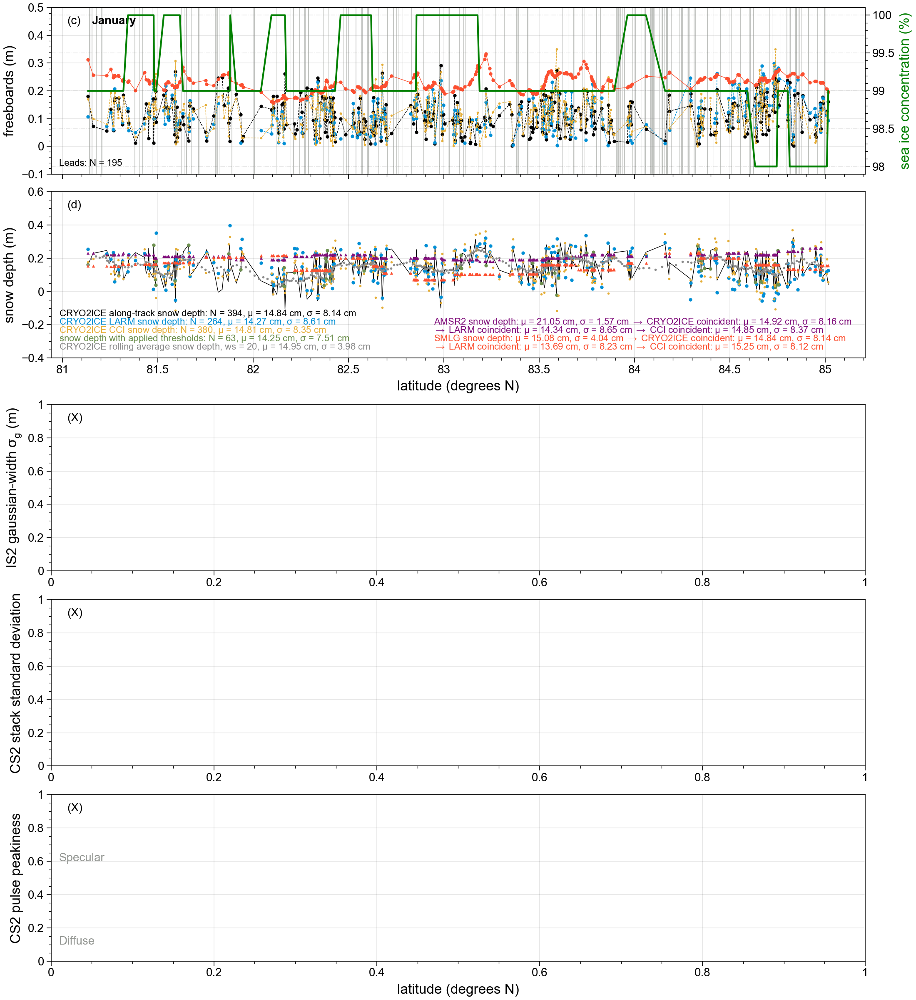

In [551]:
import proplot as pplot
fig, axs = plt.subplots(5, figsize=(11,12), constrained_layout=True)
#axs[0].plot(df_IS2_new['lat'], df_IS2_new['fb'], c='grey', ls='', marker='.', markersize=0.8)

cmap_qual = plt.get_cmap('538')

ax2 = axs[0].twinx()
axs[0].plot(df_jan_short['lat'], df_jan_short['fb'] ,'o', c='k', markersize=2, ls='--', lw=0.5)
axs[0].plot(df_jan_short['lat'],df_jan_short['LARM_rfb'], 'o',c=cmap_qual(0), markersize=2, ls='--', lw=0.5)
axs[0].plot(df_jan_short['lat'],df_jan_short['CCI_rfb'], 'o',c=cmap_qual(2), markersize=1, ls='--', lw=0.5)
axs[0].plot(df_jan_short['lat'],df_jan_short['IS2_w_mean_fb_MSS'], 'o',c=cmap_qual(1), markersize=2, ls='-', lw=0.5)
axs[0].vlines(df_CS2_lead_check_jan[df_CS2_lead_check_jan['lead_CS2']>0]['lat'], -0.5, 1,ls='-', color='grey', linewidth=0.2, label='_nolegend_')
ax2.plot(df_jan_short['lat'],df_jan_short['AMSR2_SIC'], c='green', ls='-')
ax2.set_ylabel('sea ice concentration (%)', color='green', fontsize=12)
ax2.grid(ls='-.')

axs[1].plot(df_jan_short['lat'],df_jan_short['snow_depth_original_MSS'] , c='k',ls='-', linewidth=0.5)
axs[1].plot(df_jan_short['lat'],df_jan_short['snow_depth_original_MSS_LARM'] , 'o', c=cmap_qual(0), markersize=2)
axs[1].plot(df_jan_short[(df_jan_short['ppk']<9) & (df_jan_short['ssd']>6.29)]['lat'],df_jan_short[(df_jan_short['ppk']<9) & (df_jan_short['ssd']>6.29)]['snow_depth_original_MSS'] , 'o', c=cmap_qual(3), markersize=2)
axs[1].plot(df_jan_short['lat'],df_jan_short['snow_depth_original_MSS_CCI'] , 'o', c=cmap_qual(2), markersize=1)
axs[1].plot(df_jan_short['lat'],(df_jan_short['AMSR2_snow_depth'])/100 ,'^', c=cmap_qual(6),markersize=1)
rolling_df = df_jan_short.rolling(window=10, min_periods=1).mean()
axs[1].plot(rolling_df['lat'],(rolling_df['snow_depth_original_MSS']) ,'o', c=cmap_qual(4),markersize=1)
axs[1].plot(df_jan_short['lat'],(df_jan_short['SMLG_snow_depth']) ,'^', c=cmap_qual(1),markersize=1)

df_jan_short_restrict = df_jan_short[(df_jan_short['ppk']<9) & (df_jan_short['ssd']>6.29)]
rolling_df_restrict = df_jan_short_restrict.rolling(window=20, min_periods=1).mean()
#axs[1].plot(rolling_df_restrict['lat'],(rolling_df_restrict['snow_depth_original_MSS']) ,'o', c=cmap_qual(5),markersize=1)


#axs[1].plot(df3_short['lead_CS2'], 'o')
axs[0].set_ylim(-0.1, 0.5)
axs[1].set_ylim(-0.4, 0.6)


df_jan_AMSR2_points = df_jan_short[df_jan_short['AMSR2_snow_depth'].notna()]
df_jan_SMLG_points = df_jan_short[df_jan_short['SMLG_snow_depth'].notna()]
df_jan_LARM_points = df_jan_short[df_jan_short['LARM_rfb'].notna()]

txt_CRYO2ICE =r'CRYO2ICE along-track snow depth: N = {}, $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(len(df_jan_short['snow_depth_original_MSS']), np.nanmean(df_jan_short['snow_depth_original_MSS'])*100, np.nanstd(df_jan_short['snow_depth_original_MSS'])*100)
txt_CRYO2ICE_LARM =r'CRYO2ICE LARM snow depth: N = {}, $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(len(df_jan_short[df_jan_short['LARM_rfb'].notna()]), np.nanmean(df_jan_short['snow_depth_original_MSS_LARM'])*100, np.nanstd(df_jan_short['snow_depth_original_MSS_LARM'])*100)
txt_CRYO2ICE_CCI =r'CRYO2ICE CCI snow depth: N = {}, $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(len(df_jan_short[df_jan_short['CCI_rfb'].notna()]), np.nanmean(df_jan_short['snow_depth_original_MSS_CCI'])*100, np.nanstd(df_jan_short['snow_depth_original_MSS_CCI'])*100)
txt_CRYO2ICE_thresholds = r'snow depth with applied thresholds: N = {}, $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(len(df_jan_short_restrict['snow_depth_original_MSS']), np.nanmean(df_jan_short_restrict['snow_depth_original_MSS'])*100, np.nanstd(df_jan_short_restrict['snow_depth_original_MSS'])*100)
txt_AMSR2 = r'AMSR2 snow depth: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm $\rightarrow$ CRYO2ICE coincident: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format( np.nanmean(df_jan_AMSR2_points['AMSR2_snow_depth']), np.nanstd(df_jan_AMSR2_points['AMSR2_snow_depth']), np.nanmean(df_jan_AMSR2_points['snow_depth_original_MSS'])*100, np.nanstd(df_jan_AMSR2_points['snow_depth_original_MSS'])*100)
txt_CRYO2ICE_rolling = 'CRYO2ICE rolling average snow depth, ws = 20, $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(rolling_df['snow_depth_original_MSS'])*100, np.nanstd(rolling_df['snow_depth_original_MSS'])*100)
txt_CRYO2ICE_rolling_restrict = 'CRYO2ICE rolling average snow depth w/ thresholds, ws = 10, $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(rolling_df_restrict['snow_depth_original_MSS'])*100, np.nanstd(rolling_df_restrict['snow_depth_original_MSS'])*100)
txt_SMLG = r'SMLG snow depth: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm $\rightarrow$ CRYO2ICE coincident: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format( np.nanmean(df_jan_SMLG_points['SMLG_snow_depth']*100), np.nanstd(df_jan_SMLG_points['SMLG_snow_depth']*100), np.nanmean(df_jan_SMLG_points['snow_depth_original_MSS'])*100, np.nanstd(df_jan_SMLG_points['snow_depth_original_MSS'])*100)
txt_AMSR2_LARM_CCI = r'$\rightarrow$ LARM coincident: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm $\rightarrow$ CCI coincident: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(df_jan_AMSR2_points['snow_depth_original_MSS_LARM'])*100, np.nanstd(df_jan_AMSR2_points['snow_depth_original_MSS_LARM'])*100, np.nanmean(df_jan_AMSR2_points['snow_depth_original_MSS_CCI'])*100, np.nanstd(df_jan_AMSR2_points['snow_depth_original_MSS_CCI'])*100)
txt_SMLG_LARM_CCI = r'$\rightarrow$ LARM coincident: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm $\rightarrow$ CCI coincident: $\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format( np.nanmean(df_jan_LARM_points['snow_depth_original_MSS_LARM']*100), np.nanstd(df_jan_LARM_points['snow_depth_original_MSS_LARM']*100), np.nanmean(df_jan_LARM_points['snow_depth_original_MSS_CCI']*100), np.nanstd(df_jan_LARM_points['snow_depth_original_MSS_CCI']*100))


font_size_snow = 8
axs[1].text(0.01, 0.25, txt_CRYO2ICE, transform = axs[1].transAxes, fontsize=font_size_snow, color='k')
axs[1].text(0.01, 0.2, txt_CRYO2ICE_LARM, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(0))
axs[1].text(0.01, 0.15, txt_CRYO2ICE_CCI, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(2))
axs[1].text(0.01, 0.10, txt_CRYO2ICE_thresholds, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(3))
axs[1].text(0.01, 0.05, txt_CRYO2ICE_rolling, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(4))
#axs[1].text(0.01, 0.05, txt_CRYO2ICE_rolling_restrict, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(5))

axs[1].text(0.47, 0.2, txt_AMSR2, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(6))
axs[1].text(0.47, 0.15, txt_AMSR2_LARM_CCI, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(6))
axs[1].text(0.47, 0.10, txt_SMLG, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(1))
axs[1].text(0.47, 0.05, txt_SMLG_LARM_CCI, transform = axs[1].transAxes, fontsize=font_size_snow, color=cmap_qual(1))


'''

axs[2].plot(df_jan_short['lat'], df_jan_short['IS2_mean_gw'], c='k',ls='-', linewidth=0.5)
axs[2].text(0.98, 0.9, 'p($\sigma_g$) = {:.2f}, p($\sigma_l$) = {:.2f}'.format(df_jan_short['IS2_mean_gw'].corr(df_jan_short['IS2_w_mean_fb_MSS']), df_jan_short['LARM_roughness'].corr(df_jan_short['IS2_w_mean_fb_MSS'])), c=cmap_qual(1),fontsize=10,ha='right', transform = axs[2].transAxes)
axs[2].text(0.98, 0.82, 'p($\sigma_g$) = {:.2f}, p($\sigma_l$) = {:.2f}'.format(df_jan_short['IS2_mean_gw'].corr(df_jan_short['fb']),df_jan_short['LARM_roughness'].corr(df_jan_short['fb'])), c='k', fontsize=10, transform = axs[2].transAxes,ha='right')
axs[2].text(0.98, 0.74, 'p($\sigma_g$) = {:.2f}, p($\sigma_l$) = {:.2f}'.format(df_jan_short['IS2_mean_gw'].corr(df_jan_short['LARM_rfb']),df_jan_short['LARM_roughness'].corr(df_jan_short['LARM_rfb'])), c=cmap_qual(0), fontsize=10, ha='right',transform = axs[2].transAxes)

ax3 = axs[2].twinx()
ax3.plot(df_jan_short['lat'],df_jan_short['LARM_roughness'], '^', c='green', markersize=2)
ax3.set_ylabel('lognormal roughness $\sigma_{l}$ (m)', color='green', fontsize=12)
ax3.grid(ls='-.')

axs[3].plot(df_jan_short['lat'], df_jan_short['ssd'], c='k',ls='-', linewidth=0.5)
axs[3].axhline(y=4, c='green',ls='--', linewidth=1)
axs[3].axhline(y=6.29, c='grey',ls='--', linewidth=1)
axs[3].text(0.01, 0.2, 'Tilling et al. (2018) threshold', color='grey',transform = axs[3].transAxes)
axs[3].text(0.01, 0.14, 'Ricker et al. (2014) threshold', color='green',transform = axs[3].transAxes)
axs[3].text(0.98, 0.9, 'p = {:.2f}'.format(df_jan_short['ssd'].corr(df_jan_short['IS2_w_mean_fb_MSS'])), c= cmap_qual(1),fontsize=10, transform = axs[3].transAxes,ha='right')
axs[3].text(0.98, 0.82, 'p = {:.2f}'.format(df_jan_short['ssd'].corr(df_jan_short['fb'])), c='k', fontsize=10, transform = axs[3].transAxes,ha='right')
axs[3].text(0.98, 0.74, 'p = {:.2f}'.format(df_jan_short['ssd'].corr(df_jan_short['LARM_rfb'])),  c=cmap_qual(0), fontsize=10, transform = axs[3].transAxes,ha='right')

axs[4].plot(df_jan_short['lat'], df_jan_short['ppk'], c='k',ls='-', linewidth=0.5)
axs[4].axhspan(0,9, facecolor='grey', alpha=0.2)
axs[4].axhline(y=9, c='grey',ls='--', linewidth=1)
#axs[0].set_ylim([-0.3, 1.5])
#axs[0].set_xlim([float(data_check['lat'].head(1)), float(data_check['lat'].tail(1))])
axs[4].text(0.98, 0.9, 'p = {:.2f}'.format(df_jan_short['ppk'].corr(df_jan_short['IS2_w_mean_fb_MSS'])), c= cmap_qual(1),fontsize=10, ha='right',transform = axs[4].transAxes)
axs[4].text(0.98, 0.82, 'p = {:.2f}'.format(df_jan_short['ppk'].corr(df_jan_short['fb'])), c='k', fontsize=10, ha='right', transform = axs[4].transAxes)
axs[4].text(0.98, 0.74, 'p = {:.2f}'.format(df_jan_short['ppk'].corr(df_jan_short['LARM_rfb'])), c=cmap_qual(0), fontsize=10, ha='right',transform = axs[4].transAxes)

'''

axs[0].set_ylabel('freeboards (m)', fontsize=12)
axs[1].set_ylabel('snow depth (m)', fontsize=12)
axs[2].set_ylabel('IS2 gaussian-width $\sigma_{g}$ (m)', fontsize=12)
axs[3].set_ylabel('CS2 stack standard deviation', fontsize=12)
axs[4].set_ylabel('CS2 pulse peakiness', fontsize=12)

#legend=axs[1].legend([txt_CRYO2ICE,txt_CRYO2ICE_LARM, txt_CRYO2ICE_thresholds, txt_AMSR2], loc='best', scatterpoints=3)
#axs[0].set_ylim(df_jan_short['fb'].min()-0.1, df_jan_short['IS2_w_mean_fb_MSS'].max()+0.1)
#axs[0].set_xlim(87.5, 82.5)
axs[4].set_xlabel('latitude (degrees N)',  fontsize=12)
axs[1].set_xlabel('latitude (degrees N)',  fontsize=12)

axs[0].text(0.02, 0.9, '(c)', transform = axs[0].transAxes, fontsize=10)
axs[1].text(0.02, 0.9, '(d)', transform = axs[1].transAxes, fontsize=10)
axs[2].text(0.02, 0.9, '(X)', transform = axs[2].transAxes, fontsize=10)
axs[3].text(0.02, 0.9, '(X)', transform = axs[3].transAxes, fontsize=10)
axs[4].text(0.02, 0.9, '(X)', transform = axs[4].transAxes, fontsize=10)


axs[4].text(0.01, 0.60, 'Specular', transform = axs[4].transAxes, fontsize=10, color='grey')
axs[4].text(0.01, 0.10, 'Diffuse', transform = axs[4].transAxes, fontsize=10, color='grey')

axs[0].text(0.05, 0.9, 'January', transform = axs[0].transAxes, fontsize=10,weight='bold')
axs[0].text(0.01, 0.05, 'Leads: N = {}'.format(len(df_CS2_lead_check_jan[df_CS2_lead_check_jan['lead_CS2']>0])), transform = axs[0].transAxes, fontsize=font_size_snow)



axs[0].tick_params(labelsize=10)
axs[1].tick_params(labelsize=10)
axs[2].tick_params(labelsize=10)
axs[3].tick_params(labelsize=10)
axs[4].tick_params(labelsize=10)
ax2.tick_params(labelsize=10)
ax3.tick_params(labelsize=10)


#legend=axs[0].legend(['CS2 freeboard', 'CS2 LARM freeboard', 'CS2 CCI freeboard','IS2 weighted freeboard'], loc='lower right', scatterpoints=3)
#legend.legendHandles[0]._legmarker.set_markersize(5)
#legend.legendHandles[1]._legmarker.set_markersize(5)
#legend.legendHandles[2]._legmarker.set_markersize(5)
#legend.legendHandles[3]._legmarker.set_markersize(5)

plt.setp(axs[0].get_xticklabels(), visible=False)
plt.savefig('E:\demo_CRYO2ICE_roughness_including_leads_jan_r3500_original_MSS_v2.png', transparent=True)     

In [555]:
# miles/s to m/s (multipy with 1609)

speed_CS2_m_pr_s = 4.35*1609
speed_CS2_m_pr_s

6999.15

In [586]:

#(abs(diff_t.total_seconds())*speed_CS2_m_pr_s)/10e3

In [587]:
along_track_dist

array([      0.        ,   -3161.796021  ,  -11698.6452777 ,
        -14228.0820945 ,  -15808.980105  ,  -16125.1597071 ,
        -16441.3393092 ,  -16757.5189113 ,  -18970.776126  ,
        -19286.9557281 ,  -21500.2129428 ,  -22132.572147  ,
        -24978.1885659 ,  -25294.368168  ,  -29720.8825974 ,
        -35412.1154352 ,  -36360.6542415 ,  -37625.3726499 ,
        -37941.552252  ,  -38257.7318541 ,  -38573.9114562 ,
        -40787.1686709 ,  -41103.348273  ,  -41419.5278751 ,
        -41735.7074772 ,  -42051.8870793 ,  -42368.0666814 ,
        -42684.2462835 ,  -47426.940315  ,  -48059.2995192 ,
        -48691.6587234 ,  -49956.3771318 ,  -50272.5567339 ,
        -50588.736336  ,  -52485.8139486 ,  -54066.7119591 ,
        -54382.8915612 ,  -54699.0711633 ,  -55015.2507654 ,
        -55647.6099696 ,  -55963.7895717 ,  -57228.5079801 ,
        -57544.6875822 ,  -59441.7651948 ,  -59757.9447969 ,
        -62919.7408179 ,  -63235.92042   ,  -63552.1000221 ,
        -63868.2796242 ,

# Compute monthly comparison with LARM, SMLG and AMSR2 snow depths

In [15]:
def CRYO2ICE_AMSR2_NN(df3_short,df_AMSR2):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    ## Only data within 825 m of CryoSat-2 footprint (find approximate area of coincident data)
    query_lats = df3_short[['lat']].to_numpy()
    query_lons = df3_short[['lon']].to_numpy()

    tree = BallTree(np.deg2rad(df_AMSR2[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    distances, indices = tree.query(np.deg2rad(np.c_[query_lats, query_lons]), k=1)
    
    data_check = df3_short
    NN_SIC, NN_SD= [], []
    for i in indices:
        NN_SIC = np.append(NN_SIC, df_AMSR2['sea_ice_concentration'][int(i)])
        NN_SD = np.append(NN_SD, df_AMSR2['snow_depth'][int(i)])

    data_check['AMSR2_SIC'] = NN_SIC
    data_check['AMSR2_snow_depth'] = NN_SD
    
    return data_check

def proj_polarstereo_to_latlon(X, Y):
    import pyproj
    # Output coordinates are in WGS 84 longitude and latitude
    projOut= pyproj.Proj(init='epsg:4326')

    # Input coordinates are in meters on the Polar Stereographic 
    # projection given in the netCDF file
    #projIn = pyproj.Proj('+proj=stere +lat_0=90 +lat_ts=70 +lon_0=-45 +k=1 +x_0=0 +y_0=0 +datum=WGS84 +units=m +no_defs ',preserve_units=True)
    projIn = pyproj.Proj(init='epsg:3408')
    
    lon, lat = pyproj.transform(projIn, projOut, X, Y)
    
    return lon, lat

def CRYO2ICE_SMLG_NN(df3_short,df_AMSR2):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    ## Only data within 825 m of CryoSat-2 footprint (find approximate area of coincident data)
    query_lats = df3_short[['lat']].to_numpy()
    query_lons = df3_short[['lon']].to_numpy()

    tree = BallTree(np.deg2rad(df_AMSR2[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    distances, indices = tree.query(np.deg2rad(np.c_[query_lats, query_lons]), k=1)
    
    data_check = df3_short
    NN_SD= []
    for i in indices:
        NN_SD = np.append(NN_SD, df_AMSR2['snow_depth'][int(i)])

    data_check['SMLG_snow_depth'] = NN_SD
    
    return data_check

def CRYO2ICE_SMLG_NN_v2(df3_short,df_AMSR2):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    ## Only data within 825 m of CryoSat-2 footprint (find approximate area of coincident data)
    query_lats = df3_short[['lat']].to_numpy()
    query_lons = df3_short[['lon']].to_numpy()

    tree = BallTree(np.deg2rad(df_AMSR2[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    distances, indices = tree.query(np.deg2rad(np.c_[query_lats, query_lons]), k=1)
    
    data_check = df3_short
    NN_SD= []
    for i in indices:
        NN_SD = np.append(NN_SD, df_AMSR2['snow_depth'][int(i)])

    data_check['SMLG_snow_depth_v2'] = NN_SD
    
    return data_check


In [20]:
files_check_CS2_L2 = !ls E:/DTU/CRYO2ICE/Data/CRYO2ICE_original_MSS/CRYO2ICE_MSS_time/November/*D001_original_MSS_time.csv
month_folder = 'November'

print('Loading datetime format for SnowModel-LG V1...')
import datetime # Python standard library datetime module
from netCDF4 import Dataset,num2date # http://unidata.github.io/netcdf4-python/
fp1 = r'E:\DTU\CRYO2ICE\Data\SM_snod_ERA5_01Aug1980-31Jul2021_v01.nc'
file_in = Dataset(fp1,"r",format="NETCDF4")
tname = "time"
nctime = file_in.variables[tname][:] # get values
t_unit = file_in.variables[tname].units # get unit  "days since 1950-01-01T00:00:00Z"
t_cal = file_in.variables[tname].calendar
tvalue = num2date(nctime,units = t_unit,calendar = t_cal)
str_time = [i.strftime("%Y-%m-%d %H:%M") for i in tvalue] # to display dates as string

print('Loading datetime format for SnowModel-LG V2...')
import datetime # Python standard library datetime module
from netCDF4 import Dataset,num2date # http://unidata.github.io/netcdf4-python/
fp1 = r'E:\DTU\CRYO2ICE\Data\SM_snod_MERRA2_ease_01Aug1980-31Jul2021_v02.nc'
file_in = Dataset(fp1,"r",format="NETCDF4")
tname = "time"
nctime = file_in.variables[tname][:] # get values
t_unit = file_in.variables[tname].units # get unit  "days since 1950-01-01T00:00:00Z"
t_cal = file_in.variables[tname].calendar
tvalue = num2date(nctime,units = t_unit,calendar = t_cal)
str_time_v2 = [i.strftime("%Y-%m-%d %H:%M") for i in tvalue] # to display dates as string


print('Datetime loaded. Analysis beginning...')

list_total = np.arange(0, len(files_check_CS2_L2)-1)
for k in list_total:
    fp1 = files_check_CS2_L2[k]
    basename_without_ext = os.path.splitext(os.path.basename(files_check_CS2_L2[k]))[0]
    print('File '+str(k)+'/'+str(len(list_total))+ ': ' + basename_without_ext)

    txt1 = basename_without_ext.split('_')[7]
    date_CS2=int(txt1.split('T')[0])
    fp_AMSR2 = r'E:\DTU\CRYO2ICE\AMSR2'+'/'+month_folder
    fname_AMSR2 = fp_AMSR2 + '/' + str('AMSR_U2_L3_SeaIce12km_B04_')+str(date_CS2)+'.he5'
    fp2 = r'E:\DTU\CRYO2ICE\Data\SM_snod_ERA5_01Aug1980-31Jul2021_v01.nc'
    fp3 = r'E:\DTU\CRYO2ICE\Data\SM_snod_MERRA2_ease_01Aug1980-31Jul2021_v02.nc'

    YY = str(date_CS2)[0:4]
    MM = str(date_CS2)[4:6]
    DD = str(date_CS2)[6:8]
    str_comp = YY+'-'+MM+'-'+DD+' 00:00'
    fp_LARM = r'E:\DTU\CRYO2ICE\LARM\UiT_LARM_Cryo2Ice_L2_' + YY +'_'+ MM + '.txt' 
    fp_CCI = r'E:\DTU\CRYO2ICE\CCI'+'/'+month_folder+'/'+'ESACCI-SEAICE-L2P-SITHICK-SIRAL_CRYOSAT2-NH-'+str(date_CS2)+'-v3p0-rc1.nc'

    # Load CRYO2ICE data 
    df_jan = pd.read_csv(fp1, index_col=None, header=0)
    
    if df_jan.empty == False:
        basename_without_ext = os.path.splitext(os.path.basename(fp1))[0]
        txt1 = basename_without_ext.split('_')[7]
        ID_CS2=int(txt1.split('T')[1])

        #### LARM data
        df_LARM = pd.read_csv(fp_LARM, delimiter=',', header=0)
        df_LARM_restrict=df_LARM[(df_LARM[' HHMMSS']==ID_CS2) & (df_LARM[' Sea_Ice_Class']==1)]
        df_LARM_new = pd.DataFrame({'lon':df_LARM_restrict[' Longitude'], 'lat':df_LARM_restrict[' Latitude'], 'LARM_rfb':df_LARM_restrict[' Radar_Freeboard'], 'LARM_roughness':df_LARM_restrict[' Sea_Ice_Roughness_Lognormal']})

        df_jan['lat']=round(df_jan['lat'],5)
        df_jan['lon']=round(df_jan['lon'],5)
        df_LARM_new['lat']=round(df_LARM_new['lat'],5)
        df_LARM_new['lon']=round(df_LARM_new['lon'],5)
        df_jan=pd.merge(df_jan, df_LARM_new, on=["lon", "lat"], how="left")
        
        ### CCI data
        file_in = Dataset(fp_CCI,"r",format="NETCDF4")
        tname = "time"
        nctime = file_in.variables[tname][:] # get values
        t_unit = file_in.variables[tname].units # get unit  "days since 1950-01-01T00:00:00Z"
        t_cal = 'standard'
        tvalue = num2date(nctime,units = t_unit,calendar = t_cal)
        #str_time_CS2 = [i.strftime("%Y-%m-%d %H:%M:%S.%f") for i in tvalue] # to display dates as string
        str_time_CS2= [str(i) for i in tvalue]
        t_value2 = tvalue+ datetime.timedelta(seconds = 37) # Add 37 deviation between TAI and UTC/GPS time 
        str_time_CS2_v2= [str(i) for i in t_value2]
        
        df_CCI = pd.DataFrame({'lat':file_in.variables['lat'][:],'lon':file_in.variables['lon'][:], 'CCI_rfb':file_in.variables['radar_freeboard'][:], 'time_CCI_UTC':str_time_CS2,'time':str_time_CS2_v2})
        df_jan['lat']=round(df_jan['lat'],5)
        df_jan['lon']=round(df_jan['lon'],5)
        df_CCI['lat']=round(df_CCI['lat'],5)
        df_CCI['lon']=round(df_CCI['lon'],5)
        df_jan=pd.merge(df_jan, df_CCI, on=['lat', 'lon', 'time'], how="left")

        ### prepare and include AMSR2 data
        file = h5py.File(fname_AMSR2, 'r')
        file.keys()
        lon = np.array(file['HDFEOS/GRIDS/NpPolarGrid12km/lon'])
        lat = np.array(file['HDFEOS/GRIDS/NpPolarGrid12km/lat'])
        snow_depth = np.array(file['HDFEOS/GRIDS/NpPolarGrid12km/Data Fields/SI_12km_NH_SNOWDEPTH_5DAY'])
        sea_ice_concentration= np.array(file['HDFEOS/GRIDS/NpPolarGrid12km/Data Fields/SI_12km_NH_ICECON_DAY'])
        file.close()

        missing_snow_depth  = np.where(snow_depth != 110, np.nan, snow_depth)
        land_snow_depth  = np.where(snow_depth != 120, np.nan, snow_depth)
        OW_snow_depth  = np.where(snow_depth != 130, np.nan, snow_depth)
        MYI_snow_depth  = np.where(snow_depth != 140, np.nan, snow_depth)
        variability_snow_depth  = np.where(snow_depth != 150, np.nan, snow_depth)
        melt_snow_depth  = np.where(snow_depth != 160, np.nan, snow_depth)
        snow_depth_only  = np.where(snow_depth > 100, np.nan, snow_depth)
        sea_ice_concentration_only = np.where(sea_ice_concentration > 100, np.nan, sea_ice_concentration)

        df_AMSR2 = pd.DataFrame({'lat':lat.flatten(), 'lon':lon.flatten(), 'snow_depth':snow_depth_only.flatten(), 'sea_ice_concentration':sea_ice_concentration_only.flatten()})
        df_jan = CRYO2ICE_AMSR2_NN(df_jan,df_AMSR2) # update df with AMSR2 data

        ### include SMLG data
        ds = netCDF4.Dataset(fp2, 'r')
        snow_SMLG = ds.variables['snod'][str_time.index(str_comp)][:][:]
        X_coord_SMLG = ds.variables['x'][:]
        Y_coord_SMLG = ds.variables['y'][:]

        x, y = np.meshgrid(X_coord_SMLG, Y_coord_SMLG)
        lon_SMLG, lat_SMLG = proj_polarstereo_to_latlon(x, y)

        df_SMLG= pd.DataFrame({'lat':lat_SMLG.flatten(), 'lon':lon_SMLG.flatten(), 'snow_depth':snow_SMLG.flatten()})
        df_jan = CRYO2ICE_SMLG_NN(df_jan,df_SMLG) # update df with SMLG data
        
        ### include SMLG v3 data
        ds = netCDF4.Dataset(fp3, 'r')
        snow_SMLG = ds.variables['snod'][str_time_v2.index(str_comp)][:][:]
        X_coord_SMLG = ds.variables['x'][:]
        Y_coord_SMLG = ds.variables['y'][:]

        x, y = np.meshgrid(X_coord_SMLG, Y_coord_SMLG)
        lon_SMLG, lat_SMLG = proj_polarstereo_to_latlon(x, y)

        df_SMLG= pd.DataFrame({'lat':lat_SMLG.flatten(), 'lon':lon_SMLG.flatten(), 'snow_depth':snow_SMLG.flatten()})
        df_jan = CRYO2ICE_SMLG_NN_v2(df_jan,df_SMLG) # update df with SMLG data

        C=0.714 # Reference CS2 baseline-D MSS to WGS84 instead of Topex/Poseidon ellipsoid
        ds = 0.30
        ns = (1+0.51*ds)**(-1.5)

        df_jan['snow_depth_original_MSS_LARM']=(df_jan['IS2_w_mean_fb_MSS']-df_jan['LARM_rfb'])/ns
        df_jan['snow_depth_original_MSS_CCI']=(df_jan['IS2_w_mean_fb_MSS']-df_jan['CCI_rfb'])/ns

        path = r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_original_MSS'
        basename_without_ext = os.path.splitext(os.path.basename(fp1))[0]
        basename_without_ext

        df_jan.to_csv(path + '/' +'CRYO2ICE_' +basename_without_ext + '_LARM_AMSR2_SMLG_final_v2.csv')
        print('Analysis finished. Data available in CRYO2ICE_original_MSS-folder.')
    else: 
        print('CRYO2ICE data is empty. Next CRYO2ICE track will be computed.  ')

print('Analysis finalized. All data processed whenever possible.')

Loading datetime format for SnowModel-LG V1...
Loading datetime format for SnowModel-LG V2...
Datetime loaded. Analysis beginning...
File 0/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201102T123414_20201102T123933_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 1/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201105T032414_20201105T033327_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 2/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201105T050433_20201105T051225_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 3/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201106T091244_20201106T091824_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 4/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201106T105159_20201106T105849_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 5/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201108T204331_20201108T204757_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 6/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201108T222250_20201108T222813_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 7/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201109T014249_20201109T014743_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 8/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201110T041026_20201110T041815_D001_original_MSS_time
CRYO2ICE data is empty. Next CRYO2ICE track will be computed.  
File 9/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201110T054959_20201110T055949_D001_original_MSS_time
CRYO2ICE data is empty. Next CRYO2ICE track will be computed.  
File 10/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201110T090903_20201110T091432_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 11/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201110T104807_20201110T105500_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 12/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201111T163106_20201111T163742_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 13/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201114T054622_20201114T055548_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 14/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201114T072608_20201114T073322_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 15/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201114T090517_20201114T091039_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 16/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201115T095355_20201115T100043_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 17/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201115T131051_20201115T132026_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 18/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201115T144751_20201115T145530_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 19/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201116T221610_20201116T221813_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 20/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201118T054028_20201118T054205_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 21/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201118T072218_20201118T072944_D001_original_MSS_time
CRYO2ICE data is empty. Next CRYO2ICE track will be computed.  
File 22/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201119T081049_20201119T081632_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 23/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201119T130655_20201119T131651_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 24/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201119T144407_20201119T145141_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 25/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201119T162311_20201119T163002_D001_original_MSS_time
CRYO2ICE data is empty. Next CRYO2ICE track will be computed.  
File 26/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201120T203023_20201120T203621_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 27/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201122T021825_20201122T022642_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 28/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201123T080658_20201123T081239_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 29/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201123T094613_20201123T095254_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 30/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201123T130259_20201123T131302_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 31/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201123T144036_20201123T144800_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 32/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201126T003707_20201126T004136_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 33/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201126T021436_20201126T022344_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 34/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201126T035501_20201126T040248_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 35/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201127T125903_20201127T130859_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 36/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201127T143638_20201127T144415_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
File 37/38: CRYO2ICE_CS_OFFL_SIR_SAR_2__20201129T225136_20201129T225750_D001_original_MSS_time


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/457129589.py:35: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon, lat

Analysis finished. Data available in CRYO2ICE_original_MSS-folder.
Analysis finalized. All data processed whenever possible.


In [144]:
print(np.mean((df_jan_short['AMSR2_snow_depth'])/100)*100)
print(np.std((df_jan_short['AMSR2_snow_depth'])/100)*100)
print(np.mean((rolling_df['snow_depth_original_MSS']))*100)
print(np.std((rolling_df['snow_depth_original_MSS']))*100)

20.9302325581395
1.6774197909942021
20.60233044383273
5.9592054634329275


In [145]:
df_jan_AMSR2_points = df_jan_short[df_jan_short['AMSR2_snow_depth'].notna()]
print(np.mean(df_jan_AMSR2_points['AMSR2_snow_depth']))
print(np.mean(df_jan_AMSR2_points['snow_depth_original_MSS'])*100)
print(np.std(df_jan_AMSR2_points['snow_depth_original_MSS'])*100)

20.930232558139537
20.54407305241098
13.491341999450082


In [146]:
df_jan_AMSR2_points = df_jan_short[(df_jan_short['ppk']<9) & (df_jan_short['ssd']>6.29)]
df_jan_AMSR2_points = df_jan_AMSR2_points[df_jan_AMSR2_points['AMSR2_snow_depth'].notna()]
print(np.mean(df_jan_AMSR2_points['AMSR2_snow_depth']))
print(np.std(df_jan_AMSR2_points['AMSR2_snow_depth']))
print(np.mean(df_jan_AMSR2_points['snow_depth_original_MSS'])*100)
print(np.std(df_jan_AMSR2_points['snow_depth_original_MSS'])*100)

21.18032786885246
1.5311861546013916
18.30587522697557
11.760304738086438


In [132]:
from sklearn.metrics import mean_squared_error
import math
 
MSE = mean_squared_error(df_jan_AMSR2_points['AMSR2_snow_depth'], (df_jan_AMSR2_points['snow_depth_w_DTU21MSS']*100))
 
RMSE = math.sqrt(MSE)
print(RMSE)

18.319089185537585


In [379]:
def plot_MSS(data_check):
    C = 0.714
    fig, axs = plt.subplots(3, figsize=(8,7), constrained_layout=True)
    axs[0].plot(data_check['lat'], data_check['IS2_w_mean_fb'], c='deepskyblue', ls='', marker='x', markersize=3)
    axs[0].plot(data_check['lat'], data_check['IS2_w_mean_fb']+data_check['IS2_mean_MSS'], c='grey', ls='', marker='x', markersize=3)
    axs[0].plot(data_check['lat'], data_check['IS2_w_fb_DTU21MSS'], c='green', ls='', marker='x', markersize=3)
    axs[0].plot(data_check['lat'], data_check['fb_no_mss']-C, c='b', ls='', marker='+', markersize=3)
    axs[0].plot(data_check['lat'], data_check['fb'], c='r', ls='', marker='+', markersize=3)
    axs[0].plot(data_check['lat'], data_check['CS2_fb_DTU21MSS'], c='k', ls='', marker='+', markersize=3)
    #axs[1].plot(data_check['lat'], data_check['snow_depth_mean'], c='k',ls='-')
    #axs[2].plot(data_check['lat'], data_check['IS2_gw_mean'], c='k',ls='-')
    #axs[0].set_ylim([-0.3, 1.5])
    #axs[0].set_xlim([float(data_check['lat'].head(1)), float(data_check['lat'].tail(1))])

    axs[1].plot(data_check['lat'], data_check['MSS_DTU21'], c='k', ls='-', markersize=0.5)
    axs[1].plot(data_check['lat'], data_check['mss']+C, c='red', ls='-', markersize=0.5)
    axs[1].plot(data_check['lat'], data_check['IS2_mean_MSS'], c='deepskyblue', ls='-', markersize=0.5)

    axs[2].plot(data_check['lat'], data_check['MSS_DTU21']-data_check['IS2_mean_MSS'], c='k', ls='-', markersize=0.5)
    axs[2].plot(data_check['lat'], data_check['MSS_DTU21']-(data_check['mss']+C), c='red', ls='-', markersize=0.5)
    axs[2].plot(data_check['lat'], data_check['mss']+C-data_check['IS2_mean_MSS'], c='deepskyblue', ls='-', markersize=0.5)

    axs[0].set_ylabel('freeboards (m)', fontsize=12)
    axs[1].set_ylabel('MSS (m)', fontsize=12)
    axs[2].set_ylabel('difference in MSS (m)', fontsize=12)

    axs[0].legend(['IS2 weighted average, no MSS','IS2 weighted average, IS2 MSS', 'IS2 weighted average, DTU21MSS','CS2, no MSS','CS2, Baseline-D (BS-D) MSS','CS2, DTU21MSS'],loc='lower left')

    axs[1].legend(['DTU21MSS', 'BS-D MSS + C', 'IS2 MSS'],  loc='best')

    axs[2].legend(['DTU21MSS - IS2 MM', 'DTU21MSS - (BS-D MSS + C)', '(BS-D MSS + C) - IS2 MSS'], loc='best')
    fig.suptitle('Comparison between mean sea surface (MSS)', fontsize=14)
    
    # inset axes....
    axins = axs[0].inset_axes([0.65, 0.5, 0.3, 0.3])
    axins.plot(data_check['lat'], data_check['IS2_w_mean_fb'], c='deepskyblue', ls='', marker='x', markersize=3)
    axins.plot(data_check['lat'], data_check['IS2_w_mean_fb']+data_check['IS2_mean_MSS'], c='grey', ls='', marker='x', markersize=3)
    axins.plot(data_check['lat'], data_check['IS2_w_fb_DTU21MSS'], c='green', ls='', marker='x', markersize=3)
    axins.plot(data_check['lat'], data_check['fb_no_mss']-C, c='b', ls='', marker='+', markersize=3)
    axins.plot(data_check['lat'], data_check['fb'], c='r', ls='', marker='+', markersize=3)
    axins.plot(data_check['lat'], data_check['CS2_fb_DTU21MSS'], c='k', ls='', marker='+', markersize=3)
    
    x1, x2, y1, y2 = 84.8, 85.3, -0.5, 0.8
    axins.set_xlim(x1, x2)
    axins.set_ylim(y1, y2)
    #axins.set_xticklabels([])
    #axins.set_yticklabels([])

    axs[0].indicate_inset_zoom(axins, edgecolor="black")
    
    

    axs[0].text(0.95, 0.1, '(a)', transform = axs[0].transAxes, fontsize=10)
    axs[1].text(0.95, 0.1, '(b)', transform = axs[1].transAxes, fontsize=10)
    axs[2].text(0.95, 0.1, '(c)', transform = axs[2].transAxes, fontsize=10)
    


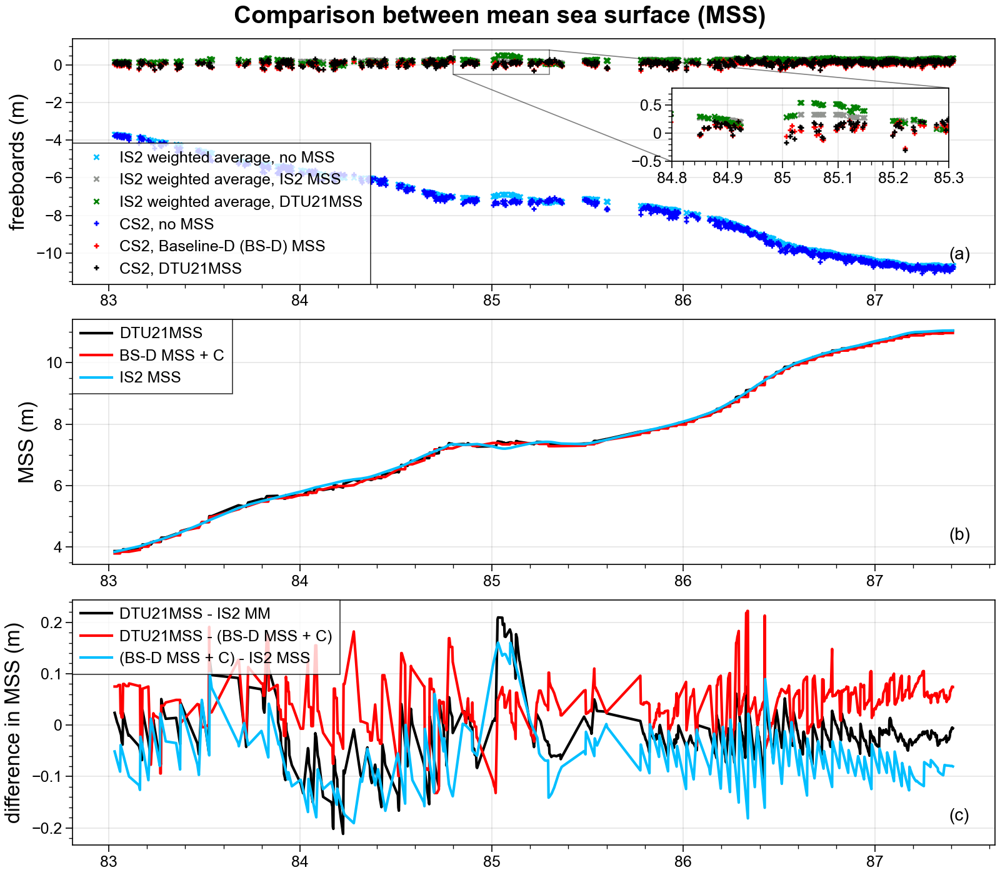

In [380]:
df_jan_short_extra = df_jan[500:800]
plot_MSS(df_jan_short)

In [147]:
df_jan_short.columns

Index(['Unnamed: 0', 'index', 'lat', 'lon', 'fb', 'mss', 'fb_no_mss', 'ssd',
       'ppk', 'IS2_mean_fb', 'IS2_w_mean_fb', 'IS2_mean_gw', 'IS2_mean_MSS',
       'MSS_DTU21', 'snow_depth_DTU21MSS', 'snow_depth_w_DTU21MSS',
       'CS2_fb_DTU21MSS', 'IS2_fb_DTU21MSS', 'IS2_w_fb_DTU21MSS', 'AMSR2_SIC',
       'AMSR2_snow_depth'],
      dtype='object')

# Compare CRYO2ICE data

In [388]:
def load_data2(path, fp, lon_var, lat_var, fb_var):
    nc_file = netCDF4.Dataset(path + '/' + fp, 'r')
    lon = np.array(nc_file.variables[lon_var][:], dtype=np.float32)
    lat = np.array(nc_file.variables[lat_var][:], dtype=np.float32)
    fb = np.array(nc_file.variables[fb_var][:], dtype=np.float32)
    
    return  lon, lat, fb



lon_type, lat_type, si_type = load_data2(r'C:\Users\rmfha\Downloads', 'ice_type_nh_polstere-100_multi_202011151200.nc', 'lon', 'lat', 'ice_type')
df_ice_type = pd.DataFrame({'lon':lon_type.flatten(), 'lat':lat_type.flatten(), 'ice_type':si_type.flatten()})

In [389]:
files_check_CS2_data = !ls E:/DTU/CRYO2ICE/Data/CRYO2ICE_DTU21MSS/r3500_allbeams_v3/*_D001_v3.csv
files_check_CS2_data

['E:/DTU/CRYO2ICE/Data/CRYO2ICE_DTU21MSS/r3500_allbeams_v3/CRYO2ICE_CS_OFFL_SIR_SAR_2__20201102T123414_20201102T123933_D001_v3.csv',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_DTU21MSS/r3500_allbeams_v3/CRYO2ICE_CS_OFFL_SIR_SAR_2__20201105T032414_20201105T033327_D001_v3.csv',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_DTU21MSS/r3500_allbeams_v3/CRYO2ICE_CS_OFFL_SIR_SAR_2__20201105T050433_20201105T051225_D001_v3.csv',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_DTU21MSS/r3500_allbeams_v3/CRYO2ICE_CS_OFFL_SIR_SAR_2__20201106T091244_20201106T091824_D001_v3.csv',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_DTU21MSS/r3500_allbeams_v3/CRYO2ICE_CS_OFFL_SIR_SAR_2__20201106T105159_20201106T105849_D001_v3.csv',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_DTU21MSS/r3500_allbeams_v3/CRYO2ICE_CS_OFFL_SIR_SAR_2__20201108T204331_20201108T204757_D001_v3.csv',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_DTU21MSS/r3500_allbeams_v3/CRYO2ICE_CS_OFFL_SIR_SAR_2__20201108T222250_20201108T222813_D001_v3.csv',
 'E:/DTU/CRYO2ICE/Data/CRYO2ICE_DTU21MSS/r3500_allbeams_v3/CRYO2ICE_C

In [390]:
li = []
k = 0
for filename in files_check_CS2_data:
    df = pd.read_csv(filename, index_col=None, header=0)
    df['ID']=k
    li.append(df)
    k = k+1
    
frame = pd.concat(li, axis=0, ignore_index=True)

In [391]:
files_check_CS2_data = !ls E:/DTU/CRYO2ICE/Data/CRYO2ICE_DTU21MSS/r3500_allbeams_v3/*_D001_ssd_ppk_filt_v3.csv
files_check_CS2_data

li = []
for filename in files_check_CS2_data:
    df = pd.read_csv(filename, index_col=None, header=0)
    li.append(df)
    
frame2 = pd.concat(li, axis=0, ignore_index=True)

In [392]:
frame

,Unnamed: 0,index,lat,lon,fb,mss,fb_no_mss,ssd,ppk,IS2_mean_fb,IS2_w_mean_fb,IS2_mean_gw,IS2_mean_MSS,MSS_DTU21,snow_depth_DTU21MSS,snow_depth_w_DTU21MSS,CS2_fb_DTU21MSS,IS2_fb_DTU21MSS,IS2_w_fb_DTU21MSS,ID
0,97,97,81.120260,-102.627123,0.319,6.726,-6.407,44.04,8.760796,-6.986553,-6.985426,0.239766,7.563666,7.427,0.165805,0.167195,0.306,0.440447,0.441574,0
1,98,98,81.122900,-102.631289,-0.029,6.726,-6.755,42.82,8.722953,-7.074371,-7.070129,0.224345,7.566825,7.427,0.486671,0.491902,-0.042,0.352629,0.356871,0
2,99,99,81.125540,-102.635457,-0.041,6.726,-6.767,30.74,12.614185,-7.142787,-7.132356,0.198303,7.569705,7.493,0.417097,0.429960,0.012,0.350213,0.360644,0
3,100,100,81.136098,-102.652154,0.316,6.726,-6.410,46.54,8.568687,-7.120055,-7.117760,0.208275,7.580596,7.493,0.004865,0.007696,0.369,0.372945,0.375240,0
4,101,101,81.138737,-102.656334,0.262,6.726,-6.464,46.18,9.881067,-7.119992,-7.117237,0.206962,7.581987,7.493,0.071537,0.074935,0.315,0.373008,0.375763,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23180,2782,2782,80.529797,-98.948962,-0.058,5.193,-5.251,31.31,9.503934,-5.372264,-5.381189,0.248658,5.991290,6.052,0.730985,0.719978,0.087,0.679736,0.670811,34
23181,2783,2783,80.527132,-98.952671,-0.054,5.193,-5.247,28.77,9.768323,-5.381351,-5.388858,0.244531,5.983164,6.052,0.714845,0.705588,0.091,0.670649,0.663143,34
23182,2784,2784,80.508473,-98.978576,-0.028,5.193,-5.221,37.40,9.158019,-5.393104,-5.425761,0.217008,5.939405,5.727,0.668287,0.628012,-0.208,0.333897,0.301239,34
23183,2785,2785,80.497811,-98.993336,-0.218,5.193,-5.411,38.04,9.057351,-5.425905,-5.444848,0.199536,5.923709,5.727,0.862150,0.838790,-0.398,0.301095,0.282153,34


In [407]:
def plot_panArctic3(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig, df_ice_type):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90
    cmap1 = plt.get_cmap('greys', 4)

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=75,lon_0=0, resolution='l',ax=ax, round=True)
    m.drawmeridians(np.arange(0,360,30),labels=[1,1,1,1],linewidth=0.5, fontsize=14, dashes=[1,5], color='navy')
    m.drawparallels(np.arange(-90,90,5),linewidth=0.5, fontsize=14, dashes=[1,5], color='navy')
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='lightgray')
    #m.fillcontinents(color='darkgray')
    #m.drawmapboundary(fill_color='dimgray')
    #cbar = m.etopo()
    cm = m.scatter(np.array(df_ice_type['lon']), np.array(df_ice_type['lat']),  latlon=True, c=np.array(df_ice_type['ice_type']), s = 0.5, vmin=1-0.5, vmax=4+0.5, cmap=cmap1)
    x=m.scatter(lon, lat, latlon=True, c=sit, s=5,vmin = min_set, vmax=max_set, cmap=cmap_set, zorder=1)
     #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x, cm

def plot_panArctic4(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig, df_ice_type):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90
    cmap1 = plt.get_cmap('greys', 4)

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=75,lon_0=0, resolution='l',ax=ax, round=True)
    #m.drawmeridians(np.arange(0,360,30),labels=[1,1,1,1],linewidth=0.5, fontsize=14, dashes=[1,5])
    #m.drawparallels(np.arange(-90,90,20),linewidth=0.5, fontsize=14, dashes=[1,5])
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='lightgray')
    #m.fillcontinents(color='darkgray')
    #m.drawmapboundary(fill_color='dimgray')
    #cbar = m.etopo()
    cm = m.scatter(np.array(df_ice_type['lon']), np.array(df_ice_type['lat']), latlon=True, c=np.array(df_ice_type['ice_type']), s = 0.5, vmin=1-0.5, vmax=4+0.5, cmap=cmap1)
    x=m.scatter(lon, lat, latlon=True, c=sit, s=5,vmin = min_set, vmax=max_set, cmap=cmap_set, zorder=1)
    #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x, cm

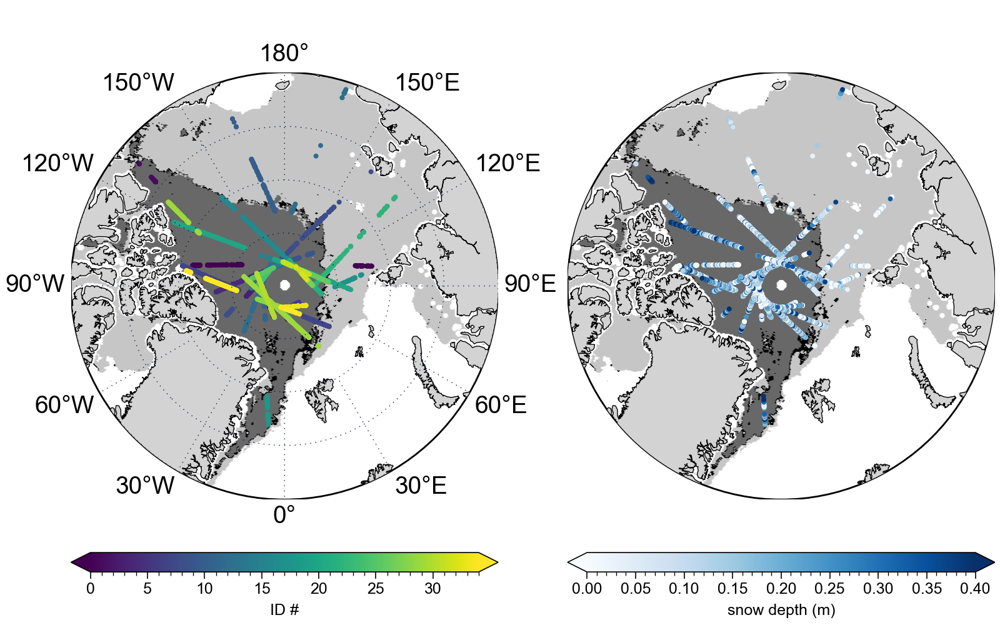

In [861]:
fig, ax = plt.subplots(nrows=1, ncols=2,figsize=(8,5), constrained_layout=True)
title = ''
im, cm = plot_panArctic3(np.array(frame['lon']), np.array(frame['lat']),  frame['ID'], 0, 34, 'viridis', 'radar freeboard (m)','max', ax[0],fig,df_ice_type)
plt.colorbar(im, ax=ax[0], orientation = 'horizontal', extend='both', label ='ID #')

title = ''
im, cm = plot_panArctic4(np.array(frame['lon']), np.array(frame['lat']),  np.array(frame['snow_depth_w_DTU21MSS']), 0, 0.4, 'blues', 'radar freeboard (m)','max', ax[1],fig,df_ice_type)
#cbar = plt.colorbar(cm, ax=ax[1], orientation = 'horizontal', extend='neither',label='sea ice type', ticks=np.arange(1,5))
#cbar.set_ticklabels(["OW", "FYI", "MYI", "AMB"])
plt.colorbar(im, ax=ax[1], orientation = 'horizontal', extend='both', label ='snow depth (m)')

plt.savefig('E:\demo_CRYO2ICE_snowdepth_ID.png', transparent=True)
#fig.suptitle('November 2020 (new binning method, r = 3500)')

In [1067]:
len(frame)

11233

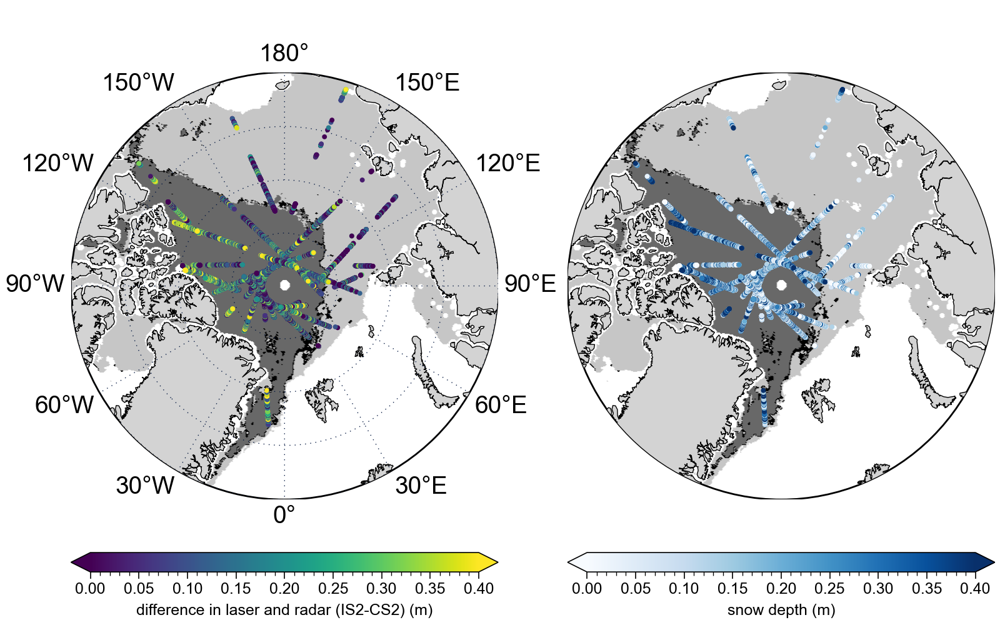

In [51]:
fig, ax = plt.subplots(nrows=1, ncols=2,figsize=(8,5), constrained_layout=True)
#title = 'No filtering'
im, cm = plot_panArctic3(np.array(frame['lon']), np.array(frame['lat']),  np.array(frame['IS2_w_fb_DTU21MSS']-frame['CS2_fb_DTU21MSS']), 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax[0],fig,df_ice_type)
plt.colorbar(im, ax=ax[0], orientation = 'horizontal', extend='both', label ='difference in laser and radar (IS2-CS2) (m)')

#title = 'SSD/PPK filtering'
im, cm = plot_panArctic4(np.array(frame['lon']), np.array(frame['lat']),  np.array(frame['snow_depth_w_DTU21MSS']), 0, 0.4, 'blues', 'radar freeboard (m)','max', ax[1],fig,df_ice_type)
#cbar = plt.colorbar(cm, ax=ax[1], orientation = 'horizontal', extend='neither',label='sea ice type', ticks=np.arange(1,5))
#cbar.set_ticklabels(["OW", "FYI", "MYI", "AMB"])
plt.colorbar(im, ax=ax[1], orientation = 'horizontal', extend='both', label ='snow depth (m)')

plt.savefig('E:\demo_CRYO2ICE_snowdepth.png', transparent=True)
#fig.suptitle('November 2020 (new binning method, r = 3500)')

In [395]:
#@jit
def bindataN(x, y, z, xG, yG, binsize, retbin=False, retloc=False):
    """
    Place unevenly spaced 2D data on a grid by 2D binning (nearest
    neighbor interpolation).
    NB: MAKE SURE YOU ARE USING THE NATIVE PROJECTION OF THE 2D DATA 
    SO THAT IT IS ORDERD CORRECTLY TO GENERATE THE MESHGRID BELOW!
    
    Parameters
    ----------
    x : ndarray (1D)
        The idependent data x-axis of the grid.
    y : ndarray (1D)
        The idependent data y-axis of the grid.
    z : ndarray (1D)
        The dependent data in the form z = f(x,y).
    binsize : scalar, optional
        The full width and height of each bin on the grid.  If each
        bin is a cube, then this is the x and y dimension.  This is
        the step in both directions, x and y. Defaults to 0.01.
    retbin : boolean, optional
        Function returns `bins` variable (see below for description)
        if set to True.  Defaults to True.
    retloc : boolean, optional
        Function returns `wherebins` variable (see below for description)
        if set to True.  Defaults to True.
   
    Returns
    -------
    grid : ndarray (2D)
        The evenly gridded data.  The value of each cell is the median
        value of the contents of the bin.
    bins : ndarray (2D)
        A grid the same shape as `grid`, except the value of each cell
        is the number of points in that bin.  Returns only if
        `retbin` is set to True.
    wherebin : list (2D)
        A 2D list the same shape as `grid` and `bins` where each cell
        contains the indicies of `z` which contain the values stored
        in the particular bin.
    Revisions
    ---------
    2010-07-11  ccampo  Initial version
    """
    # get extrema values.
    xmin, xmax = xG.min(), xG.max()
    ymin, ymax = yG.min(), yG.max()

    # make coordinate arrays.
    #xi      = xG[0]
    #yi      = yG[:, 0] #np.arange(ymin, ymax+binsize, binsize)
    #xi, yi = np.meshgrid(xi,yi)
    xi, yi = xG, yG
    #print(xi)
    #print(yi)
    # make the grid.
    grid           = np.zeros(xi.shape, dtype=x.dtype)
    nrow, ncol = grid.shape
    if retbin: bins = np.copy(grid)

    # create list in same shape as grid to store indices
    if retloc:
        wherebin = np.copy(grid)
        wherebin = wherebin.tolist()

    # fill in the grid.
    for row in range(nrow):
        for col in range(ncol):
            xc = xi[row, col]    # x coordinate.
            yc = yi[row, col]    # y coordinate.

            # find the position that xc and yc correspond to.
            posx = np.abs(x - xc)
            posy = np.abs(y - yc)
            ibin = np.logical_and(posx < binsize/2., posy < binsize/2.)
            ind  = np.where(ibin == True)[0]

            # fill the bin.
            bin = z[ibin]
            if retloc: wherebin[row][col] = ind
            if retbin: bins[row, col] = bin.size
            if bin.size != 0:
                binval         = np.median(bin)
                grid[row, col] = binval
            else:
                grid[row, col] = np.nan   # fill empty bins with nans.

    # return the grid
    if retbin:
        if retloc:
            return grid, bins, wherebin
        else:
            return grid, bins
    else:
        if retloc:
            return grid, wherebin
        else:
            return grid

def grid_data(lat_ori, lon_ori, var_ori, ref_lat, ref_lon, method_name):
    grid_var = griddata((lon_ori.flatten(), lat_ori.flatten()), var_ori.flatten(), (ref_lon, ref_lat), method=method_name)
    
    return grid_var

In [396]:
def load_data_grid(path, fp, lon_var, lat_var, snow_var, ice_type_var, SIC_variable):
    nc_file = netCDF4.Dataset(path + '/' + fp, 'r')
    lon = nc_file.variables[lon_var][:]
    lat = nc_file.variables[lat_var][:]
    snow = nc_file.variables[snow_var][:]
    ice_type = nc_file.variables[ice_type_var][:]
    SIC = nc_file.variables[SIC_variable][:]
    
    return  lon, lat, snow, ice_type, SIC

path = r'E:\DTU\CRYO2ICE\Data'
fp = 'awi-siral-l3c-sithick-cryosat2-rep-nh_25km_ease2-202011-fv2p4.nc'
lon_grid, lat_grid, snow_grid, ice_type_grid, SIC_grid = load_data_grid(path, fp, 'lon', 'lat', 'snow_depth', 'sea_ice_type', 'sea_ice_concentration' )

C:\Users\rmfha\AppData\Local\Temp/ipykernel_41744/2683026975.py:5: UserWarning: WARNING: valid_min not used since it
cannot be safely cast to variable data type
  snow = nc_file.variables[snow_var][:]
C:\Users\rmfha\AppData\Local\Temp/ipykernel_41744/2683026975.py:5: UserWarning: WARNING: valid_max not used since it
cannot be safely cast to variable data type
  snow = nc_file.variables[snow_var][:]
C:\Users\rmfha\AppData\Local\Temp/ipykernel_41744/2683026975.py:6: UserWarning: WARNING: valid_min not used since it
cannot be safely cast to variable data type
  ice_type = nc_file.variables[ice_type_var][:]
C:\Users\rmfha\AppData\Local\Temp/ipykernel_41744/2683026975.py:6: UserWarning: WARNING: valid_max not used since it
cannot be safely cast to variable data type
  ice_type = nc_file.variables[ice_type_var][:]
C:\Users\rmfha\AppData\Local\Temp/ipykernel_41744/2683026975.py:7: UserWarning: WARNING: valid_min not used since it
cannot be safely cast to variable data type
  SIC = nc_file.var

In [397]:
def load_data_grid_snowmodel(path, fp, lon_var, lat_var, snow_var):
    nc_file = netCDF4.Dataset(path + '/' + fp, 'r')
    lon = nc_file.variables[lon_var][:]
    lat = nc_file.variables[lat_var][:]
    snow = nc_file.variables[snow_var][:]
    ice_type = nc_file.variables[ice_type_var][:]
    SIC = nc_file.variables[SIC_variable][:]
    
    return  lon, lat, snow

path = r'E:\DTU\CRYO2ICE\Data'
fp = 'ubristol_cryosat2_seaicethickness_nh25km_2015_01_v1.nc'
title = ''
sit, lon, lat = load_data(path, fp, 'Snow_Depth', 'Longitude', 'Latitude')

TypeError: load_data() takes 2 positional arguments but 5 were given

In [398]:
grid_frame = bindataN(np.array(frame['lon']), np.array(frame['lat']), np.array(frame['snow_depth_w_DTU21MSS']), lon_grid, lat_grid, binsize=0.25)

(array([ 1.,  1.,  8., 37., 96., 87., 39., 10.,  7.,  3.]),
 array([-0.49151037, -0.36421726, -0.23692415, -0.10963105,  0.01766206,
         0.14495517,  0.27224828,  0.39954139,  0.5268345 ,  0.65412761,
         0.78142071]),
 <BarContainer object of 10 artists>)

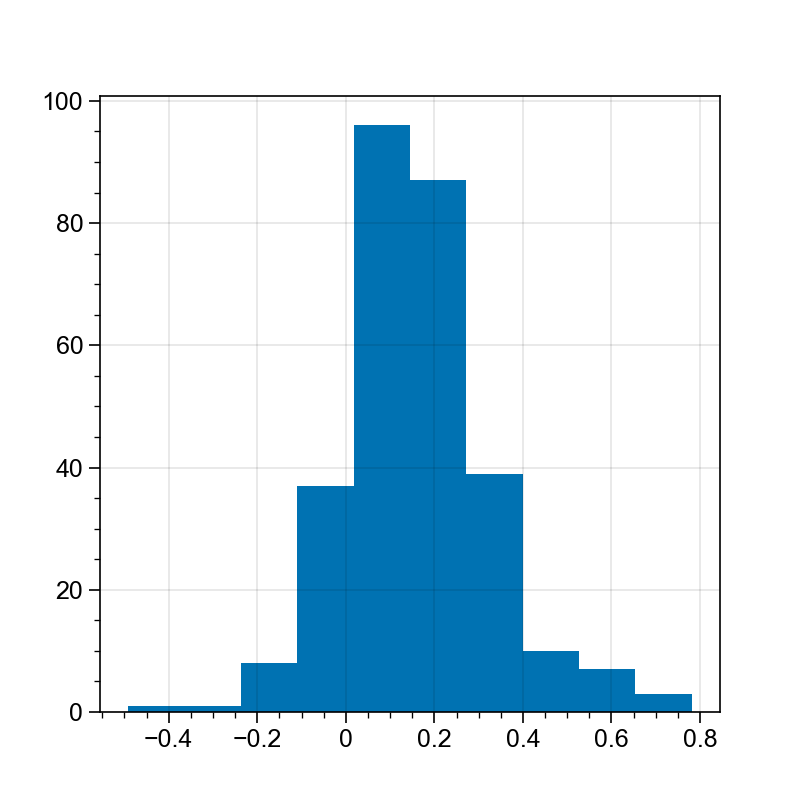

In [399]:
plt.hist(grid_frame.flatten())

(array([ 5.,  4., 35., 78., 90., 53., 11.,  9.,  3.,  1.]),
 array([-0.56977625, -0.45425552, -0.33873479, -0.22321406, -0.10769333,
         0.0078274 ,  0.12334813,  0.23886887,  0.3543896 ,  0.46991033,
         0.58543106]),
 <BarContainer object of 10 artists>)

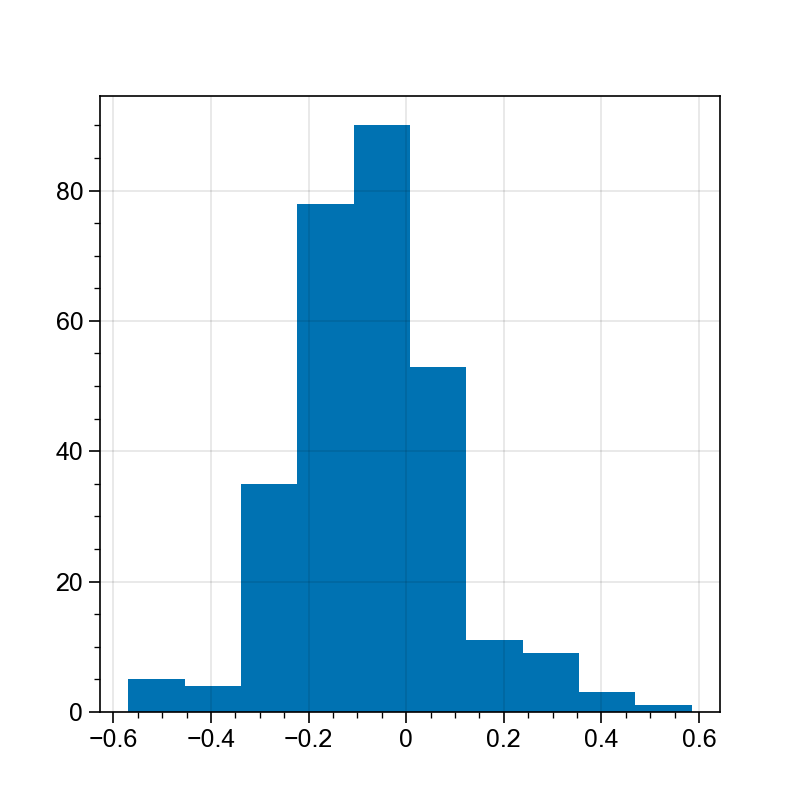

In [400]:
snow_grid.flatten()[np.isnan(grid_frame.flatten())] == np.nan
plt.hist(grid_frame.flatten()-snow_grid.flatten())

In [465]:
np.nanmean(snow_grid.flatten())

0.14169168

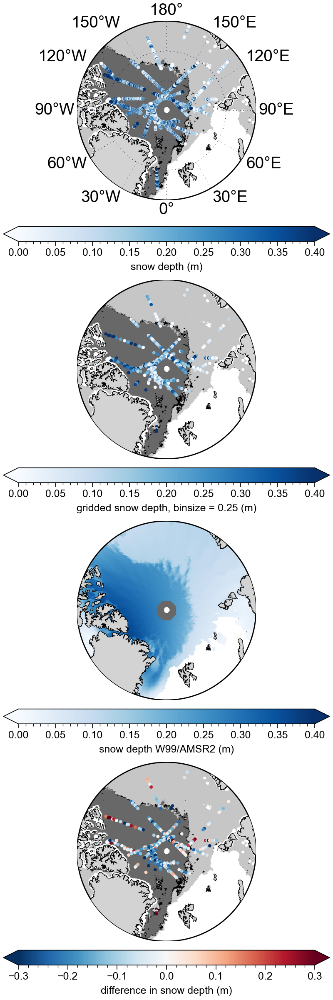

In [409]:
fig, ax = plt.subplots(nrows=4, ncols=1,figsize=(4,12), constrained_layout=True)
#title = 'No filtering'
im, cm = plot_panArctic3(np.array(frame['lon']), np.array(frame['lat']),  np.array(frame['snow_depth_w_DTU21MSS']), 0, 0.4, 'blues', 'radar freeboard (m)','max', ax[0],fig,df_ice_type)
#cbar = plt.colorbar(cm, ax=ax[1], orientation = 'horizontal', extend='neither',label='sea ice type', ticks=np.arange(1,5))
#cbar.set_ticklabels(["OW", "FYI", "MYI", "AMB"])
plt.colorbar(im, ax=ax[0], orientation = 'horizontal', extend='both', label ='snow depth (m)')

im, cm = plot_panArctic4(lon_grid.flatten(), lat_grid.flatten(),  grid_frame.flatten(), 0, 0.4, 'blues', 'radar freeboard (m)','max', ax[1],fig,df_ice_type)
plt.colorbar(im, ax=ax[1], orientation = 'horizontal', extend='both', label ='gridded snow depth, binsize = 0.25 (m)')


im, cm = plot_panArctic4(lon_grid.flatten(), lat_grid.flatten(),  snow_grid.flatten(), 0, 0.4, 'blues', 'mW99/AMSR2 in snow depth (m)','max', ax[2],fig,df_ice_type)
#cbar = plt.colorbar(cm, ax=ax[1], orientation = 'horizontal', extend='neither',label='sea ice type', ticks=np.arange(1,5))
#cbar.set_ticklabels(["OW", "FYI", "MYI", "AMB"])
plt.colorbar(im, ax=ax[2], orientation = 'horizontal', extend='both', label ='snow depth W99/AMSR2 (m)')

im, cm = plot_panArctic4(lon_grid.flatten(), lat_grid.flatten(),  grid_frame.flatten()-snow_grid.flatten(), -0.3, 0.3, 'RdBu_r', 'difference in snow depth (m)','max', ax[3],fig,df_ice_type)
#cbar = plt.colorbar(cm, ax=ax[1], orientation = 'horizontal', extend='neither',label='sea ice type', ticks=np.arange(1,5))
#cbar.set_ticklabels(["OW", "FYI", "MYI", "AMB"])
plt.colorbar(im, ax=ax[3], orientation = 'horizontal', extend='both', label ='difference in snow depth (m)')

plt.savefig('E:\demo_CRYO2ICE_snowdepth_nov2020_r3500.png', transparent=True)

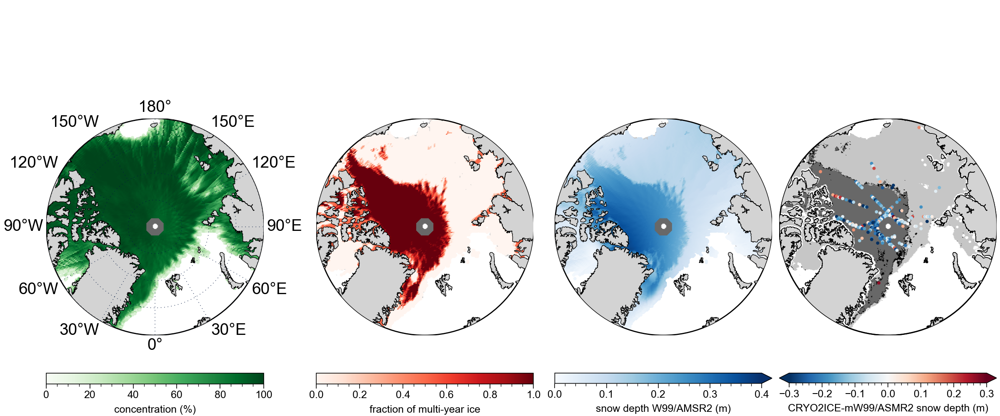

In [1066]:
fig, ax = plt.subplots(nrows=1, ncols=4,figsize=(12,5), constrained_layout=True)
#title = 'No filtering'
im, cm = plot_panArctic3(lon_grid.flatten(), lat_grid.flatten(),  SIC_grid.flatten(), 0, 100, 'greens', 'radar freeboard (m)','max', ax[0],fig,df_ice_type)
#cbar = plt.colorbar(cm, ax=ax[1], orientation = 'horizontal', extend='neither',label='sea ice type', ticks=np.arange(1,5))
#cbar.set_ticklabels(["OW", "FYI", "MYI", "AMB"])
plt.colorbar(im, ax=ax[0], orientation = 'horizontal', extend='neither', label ='concentration (%)')

im, cm = plot_panArctic4(lon_grid.flatten(), lat_grid.flatten(),  ice_type_grid.flatten(), 0, 1, 'reds', 'radar freeboard (m)','max', ax[1],fig,df_ice_type)
plt.colorbar(im, ax=ax[1], orientation = 'horizontal', extend='neither', label ='fraction of multi-year ice')


im, cm = plot_panArctic4(lon_grid.flatten(), lat_grid.flatten(),  snow_grid.flatten(), 0, 0.4, 'blues', 'mW99/AMSR2 in snow depth (m)','max', ax[2],fig,df_ice_type)
#cbar = plt.colorbar(cm, ax=ax[1], orientation = 'horizontal', extend='neither',label='sea ice type', ticks=np.arange(1,5))
#cbar.set_ticklabels(["OW", "FYI", "MYI", "AMB"])
plt.colorbar(im, ax=ax[2], orientation = 'horizontal', extend='max', label ='snow depth W99/AMSR2 (m)')

im, cm = plot_panArctic4(lon_grid.flatten(), lat_grid.flatten(),  grid_frame.flatten()-snow_grid.flatten(), -0.3, 0.3, 'RdBu_r', 'difference in snow depth (m)','max', ax[3],fig,df_ice_type)
#cbar = plt.colorbar(cm, ax=ax[1], orientation = 'horizontal', extend='neither',label='sea ice type', ticks=np.arange(1,5))
#cbar.set_ticklabels(["OW", "FYI", "MYI", "AMB"])
plt.colorbar(im, ax=ax[3], orientation = 'horizontal', extend='both', label ='CRYO2ICE-mW99/ASMR2 snow depth (m)')


In [1058]:
len(snow_grid.flatten()[~np.isnan(snow_grid.flatten())])

14110

In [1059]:
len(snow_grid.flatten())

186624

C:\Users\rmfha\Anaconda3\lib\site-packages\numpy\lib\function_base.py:3636: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  part.partition(kth)
C:\Users\rmfha\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:753: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


Text(0.5, 1.0, 'November 2020')

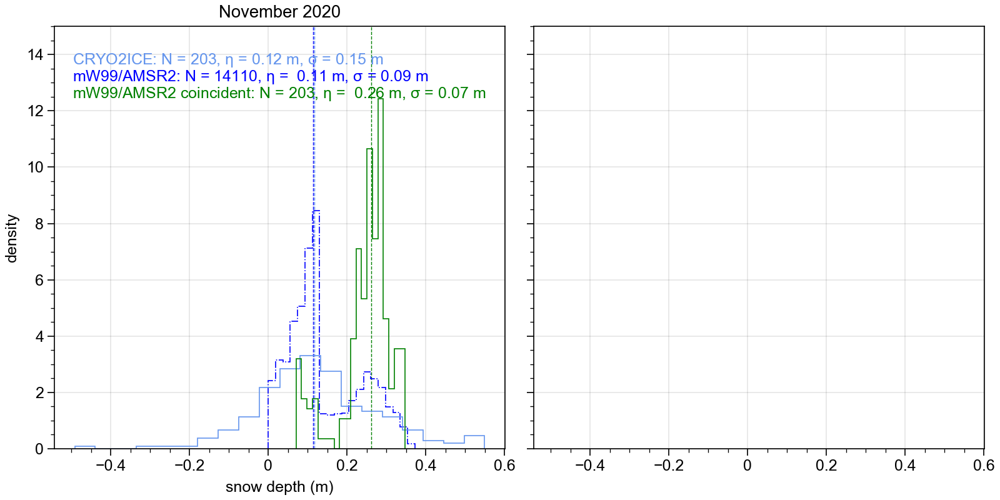

In [1065]:
fig,ax = plt.subplots(nrows=1, ncols=2,figsize=(8,4),constrained_layout=True, sharex=True, sharey=True)
n=0
N = len(CRYO2ICE_nov)
y, x, _ = ax[n].hist(snow_grid.flatten(), bins=20,histtype='step', label='IS2 (laser fb)', ls='-.', color='blue', density=True)
max_counts = y.max()*1.25
ax[n].hist(grid_frame.flatten(), histtype='step',bins=20, label='CS2 (radar fb)', color='cornflowerblue', density=True)
ax[n].hist(snow_grid.flatten()[~np.isnan(grid_frame.flatten())], histtype='step',bins=20, label='CS2 (radar fb)', color='green', density=True)
ax[n].vlines(np.nanmedian(grid_frame.flatten()), 0,5000, ls='--', color='cornflowerblue', linewidth=0.5, label='_nolegend_')
ax[n].vlines(np.nanmedian(snow_grid.flatten()), 0,5000, ls='--', color='blue', linewidth=0.5, label='_nolegend_')
ax[n].vlines(np.nanmedian(snow_grid.flatten()[~np.isnan(grid_frame.flatten())]), 0,5000, ls='--', color='green', linewidth=0.5, label='_nolegend_')
ax[n].set_ylim([0,max_counts])
ax[n].set_xlabel('snow depth (m)')
ax[n].set_ylabel('density')
m1 = np.nanmedian(grid_frame.flatten())
m2 = np.nanmedian(snow_grid.flatten())
s1 = np.nanstd(grid_frame.flatten())
s2 = np.nanstd(snow_grid.flatten())
N1 = len(snow_grid.flatten()[~np.isnan(snow_grid.flatten())])
N2 = len(grid_frame.flatten()[~np.isnan(grid_frame.flatten())])
m3 = np.nanmedian(snow_grid.flatten()[~np.isnan(grid_frame.flatten())])
s3 = np.nanstd(snow_grid.flatten()[~np.isnan(grid_frame.flatten())])
N3 = len(snow_grid.flatten()[~np.isnan(grid_frame.flatten())])
text_mean1 = r'CRYO2ICE: N = {0:0.0f}, $\eta$ = {1:.2f} m, $\sigma$ = {2:.2f} m'.format(N2, m1, s1)
text_mean2 = r'mW99/AMSR2: N = {0:0.0f}, $\eta$ =  {1:.2f} m, $\sigma$ = {2:.2f} m'.format(N1, m2, s2)
text_mean3 = r'mW99/AMSR2 coincident: N = {0:0.0f}, $\eta$ =  {1:.2f} m, $\sigma$ = {2:.2f} m'.format(N3, m3, s3)
ax[n].text(0.04,0.90,text_mean1,horizontalalignment='left', verticalalignment='bottom',transform = ax[n].transAxes,fontsize=9, color='cornflowerblue')
ax[n].text(0.04,0.86,text_mean2,horizontalalignment='left', verticalalignment='bottom',transform = ax[n].transAxes,fontsize=9, color='blue')
ax[n].text(0.04,0.82,text_mean3,horizontalalignment='left', verticalalignment='bottom',transform = ax[n].transAxes,fontsize=9, color='green')

ax[n].set_ylim(0,15)
ax[n].set_title('November 2020')

In [999]:
np.mean(grid_frame.flatten())

nan

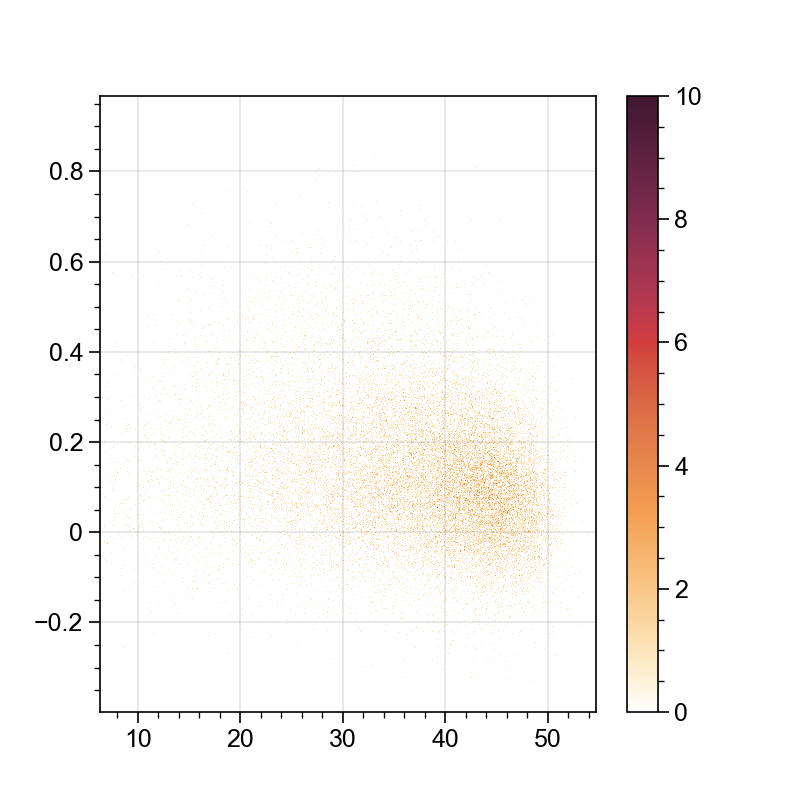

In [64]:
import datashader as ds
from datashader.mpl_ext import dsshow
import pandas as pd


def using_datashader(ax, x, y):

    df = pd.DataFrame(dict(x=x, y=y))
    dsartist = dsshow(
        df,
        ds.Point("x", "y"),
        ds.count(),
        vmin=0,
        vmax=10,
        norm="linear",
        aspect="auto",
        ax=ax,
    )

    plt.colorbar(dsartist)


fig, ax = plt.subplots()
using_datashader(ax,frame['ssd'],frame['IS2_w_fb_DTU21MSS']-frame['CS2_fb_DTU21MSS'])
plt.show()


In [123]:
import matplotlib.pyplot as plt
def using_hist2d(ax, x, y, bins=(50, 50)):
    # https://stackoverflow.com/a/20105673/3015186
    # Answer by askewchan
    im = ax.hist2d(x, y, bins, cmap=plt.cm.Blues, vmin=0, vmax=50)
    
    return im

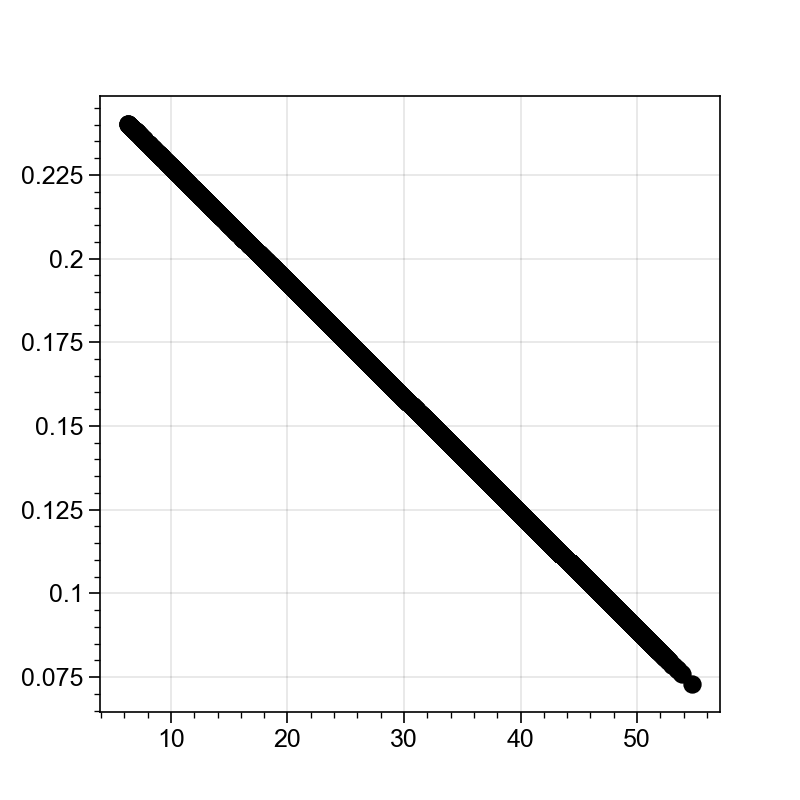

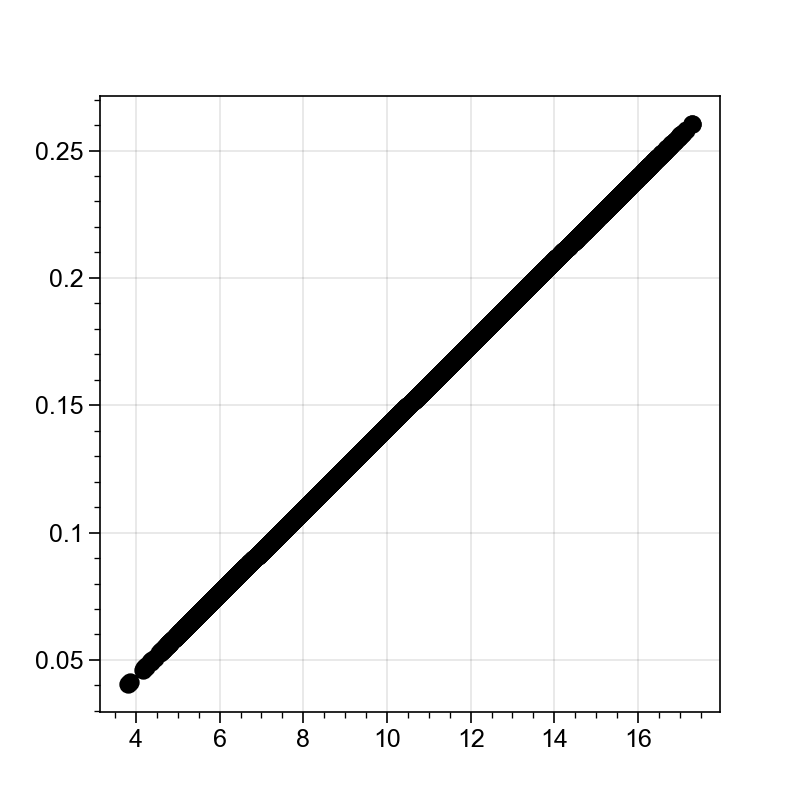

In [147]:
model_ssd = np.poly1d(np.polyfit(frame['ssd'],frame['IS2_w_fb_DTU21MSS']-frame['CS2_fb_DTU21MSS'], 1))

#add fitted polynomial line to scatterplot
polyline_ssd = np.linspace(1, 60, 50)
#plt.scatter(frame['ssd'],frame['IS2_w_fb_DTU21MSS']-frame['CS2_fb_DTU21MSS'])
plt.scatter(frame['ssd'], model_ssd(frame['ssd']), color='k', linestyle="-")
plt.show()

model_ppk = np.poly1d(np.polyfit(frame['ppk'],frame['IS2_w_fb_DTU21MSS']-frame['CS2_fb_DTU21MSS'], 1))

#add fitted polynomial line to scatterplot
polyline_ssd = np.linspace(1, 60, 50)
#plt.scatter(frame['ssd'],frame['IS2_w_fb_DTU21MSS']-frame['CS2_fb_DTU21MSS'])
plt.scatter(frame['ppk'], model_ppk(frame['ppk']), color='k', linestyle="-")
plt.show()

In [150]:
print(model_ppk)
print(model_ssd)

 
0.01632 x - 0.02169
 
-0.003457 x + 0.2621


In [784]:
frame.corr()

,Unnamed: 0,index,lat,lon,fb,mss,fb_no_mss,ssd,ppk,IS2_mean_fb,IS2_w_mean_fb,IS2_mean_gw,IS2_mean_MSS,MSS_DTU21,snow_depth_DTU21MSS,snow_depth_w_DTU21MSS,CS2_fb_DTU21MSS,IS2_fb_DTU21MSS,IS2_w_fb_DTU21MSS,ID
Unnamed: 0,1.000000,1.000000,-0.190754,0.209407,-0.068382,-0.449590,0.448872,0.025663,0.048500,0.448693,0.448569,0.210095,-0.448697,-0.449049,0.051775,0.045069,-0.047029,0.012290,0.003368,0.270210
index,1.000000,1.000000,-0.190754,0.209407,-0.068382,-0.449590,0.448872,0.025663,0.048500,0.448693,0.448569,0.210095,-0.448697,-0.449049,0.051775,0.045069,-0.047029,0.012290,0.003368,0.270210
lat,-0.190754,-0.190754,1.000000,0.226591,0.010597,0.646967,-0.647326,0.123146,0.044320,-0.649843,-0.649896,-0.396004,0.649073,0.648208,-0.213181,-0.214829,0.102331,-0.161784,-0.163870,0.062656
lon,0.209407,0.209407,0.226591,1.000000,-0.197084,0.149550,-0.152794,-0.072232,0.056310,-0.152827,-0.152795,-0.199262,0.148963,0.149763,-0.022328,-0.020538,-0.153987,-0.217490,-0.214343,0.133969
fb,-0.068382,-0.068382,0.010597,-0.197084,1.000000,0.059291,-0.043499,0.319193,-0.197111,-0.055803,-0.055758,0.099356,0.059696,0.059302,-0.619843,-0.616525,0.872599,0.229797,0.232042,0.068546
mss,-0.449590,-0.449590,0.646967,0.149550,0.059291,1.000000,-0.999875,0.017820,-0.017976,-0.999872,-0.999871,-0.294443,0.999959,0.999961,-0.135129,-0.133822,0.087833,-0.074583,-0.072855,0.059861
fb_no_mss,0.448872,0.448872,-0.647326,-0.152794,-0.043499,-0.999875,1.000000,-0.012778,0.014868,0.999802,0.999802,0.296257,-0.999827,-0.999836,0.125420,0.124164,-0.074082,0.078284,0.076590,-0.058824
ssd,0.025663,0.025663,0.123146,-0.072232,0.319193,0.017820,-0.012778,1.000000,-0.156496,-0.015173,-0.015132,0.014494,0.018522,0.017841,-0.121236,-0.118975,0.279416,0.177354,0.179468,0.084565
ppk,0.048500,0.048500,0.044320,0.056310,-0.197111,-0.017976,0.014868,-0.156496,1.000000,0.017217,0.017125,-0.042264,-0.018052,-0.018072,0.119219,0.114408,-0.177379,-0.055822,-0.061806,-0.060596
IS2_mean_fb,0.448693,0.448693,-0.649843,-0.152827,-0.055803,-0.999872,0.999802,-0.015173,0.017217,1.000000,0.999998,0.301560,-0.999920,-0.999889,0.145121,0.143770,-0.087893,0.087934,0.086120,-0.056664


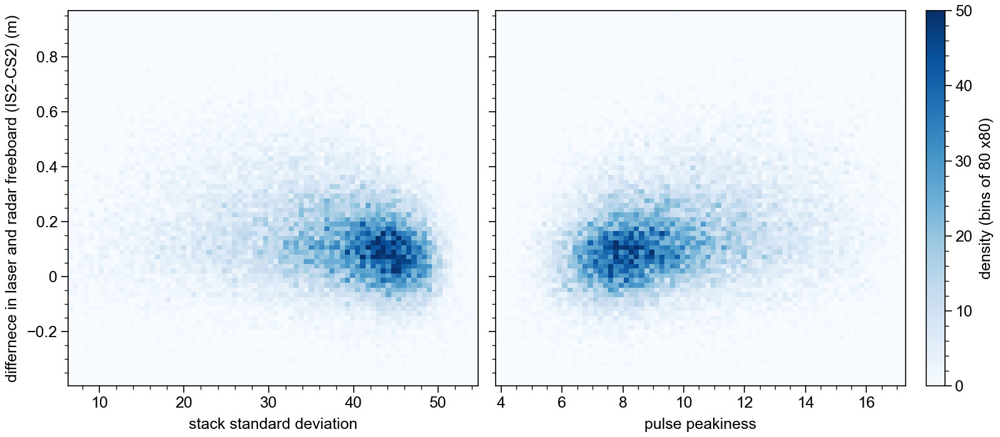

In [217]:
fig, ax = plt.subplots(1, 2, figsize=(8,3.5), constrained_layout=True, sharey=True)
im=using_hist2d(ax[0], frame['ssd'],frame['IS2_w_fb_DTU21MSS']-frame['CS2_fb_DTU21MSS'], bins=(80,80))
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0].set_xlabel('stack standard deviation')
ax[0].set_ylabel('differnece in laser and radar freeboard (IS2-CS2) (m)')

im=using_hist2d(ax[1], frame['ppk'],frame['IS2_w_fb_DTU21MSS']-frame['CS2_fb_DTU21MSS'], bins=(80,80))
plt.colorbar(im[3], label='density (bins of 80 x80)',ax=ax[1])
ax[1].set_xlabel('pulse peakiness')
#ax[1].set_ylabel('differnece in laser and radar freeboard (IS2-CS2) (m)')

plt.savefig('E:\demo_CRYO2ICE_roughness_histogram_comparison.png', transparent=True)

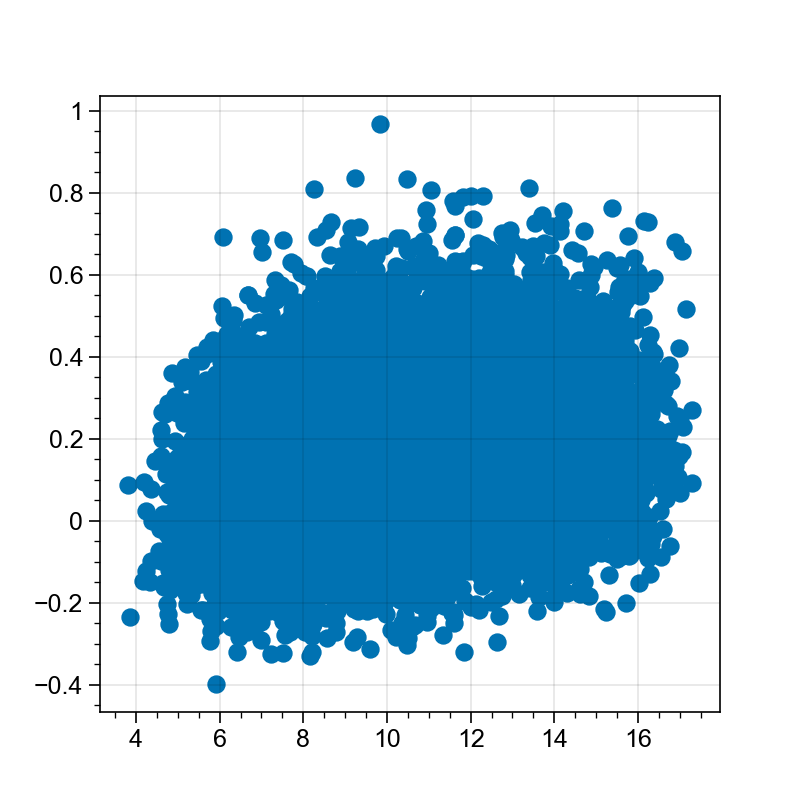

In [155]:
plt.scatter(frame['ppk'],frame['IS2_w_fb_DTU21MSS']-frame['CS2_fb_DTU21MSS'])

Text(0.5, 1.0, 'November 2020 (SSD and PPK filtering)')

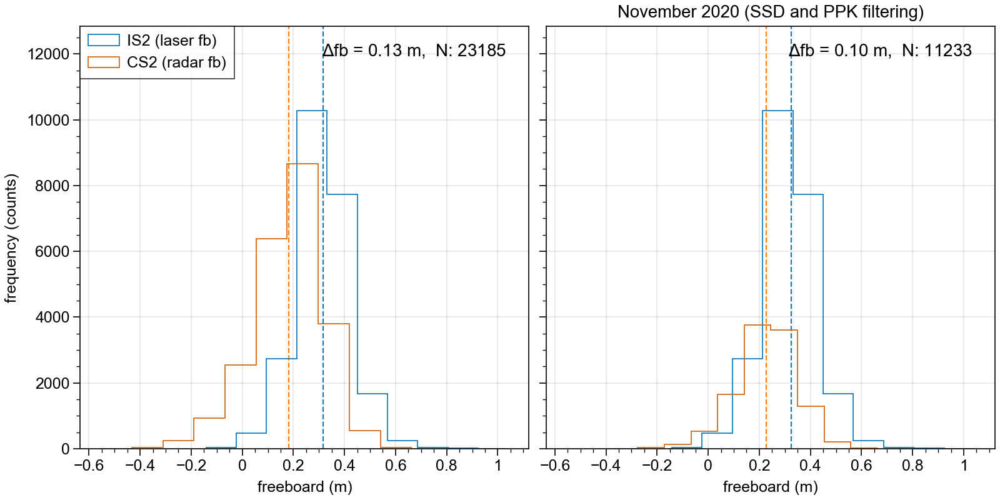

In [156]:
fig,ax = plt.subplots(nrows=1, ncols=2,figsize=(8,4),constrained_layout=True, sharex=True, sharey=True)
n=0
N = len(frame)
y, x, _ = ax[n].hist(frame['IS2_w_fb_DTU21MSS'], histtype='step', label='IS2 (laser fb)')
max_counts = y.max()*1.25
ax[n].hist(frame['CS2_fb_DTU21MSS'], histtype='step', label='CS2 (radar fb)')
ax[n].vlines(np.mean(frame['CS2_fb_DTU21MSS']), 0,max_counts, ls='--', color='tab:orange', linewidth=0.8, label='_nolegend_')
ax[n].vlines(np.mean(frame['IS2_w_fb_DTU21MSS']), 0,max_counts, ls='--', color='tab:blue', linewidth=0.8, label='_nolegend_')
ax[n].set_ylim([0,max_counts])
m = np.mean(frame['IS2_w_fb_DTU21MSS'])-np.mean(frame['CS2_fb_DTU21MSS'])
text_mean = r'$\Delta$fb = {0:.2f} m,  N: {1}'.format(m, N)
ax[n].text(0.95,0.92,text_mean,horizontalalignment='right', verticalalignment='bottom',transform = ax[n].transAxes,fontsize=10)
ax[n].legend(loc='upper left')
ax[n].set_xlabel('freeboard (m)')
ax[n].set_ylabel('frequency (counts)')

n = 1
N = len(frame2)
y, x, _ = ax[n].hist(frame['IS2_w_fb_DTU21MSS'], histtype='step', label='IS2 (laser fb)')
max_counts = y.max()*1.25
ax[n].hist(frame2['CS2_fb_DTU21MSS'], histtype='step', label='CS2 (radar fb)')
ax[n].vlines(np.mean(frame2['CS2_fb_DTU21MSS']), 0,max_counts, ls='--', color='tab:orange', linewidth=0.8, label='_nolegend_')
ax[n].vlines(np.mean(frame2['IS2_w_fb_DTU21MSS']), 0,max_counts, ls='--', color='tab:blue', linewidth=0.8, label='_nolegend_')
ax[n].set_ylim([0,max_counts])
m = np.mean(frame2['IS2_w_fb_DTU21MSS'])-np.mean(frame2['CS2_fb_DTU21MSS'])
text_mean = r'$\Delta$fb = {0:.2f} m,  N: {1}'.format(m, N)
ax[n].text(0.95,0.92,text_mean,horizontalalignment='right', verticalalignment='bottom',transform = ax[n].transAxes,fontsize=10)
#ax[n].legend(loc='upper left')
ax[n].set_xlabel('freeboard (m)')
#ax[n].set_ylabel('frequency (counts)')
ax[n].set_title('November 2020 (SSD and PPK filtering)')

In [157]:
np.mean(frame['IS2_w_fb_DTU21MSS'])-np.mean(frame['CS2_fb_DTU21MSS'])

0.13365285128015356

In [158]:
np.mean(frame['snow_depth_DTU21MSS'])

0.16395956864548558

# Comparison monthly 

In [54]:
def plot_panArctic5(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90
    cmap1 = plt.get_cmap('greys', 4)

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=70,lon_0=0, resolution='i',ax=ax, round=True)
    m.drawmeridians(np.arange(0,360,30),labels=[0,0,0,0],linewidth=0.5, fontsize=10, dashes=[1,5])
    m.drawparallels(np.arange(-90,90,15),linewidth=0.5, fontsize=10, dashes=[1,5],labels=[0,0,0,0])
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='lightgray')
    #m.fillcontinents(color='darkgray')
    #m.drawmapboundary(fill_color='dimgray')
    #cbar = m.etopo()
    x=m.scatter(lon, lat, latlon=True, c=sit, s=0.05,vmin = min_set, vmax=max_set, cmap=cmap_set, zorder=1)
     #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x

def plot_panArctic5_black(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90
    cmap1 = plt.get_cmap('greys', 4)

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=70,lon_0=0, resolution='i',ax=ax, round=True)
    m.drawmeridians(np.arange(0,360,30),labels=[0,0,0,0],linewidth=0.5, fontsize=10, dashes=[1,5])
    m.drawparallels(np.arange(-90,90,15),linewidth=0.5, fontsize=10, dashes=[1,5],labels=[0,0,0,0])
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='lightgray')
    #m.fillcontinents(color='darkgray')
    m.drawmapboundary(fill_color='black')
    #cbar = m.etopo()
    x=m.scatter(lon, lat, latlon=True, c=sit, s=0.05,vmin = min_set, vmax=max_set, cmap=cmap_set, zorder=1)
     #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x

In [55]:
from scipy import signal 
def load_CRYO2ICE_month(files_check_CS2_data):
    
    def smooth(y, box_pts):
        box = np.ones(box_pts)/box_pts
        y_smooth = np.convolve(y, box, mode='same')
        return y_smooth


    li = []
    k = 0
    for filename in files_check_CS2_data:
        df = pd.read_csv(filename, index_col=None, header=0)
        if len(df)>5:
            df['CS2_fb_smoothed']=smooth(np.array(df['fb']),5)
            df['CS2_LARM_fb_smoothed']=smooth(np.array(df['LARM_rfb']),5)
        else:
            df['CS2_fb_smoothed']=np.nan
            df['CS2_LARM_fb_smoothed'] = np.nan
        df['ID']=k
        
        
        C=0.714 # Reference CS2 baseline-D MSS to WGS84 instead of Topex/Poseidon ellipsoid
        ds = 0.30
        ns = (1+0.5*ds)**(-1.5)
        
        df['snow_depth_original_MSS_smoothed']=(df['IS2_w_mean_fb_MSS']-df['CS2_fb_smoothed'])/ns
        df['snow_depth_original_MSS_LARM_smoothed']=(df['IS2_w_mean_fb_MSS']-df['CS2_LARM_fb_smoothed'])/ns
        li.append(df)
        k = k+1
        li.append(df)

    frame2 = pd.concat(li, axis=0, ignore_index=True)
    
    return frame2

In [113]:

files_check_CS2_data = !ls E:/DTU/CRYO2ICE/Data/CRYO2ICE_original_MSS/FINAL_SMLG_AMSR2_CCI_LARM_v2/November/*_LARM_AMSR2_SMLG_final_v2.csv
CRYO2ICE_nov = load_CRYO2ICE_month(files_check_CS2_data)

files_check_CS2_data =  !ls E:/DTU/CRYO2ICE/Data/CRYO2ICE_original_MSS/FINAL_SMLG_AMSR2_CCI_LARM_v2/December/*_LARM_AMSR2_SMLG_final_v2.csv
CRYO2ICE_dec = load_CRYO2ICE_month(files_check_CS2_data)

files_check_CS2_data =  !ls E:/DTU/CRYO2ICE/Data/CRYO2ICE_original_MSS/FINAL_SMLG_AMSR2_CCI_LARM_v2/January/*_LARM_AMSR2_SMLG_final_v2.csv
CRYO2ICE_jan = load_CRYO2ICE_month(files_check_CS2_data)

files_check_CS2_data =  !ls E:/DTU/CRYO2ICE/Data/CRYO2ICE_original_MSS/FINAL_SMLG_AMSR2_CCI_LARM_v2/February/*_LARM_AMSR2_SMLG_final_v2.csv
CRYO2ICE_feb = load_CRYO2ICE_month(files_check_CS2_data)

files_check_CS2_data =  !ls E:/DTU/CRYO2ICE/Data/CRYO2ICE_original_MSS/FINAL_SMLG_AMSR2_CCI_LARM_v2/March/*_LARM_AMSR2_SMLG_final_v2.csv
CRYO2ICE_mar = load_CRYO2ICE_month(files_check_CS2_data)

files_check_CS2_data = !ls E:/DTU/CRYO2ICE/Data/CRYO2ICE_original_MSS/FINAL_SMLG_AMSR2_CCI_LARM_v2/April/*_LARM_AMSR2_SMLG_final_v2.csv
CRYO2ICE_apr = load_CRYO2ICE_month(files_check_CS2_data)
CRYO2ICE_apr


,Unnamed: 0,Unnamed: 0.1,index,lat,lon,fb,mss,fb_no_mss,ssd,ppk,...,AMSR2_snow_depth,SMLG_snow_depth,SMLG_snow_depth_v2,snow_depth_original_MSS_LARM,snow_depth_original_MSS_CCI,CS2_fb_smoothed,CS2_LARM_fb_smoothed,ID,snow_depth_original_MSS_smoothed,snow_depth_original_MSS_LARM_smoothed
0,0,0,0,84.38639,-75.26185,0.040,17.565,-17.525,33.24,8.949271,...,NaN,0.373200,0.365563,NaN,0.344596,0.0864,NaN,0,0.406608,NaN
1,1,1,1,84.38895,-75.27208,0.136,17.565,-17.429,36.34,8.372132,...,NaN,0.373200,0.365563,0.277333,0.328053,0.1362,NaN,0,0.355248,NaN
2,2,2,2,84.39151,-75.28232,0.256,17.565,-17.309,39.61,6.484267,...,NaN,0.373200,0.365563,NaN,0.074749,0.1792,NaN,0,0.309908,NaN
3,3,3,3,84.39918,-75.31308,0.249,17.565,-17.316,24.26,12.599154,...,NaN,0.373200,0.365563,NaN,0.107454,0.2164,NaN,0,0.278909,NaN
4,4,4,4,84.40173,-75.32335,0.215,17.565,-17.350,31.80,11.225773,...,NaN,0.373200,0.365563,NaN,0.168563,0.2068,NaN,0,0.294002,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58273,705,1469,1469,84.99047,-51.64480,0.253,19.401,-19.148,34.61,8.262198,...,NaN,0.250882,0.267992,0.199101,0.198310,0.2456,NaN,62,0.150606,NaN
58274,706,1470,1470,84.98796,-51.65752,0.346,19.401,-19.055,36.67,6.510193,...,NaN,0.250882,0.267992,NaN,-0.102693,0.2110,NaN,62,0.191835,NaN
58275,707,1471,1471,84.97542,-51.72098,0.118,19.401,-19.283,16.03,10.903931,...,NaN,0.276650,0.294351,NaN,0.132434,0.1914,NaN,62,0.147641,NaN
58276,708,1472,1472,84.97291,-51.73363,0.036,19.450,-19.414,35.05,7.051065,...,NaN,0.276650,0.294351,NaN,0.001001,0.1408,NaN,62,0.077473,NaN


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

Text(0.65, 0.1, 'April')

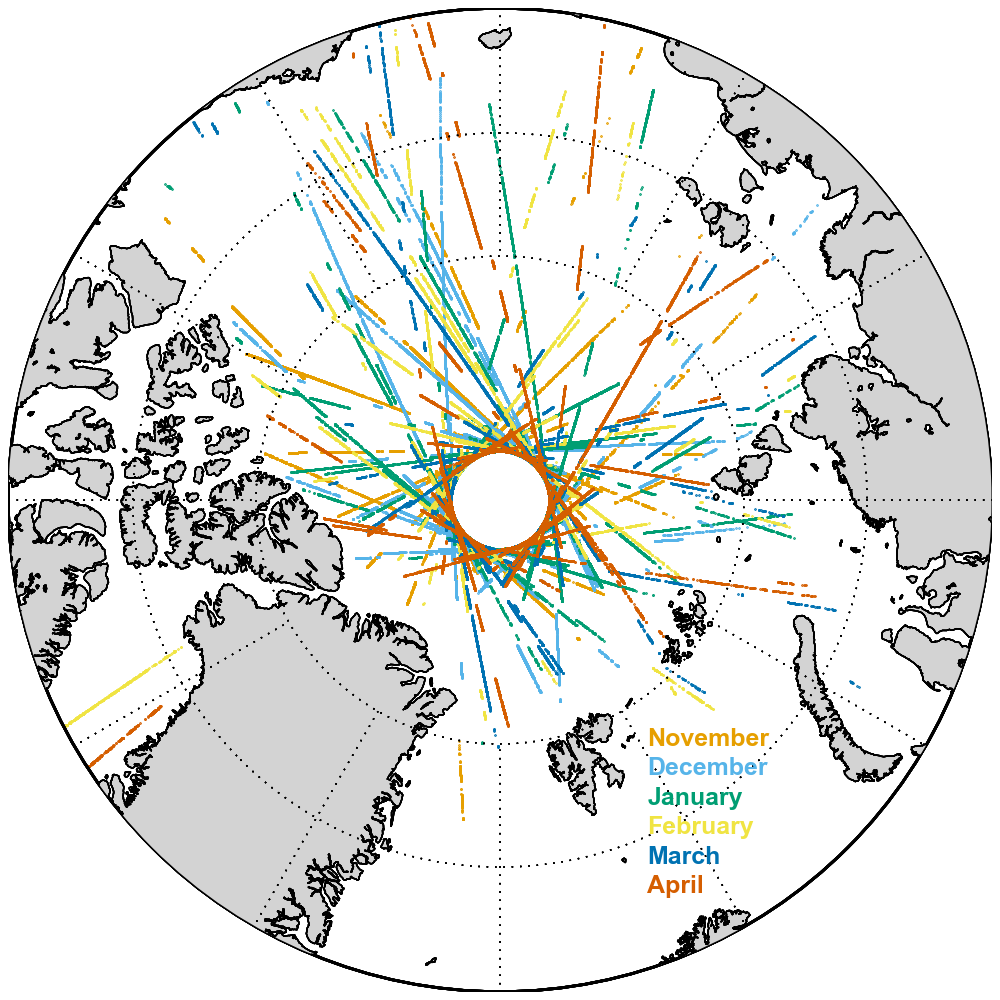

In [68]:
from matplotlib.lines import Line2D
fig, ax = plt.subplots(figsize=(5,5), constrained_layout=True)
title = ''

#cmap_qual = plt.get_cmap('colorblind10') 
im = plot_panArctic5(np.array(CRYO2ICE_nov['lon']), np.array(CRYO2ICE_nov['lat']), cmap_qual(0), 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic5(np.array(CRYO2ICE_dec['lon']), np.array(CRYO2ICE_dec['lat']), cmap_qual(1), 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic5(np.array(CRYO2ICE_jan['lon']), np.array(CRYO2ICE_jan['lat']), cmap_qual(2), 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic5(np.array(CRYO2ICE_feb['lon']), np.array(CRYO2ICE_feb['lat']), cmap_qual(3), 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic5(np.array(CRYO2ICE_mar['lon']), np.array(CRYO2ICE_mar['lat']), cmap_qual(4), 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic5(np.array(CRYO2ICE_apr['lon']), np.array(CRYO2ICE_apr['lat']), cmap_qual(5), 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)

ax.text(0.65, 0.25, 'November', color=cmap_qual(0), transform= ax.transAxes,weight="bold")
ax.text(0.65, 0.22, 'December', color=cmap_qual(1), transform= ax.transAxes,weight="bold")
ax.text(0.65, 0.19, 'January', color=cmap_qual(2), transform= ax.transAxes,weight="bold")
ax.text(0.65, 0.16, 'February', color=cmap_qual(3), transform= ax.transAxes,weight="bold")
ax.text(0.65, 0.13, 'March', color=cmap_qual(4), transform= ax.transAxes,weight="bold")
ax.text(0.65, 0.10, 'April', color=cmap_qual(5), transform= ax.transAxes,weight="bold")

#plt.savefig('E:\demo_CRYO2ICE_coverage_months_combined.png', transparent=True)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

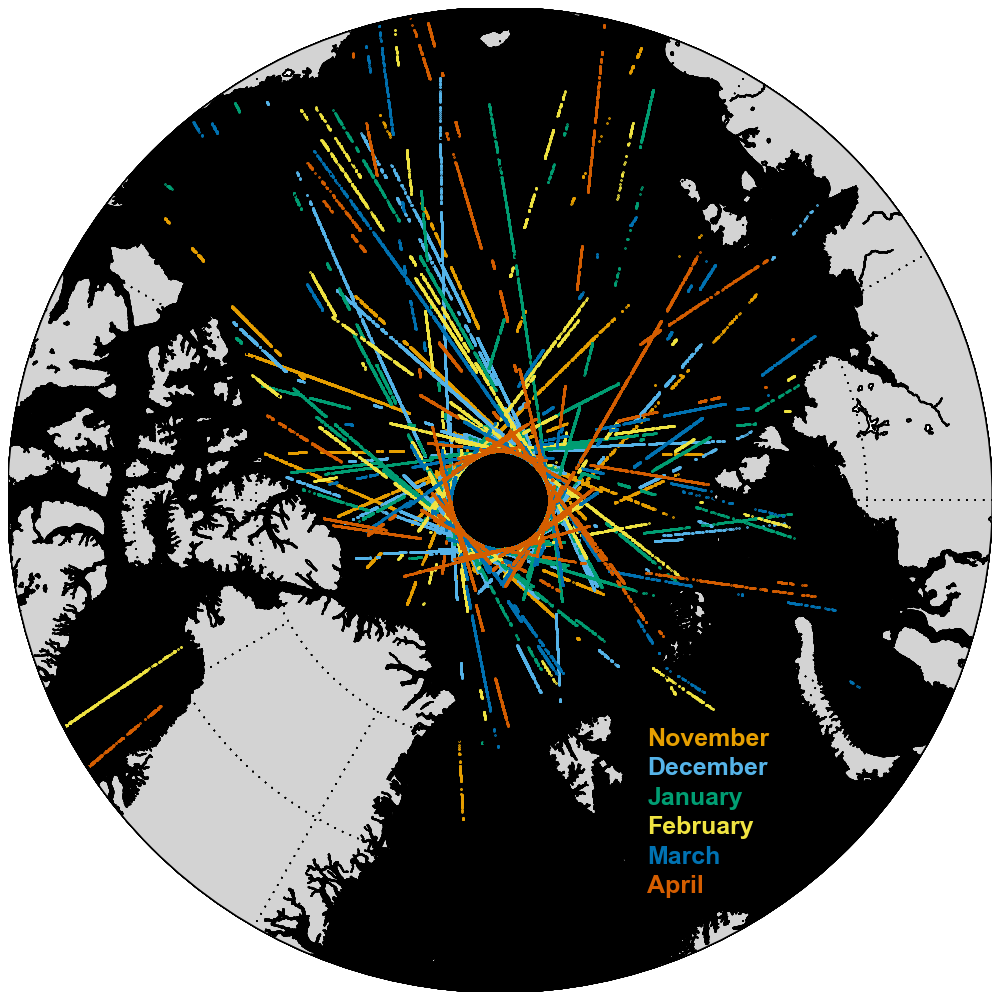

In [69]:
from matplotlib.lines import Line2D
fig, ax = plt.subplots(figsize=(5,5), constrained_layout=True)
title = ''
im = plot_panArctic5_black(np.array(CRYO2ICE_nov['lon']), np.array(CRYO2ICE_nov['lat']), cmap_qual(0), 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic5_black(np.array(CRYO2ICE_dec['lon']), np.array(CRYO2ICE_dec['lat']), cmap_qual(1), 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic5_black(np.array(CRYO2ICE_jan['lon']), np.array(CRYO2ICE_jan['lat']), cmap_qual(2), 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic5_black(np.array(CRYO2ICE_feb['lon']), np.array(CRYO2ICE_feb['lat']), cmap_qual(3), 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic5_black(np.array(CRYO2ICE_mar['lon']), np.array(CRYO2ICE_mar['lat']), cmap_qual(4), 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic5_black(np.array(CRYO2ICE_apr['lon']), np.array(CRYO2ICE_apr['lat']), cmap_qual(5), 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)


'''
legend_elements = [Line2D([0], [0], color=cmap_qual(0), label='November'),
                   Line2D([0], [0], color=cmap_qual(1),  label='December'),
                  Line2D([0], [0], color=cmap_qual(2),  label='January'),
                  Line2D([0], [0], color=cmap_qual(3),  label='February'),
                  Line2D([0], [0], color=cmap_qual(4),  label='March'),
                  Line2D([0], [0], color=cmap_qual(5),  label='April')]
ax.legend(handles=legend_elements, loc='best', facecolor='white')
'''

ax.text(0.65, 0.25, 'November', color=cmap_qual(0), transform= ax.transAxes,weight="bold")
ax.text(0.65, 0.22, 'December', color=cmap_qual(1), transform= ax.transAxes,weight="bold")
ax.text(0.65, 0.19, 'January', color=cmap_qual(2), transform= ax.transAxes,weight="bold")
ax.text(0.65, 0.16, 'February', color=cmap_qual(3), transform= ax.transAxes,weight="bold")
ax.text(0.65, 0.13, 'March', color=cmap_qual(4), transform= ax.transAxes,weight="bold")
ax.text(0.65, 0.10, 'April', color=cmap_qual(5), transform= ax.transAxes,weight="bold")


plt.savefig('E:\demo_CRYO2ICE_coverage_months_combined_black_background.png', transparent=True)

In [114]:
CRYO2ICE_nov['month']='November'
CRYO2ICE_dec['month']='December'
CRYO2ICE_jan['month']='January'
CRYO2ICE_feb['month']='February'
CRYO2ICE_mar['month']='March'
CRYO2ICE_apr['month']='April'

frames = [CRYO2ICE_nov, CRYO2ICE_dec, CRYO2ICE_jan, CRYO2ICE_feb, CRYO2ICE_mar, CRYO2ICE_apr]

CRYO2ICE_comb_all = pd.concat(frames)
CRYO2ICE_comb_all['AMSR2_snow_depth_unit_m']=CRYO2ICE_comb_all['AMSR2_snow_depth']/100


In [115]:
def prep_CRYO2ICE(CRYO2ICE_nov):
    CRYO2ICE_nov['snow_depth_original_MSS_unit_cm']=CRYO2ICE_nov['snow_depth_original_MSS']*100
    CRYO2ICE_nov['snow_depth_original_MSS_LARM_unit_cm']=CRYO2ICE_nov['snow_depth_original_MSS_LARM']*100
    CRYO2ICE_nov['snow_depth_original_MSS_CCI_unit_cm']=CRYO2ICE_nov['snow_depth_original_MSS_CCI']*100
    CRYO2ICE_nov['SMLG_snow_depth_unit_cm']=CRYO2ICE_nov['SMLG_snow_depth']*100
    CRYO2ICE_nov['SMLG_snow_depth_v2_unit_cm']=CRYO2ICE_nov['SMLG_snow_depth_v2']*100
    CRYO2ICE_nov['snow_depth_original_MSS_smoothed_unit_cm']=CRYO2ICE_nov['snow_depth_original_MSS_smoothed']*100
    CRYO2ICE_nov['snow_depth_original_MSS_LARM_smoothed_unit_cm']=CRYO2ICE_nov['snow_depth_original_MSS_LARM_smoothed']*100    
    CRYO2ICE_nov_LARM_SMLG_coincident = CRYO2ICE_nov[(CRYO2ICE_nov['snow_depth_original_MSS_CCI'].notna())&(CRYO2ICE_nov['snow_depth_original_MSS_LARM'].notna()) & (CRYO2ICE_nov['SMLG_snow_depth'].notna())]
    CRYO2ICE_nov_LARM_SMLG_AMSR2_coincident = CRYO2ICE_nov[(CRYO2ICE_nov['snow_depth_original_MSS_CCI'].notna())&(CRYO2ICE_nov['snow_depth_original_MSS_LARM'].notna()) & (CRYO2ICE_nov['SMLG_snow_depth'].notna())& (CRYO2ICE_nov['AMSR2_snow_depth'].notna())]
    
    return CRYO2ICE_nov_LARM_SMLG_coincident, CRYO2ICE_nov_LARM_SMLG_AMSR2_coincident

CRYO2ICE_nov_LARM_SMLG_coincident, CRYO2ICE_nov_LARM_SMLG_AMSR2_coincident = prep_CRYO2ICE(CRYO2ICE_nov)
CRYO2ICE_dec_LARM_SMLG_coincident, CRYO2ICE_dec_LARM_SMLG_AMSR2_coincident = prep_CRYO2ICE(CRYO2ICE_dec)
CRYO2ICE_jan_LARM_SMLG_coincident, CRYO2ICE_jan_LARM_SMLG_AMSR2_coincident = prep_CRYO2ICE(CRYO2ICE_jan)
CRYO2ICE_feb_LARM_SMLG_coincident, CRYO2ICE_feb_LARM_SMLG_AMSR2_coincident = prep_CRYO2ICE(CRYO2ICE_feb)
CRYO2ICE_mar_LARM_SMLG_coincident, CRYO2ICE_mar_LARM_SMLG_AMSR2_coincident = prep_CRYO2ICE(CRYO2ICE_mar)
CRYO2ICE_apr_LARM_SMLG_coincident, CRYO2ICE_apr_LARM_SMLG_AMSR2_coincident = prep_CRYO2ICE(CRYO2ICE_apr)

In [77]:
CRYO2ICE_nov_LARM_SMLG_coincident

,Unnamed: 0,Unnamed: 0.1,index,lat,lon,fb,mss,fb_no_mss,ssd,ppk,...,snow_depth_original_MSS_smoothed,snow_depth_original_MSS_LARM_smoothed,month,snow_depth_original_MSS_unit_cm,snow_depth_original_MSS_LARM_unit_cm,snow_depth_original_MSS_CCI_unit_cm,SMLG_snow_depth_unit_cm,SMLG_snow_depth_v2_unit_cm,snow_depth_original_MSS_smoothed_unit_cm,snow_depth_original_MSS_LARM_smoothed_unit_cm
0,0,97,97,81.12026,-102.62712,0.319,6.726,-6.407,44.04,8.760796,...,0.651692,NaN,November,32.095586,30.204857,23.575444,15.910046,15.647662,65.169159,NaN
2,2,99,99,81.12554,-102.63546,-0.041,6.726,-6.767,30.74,12.614185,...,0.335377,NaN,November,59.222718,55.812336,57.721886,21.642907,20.880616,33.537707,NaN
3,3,100,100,81.13610,-102.65215,0.316,6.726,-6.410,46.54,8.568687,...,0.417619,NaN,November,18.179353,24.000095,8.749331,21.642907,20.880616,41.761945,NaN
4,4,101,101,81.13874,-102.65633,0.262,6.726,-6.464,46.18,9.881067,...,0.377309,NaN,November,25.101817,26.460469,12.669313,21.642907,20.880616,37.730924,NaN
10,10,107,107,81.15457,-102.68146,0.040,6.857,-6.817,41.30,11.448542,...,0.441852,NaN,November,49.062831,46.799336,42.833638,21.642907,20.880616,44.185168,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44360,267,1043,1043,87.96033,-6.60651,0.123,16.977,-16.854,44.50,7.142480,...,0.349152,NaN,November,31.387246,27.884809,21.443358,9.904400,8.605072,34.915208,NaN
44363,270,1046,1046,87.95659,-7.13300,0.080,16.977,-16.897,28.62,9.342267,...,0.415568,NaN,November,36.866333,41.161731,35.878952,9.904400,8.605072,41.556834,NaN
44364,271,1047,1047,87.95604,-7.20806,0.034,16.977,-16.943,32.53,9.950443,...,0.347304,NaN,November,42.814735,51.965822,52.115950,9.904400,8.605072,34.730358,NaN
44365,272,1048,1048,87.95549,-7.28307,0.217,16.977,-16.760,40.39,7.079319,...,0.252504,NaN,November,20.595102,29.491399,20.012964,9.904400,8.605072,25.250407,NaN


C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/994642365.py:82: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  plt.subplots_adjust(wspace=0.0, hspace=0.0,right=0.8)


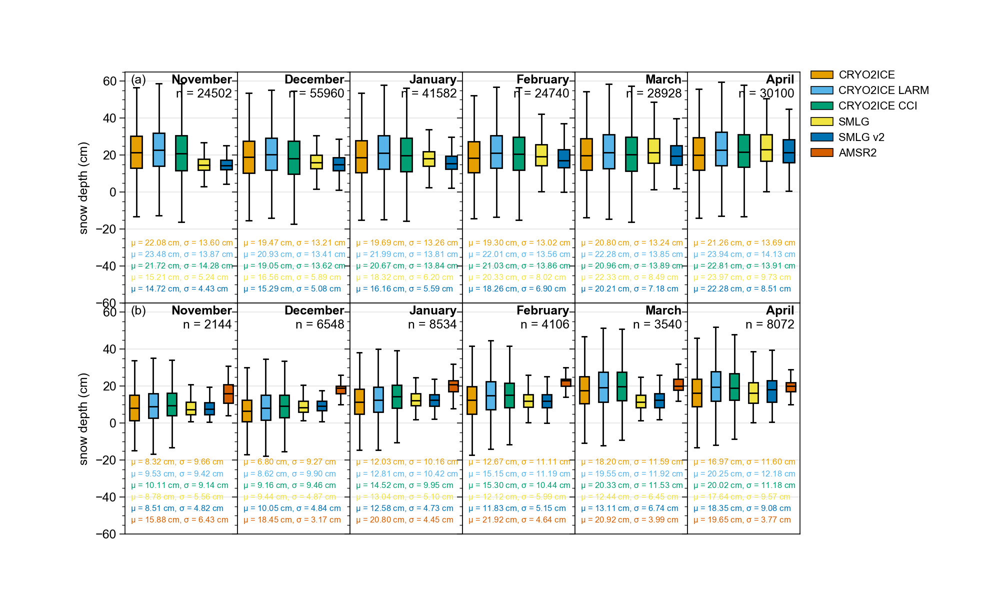

In [92]:
def plot_barplot_LARM_SMLG_coincident(ax,CRYO2ICE_nov_LARM_SMLG_coincident, colours, month):
    bbox2 = ax.boxplot([CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_LARM_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_CCI_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_v2_unit_cm']], showfliers=False, patch_artist=True)
    for patch, color, medians in zip(bbox2['boxes'], colours, bbox2['medians']):
        patch.set_facecolor(color)
        medians.set_color('black')

    #ax.set_xticklabels(['CRYO2ICE', 'CRYO2ICE LARM', 'SMLG'], rotation=45, ha='right', rotation_mode='anchor')
    ax.text(0.95, 0.95, month,transform = ax.transAxes,weight='bold', ha='right')
    ax.text(0.95, 0.89, 'n = {}'.format(len(CRYO2ICE_nov_LARM_SMLG_coincident)),transform = ax.transAxes, ha='right')
    #ax.set_title('LARM and SMLG coincident: n = {}'.format(len(CRYO2ICE_nov_LARM_SMLG_coincident)))
    ax.text(0.05, 0.25, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_unit_cm'])),transform = ax.transAxes, color = colours[0], fontsize=6)
    ax.text(0.05, 0.20, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_LARM_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_LARM_unit_cm'])),transform = ax.transAxes, color = colours[1], fontsize=6)
    ax.text(0.05, 0.15, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_CCI_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_CCI_unit_cm'])),transform = ax.transAxes, color = colours[2], fontsize=6)
    ax.text(0.05, 0.10, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_unit_cm'])),transform = ax.transAxes, color = colours[3], fontsize=6)
    ax.text(0.05, 0.05, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_v2_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_v2_unit_cm'])),transform = ax.transAxes, color = colours[4], fontsize=6)
    
    
    ax.set_xticks([])
    return

def plot_barplot_LARM_SMLG_AMSR2_coincident(ax,CRYO2ICE_nov_LARM_SMLG_coincident, colours, month):
    bbox2 = ax.boxplot([CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_LARM_unit_cm'],CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_CCI_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_v2_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['AMSR2_snow_depth']], showfliers=False, patch_artist=True)
    for patch, color, medians in zip(bbox2['boxes'], colours, bbox2['medians']):
        patch.set_facecolor(color)
        medians.set_color('black')

    #ax.set_xticklabels(['CRYO2ICE', 'CRYO2ICE LARM', 'SMLG'], rotation=45, ha='right', rotation_mode='anchor')
    ax.text(0.95, 0.95, month,transform = ax.transAxes,weight='bold', ha='right')
    ax.text(0.95, 0.89, 'n = {}'.format(len(CRYO2ICE_nov_LARM_SMLG_coincident)),transform = ax.transAxes, ha='right')
    #ax.set_title('LARM, SMLG and AMSR2 coincident: n = {}'.format(len(CRYO2ICE_nov_LARM_SMLG_coincident)))
    ax.text(0.05, 0.30, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_unit_cm'])),transform = ax.transAxes, color = colours[0], fontsize=6)
    ax.text(0.05, 0.25, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_LARM_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_LARM_unit_cm'])),transform = ax.transAxes, color = colours[1], fontsize=6)
    ax.text(0.05, 0.20, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_CCI_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_CCI_unit_cm'])),transform = ax.transAxes, color = colours[2], fontsize=6)
    ax.text(0.05, 0.15, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_unit_cm'])),transform = ax.transAxes, color = colours[3], fontsize=6)
    ax.text(0.05, 0.10, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_v2_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_v2_unit_cm'])),transform = ax.transAxes, color = colours[4], fontsize=6)
    ax.text(0.05, 0.05, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['AMSR2_snow_depth']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['AMSR2_snow_depth'])),transform = ax.transAxes, color = colours[5], fontsize=6)
    
    
    ax.set_xticks([])
    return


from matplotlib.patches import Patch
from matplotlib.lines import Line2D
fig, ax = plt.subplots(2,6, figsize=(10,6),constrained_layout=True, sharey=True)
#cmap_qual = plt.get_cmap('538')
colours = [cmap_qual(0)[0:3],cmap_qual(1)[0:3],cmap_qual(2)[0:3],cmap_qual(3)[0:3],cmap_qual(4)[0:3],cmap_qual(5)[0:3]]

month='November'
plot_barplot_LARM_SMLG_coincident(ax[0,0],CRYO2ICE_nov_LARM_SMLG_coincident, colours,month)
plot_barplot_LARM_SMLG_AMSR2_coincident(ax[1,0],CRYO2ICE_nov_LARM_SMLG_AMSR2_coincident, colours,month)

month='December'
plot_barplot_LARM_SMLG_coincident(ax[0,1],CRYO2ICE_dec_LARM_SMLG_coincident, colours,month)
plot_barplot_LARM_SMLG_AMSR2_coincident(ax[1,1],CRYO2ICE_dec_LARM_SMLG_AMSR2_coincident, colours,month)

month='January'
plot_barplot_LARM_SMLG_coincident(ax[0,2],CRYO2ICE_jan_LARM_SMLG_coincident, colours,month)
plot_barplot_LARM_SMLG_AMSR2_coincident(ax[1,2],CRYO2ICE_jan_LARM_SMLG_AMSR2_coincident, colours,month)

month='February'
plot_barplot_LARM_SMLG_coincident(ax[0,3],CRYO2ICE_feb_LARM_SMLG_coincident, colours,month)
plot_barplot_LARM_SMLG_AMSR2_coincident(ax[1,3],CRYO2ICE_feb_LARM_SMLG_AMSR2_coincident, colours,month)

month='March'
plot_barplot_LARM_SMLG_coincident(ax[0,4],CRYO2ICE_mar_LARM_SMLG_coincident, colours,month)
plot_barplot_LARM_SMLG_AMSR2_coincident(ax[1,4],CRYO2ICE_mar_LARM_SMLG_AMSR2_coincident, colours,month)

month='April'
plot_barplot_LARM_SMLG_coincident(ax[0,5],CRYO2ICE_apr_LARM_SMLG_coincident, colours,month)
plot_barplot_LARM_SMLG_AMSR2_coincident(ax[1,5],CRYO2ICE_apr_LARM_SMLG_AMSR2_coincident, colours,month)


legend_elements = [Patch(facecolor=colours[0], edgecolor='k',label='CRYO2ICE'),
                  Patch(facecolor=colours[1], edgecolor='k',label='CRYO2ICE LARM'),
                   Patch(facecolor=colours[2], edgecolor='k',label='CRYO2ICE CCI'),
                  Patch(facecolor=colours[3], edgecolor='k',label='SMLG'),
                   Patch(facecolor=colours[4], edgecolor='k',label='SMLG v2'),
                  Patch(facecolor=colours[5], edgecolor='k',label='AMSR2'),]

plt.legend(handles=legend_elements, loc='upper right', fontsize=8,bbox_to_anchor=(2.2, 2.03),frameon=False)
plt.subplots_adjust(wspace=0.0, hspace=0.0,right=0.8)
ax[0,0].set_ylabel('snow depth (cm)')
ax[1,0].set_ylabel('snow depth (cm)')

ax[0,0].set_ylim([-60,75])
ax[1,0].set_ylim([-60,65])

ax[0,0].text(0.05, 0.95, '(a)',transform = ax[0,0].transAxes)
ax[1,0].text(0.05, 0.95, '(b)',transform = ax[1,0].transAxes)

plt.savefig('E:\demo_CRYO2ICE_barplot_combined.png', transparent=True)

# AWI comparison 

In [181]:
path_AWI = r'E:\DTU\CRYO2ICE\AWI_buoy'
folder_AWI = '2020S107'
filename_AWI = '2020S108_300234066081170_proc.csv'
init_sd_1, init_sd_2,init_sd_3,init_sd_4 = np.nan,np.nan,np.nan,np.nan # metres

df_AWI_buoy = pd.read_csv(path_AWI+'/' + folder_AWI + '/'+filename_AWI)
df_AWI_buoy["datetime"] = pd.to_datetime(df_AWI_buoy["time"])
if init_sd_1 == np.nan:
    df_AWI_buoy['distance_to_initial_snow_ice_interface_1 (m)']=np.nan
else:
    df_AWI_buoy['distance_to_initial_snow_ice_interface_1 (m)']=df_AWI_buoy['distance_to_initial_snow_ice_interface_1 (m)']+init_sd_1

if init_sd_2 == np.nan:
    df_AWI_buoy['distance_to_initial_snow_ice_interface_2 (m)']= np.nan
else:
    df_AWI_buoy['distance_to_initial_snow_ice_interface_2 (m)']=df_AWI_buoy['distance_to_initial_snow_ice_interface_2 (m)']+init_sd_2

if init_sd_3 == np.nan:
    df_AWI_buoy['distance_to_initial_snow_ice_interface_3 (m)']= np.nan
else:
    df_AWI_buoy['distance_to_initial_snow_ice_interface_3 (m)']=df_AWI_buoy['distance_to_initial_snow_ice_interface_3 (m)']+init_sd_3

if init_sd_3 == np.nan:
    df_AWI_buoy['distance_to_initial_snow_ice_interface_4 (m)']=np.nan
else:
    df_AWI_buoy['distance_to_initial_snow_ice_interface_4 (m)']=df_AWI_buoy['distance_to_initial_snow_ice_interface_4 (m)']+init_sd_4

df_AWI_buoy.groupby(by=pd.Grouper(freq='D', key='datetime')).agg(np.nanmean)
snow_depth = np.array([df_AWI_buoy['distance_to_initial_snow_ice_interface_1 (m)'],df_AWI_buoy['distance_to_initial_snow_ice_interface_2 (m)'],df_AWI_buoy['distance_to_initial_snow_ice_interface_3 (m)'],df_AWI_buoy['distance_to_initial_snow_ice_interface_4 (m)']])
df_AWI_buoy['daily_snow_depth (m)'] = np.nanmean(snow_depth, axis=0)
df_AWI_buoy[df_AWI_buoy['daily_snow_depth (m)']<0] = np.nan

df_AWI_buoy.to_csv(path_AWI+'/' + folder_AWI +'_daily.csv')


C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/4056162567.py:30: RuntimeWarning: Mean of empty slice
  df_AWI_buoy['daily_snow_depth (m)'] = np.nanmean(snow_depth, axis=0)


In [178]:

df_AWI_buoy

,time,latitude (deg),longitude (deg),distance_to_initial_snow_ice_interface_1 (m),distance_to_initial_snow_ice_interface_2 (m),distance_to_initial_snow_ice_interface_3 (m),distance_to_initial_snow_ice_interface_4 (m),barometric_pressure (hPa),temperature_air (degC),temperature_body (degC),GPS_time_since_last_fix (min),datetime,daily_snow_depth (m)
0,2020-09-21T12:01:00,88.8594,121.3164,NaN,NaN,NaN,0.08,1012.4,-8.2,-2.4,0.0,2020-09-21 12:01:00,0.08
1,2020-09-21T13:01:00,88.8620,121.2236,NaN,NaN,NaN,0.08,1012.6,-8.0,-2.1,0.0,2020-09-21 13:01:00,0.08
2,2020-09-21T14:01:00,88.8650,121.1756,0.06,NaN,NaN,0.08,1012.6,-7.8,-1.8,0.0,2020-09-21 14:01:00,0.07
3,2020-09-21T15:01:00,88.8682,121.1786,0.06,NaN,0.04,0.08,1013.0,-7.8,-1.6,0.0,2020-09-21 15:01:00,0.06
4,2020-09-21T16:01:00,88.8706,121.2310,0.06,NaN,0.04,0.08,1012.9,-7.8,-1.4,0.0,2020-09-21 16:01:00,0.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4863,2021-04-12T03:01:00,84.0628,-18.5326,NaN,NaN,0.50,NaN,1017.9,-19.8,-5.2,0.0,2021-04-12 03:01:00,0.50
4864,2021-04-12T04:01:00,84.0608,-18.5156,NaN,NaN,0.50,NaN,1017.0,-18.7,-5.2,0.0,2021-04-12 04:01:00,0.50
4865,2021-04-12T05:01:00,84.0592,-18.4986,NaN,NaN,0.49,NaN,1016.1,-18.1,-5.2,0.0,2021-04-12 05:01:00,0.49
4866,2021-04-12T06:01:00,84.0574,-18.4848,NaN,NaN,0.49,NaN,1015.5,-17.3,-5.0,0.0,2021-04-12 06:01:00,0.49


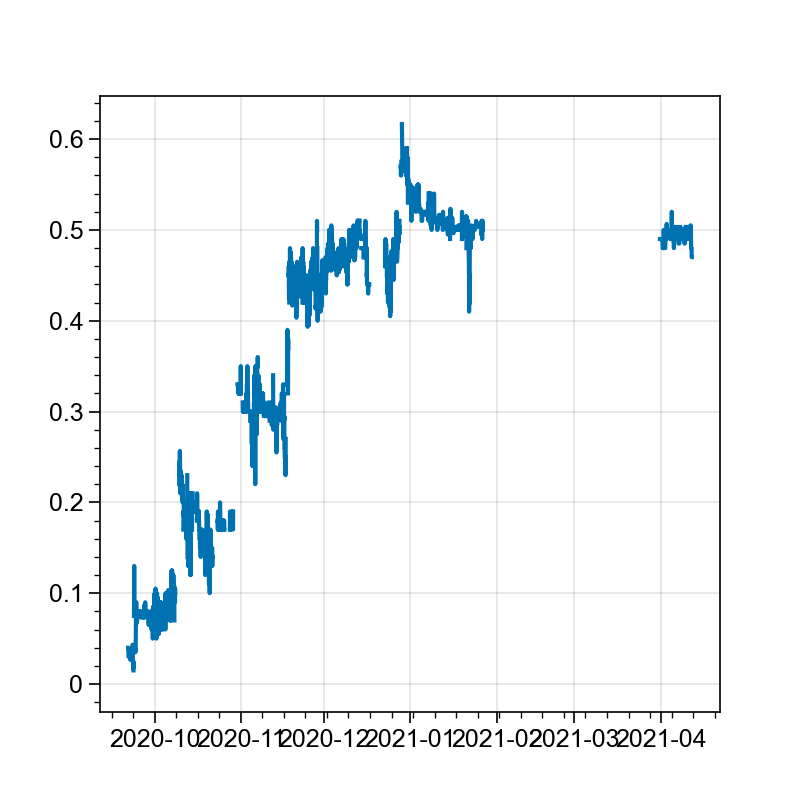

In [165]:
plt.plot(df_AWI_buoy['datetime'], df_AWI_buoy['daily_snow_depth (m)'])

In [151]:
np.nanmean(snow_depth, axis=0)

C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/3499227808.py:1: RuntimeWarning: Mean of empty slice
  np.shape(np.nanmean(snow_depth, axis=0))


(4868,)

C:\Users\rmfha\AppData\Local\Temp/ipykernel_46632/2226704871.py:103: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  plt.subplots_adjust(wspace=0.0, hspace=0.0,right=0.8)


Text(0.1, 0.95, 'Smoothed data: convolve filter')

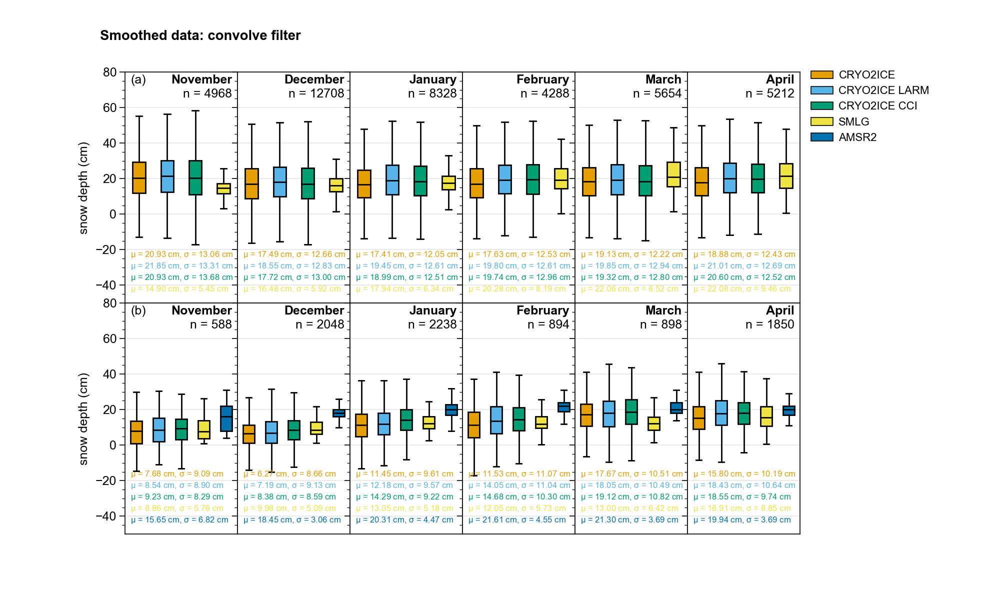

In [144]:
def plot_barplot_LARM_SMLG_coincident(ax,CRYO2ICE_nov_LARM_SMLG_coincident, colours, month):
    bbox2 = ax.boxplot([CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_LARM_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_CCI_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_unit_cm']], showfliers=False, patch_artist=True)
    for patch, color, medians in zip(bbox2['boxes'], colours, bbox2['medians']):
        patch.set_facecolor(color)
        medians.set_color('black')

    #ax.set_xticklabels(['CRYO2ICE', 'CRYO2ICE LARM', 'SMLG'], rotation=45, ha='right', rotation_mode='anchor')
    ax.text(0.95, 0.95, month,transform = ax.transAxes,weight='bold', ha='right')
    ax.text(0.95, 0.89, 'n = {}'.format(len(CRYO2ICE_nov_LARM_SMLG_coincident)),transform = ax.transAxes, ha='right')
    #ax.set_title('LARM and SMLG coincident: n = {}'.format(len(CRYO2ICE_nov_LARM_SMLG_coincident)))
    ax.text(0.05, 0.2, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_unit_cm'])),transform = ax.transAxes, color = colours[0], fontsize=6)
    ax.text(0.05, 0.15, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_LARM_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_LARM_unit_cm'])),transform = ax.transAxes, color = colours[1], fontsize=6)
    ax.text(0.05, 0.10, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_CCI_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_CCI_unit_cm'])),transform = ax.transAxes, color = colours[2], fontsize=6)
    ax.text(0.05, 0.05, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_unit_cm'])),transform = ax.transAxes, color = colours[3], fontsize=6)
    
    
    ax.set_xticks([])
    return

def plot_barplot_LARM_SMLG_AMSR2_coincident(ax,CRYO2ICE_nov_LARM_SMLG_coincident, colours, month):
    bbox2 = ax.boxplot([CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_LARM_unit_cm'],CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_CCI_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['AMSR2_snow_depth']], showfliers=False, patch_artist=True)
    for patch, color, medians in zip(bbox2['boxes'], colours, bbox2['medians']):
        patch.set_facecolor(color)
        medians.set_color('black')

    #ax.set_xticklabels(['CRYO2ICE', 'CRYO2ICE LARM', 'SMLG'], rotation=45, ha='right', rotation_mode='anchor')
    ax.text(0.95, 0.95, month,transform = ax.transAxes,weight='bold', ha='right')
    ax.text(0.95, 0.89, 'n = {}'.format(len(CRYO2ICE_nov_LARM_SMLG_coincident)),transform = ax.transAxes, ha='right')
    #ax.set_title('LARM, SMLG and AMSR2 coincident: n = {}'.format(len(CRYO2ICE_nov_LARM_SMLG_coincident)))
    ax.text(0.05, 0.25, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_unit_cm'])),transform = ax.transAxes, color = colours[0], fontsize=6)
    ax.text(0.05, 0.2, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_LARM_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_LARM_unit_cm'])),transform = ax.transAxes, color = colours[1], fontsize=6)
    ax.text(0.05, 0.15, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_CCI_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_CCI_unit_cm'])),transform = ax.transAxes, color = colours[2], fontsize=6)
    ax.text(0.05, 0.1, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_unit_cm'])),transform = ax.transAxes, color = colours[3], fontsize=6)
    ax.text(0.05, 0.05, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['AMSR2_snow_depth']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['AMSR2_snow_depth'])),transform = ax.transAxes, color = colours[4], fontsize=6)
    
    
    ax.set_xticks([])
    return


from matplotlib.patches import Patch
from matplotlib.lines import Line2D
fig, ax = plt.subplots(2,6, figsize=(10,6),constrained_layout=True, sharey=True)
#cmap_qual = plt.get_cmap('538')
colours = [cmap_qual(0)[0:3],cmap_qual(1)[0:3],cmap_qual(2)[0:3],cmap_qual(3)[0:3],cmap_qual(4)[0:3]]

month='November'
df= CRYO2ICE_nov_LARM_SMLG_coincident
CRYO2ICE_nov_LARM_SMLG_coincident_filt = df[(~np.isnan(df['snow_depth_original_MSS_smoothed_unit_cm'])) & (~np.isnan(df['snow_depth_original_MSS_LARM_smoothed_unit_cm']))]
df= CRYO2ICE_nov_LARM_SMLG_AMSR2_coincident
CRYO2ICE_nov_LARM_SMLG_AMSR2_coincident_filt = df[(~np.isnan(df['snow_depth_original_MSS_smoothed_unit_cm'])) & (~np.isnan(df['snow_depth_original_MSS_LARM_smoothed_unit_cm']))]
plot_barplot_LARM_SMLG_coincident(ax[0,0],CRYO2ICE_nov_LARM_SMLG_coincident_filt, colours,month)
plot_barplot_LARM_SMLG_AMSR2_coincident(ax[1,0],CRYO2ICE_nov_LARM_SMLG_AMSR2_coincident_filt, colours,month)

month='December'
df= CRYO2ICE_dec_LARM_SMLG_coincident
CRYO2ICE_dec_LARM_SMLG_coincident_filt = df[(~np.isnan(df['snow_depth_original_MSS_smoothed_unit_cm'])) & (~np.isnan(df['snow_depth_original_MSS_LARM_smoothed_unit_cm']))]
df= CRYO2ICE_dec_LARM_SMLG_AMSR2_coincident
CRYO2ICE_dec_LARM_SMLG_AMSR2_coincident_filt = df[(~np.isnan(df['snow_depth_original_MSS_smoothed_unit_cm'])) & (~np.isnan(df['snow_depth_original_MSS_LARM_smoothed_unit_cm']))]
plot_barplot_LARM_SMLG_coincident(ax[0,1],CRYO2ICE_dec_LARM_SMLG_coincident_filt, colours,month)
plot_barplot_LARM_SMLG_AMSR2_coincident(ax[1,1],CRYO2ICE_dec_LARM_SMLG_AMSR2_coincident_filt, colours,month)

month='January'
df= CRYO2ICE_jan_LARM_SMLG_coincident
CRYO2ICE_jan_LARM_SMLG_coincident_filt = df[(~np.isnan(df['snow_depth_original_MSS_smoothed_unit_cm'])) & (~np.isnan(df['snow_depth_original_MSS_LARM_smoothed_unit_cm']))]
df= CRYO2ICE_jan_LARM_SMLG_AMSR2_coincident
CRYO2ICE_jan_LARM_SMLG_AMSR2_coincident_filt = df[(~np.isnan(df['snow_depth_original_MSS_smoothed_unit_cm'])) & (~np.isnan(df['snow_depth_original_MSS_LARM_smoothed_unit_cm']))]
plot_barplot_LARM_SMLG_coincident(ax[0,2],CRYO2ICE_jan_LARM_SMLG_coincident_filt, colours,month)
plot_barplot_LARM_SMLG_AMSR2_coincident(ax[1,2],CRYO2ICE_jan_LARM_SMLG_AMSR2_coincident_filt, colours,month)

month='February'
df= CRYO2ICE_feb_LARM_SMLG_coincident
CRYO2ICE_feb_LARM_SMLG_coincident_filt = df[(~np.isnan(df['snow_depth_original_MSS_smoothed_unit_cm'])) & (~np.isnan(df['snow_depth_original_MSS_LARM_smoothed_unit_cm']))]
df= CRYO2ICE_feb_LARM_SMLG_AMSR2_coincident
CRYO2ICE_feb_LARM_SMLG_AMSR2_coincident_filt = df[(~np.isnan(df['snow_depth_original_MSS_smoothed_unit_cm'])) & (~np.isnan(df['snow_depth_original_MSS_LARM_smoothed_unit_cm']))]
plot_barplot_LARM_SMLG_coincident(ax[0,3],CRYO2ICE_feb_LARM_SMLG_coincident_filt, colours,month)
plot_barplot_LARM_SMLG_AMSR2_coincident(ax[1,3],CRYO2ICE_feb_LARM_SMLG_AMSR2_coincident_filt, colours,month)

month='March'
df= CRYO2ICE_mar_LARM_SMLG_coincident
CRYO2ICE_mar_LARM_SMLG_coincident_filt = df[(~np.isnan(df['snow_depth_original_MSS_smoothed_unit_cm'])) & (~np.isnan(df['snow_depth_original_MSS_LARM_smoothed_unit_cm']))]
df= CRYO2ICE_mar_LARM_SMLG_AMSR2_coincident
CRYO2ICE_mar_LARM_SMLG_AMSR2_coincident_filt = df[(~np.isnan(df['snow_depth_original_MSS_smoothed_unit_cm'])) & (~np.isnan(df['snow_depth_original_MSS_LARM_smoothed_unit_cm']))]
plot_barplot_LARM_SMLG_coincident(ax[0,4],CRYO2ICE_mar_LARM_SMLG_coincident_filt, colours,month)
plot_barplot_LARM_SMLG_AMSR2_coincident(ax[1,4],CRYO2ICE_mar_LARM_SMLG_AMSR2_coincident_filt, colours,month)

month='April'
df= CRYO2ICE_apr_LARM_SMLG_coincident
CRYO2ICE_apr_LARM_SMLG_coincident_filt = df[(~np.isnan(df['snow_depth_original_MSS_smoothed_unit_cm'])) & (~np.isnan(df['snow_depth_original_MSS_LARM_smoothed_unit_cm']))]
df= CRYO2ICE_apr_LARM_SMLG_AMSR2_coincident
CRYO2ICE_apr_LARM_SMLG_AMSR2_coincident_filt = df[(~np.isnan(df['snow_depth_original_MSS_smoothed_unit_cm'])) & (~np.isnan(df['snow_depth_original_MSS_LARM_smoothed_unit_cm']))]
plot_barplot_LARM_SMLG_coincident(ax[0,5],CRYO2ICE_apr_LARM_SMLG_coincident_filt, colours,month)
plot_barplot_LARM_SMLG_AMSR2_coincident(ax[1,5],CRYO2ICE_apr_LARM_SMLG_AMSR2_coincident_filt, colours,month)


legend_elements = [Patch(facecolor=colours[0], edgecolor='k',label='CRYO2ICE'),
                  Patch(facecolor=colours[1], edgecolor='k',label='CRYO2ICE LARM'),
                   Patch(facecolor=colours[2], edgecolor='k',label='CRYO2ICE CCI'),
                  Patch(facecolor=colours[3], edgecolor='k',label='SMLG'),
                  Patch(facecolor=colours[4], edgecolor='k',label='AMSR2'),]

plt.legend(handles=legend_elements, loc='upper right', fontsize=8,bbox_to_anchor=(2.2, 2.03),frameon=False)
plt.subplots_adjust(wspace=0.0, hspace=0.0,right=0.8)
ax[0,0].set_ylabel('snow depth (cm)')
ax[1,0].set_ylabel('snow depth (cm)')

ax[0,0].set_ylim([-50,80])
ax[1,0].set_ylim([-50,80])

ax[0,0].text(0.05, 0.95, '(a)',transform = ax[0,0].transAxes)
ax[1,0].text(0.05, 0.95, '(b)',transform = ax[1,0].transAxes)
plt.suptitle('Smoothed data: convolve filter',x=0.1, y=.95, horizontalalignment='left', verticalalignment='top')

#plt.savefig('E:\demo_CRYO2ICE_barplot_combined.png', transparent=True)

C:\Users\rmfha\AppData\Local\Temp/ipykernel_46632/2148181997.py:103: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  plt.subplots_adjust(wspace=0.0, hspace=0.0,right=0.8)


Text(0.1, 0.95, 'Filtered data: snow depths > 0 cm')

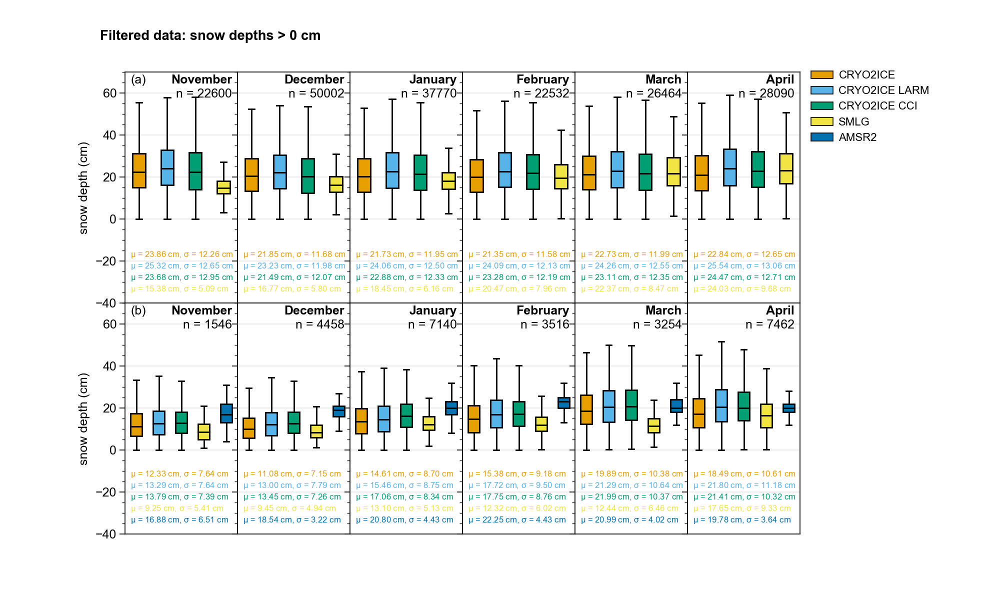

In [148]:
def plot_barplot_LARM_SMLG_coincident(ax,CRYO2ICE_nov_LARM_SMLG_coincident, colours, month):
    bbox2 = ax.boxplot([CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_LARM_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_CCI_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_unit_cm']], showfliers=False, patch_artist=True)
    for patch, color, medians in zip(bbox2['boxes'], colours, bbox2['medians']):
        patch.set_facecolor(color)
        medians.set_color('black')

    #ax.set_xticklabels(['CRYO2ICE', 'CRYO2ICE LARM', 'SMLG'], rotation=45, ha='right', rotation_mode='anchor')
    ax.text(0.95, 0.95, month,transform = ax.transAxes,weight='bold', ha='right')
    ax.text(0.95, 0.89, 'n = {}'.format(len(CRYO2ICE_nov_LARM_SMLG_coincident)),transform = ax.transAxes, ha='right')
    #ax.set_title('LARM and SMLG coincident: n = {}'.format(len(CRYO2ICE_nov_LARM_SMLG_coincident)))
    ax.text(0.05, 0.2, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_unit_cm'])),transform = ax.transAxes, color = colours[0], fontsize=6)
    ax.text(0.05, 0.15, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_LARM_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_LARM_unit_cm'])),transform = ax.transAxes, color = colours[1], fontsize=6)
    ax.text(0.05, 0.10, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_CCI_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_CCI_unit_cm'])),transform = ax.transAxes, color = colours[2], fontsize=6)
    ax.text(0.05, 0.05, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_unit_cm'])),transform = ax.transAxes, color = colours[3], fontsize=6)
    
    
    ax.set_xticks([])
    return

def plot_barplot_LARM_SMLG_AMSR2_coincident(ax,CRYO2ICE_nov_LARM_SMLG_coincident, colours, month):
    bbox2 = ax.boxplot([CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_LARM_unit_cm'],CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_CCI_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['AMSR2_snow_depth']], showfliers=False, patch_artist=True)
    for patch, color, medians in zip(bbox2['boxes'], colours, bbox2['medians']):
        patch.set_facecolor(color)
        medians.set_color('black')

    #ax.set_xticklabels(['CRYO2ICE', 'CRYO2ICE LARM', 'SMLG'], rotation=45, ha='right', rotation_mode='anchor')
    ax.text(0.95, 0.95, month,transform = ax.transAxes,weight='bold', ha='right')
    ax.text(0.95, 0.89, 'n = {}'.format(len(CRYO2ICE_nov_LARM_SMLG_coincident)),transform = ax.transAxes, ha='right')
    #ax.set_title('LARM, SMLG and AMSR2 coincident: n = {}'.format(len(CRYO2ICE_nov_LARM_SMLG_coincident)))
    ax.text(0.05, 0.25, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_unit_cm'])),transform = ax.transAxes, color = colours[0], fontsize=6)
    ax.text(0.05, 0.2, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_LARM_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_LARM_unit_cm'])),transform = ax.transAxes, color = colours[1], fontsize=6)
    ax.text(0.05, 0.15, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_CCI_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_CCI_unit_cm'])),transform = ax.transAxes, color = colours[2], fontsize=6)
    ax.text(0.05, 0.1, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_unit_cm']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_unit_cm'])),transform = ax.transAxes, color = colours[3], fontsize=6)
    ax.text(0.05, 0.05, '$\mu$ = {:.2f} cm, $\sigma$ = {:.2f} cm'.format(np.nanmean(CRYO2ICE_nov_LARM_SMLG_coincident['AMSR2_snow_depth']), np.nanstd(CRYO2ICE_nov_LARM_SMLG_coincident['AMSR2_snow_depth'])),transform = ax.transAxes, color = colours[4], fontsize=6)
    
    
    ax.set_xticks([])
    return


from matplotlib.patches import Patch
from matplotlib.lines import Line2D
fig, ax = plt.subplots(2,6, figsize=(10,6),constrained_layout=True, sharey=True)
#cmap_qual = plt.get_cmap('538')
colours = [cmap_qual(0)[0:3],cmap_qual(1)[0:3],cmap_qual(2)[0:3],cmap_qual(3)[0:3],cmap_qual(4)[0:3]]

month='November'
df= CRYO2ICE_nov_LARM_SMLG_coincident
CRYO2ICE_nov_LARM_SMLG_coincident_filt = df[(df['snow_depth_original_MSS_unit_cm']>0) & (df['snow_depth_original_MSS_LARM_unit_cm']>0) & (df['snow_depth_original_MSS_CCI_unit_cm']>0)]
df= CRYO2ICE_nov_LARM_SMLG_AMSR2_coincident
CRYO2ICE_nov_LARM_SMLG_AMSR2_coincident_filt = df[(df['snow_depth_original_MSS_unit_cm']>0) & (df['snow_depth_original_MSS_LARM_unit_cm']>0)& (df['snow_depth_original_MSS_CCI_unit_cm']>0)]
plot_barplot_LARM_SMLG_coincident(ax[0,0],CRYO2ICE_nov_LARM_SMLG_coincident_filt, colours,month)
plot_barplot_LARM_SMLG_AMSR2_coincident(ax[1,0],CRYO2ICE_nov_LARM_SMLG_AMSR2_coincident_filt, colours,month)

month='December'
df= CRYO2ICE_dec_LARM_SMLG_coincident
CRYO2ICE_dec_LARM_SMLG_coincident_filt = df[(df['snow_depth_original_MSS_unit_cm']>0) & (df['snow_depth_original_MSS_LARM_unit_cm']>0)& (df['snow_depth_original_MSS_CCI_unit_cm']>0)]
df= CRYO2ICE_dec_LARM_SMLG_AMSR2_coincident
CRYO2ICE_dec_LARM_SMLG_AMSR2_coincident_filt = df[(df['snow_depth_original_MSS_unit_cm']>0) & (df['snow_depth_original_MSS_LARM_unit_cm']>0)& (df['snow_depth_original_MSS_CCI_unit_cm']>0)]
plot_barplot_LARM_SMLG_coincident(ax[0,1],CRYO2ICE_dec_LARM_SMLG_coincident_filt, colours,month)
plot_barplot_LARM_SMLG_AMSR2_coincident(ax[1,1],CRYO2ICE_dec_LARM_SMLG_AMSR2_coincident_filt, colours,month)

month='January'
df= CRYO2ICE_jan_LARM_SMLG_coincident
CRYO2ICE_jan_LARM_SMLG_coincident_filt =df[(df['snow_depth_original_MSS_unit_cm']>0) & (df['snow_depth_original_MSS_LARM_unit_cm']>0)& (df['snow_depth_original_MSS_CCI_unit_cm']>0)]
df= CRYO2ICE_jan_LARM_SMLG_AMSR2_coincident
CRYO2ICE_jan_LARM_SMLG_AMSR2_coincident_filt = df[(df['snow_depth_original_MSS_unit_cm']>0) & (df['snow_depth_original_MSS_LARM_unit_cm']>0)& (df['snow_depth_original_MSS_CCI_unit_cm']>0)]
plot_barplot_LARM_SMLG_coincident(ax[0,2],CRYO2ICE_jan_LARM_SMLG_coincident_filt, colours,month)
plot_barplot_LARM_SMLG_AMSR2_coincident(ax[1,2],CRYO2ICE_jan_LARM_SMLG_AMSR2_coincident_filt, colours,month)

month='February'
df= CRYO2ICE_feb_LARM_SMLG_coincident
CRYO2ICE_feb_LARM_SMLG_coincident_filt = df[(df['snow_depth_original_MSS_unit_cm']>0) & (df['snow_depth_original_MSS_LARM_unit_cm']>0)& (df['snow_depth_original_MSS_CCI_unit_cm']>0)]
df= CRYO2ICE_feb_LARM_SMLG_AMSR2_coincident
CRYO2ICE_feb_LARM_SMLG_AMSR2_coincident_filt = df[(df['snow_depth_original_MSS_unit_cm']>0) & (df['snow_depth_original_MSS_LARM_unit_cm']>0)& (df['snow_depth_original_MSS_CCI_unit_cm']>0)]
plot_barplot_LARM_SMLG_coincident(ax[0,3],CRYO2ICE_feb_LARM_SMLG_coincident_filt, colours,month)
plot_barplot_LARM_SMLG_AMSR2_coincident(ax[1,3],CRYO2ICE_feb_LARM_SMLG_AMSR2_coincident_filt, colours,month)

month='March'
df= CRYO2ICE_mar_LARM_SMLG_coincident
CRYO2ICE_mar_LARM_SMLG_coincident_filt = df[(df['snow_depth_original_MSS_unit_cm']>0) & (df['snow_depth_original_MSS_LARM_unit_cm']>0)& (df['snow_depth_original_MSS_CCI_unit_cm']>0)]
df= CRYO2ICE_mar_LARM_SMLG_AMSR2_coincident
CRYO2ICE_mar_LARM_SMLG_AMSR2_coincident_filt = df[(df['snow_depth_original_MSS_unit_cm']>0) & (df['snow_depth_original_MSS_LARM_unit_cm']>0)& (df['snow_depth_original_MSS_CCI_unit_cm']>0)]
plot_barplot_LARM_SMLG_coincident(ax[0,4],CRYO2ICE_mar_LARM_SMLG_coincident_filt, colours,month)
plot_barplot_LARM_SMLG_AMSR2_coincident(ax[1,4],CRYO2ICE_mar_LARM_SMLG_AMSR2_coincident_filt, colours,month)

month='April'
df= CRYO2ICE_apr_LARM_SMLG_coincident
CRYO2ICE_apr_LARM_SMLG_coincident_filt = df[(df['snow_depth_original_MSS_unit_cm']>0) & (df['snow_depth_original_MSS_LARM_unit_cm']>0)& (df['snow_depth_original_MSS_CCI_unit_cm']>0)]
df= CRYO2ICE_apr_LARM_SMLG_AMSR2_coincident
CRYO2ICE_apr_LARM_SMLG_AMSR2_coincident_filt = df[(df['snow_depth_original_MSS_unit_cm']>0) & (df['snow_depth_original_MSS_LARM_unit_cm']>0)& (df['snow_depth_original_MSS_CCI_unit_cm']>0)]
plot_barplot_LARM_SMLG_coincident(ax[0,5],CRYO2ICE_apr_LARM_SMLG_coincident_filt, colours,month)
plot_barplot_LARM_SMLG_AMSR2_coincident(ax[1,5],CRYO2ICE_apr_LARM_SMLG_AMSR2_coincident_filt, colours,month)


legend_elements = [Patch(facecolor=colours[0], edgecolor='k',label='CRYO2ICE'),
                  Patch(facecolor=colours[1], edgecolor='k',label='CRYO2ICE LARM'),
                   Patch(facecolor=colours[2], edgecolor='k',label='CRYO2ICE CCI'),
                  Patch(facecolor=colours[3], edgecolor='k',label='SMLG'),
                  Patch(facecolor=colours[4], edgecolor='k',label='AMSR2'),]

plt.legend(handles=legend_elements, loc='upper right', fontsize=8,bbox_to_anchor=(2.2, 2.03),frameon=False)
plt.subplots_adjust(wspace=0.0, hspace=0.0,right=0.8)
ax[0,0].set_ylabel('snow depth (cm)')
ax[1,0].set_ylabel('snow depth (cm)')

ax[0,0].set_ylim([-40,70])
ax[1,0].set_ylim([-40,70])

ax[0,0].text(0.05, 0.95, '(a)',transform = ax[0,0].transAxes)
ax[1,0].text(0.05, 0.95, '(b)',transform = ax[1,0].transAxes)


plt.suptitle('Filtered data: snow depths > 0 cm',x=0.1, y=.95, horizontalalignment='left', verticalalignment='top')
#plt.savefig('E:\demo_CRYO2ICE_barplot_combined.png', transparent=True)

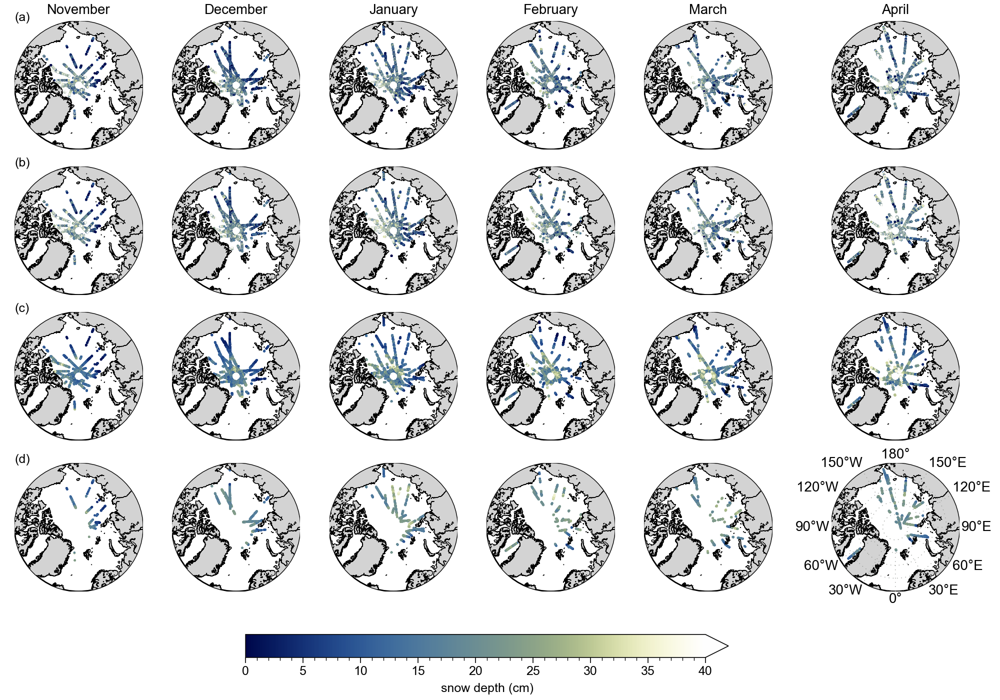

In [249]:
def plot_panArctic_points(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90
    cmap1 = plt.get_cmap('greys', 4)

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=65,lon_0=0, resolution='i',ax=ax, round=True)
    m.drawmeridians(np.arange(0,360,30),labels=[1,1,1,1],linewidth=0.5, fontsize=10, dashes=[1,5], color='grey')
    m.drawparallels(np.arange(-90,90,5),linewidth=0.5, fontsize=10, dashes=[1,5], color='grey')
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='lightgray')
    #m.fillcontinents(color='darkgray')
    #m.drawmapboundary(fill_color='black')
    #cbar = m.etopo()
    x=m.scatter(lon, lat, latlon=True, c=sit, s=1,vmin = min_set, vmax=max_set, cmap=cmap_set, zorder=1)
     #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x

def plot_panArctic_points_no_latlon(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90
    cmap1 = plt.get_cmap('greys', 4)

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=65,lon_0=0, resolution='i',ax=ax, round=True)
    #m.drawmeridians(np.arange(0,360,30),labels=[1,1,1,1],linewidth=0.5, fontsize=10, dashes=[1,5], color='navy')
    #m.drawparallels(np.arange(-90,90,5),linewidth=0.5, fontsize=10, dashes=[1,5], color='navy')
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='lightgray')
    #m.fillcontinents(color='darkgray')
    #m.drawmapboundary(fill_color='black')
    #cbar = m.etopo()
    x=m.scatter(lon, lat, latlon=True, c=sit, s=1,vmin = min_set, vmax=max_set, cmap=cmap_set, zorder=1)
     #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x

fig, ax = plt.subplots(4,6, figsize=(10,7), constrained_layout=True,sharey=True)
title = ''
cmap = 'davos'
n_max = 40

### CRYO2ICE snow depth original MSS plot

df = CRYO2ICE_nov_LARM_SMLG_coincident
axes=ax[0,0]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_dec_LARM_SMLG_coincident
axes=ax[0,1]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_jan_LARM_SMLG_coincident
axes=ax[0,2]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_feb_LARM_SMLG_coincident
axes=ax[0,3]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_mar_LARM_SMLG_coincident
axes=ax[0,4]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_apr_LARM_SMLG_coincident
axes=ax[0,5]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)


## CRYO2ICE original MSS LARM plot

df = CRYO2ICE_nov_LARM_SMLG_coincident
axes=ax[1,0]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_LARM_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_dec_LARM_SMLG_coincident
axes=ax[1,1]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_LARM_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_jan_LARM_SMLG_coincident
axes=ax[1,2]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_LARM_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_feb_LARM_SMLG_coincident
axes=ax[1,3]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_LARM_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_mar_LARM_SMLG_coincident
axes=ax[1,4]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_LARM_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_apr_LARM_SMLG_coincident
axes=ax[1,5]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_LARM_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)


### CRYO2ICE SMLG plot 

df = CRYO2ICE_nov_LARM_SMLG_coincident
axes=ax[2,0]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_dec_LARM_SMLG_coincident
axes=ax[2,1]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_jan_LARM_SMLG_coincident
axes=ax[2,2]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_feb_LARM_SMLG_coincident
axes=ax[2,3]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_mar_LARM_SMLG_coincident
axes=ax[2,4]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_apr_LARM_SMLG_coincident
axes=ax[2,5]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

### CRYO2ICE SMLG plot 

df = CRYO2ICE_nov_LARM_SMLG_coincident
axes=ax[3,0]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_dec_LARM_SMLG_coincident
axes=ax[3,1]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_jan_LARM_SMLG_coincident
axes=ax[3,2]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_feb_LARM_SMLG_coincident
axes=ax[3,3]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_mar_LARM_SMLG_coincident
axes=ax[3,4]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_apr_LARM_SMLG_coincident
axes=ax[3,5]
im = plot_panArctic_points(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)




plt.colorbar(im, ax=ax[:, :],orientation = 'horizontal', label='snow depth (cm)', extend='max', shrink=0.5)
#plt.subplots_adjust(wspace=0.1, hspace=0.0)

ax[0,0].text(0.0, 1, '(a)',transform = ax[0,0].transAxes)
ax[1,0].text(0.0, 1, '(b)',transform = ax[1,0].transAxes)
ax[2,0].text(0.0, 1, '(c)',transform = ax[2,0].transAxes)
ax[3,0].text(0.0, 1, '(d)',transform = ax[3,0].transAxes)

ax[0,0].set_title('November')
ax[0,1].set_title('December')
ax[0,2].set_title('January')
ax[0,3].set_title('February')
ax[0,4].set_title('March')
ax[0,5].set_title('April')

plt.savefig('E:\demo_CRYO2ICE_panArctic_distribution.png', transparent=True, dpi=300)

Text(0.5, 1.0, 'April')

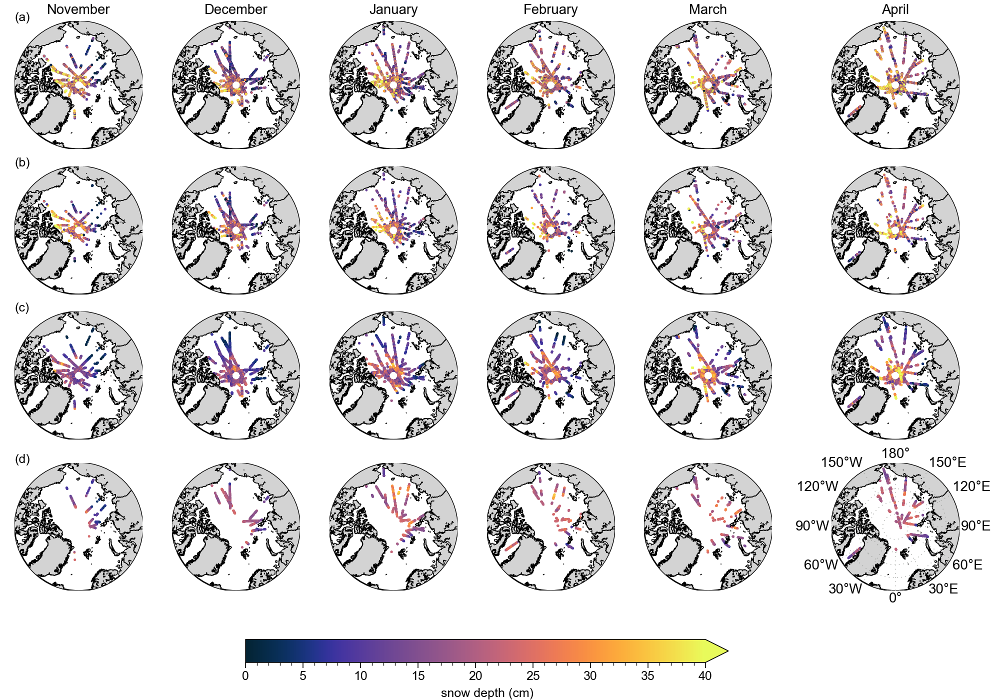

In [648]:
def plot_panArctic_points(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90
    cmap1 = plt.get_cmap('greys', 4)

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=65,lon_0=0, resolution='i',ax=ax, round=True)
    m.drawmeridians(np.arange(0,360,30),labels=[1,1,1,1],linewidth=0.5, fontsize=10, dashes=[1,5], color='grey')
    m.drawparallels(np.arange(-90,90,5),linewidth=0.5, fontsize=10, dashes=[1,5], color='grey')
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='lightgray')
    #m.fillcontinents(color='darkgray')
    #m.drawmapboundary(fill_color='black')
    #cbar = m.etopo()
    x=m.scatter(lon, lat, latlon=True, c=sit, s=1,vmin = min_set, vmax=max_set, cmap=cmap_set, zorder=1)
     #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x

def plot_panArctic_points_no_latlon(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90
    cmap1 = plt.get_cmap('greys', 4)

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=65,lon_0=0, resolution='i',ax=ax, round=True)
    #m.drawmeridians(np.arange(0,360,30),labels=[1,1,1,1],linewidth=0.5, fontsize=10, dashes=[1,5], color='navy')
    #m.drawparallels(np.arange(-90,90,5),linewidth=0.5, fontsize=10, dashes=[1,5], color='navy')
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='lightgray')
    #m.fillcontinents(color='darkgray')
    #m.drawmapboundary(fill_color='black')
    #cbar = m.etopo()
    x=m.scatter(lon, lat, latlon=True, c=sit, s=1,vmin = min_set, vmax=max_set, cmap=cmap_set, zorder=1)
     #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x

fig, ax = plt.subplots(4,6, figsize=(10,7), constrained_layout=True,sharey=True)
title = ''
cmap = 'Thermal'
n_max = 40

### CRYO2ICE snow depth original MSS plot

df = CRYO2ICE_nov_LARM_SMLG_coincident
axes=ax[0,0]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_smoothed_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_dec_LARM_SMLG_coincident
axes=ax[0,1]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_smoothed_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_jan_LARM_SMLG_coincident
axes=ax[0,2]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_smoothed_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_feb_LARM_SMLG_coincident
axes=ax[0,3]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_smoothed_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_mar_LARM_SMLG_coincident
axes=ax[0,4]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_smoothed_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_apr_LARM_SMLG_coincident
axes=ax[0,5]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_smoothed_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)


## CRYO2ICE original MSS LARM plot

df = CRYO2ICE_nov_LARM_SMLG_coincident
axes=ax[1,0]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_LARM_smoothed_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_dec_LARM_SMLG_coincident
axes=ax[1,1]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_LARM_smoothed_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_jan_LARM_SMLG_coincident
axes=ax[1,2]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_LARM_smoothed_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_feb_LARM_SMLG_coincident
axes=ax[1,3]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_LARM_smoothed_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_mar_LARM_SMLG_coincident
axes=ax[1,4]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_LARM_smoothed_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_apr_LARM_SMLG_coincident
axes=ax[1,5]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS_LARM_smoothed_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)


### CRYO2ICE SMLG plot 

df = CRYO2ICE_nov_LARM_SMLG_coincident
axes=ax[2,0]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_dec_LARM_SMLG_coincident
axes=ax[2,1]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_jan_LARM_SMLG_coincident
axes=ax[2,2]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_feb_LARM_SMLG_coincident
axes=ax[2,3]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_mar_LARM_SMLG_coincident
axes=ax[2,4]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_apr_LARM_SMLG_coincident
axes=ax[2,5]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

### CRYO2ICE SMLG plot 

df = CRYO2ICE_nov_LARM_SMLG_coincident
axes=ax[3,0]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_dec_LARM_SMLG_coincident
axes=ax[3,1]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_jan_LARM_SMLG_coincident
axes=ax[3,2]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_feb_LARM_SMLG_coincident
axes=ax[3,3]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_mar_LARM_SMLG_coincident
axes=ax[3,4]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_apr_LARM_SMLG_coincident
axes=ax[3,5]
im = plot_panArctic_points(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth']), 0, n_max, cmap, 'radar freeboard (m)','max', axes,fig)




plt.colorbar(im, ax=ax[:, :],orientation = 'horizontal', label='snow depth (cm)', extend='max', shrink=0.5)
#plt.subplots_adjust(wspace=0.1, hspace=0.0)

ax[0,0].text(0.0, 1, '(a)',transform = ax[0,0].transAxes)
ax[1,0].text(0.0, 1, '(b)',transform = ax[1,0].transAxes)
ax[2,0].text(0.0, 1, '(c)',transform = ax[2,0].transAxes)
ax[3,0].text(0.0, 1, '(d)',transform = ax[3,0].transAxes)

ax[0,0].set_title('November')
ax[0,1].set_title('December')
ax[0,2].set_title('January')
ax[0,3].set_title('February')
ax[0,4].set_title('March')
ax[0,5].set_title('April')

#plt.savefig('E:\demo_CRYO2ICE_panArctic_distribution_smoothed_data.png', transparent=True, dpi=300)

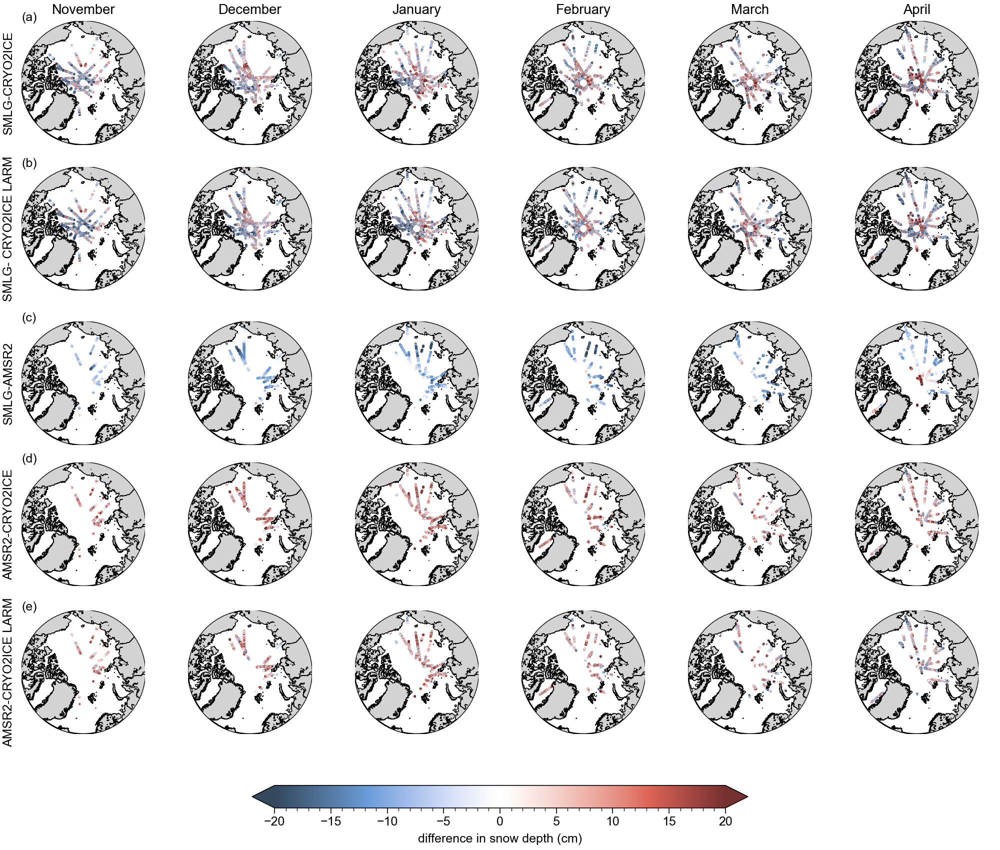

In [551]:
fig, ax = plt.subplots(5,6, figsize=(10,8.5), constrained_layout=True,sharey=True)
title = ''
cmap = 'NegPos'
n_min,n_max = -20, 20

##### SMLG as reference

### CRYO2ICE snow depth original MSS plot

df = CRYO2ICE_nov_LARM_SMLG_coincident
axes=ax[0,0]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm'])-np.array(df['snow_depth_original_MSS_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_dec_LARM_SMLG_coincident
axes=ax[0,1]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm'])-np.array(df['snow_depth_original_MSS_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_jan_LARM_SMLG_coincident
axes=ax[0,2]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm'])-np.array(df['snow_depth_original_MSS_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_feb_LARM_SMLG_coincident
axes=ax[0,3]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm'])-np.array(df['snow_depth_original_MSS_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_mar_LARM_SMLG_coincident
axes=ax[0,4]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm'])-np.array(df['snow_depth_original_MSS_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_apr_LARM_SMLG_coincident
axes=ax[0,5]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm'])-np.array(df['snow_depth_original_MSS_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)


## CRYO2ICE original MSS LARM plot

df = CRYO2ICE_nov_LARM_SMLG_coincident
axes=ax[1,0]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm'])-np.array(df['snow_depth_original_MSS_LARM_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_dec_LARM_SMLG_coincident
axes=ax[1,1]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm'])-np.array(df['snow_depth_original_MSS_LARM_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_jan_LARM_SMLG_coincident
axes=ax[1,2]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm'])-np.array(df['snow_depth_original_MSS_LARM_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_feb_LARM_SMLG_coincident
axes=ax[1,3]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm'])-np.array(df['snow_depth_original_MSS_LARM_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_mar_LARM_SMLG_coincident
axes=ax[1,4]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm'])-np.array(df['snow_depth_original_MSS_LARM_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_apr_LARM_SMLG_coincident
axes=ax[1,5]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm'])-np.array(df['snow_depth_original_MSS_LARM_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

### CRYO2ICE AMSR2 plot 

df = CRYO2ICE_nov_LARM_SMLG_coincident
axes=ax[2,0]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm'])-np.array(df['AMSR2_snow_depth']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_dec_LARM_SMLG_coincident
axes=ax[2,1]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm'])-np.array(df['AMSR2_snow_depth']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_jan_LARM_SMLG_coincident
axes=ax[2,2]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm'])-np.array(df['AMSR2_snow_depth']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_feb_LARM_SMLG_coincident
axes=ax[2,3]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm'])-np.array(df['AMSR2_snow_depth']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_mar_LARM_SMLG_coincident
axes=ax[2,4]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm'])-np.array(df['AMSR2_snow_depth']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_apr_LARM_SMLG_coincident
axes=ax[2,5]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['SMLG_snow_depth_unit_cm'])-np.array(df['AMSR2_snow_depth']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

ax[0,0].text(0.0, 1, '(a)',transform = ax[0,0].transAxes)
ax[1,0].text(0.0, 1, '(b)',transform = ax[1,0].transAxes)
ax[2,0].text(0.0, 1, '(c)',transform = ax[2,0].transAxes)

ax[0,0].set_title('November')
ax[0,1].set_title('December')
ax[0,2].set_title('January')
ax[0,3].set_title('February')
ax[0,4].set_title('March')
ax[0,5].set_title('April')

df = CRYO2ICE_nov_LARM_SMLG_coincident
axes=ax[3,0]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth'])-np.array(df['snow_depth_original_MSS_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_dec_LARM_SMLG_coincident
axes=ax[3,1]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth'])-np.array(df['snow_depth_original_MSS_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_jan_LARM_SMLG_coincident
axes=ax[3,2]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth'])-np.array(df['snow_depth_original_MSS_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_feb_LARM_SMLG_coincident
axes=ax[3,3]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth'])-np.array(df['snow_depth_original_MSS_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_mar_LARM_SMLG_coincident
axes=ax[3,4]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth'])-np.array(df['snow_depth_original_MSS_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_apr_LARM_SMLG_coincident
axes=ax[3,5]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth'])-np.array(df['snow_depth_original_MSS_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)


## CRYO2ICE original MSS LARM plot

df = CRYO2ICE_nov_LARM_SMLG_coincident
axes=ax[4,0]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth'])-np.array(df['snow_depth_original_MSS_LARM_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_dec_LARM_SMLG_coincident
axes=ax[4,1]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth'])-np.array(df['snow_depth_original_MSS_LARM_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_jan_LARM_SMLG_coincident
axes=ax[4,2]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth'])-np.array(df['snow_depth_original_MSS_LARM_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_feb_LARM_SMLG_coincident
axes=ax[4,3]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth'])-np.array(df['snow_depth_original_MSS_LARM_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_mar_LARM_SMLG_coincident
axes=ax[4,4]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth'])-np.array(df['snow_depth_original_MSS_LARM_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)

df = CRYO2ICE_apr_LARM_SMLG_coincident
axes=ax[4,5]
im = plot_panArctic_points_no_latlon(np.array(df['lon']), np.array(df['lat']), np.array(df['AMSR2_snow_depth'])-np.array(df['snow_depth_original_MSS_LARM_unit_cm']), n_min, n_max, cmap, 'radar freeboard (m)','max', axes,fig)



plt.colorbar(im, ax=ax[:, :],orientation = 'horizontal', label='difference in snow depth (cm)', extend='both', shrink=0.5)
#plt.subplots_adjust(wspace=0.1, hspace=0.0)

ax[3,0].text(0.0, 1, '(d)',transform = ax[3,0].transAxes)
ax[4,0].text(0.0, 1, '(e)',transform = ax[4,0].transAxes)

ax[0,0].text(-0.15, 0.5,'SMLG-CRYO2ICE', rotation=90, va='center',transform = ax[0,0].transAxes)
ax[1,0].text(-0.15, 0.5,'SMLG- CRYO2ICE LARM', rotation=90, va='center',transform = ax[1,0].transAxes)
ax[2,0].text(-0.15, 0.5,'SMLG-AMSR2', rotation=90, va='center',transform = ax[2,0].transAxes)
ax[3,0].text(-0.15, 0.5,'AMSR2-CRYO2ICE', rotation=90, va='center',transform = ax[3,0].transAxes)
ax[4,0].text(-0.15, 0.5,'AMSR2-CRYO2ICE LARM', rotation=90, va='center',transform = ax[4,0].transAxes)

plt.savefig('E:\demo_CRYO2ICE_panArctic_distribution_comparison_final.png', transparent=True, dpi=300)

In [150]:
frames = [CRYO2ICE_nov_LARM_SMLG_coincident,
          CRYO2ICE_dec_LARM_SMLG_coincident,
          CRYO2ICE_jan_LARM_SMLG_coincident,
         CRYO2ICE_feb_LARM_SMLG_coincident, 
         CRYO2ICE_mar_LARM_SMLG_coincident,
         CRYO2ICE_apr_LARM_SMLG_coincident]
CRYO2ICE_LARM_SMLG_coinident = pd.concat(frames)
CRYO2ICE_LARM_SMLG_coinident

,Unnamed: 0,Unnamed: 0.1,index,lat,lon,fb,mss,fb_no_mss,ssd,ppk,...,ID,snow_depth_original_MSS_smoothed,snow_depth_original_MSS_LARM_smoothed,month,snow_depth_original_MSS_unit_cm,snow_depth_original_MSS_LARM_unit_cm,snow_depth_original_MSS_CCI_unit_cm,SMLG_snow_depth_unit_cm,snow_depth_original_MSS_smoothed_unit_cm,snow_depth_original_MSS_LARM_smoothed_unit_cm
0,0,97,97,81.12026,-102.62712,0.319,6.726,-6.407,44.04,8.760796,...,0,0.651692,NaN,November,31.970403,30.204857,23.575444,15.910046,65.169159,NaN
2,2,99,99,81.12554,-102.63546,-0.041,6.726,-6.767,30.74,12.614185,...,0,0.335377,NaN,November,58.991731,55.812336,57.721886,21.642907,33.537707,NaN
3,3,100,100,81.13610,-102.65215,0.316,6.726,-6.410,46.54,8.568687,...,0,0.417619,NaN,November,18.108448,24.000095,8.749331,21.642907,41.761945,NaN
4,4,101,101,81.13874,-102.65633,0.262,6.726,-6.464,46.18,9.881067,...,0,0.377309,NaN,November,25.003912,26.460469,12.669313,21.642907,37.730924,NaN
10,10,107,107,81.15457,-102.68146,0.040,6.857,-6.817,41.30,11.448542,...,0,0.441852,NaN,November,48.871470,46.799336,42.833638,21.642907,44.185168,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58268,700,1464,1464,85.00801,-51.55534,0.163,19.401,-19.238,41.38,7.664649,...,62,0.338731,NaN,April,30.935376,36.070487,19.845416,25.088176,33.873147,NaN
58269,701,1465,1465,85.00550,-51.56816,0.143,19.401,-19.258,37.78,10.634539,...,62,0.331723,NaN,April,32.633683,34.293226,35.374936,25.088176,33.172350,NaN
58270,702,1466,1466,85.00300,-51.58096,0.140,19.401,-19.261,35.85,12.844862,...,62,0.261451,NaN,April,32.611111,33.122917,32.976561,25.088176,26.145076,NaN
58271,703,1467,1467,85.00049,-51.59376,0.209,19.401,-19.192,32.57,10.670835,...,62,0.235969,NaN,April,23.738784,26.683399,23.487699,25.088176,23.596866,NaN


In [151]:
frames = [CRYO2ICE_nov_LARM_SMLG_AMSR2_coincident,
          CRYO2ICE_dec_LARM_SMLG_AMSR2_coincident,
          CRYO2ICE_jan_LARM_SMLG_AMSR2_coincident,
         CRYO2ICE_feb_LARM_SMLG_AMSR2_coincident, 
         CRYO2ICE_mar_LARM_SMLG_AMSR2_coincident,
         CRYO2ICE_apr_LARM_SMLG_AMSR2_coincident]
CRYO2ICE_LARM_SMLG_AMSR2_coinident = pd.concat(frames)
CRYO2ICE_LARM_SMLG_AMSR2_coinident

,Unnamed: 0,Unnamed: 0.1,index,lat,lon,fb,mss,fb_no_mss,ssd,ppk,...,ID,snow_depth_original_MSS_smoothed,snow_depth_original_MSS_LARM_smoothed,month,snow_depth_original_MSS_unit_cm,snow_depth_original_MSS_LARM_unit_cm,snow_depth_original_MSS_CCI_unit_cm,SMLG_snow_depth_unit_cm,snow_depth_original_MSS_smoothed_unit_cm,snow_depth_original_MSS_LARM_smoothed_unit_cm
900,900,3262,3262,83.04911,105.93064,0.048,5.719,-5.671,24.96,11.373709,...,0,0.254101,NaN,November,9.501380,10.216644,15.954206,4.718522,25.410145,NaN
903,903,3265,3265,83.01798,105.85111,-0.035,5.719,-5.754,30.68,10.609533,...,0,0.229472,NaN,November,20.406714,20.753865,18.792738,4.718522,22.947184,NaN
904,904,3266,3266,83.01538,105.84452,0.073,5.719,-5.646,25.28,8.994288,...,0,0.203217,NaN,November,7.101381,16.123425,10.407556,4.718522,20.321688,NaN
905,905,3267,3267,83.01279,105.83793,0.028,5.719,-5.691,37.23,9.293457,...,0,0.135327,0.142969,November,12.669468,8.494815,9.961704,4.718522,13.532735,14.296875
906,906,3268,3268,83.01019,105.83134,-0.022,5.719,-5.741,34.29,8.916773,...,0,0.119515,0.125760,November,18.857585,16.754182,19.659230,4.718522,11.951454,12.576002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56512,226,2810,2810,87.82712,80.02445,0.271,13.568,-13.297,12.76,9.052139,...,60,0.273119,NaN,April,2.929914,1.425949,8.659871,46.428102,27.311926,NaN
56514,228,2812,2812,87.82076,79.62443,0.289,13.568,-13.279,6.93,13.031182,...,60,0.385534,NaN,April,3.196601,9.272899,18.115604,46.428102,38.553388,NaN
56517,231,2815,2815,87.79200,77.91822,0.261,13.776,-13.515,27.39,8.592668,...,60,0.320476,NaN,April,3.499502,8.328000,9.949158,46.428102,32.047636,NaN
56518,232,2816,2816,87.78971,77.78883,0.127,13.776,-13.649,23.31,13.796617,...,60,0.262121,NaN,April,20.941516,19.706381,25.228190,46.428102,26.212088,NaN


# Roughness proxies comp. with freeboards

In [54]:
def using_hist2d(ax, x, y, bins=(50, 50), cmap='Blues'):
    # https://stackoverflow.com/a/20105673/3015186
    # Answer by askewchan
    im = ax.hist2d(x, y, bins, cmap=cmap, vmin=0, vmax=50)
    
    return im

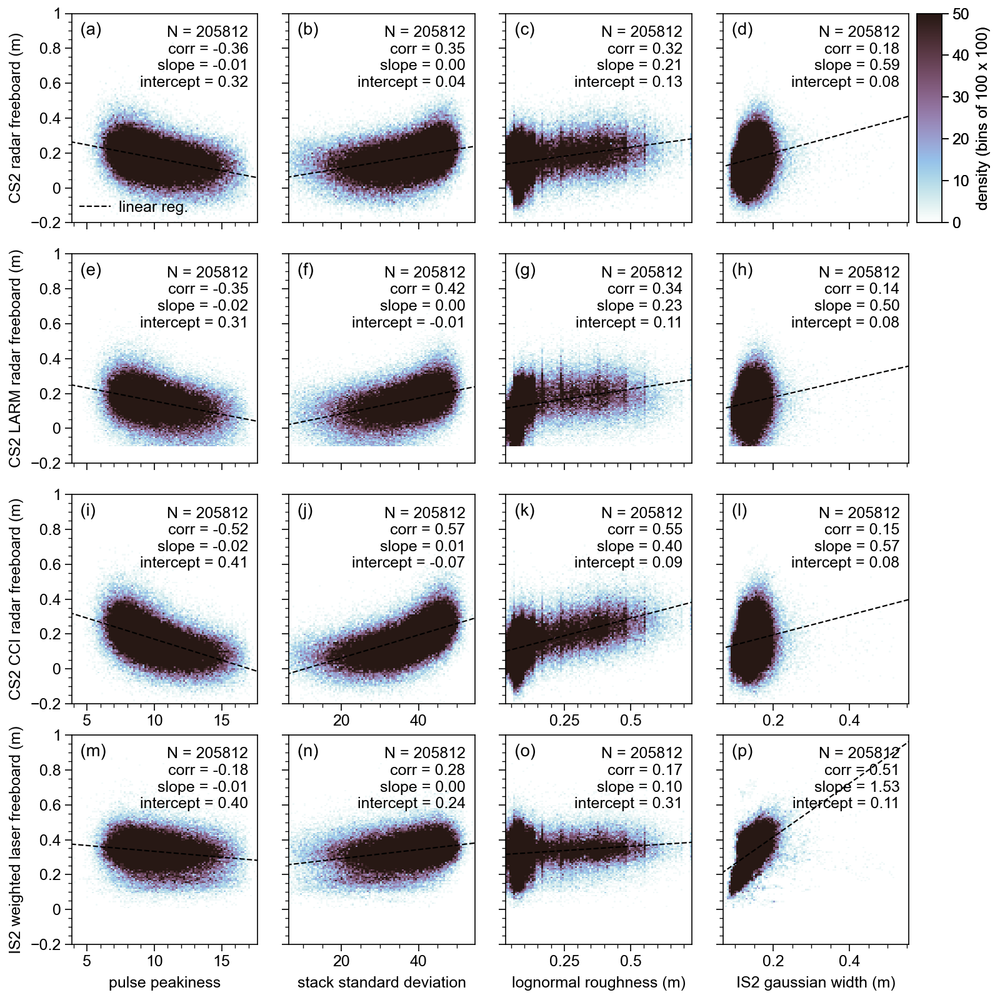

In [126]:
import proplot as pplt
fig = pplt.figure(space=2, figsize=(8,8), span=False, sharex=False, sharey=True)
ax = fig.subplots(nrows=4, ncols=4)
#fig, ax = plt.subplots(2, 3, figsize=(6,4), constrained_layout=True, sharey=True)

cmap_density = 'Glacial'
density = (100,100)

## 1 ROW - PLOTTING
im=using_hist2d(ax[0,0], CRYO2ICE_LARM_SMLG_coinident['ppk'], CRYO2ICE_LARM_SMLG_coinident['fb'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,0].format(xlabel='', ylabel='CS2 radar freeboard (m)',  xticklabels=[])

im=using_hist2d(ax[0,1], CRYO2ICE_LARM_SMLG_coinident['ssd'], CRYO2ICE_LARM_SMLG_coinident['fb'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,2], CRYO2ICE_LARM_SMLG_coinident['LARM_roughness'], CRYO2ICE_LARM_SMLG_coinident['fb'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,3], CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw'], CRYO2ICE_LARM_SMLG_coinident['fb'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,3].format(xlabel='', ylabel='',  xticklabels=[])

# ROW 2- PLOTTING
im=using_hist2d(ax[1,0], CRYO2ICE_LARM_SMLG_coinident['ppk'], CRYO2ICE_LARM_SMLG_coinident['LARM_rfb'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,0].format(xlabel='', ylabel='CS2 LARM radar freeboard (m)',  xticklabels=[])

im=using_hist2d(ax[1,1], CRYO2ICE_LARM_SMLG_coinident['ssd'], CRYO2ICE_LARM_SMLG_coinident['LARM_rfb'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,2], CRYO2ICE_LARM_SMLG_coinident['LARM_roughness'], CRYO2ICE_LARM_SMLG_coinident['LARM_rfb'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,3], CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw'], CRYO2ICE_LARM_SMLG_coinident['LARM_rfb'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,3].format(xlabel='', ylabel='',  xticklabels=[])

### ROW 3 - PLOTTING
im=using_hist2d(ax[2,0], CRYO2ICE_LARM_SMLG_coinident['ppk'], CRYO2ICE_LARM_SMLG_coinident['CCI_rfb'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,0].format(xlabel='pulse peakiness', ylabel='CS2 CCI radar freeboard (m)')

im=using_hist2d(ax[2,1], CRYO2ICE_LARM_SMLG_coinident['ssd'], CRYO2ICE_LARM_SMLG_coinident['CCI_rfb'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,1].format(xlabel='stack standard deviation', ylabel='')

im=using_hist2d(ax[2,2], CRYO2ICE_LARM_SMLG_coinident['LARM_roughness'], CRYO2ICE_LARM_SMLG_coinident['CCI_rfb'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,2].format(xlabel='lognormal roughness (m)', ylabel='')

im=using_hist2d(ax[2,3], CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw'], CRYO2ICE_LARM_SMLG_coinident['CCI_rfb'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,3].format(xlabel='IS2 gaussian width (m)', ylabel='')


### ROW 4 - PLOTTING
CRYO2ICE_LARM_SMLG_coinident['IS2_w_fb_MSS']=CRYO2ICE_LARM_SMLG_coinident['IS2_w_mean_fb']+CRYO2ICE_LARM_SMLG_coinident['IS2_mean_MSS']
im=using_hist2d(ax[3,0], CRYO2ICE_LARM_SMLG_coinident['ppk'], CRYO2ICE_LARM_SMLG_coinident['IS2_w_fb_MSS'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,0].format(xlabel='pulse peakiness', ylabel='IS2 weighted laser freeboard (m)')

im=using_hist2d(ax[3,1], CRYO2ICE_LARM_SMLG_coinident['ssd'], CRYO2ICE_LARM_SMLG_coinident['IS2_w_fb_MSS'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,1].format(xlabel='stack standard deviation', ylabel='')

im=using_hist2d(ax[3,2], CRYO2ICE_LARM_SMLG_coinident['LARM_roughness'], CRYO2ICE_LARM_SMLG_coinident['IS2_w_fb_MSS'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,2].format(xlabel='lognormal roughness (m)', ylabel='')

im=using_hist2d(ax[3,3], CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw'], CRYO2ICE_LARM_SMLG_coinident['IS2_w_fb_MSS'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,3].format(xlabel='IS2 gaussian width (m)', ylabel='')

## GENERAL FORMATTING
ax[0,3].colorbar(im[3], label='density (bins of 100 x 100)', loc='r')

ax.format(
    abc='(a)', abcloc='ul',rc_kw={'abc.weight':'normal'}, ylim=(-0.2, 1)
)



## ROW 1 - TEXT
corr = CRYO2ICE_LARM_SMLG_coinident['fb'].corr(CRYO2ICE_LARM_SMLG_coinident['ppk'])
y,x = CRYO2ICE_LARM_SMLG_coinident['fb'],CRYO2ICE_LARM_SMLG_coinident['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[0,0].text(0.95, 0.65, text_ax, transform=ax[0,0].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['fb'].corr(CRYO2ICE_LARM_SMLG_coinident['ssd'])
y,x = CRYO2ICE_LARM_SMLG_coinident['fb'],CRYO2ICE_LARM_SMLG_coinident['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[0,1].text(0.95, 0.65, text_ax, transform=ax[0,1].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['fb'].corr(CRYO2ICE_LARM_SMLG_coinident['LARM_roughness'])
y,x = CRYO2ICE_LARM_SMLG_coinident['fb'],CRYO2ICE_LARM_SMLG_coinident['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[0,2].text(0.95, 0.65, text_ax, transform=ax[0,2].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['fb'].corr(CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw'])
y,x = CRYO2ICE_LARM_SMLG_coinident['fb'],CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[0,3].text(0.95, 0.65, text_ax, transform=ax[0,3].transAxes, ha='right')

## ROW 2 - TEXT
corr = CRYO2ICE_LARM_SMLG_coinident['LARM_rfb'].corr(CRYO2ICE_LARM_SMLG_coinident['ppk'])
y,x = CRYO2ICE_LARM_SMLG_coinident['LARM_rfb'],CRYO2ICE_LARM_SMLG_coinident['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[1,0].text(0.95, 0.65, text_ax, transform=ax[1,0].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['LARM_rfb'].corr(CRYO2ICE_LARM_SMLG_coinident['ssd'])
y,x = CRYO2ICE_LARM_SMLG_coinident['LARM_rfb'],CRYO2ICE_LARM_SMLG_coinident['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[1,1].text(0.95, 0.65, text_ax, transform=ax[1,1].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['LARM_rfb'].corr(CRYO2ICE_LARM_SMLG_coinident['LARM_roughness'])
y,x = CRYO2ICE_LARM_SMLG_coinident['LARM_rfb'],CRYO2ICE_LARM_SMLG_coinident['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[1,2].text(0.95, 0.65, text_ax, transform=ax[1,2].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['LARM_rfb'].corr(CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw'])
y,x = CRYO2ICE_LARM_SMLG_coinident['LARM_rfb'],CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[1,3].text(0.95, 0.65, text_ax, transform=ax[1,3].transAxes, ha='right')

## ROW 3 - TEXT
corr = CRYO2ICE_LARM_SMLG_coinident['CCI_rfb'].corr(CRYO2ICE_LARM_SMLG_coinident['ppk'])
y,x = CRYO2ICE_LARM_SMLG_coinident['CCI_rfb'],CRYO2ICE_LARM_SMLG_coinident['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[2,0].text(0.95, 0.65, text_ax, transform=ax[2,0].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['CCI_rfb'].corr(CRYO2ICE_LARM_SMLG_coinident['ssd'])
y,x = CRYO2ICE_LARM_SMLG_coinident['CCI_rfb'],CRYO2ICE_LARM_SMLG_coinident['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[2,1].text(0.95, 0.65, text_ax, transform=ax[2,1].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['CCI_rfb'].corr(CRYO2ICE_LARM_SMLG_coinident['LARM_roughness'])
y,x = CRYO2ICE_LARM_SMLG_coinident['CCI_rfb'],CRYO2ICE_LARM_SMLG_coinident['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[2,2].text(0.95, 0.65, text_ax, transform=ax[2,2].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['CCI_rfb'].corr(CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw'])
y,x = CRYO2ICE_LARM_SMLG_coinident['CCI_rfb'],CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[2,3].text(0.95, 0.65, text_ax, transform=ax[2,3].transAxes, ha='right')


## ROW 4 - TEXT
corr = CRYO2ICE_LARM_SMLG_coinident['IS2_w_fb_MSS'].corr(CRYO2ICE_LARM_SMLG_coinident['ppk'])
y,x = CRYO2ICE_LARM_SMLG_coinident['IS2_w_fb_MSS'],CRYO2ICE_LARM_SMLG_coinident['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[3,0].text(0.95, 0.65, text_ax, transform=ax[3,0].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['IS2_w_fb_MSS'].corr(CRYO2ICE_LARM_SMLG_coinident['ssd'])
y,x = CRYO2ICE_LARM_SMLG_coinident['IS2_w_fb_MSS'],CRYO2ICE_LARM_SMLG_coinident['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[3,1].text(0.95, 0.65, text_ax, transform=ax[3,1].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['IS2_w_fb_MSS'].corr(CRYO2ICE_LARM_SMLG_coinident['LARM_roughness'])
y,x = CRYO2ICE_LARM_SMLG_coinident['IS2_w_fb_MSS'],CRYO2ICE_LARM_SMLG_coinident['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[3,2].text(0.95, 0.65, text_ax, transform=ax[3,2].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['IS2_w_fb_MSS'].corr(CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw'])
y,x = CRYO2ICE_LARM_SMLG_coinident['IS2_w_fb_MSS'],CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[3,3].text(0.95, 0.65, text_ax, transform=ax[3,3].transAxes, ha='right')

# EXTRA LEGEND ITEMS
legend_elements = [Line2D([0], [0],color='k', label='linear reg.', linestyle='--', linewidth=0.8)]
ax[0,0].legend(handles=legend_elements, loc='lower left', fontsize=6,frameon=False)


plt.savefig('E:\demo_CRYO2ICE_overall_comp_statistics_rougness_proxies.png', dpi=300)

# Snow depth

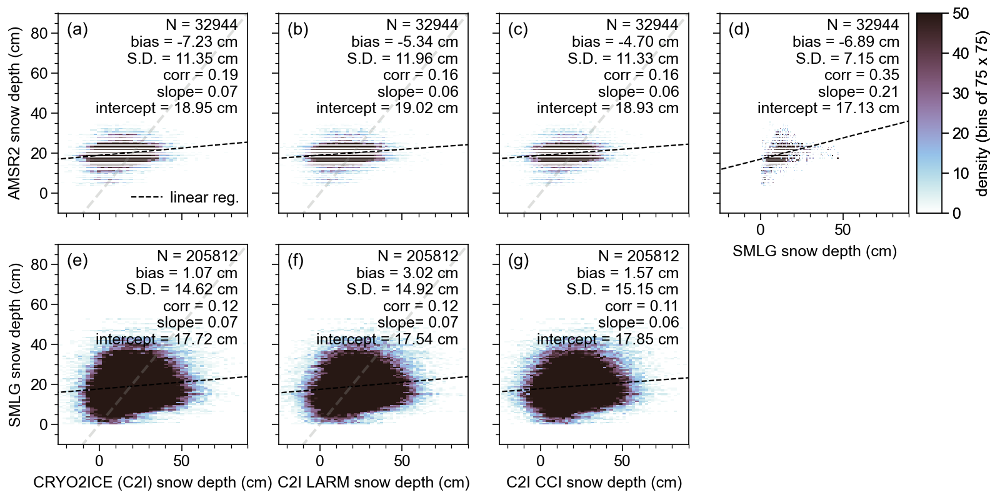

In [64]:
import proplot as pplt
fig = pplt.figure(space=2, figsize=(8,4), span=False, sharex=False)
ax = fig.subplots(nrows=2, ncols=4)
#fig, ax = plt.subplots(2, 3, figsize=(6,4), constrained_layout=True, sharey=True)

cmap_density = 'Glacial'
density = (75,75)
im=using_hist2d(ax[0,0], CRYO2ICE_LARM_SMLG_AMSR2_coinident['snow_depth_original_MSS_unit_cm'], CRYO2ICE_LARM_SMLG_AMSR2_coinident['AMSR2_snow_depth'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,0].format(xlabel='', ylabel='AMSR2 snow depth (cm)',  xticklabels=[])

im=using_hist2d(ax[0,1], CRYO2ICE_LARM_SMLG_AMSR2_coinident['snow_depth_original_MSS_LARM_unit_cm'], CRYO2ICE_LARM_SMLG_AMSR2_coinident['AMSR2_snow_depth'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,1].format(xlabel='', ylabel='AMSR2 snow depth (cm)',  xticklabels=[])

im=using_hist2d(ax[0,2], CRYO2ICE_LARM_SMLG_AMSR2_coinident['snow_depth_original_MSS_CCI_unit_cm'], CRYO2ICE_LARM_SMLG_AMSR2_coinident['AMSR2_snow_depth'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,2].format(xlabel='', ylabel='AMSR2 snow depth (cm)',  xticklabels=[])

im=using_hist2d(ax[0,3], CRYO2ICE_LARM_SMLG_AMSR2_coinident['SMLG_snow_depth_unit_cm'], CRYO2ICE_LARM_SMLG_AMSR2_coinident['AMSR2_snow_depth'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,3].format(xlabel='SMLG snow depth (cm)', ylabel='AMSR2 snow depth (cm)')


im=using_hist2d(ax[1,0], CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_unit_cm'], CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,0].format(xlabel='CRYO2ICE (C2I) snow depth (cm)', ylabel='SMLG snow depth (cm)')

m=using_hist2d(ax[1,1],CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_LARM_unit_cm'], CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
ax[1,1].format(xlabel='C2I LARM snow depth (cm)', ylabel='SMLG snow depth (cm)')

m=using_hist2d(ax[1,2],CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_CCI_unit_cm'], CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
ax[1,2].format(xlabel='C2I CCI snow depth (cm)', ylabel='SMLG snow depth (cm)')

#ax[1].set_ylabel('differnece in laser and radar freeboard (IS2-CS2) (m)')
#CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_LARM'].corr(CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth'])
#plt.colorbar(im[3], label='density (bins of 80 x80)',ax=ax[1,1])


## ROW 1
bias = np.nanmean(CRYO2ICE_LARM_SMLG_AMSR2_coinident['snow_depth_original_MSS_unit_cm']-CRYO2ICE_LARM_SMLG_AMSR2_coinident['AMSR2_snow_depth'])
sd = np.nanstd(CRYO2ICE_LARM_SMLG_AMSR2_coinident['snow_depth_original_MSS_unit_cm']-CRYO2ICE_LARM_SMLG_AMSR2_coinident['AMSR2_snow_depth'])
corr = CRYO2ICE_LARM_SMLG_AMSR2_coinident['snow_depth_original_MSS_unit_cm'].corr(CRYO2ICE_LARM_SMLG_AMSR2_coinident['AMSR2_snow_depth'])
x,y = CRYO2ICE_LARM_SMLG_AMSR2_coinident['snow_depth_original_MSS_unit_cm'],CRYO2ICE_LARM_SMLG_AMSR2_coinident['AMSR2_snow_depth']
coef = np.polyfit(x,y,1)
x_new = np.arange(-50,100,10)
polyval_predict = np.polyval(coef,x_new)
ax[0,0].plot(x_new, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\nbias = {:.2f} cm\nS.D. = {:.2f} cm\ncorr = {:.2f}\nslope= {:.2f}\nintercept = {:.2f} cm".format(len(CRYO2ICE_LARM_SMLG_AMSR2_coinident),bias, sd, corr, coef[0], coef[1])
ax[0,0].text(0.95, 0.5, text_ax, transform=ax[0,0].transAxes, ha='right')


bias = np.nanmean(CRYO2ICE_LARM_SMLG_AMSR2_coinident['snow_depth_original_MSS_LARM_unit_cm']-CRYO2ICE_LARM_SMLG_AMSR2_coinident['AMSR2_snow_depth'])
sd = np.nanstd(CRYO2ICE_LARM_SMLG_AMSR2_coinident['snow_depth_original_MSS_LARM_unit_cm']-CRYO2ICE_LARM_SMLG_AMSR2_coinident['AMSR2_snow_depth'])
corr = CRYO2ICE_LARM_SMLG_AMSR2_coinident['snow_depth_original_MSS_LARM_unit_cm'].corr(CRYO2ICE_LARM_SMLG_AMSR2_coinident['AMSR2_snow_depth'])
x,y = CRYO2ICE_LARM_SMLG_AMSR2_coinident['snow_depth_original_MSS_LARM_unit_cm'],CRYO2ICE_LARM_SMLG_AMSR2_coinident['AMSR2_snow_depth']
coef = np.polyfit(x,y,1)
x_new = np.arange(-50,100,10)
polyval_predict = np.polyval(coef,x_new)
ax[0,1].plot(x_new, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\nbias = {:.2f} cm\nS.D. = {:.2f} cm\ncorr = {:.2f}\nslope= {:.2f}\nintercept = {:.2f} cm".format(len(CRYO2ICE_LARM_SMLG_AMSR2_coinident),bias, sd, corr, coef[0], coef[1])
ax[0,1].text(0.95, 0.5, text_ax, transform=ax[0,1].transAxes, ha='right')

bias = np.nanmean(CRYO2ICE_LARM_SMLG_AMSR2_coinident['snow_depth_original_MSS_CCI_unit_cm']-CRYO2ICE_LARM_SMLG_AMSR2_coinident['AMSR2_snow_depth'])
sd = np.nanstd(CRYO2ICE_LARM_SMLG_AMSR2_coinident['snow_depth_original_MSS_CCI_unit_cm']-CRYO2ICE_LARM_SMLG_AMSR2_coinident['AMSR2_snow_depth'])
corr = CRYO2ICE_LARM_SMLG_AMSR2_coinident['snow_depth_original_MSS_CCI_unit_cm'].corr(CRYO2ICE_LARM_SMLG_AMSR2_coinident['AMSR2_snow_depth'])
x,y = CRYO2ICE_LARM_SMLG_AMSR2_coinident['snow_depth_original_MSS_CCI_unit_cm'],CRYO2ICE_LARM_SMLG_AMSR2_coinident['AMSR2_snow_depth']
coef = np.polyfit(x,y,1)
x_new = np.arange(-50,100,10)
polyval_predict = np.polyval(coef,x_new)
ax[0,2].plot(x_new, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\nbias = {:.2f} cm\nS.D. = {:.2f} cm\ncorr = {:.2f}\nslope= {:.2f}\nintercept = {:.2f} cm".format(len(CRYO2ICE_LARM_SMLG_AMSR2_coinident),bias, sd, corr, coef[0], coef[1])
ax[0,2].text(0.95, 0.5, text_ax, transform=ax[0,2].transAxes, ha='right')


bias = np.nanmean(CRYO2ICE_LARM_SMLG_AMSR2_coinident['SMLG_snow_depth_unit_cm']-CRYO2ICE_LARM_SMLG_AMSR2_coinident['AMSR2_snow_depth'])
sd = np.nanstd(CRYO2ICE_LARM_SMLG_AMSR2_coinident['SMLG_snow_depth_unit_cm']-CRYO2ICE_LARM_SMLG_AMSR2_coinident['AMSR2_snow_depth'])
corr = CRYO2ICE_LARM_SMLG_AMSR2_coinident['SMLG_snow_depth_unit_cm'].corr(CRYO2ICE_LARM_SMLG_AMSR2_coinident['AMSR2_snow_depth'])
x,y = CRYO2ICE_LARM_SMLG_AMSR2_coinident['SMLG_snow_depth_unit_cm'],CRYO2ICE_LARM_SMLG_AMSR2_coinident['AMSR2_snow_depth']
coef = np.polyfit(x,y,1)
x_new = np.arange(-50,100,10)
polyval_predict = np.polyval(coef,x_new)
ax[0,3].plot(x_new, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\nbias = {:.2f} cm\nS.D. = {:.2f} cm\ncorr = {:.2f}\nslope= {:.2f}\nintercept = {:.2f} cm".format(len(CRYO2ICE_LARM_SMLG_AMSR2_coinident),bias, sd, corr, coef[0], coef[1])
ax[0,3].text(0.95, 0.5, text_ax, transform=ax[0,3].transAxes, ha='right')

## ROW 2
bias = np.nanmean(CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_unit_cm']-CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'])
sd = np.nanstd(CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_unit_cm']-CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'])
corr = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'])
x,y = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_unit_cm'],CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm']
coef = np.polyfit(x,y,1)
x_new = np.arange(-50,100,10)
polyval_predict = np.polyval(coef,x_new)
ax[1,0].plot(x_new, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\nbias = {:.2f} cm\nS.D. = {:.2f} cm\ncorr = {:.2f}\nslope= {:.2f}\nintercept = {:.2f} cm".format(len(CRYO2ICE_LARM_SMLG_coinident),bias, sd, corr, coef[0], coef[1])
ax[1,0].text(0.95, 0.5, text_ax, transform=ax[1,0].transAxes, ha='right')


bias = np.nanmean(CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_LARM_unit_cm']-CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'])
sd = np.nanstd(CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_LARM_unit_cm']-CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'])
corr = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_LARM_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'])
x,y = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_LARM_unit_cm'],CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm']
coef = np.polyfit(x,y,1)
x_new = np.arange(-50,100,10)
polyval_predict = np.polyval(coef,x_new)
ax[1,1].plot(x_new, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\nbias = {:.2f} cm\nS.D. = {:.2f} cm\ncorr = {:.2f}\nslope= {:.2f}\nintercept = {:.2f} cm".format(len(CRYO2ICE_LARM_SMLG_coinident),bias, sd, corr, coef[0], coef[1])
ax[1,1].text(0.95, 0.5, text_ax, transform=ax[1,1].transAxes, ha='right')

bias = np.nanmean(CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_CCI_unit_cm']-CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'])
sd = np.nanstd(CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_CCI_unit_cm']-CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'])
corr = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_CCI_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'])
x,y = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_CCI_unit_cm'],CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm']
coef = np.polyfit(x,y,1)
x_new = np.arange(-50,100,10)
polyval_predict = np.polyval(coef,x_new)
ax[1,2].plot(x_new, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\nbias = {:.2f} cm\nS.D. = {:.2f} cm\ncorr = {:.2f}\nslope= {:.2f}\nintercept = {:.2f} cm".format(len(CRYO2ICE_LARM_SMLG_coinident),bias, sd, corr, coef[0], coef[1])
ax[1,2].text(0.95, 0.5, text_ax, transform=ax[1,2].transAxes, ha='right')

ax[1, 3].set_visible(False)
ax.format(
    abc='(a)', abcloc='ul', xlim=(-25, 90), ylim=(-10, 90),rc_kw={'abc.weight':'normal'}
)
ax[0,3].colorbar(im[3], label='density (bins of 75 x 75)', loc='r')

ax[0,0].plot(np.arange(-50,100,10),np.arange(-50,100,10), color='grey', alpha=0.3, linestyle='--')
ax[0,1].plot(np.arange(-50,100,10),np.arange(-50,100,10), color='grey', alpha=0.3, linestyle='--')
ax[0,2].plot(np.arange(-50,100,10),np.arange(-50,100,10), color='grey', alpha=0.3, linestyle='--')
ax[1,0].plot(np.arange(-50,100,10),np.arange(-50,100,10), color='grey', alpha=0.3, linestyle='--')
ax[1,1].plot(np.arange(-50,100,10),np.arange(-50,100,10), color='grey', alpha=0.3, linestyle='--')


legend_elements = [Line2D([0], [0],color='k', label='linear reg.', linestyle='--', linewidth=0.8)]

ax[0,0].legend(handles=legend_elements, loc='lower right', fontsize=6,frameon=False)


plt.savefig('E:\demo_CRYO2ICE_overall_comp_statistics_auxiliary_data.png', dpi=300)

# Snow depth vs. roughness proxies 

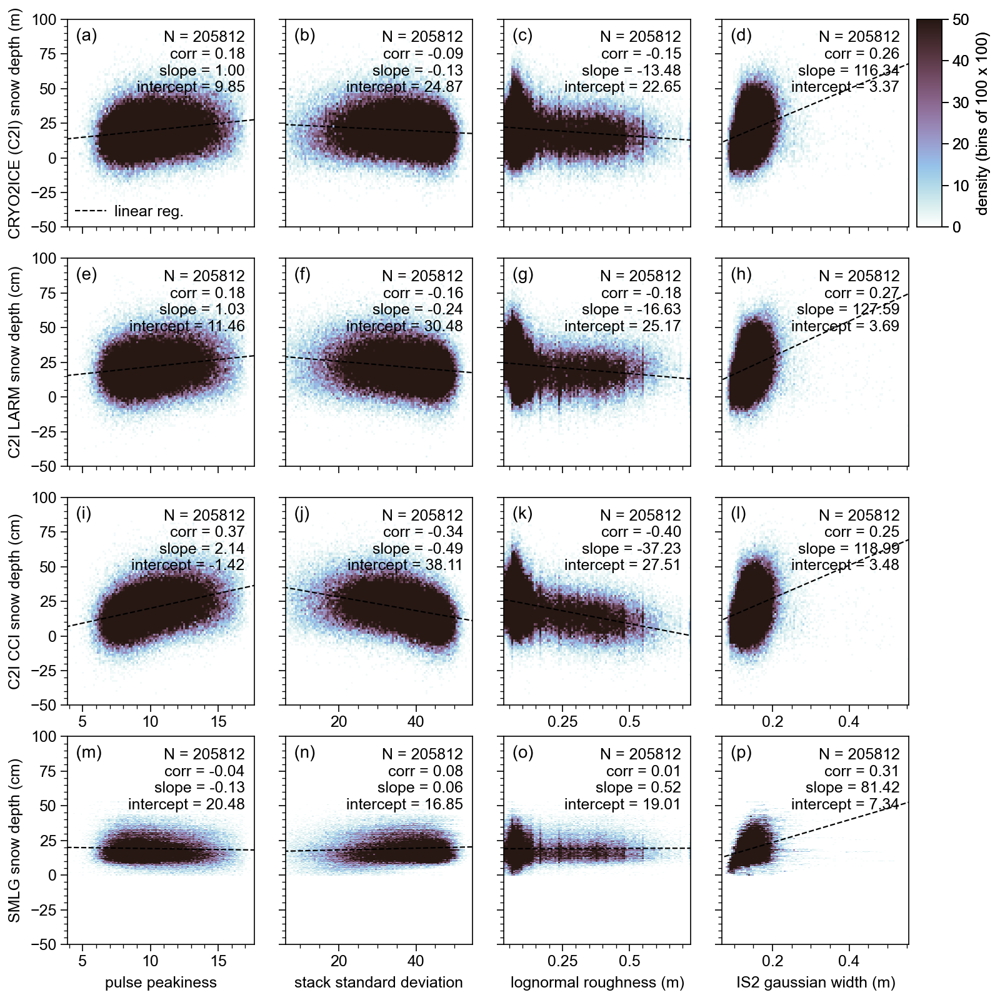

In [120]:
import proplot as pplt
fig = pplt.figure(space=2, figsize=(8,8), span=False, sharex=False, sharey=True)
ax = fig.subplots(nrows=4, ncols=4)
#fig, ax = plt.subplots(2, 3, figsize=(6,4), constrained_layout=True, sharey=True)

cmap_density = 'Glacial'
density = (100,100)

## 1 ROW - PLOTTING
im=using_hist2d(ax[0,0], CRYO2ICE_LARM_SMLG_coinident['ppk'], CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,0].format(xlabel='', ylabel='CRYO2ICE (C2I) snow depth (m)',  xticklabels=[])

im=using_hist2d(ax[0,1], CRYO2ICE_LARM_SMLG_coinident['ssd'], CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,2], CRYO2ICE_LARM_SMLG_coinident['LARM_roughness'], CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,3], CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw'], CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,3].format(xlabel='', ylabel='',  xticklabels=[])

# ROW 2- PLOTTING
im=using_hist2d(ax[1,0], CRYO2ICE_LARM_SMLG_coinident['ppk'], CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,0].format(xlabel='', ylabel='C2I LARM snow depth (cm)',  xticklabels=[])

im=using_hist2d(ax[1,1], CRYO2ICE_LARM_SMLG_coinident['ssd'], CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,2], CRYO2ICE_LARM_SMLG_coinident['LARM_roughness'], CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,3], CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw'], CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,3].format(xlabel='', ylabel='',  xticklabels=[])

### ROW 3 - PLOTTING
im=using_hist2d(ax[2,0], CRYO2ICE_LARM_SMLG_coinident['ppk'], CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,0].format(xlabel='', ylabel='C2I CCI snow depth (cm)')

im=using_hist2d(ax[2,1], CRYO2ICE_LARM_SMLG_coinident['ssd'], CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,1].format(xlabel='', ylabel='')

im=using_hist2d(ax[2,2], CRYO2ICE_LARM_SMLG_coinident['LARM_roughness'], CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,2].format(xlabel='', ylabel='')

im=using_hist2d(ax[2,3], CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw'], CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,3].format(xlabel=')', ylabel='')

### ROW 4 - PLOTTING
im=using_hist2d(ax[3,0], CRYO2ICE_LARM_SMLG_coinident['ppk'], CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,0].format(xlabel='pulse peakiness', ylabel='SMLG snow depth (cm)')

im=using_hist2d(ax[3,1], CRYO2ICE_LARM_SMLG_coinident['ssd'], CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,1].format(xlabel='stack standard deviation', ylabel='')

im=using_hist2d(ax[3,2], CRYO2ICE_LARM_SMLG_coinident['LARM_roughness'], CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,2].format(xlabel='lognormal roughness (m)', ylabel='')

im=using_hist2d(ax[3,3], CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw'], CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,3].format(xlabel='IS2 gaussian width (m)', ylabel='')

## GENERAL FORMATTING
ax[0,3].colorbar(im[3], label='density (bins of 100 x 100)', loc='r')

ax.format(
    abc='(a)', abcloc='ul',rc_kw={'abc.weight':'normal'},ylim=(-50,100)
)



## ROW 1 - TEXT
corr = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident['ppk'])
y,x = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_unit_cm'],CRYO2ICE_LARM_SMLG_coinident['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[0,0].text(0.95, 0.65, text_ax, transform=ax[0,0].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident['ssd'])
y,x = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_unit_cm'],CRYO2ICE_LARM_SMLG_coinident['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[0,1].text(0.95, 0.65, text_ax, transform=ax[0,1].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident['LARM_roughness'])
y,x = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_unit_cm'],CRYO2ICE_LARM_SMLG_coinident['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[0,2].text(0.95, 0.65, text_ax, transform=ax[0,2].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw'])
y,x = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_unit_cm'],CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[0,3].text(0.95, 0.65, text_ax, transform=ax[0,3].transAxes, ha='right')

## ROW 2 - TEXT
corr = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_LARM_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident['ppk'])
y,x = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_LARM_unit_cm'],CRYO2ICE_LARM_SMLG_coinident['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[1,0].text(0.95, 0.65, text_ax, transform=ax[1,0].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_LARM_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident['ssd'])
y,x = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_LARM_unit_cm'],CRYO2ICE_LARM_SMLG_coinident['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[1,1].text(0.95, 0.65, text_ax, transform=ax[1,1].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_LARM_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident['LARM_roughness'])
y,x = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_LARM_unit_cm'],CRYO2ICE_LARM_SMLG_coinident['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[1,2].text(0.95, 0.65, text_ax, transform=ax[1,2].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_LARM_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw'])
y,x = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_LARM_unit_cm'],CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[1,3].text(0.95, 0.65, text_ax, transform=ax[1,3].transAxes, ha='right')

## ROW 3 - TEXT
corr = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_CCI_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident['ppk'])
y,x = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_CCI_unit_cm'],CRYO2ICE_LARM_SMLG_coinident['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[2,0].text(0.95, 0.65, text_ax, transform=ax[2,0].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_CCI_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident['ssd'])
y,x = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_CCI_unit_cm'],CRYO2ICE_LARM_SMLG_coinident['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[2,1].text(0.95, 0.65, text_ax, transform=ax[2,1].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_CCI_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident['LARM_roughness'])
y,x = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_CCI_unit_cm'],CRYO2ICE_LARM_SMLG_coinident['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[2,2].text(0.95, 0.65, text_ax, transform=ax[2,2].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_CCI_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw'])
y,x = CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_CCI_unit_cm'],CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[2,3].text(0.95, 0.65, text_ax, transform=ax[2,3].transAxes, ha='right')

## ROW 4 - TEXT
corr = CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident['ppk'])
y,x = CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'],CRYO2ICE_LARM_SMLG_coinident['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[3,0].text(0.95, 0.65, text_ax, transform=ax[3,0].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident['ssd'])
y,x = CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'],CRYO2ICE_LARM_SMLG_coinident['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[3,1].text(0.95, 0.65, text_ax, transform=ax[3,1].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident['LARM_roughness'])
y,x = CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'],CRYO2ICE_LARM_SMLG_coinident['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[3,2].text(0.95, 0.65, text_ax, transform=ax[3,2].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw'])
y,x = CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth_unit_cm'],CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[3,3].text(0.95, 0.65, text_ax, transform=ax[3,3].transAxes, ha='right')

# EXTRA LEGEND ITEMS
legend_elements = [Line2D([0], [0],color='k', label='linear reg.', linestyle='--', linewidth=0.8)]
ax[0,0].legend(handles=legend_elements, loc='lower left', fontsize=6,frameon=False)


plt.savefig('E:\demo_CRYO2ICE_overall_comp_statistics_rougness_proxies_snow_depth.png', dpi=300)

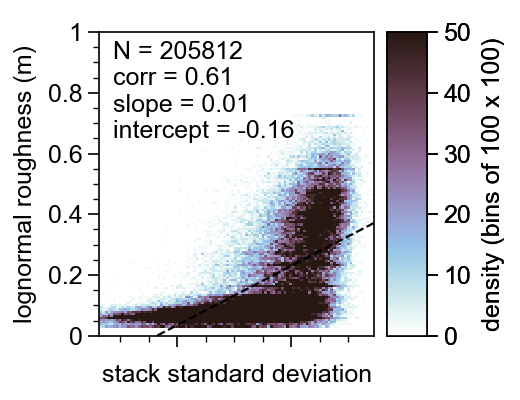

In [90]:
import proplot as pplt
fig = pplt.figure(space=2, figsize=(2.6,2), span=False, sharex=False, sharey=True)
ax = fig.subplots(nrows=1, ncols=1)
#fig, ax = plt.subplots(2, 3, figsize=(6,4), constrained_layout=True, sharey=True)

cmap_density = 'Glacial'
density = (100,100)

## 1 ROW - PLOTTING

im=using_hist2d(ax[0], CRYO2ICE_LARM_SMLG_coinident['ssd'], CRYO2ICE_LARM_SMLG_coinident['LARM_roughness'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0].format(xlabel='stack standard deviation', ylabel='lognormal roughness (m)',  xticklabels=[])

corr = CRYO2ICE_LARM_SMLG_coinident['LARM_roughness'].corr(CRYO2ICE_LARM_SMLG_coinident['ssd'])
y,x = CRYO2ICE_LARM_SMLG_coinident['LARM_roughness'],CRYO2ICE_LARM_SMLG_coinident['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident),corr, coef[0], coef[1])
ax[0].text(0.05, 0.65, text_ax, transform=ax[0].transAxes, ha='left')

ax[0].colorbar(im[3], label='density (bins of 100 x 100)', loc='r')

ax.format(ylim=(0.0,1))

NameError: name 'CRYO2ICE_LARM_SMLG_coincident' is not defined

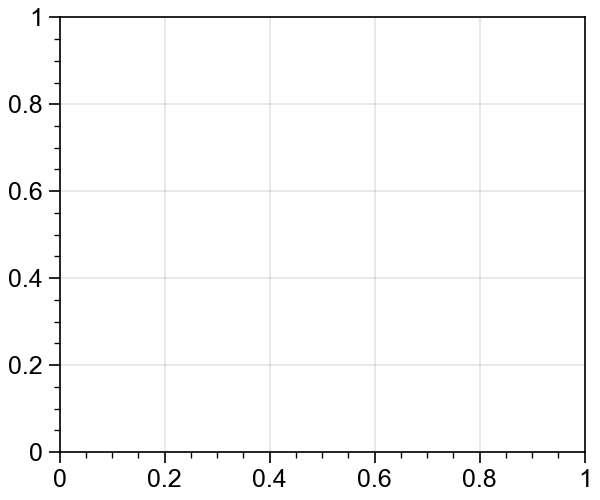

In [117]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

#library(corrplot)

# create a new df and order columns alphabetically
#import proplot as pplt
#fig = pplt.figure(figsize=(4,4))
fig,ax = plt.subplots(nrows=1, ncols=1, figsize=(3,2.5), constrained_layout=True)
df_new = CRYO2ICE_LARM_SMLG_coincident[['ppk', 'ssd', 'LARM_roughness', 'IS2_mean_gw']].copy()


matrix = df_new.corr().round(2)
mask = np.triu(np.ones_like(matrix, dtype=bool))
labels=['ppk', 'ssd', 'LARM $\sigma$', 'IS2 gw']
sns.heatmap(matrix, annot=True, vmax=1, vmin=-1, center=0, cmap='ColdHot',mask=mask, ax=ax, xticklabels=labels, yticklabels=labels)
plt.show()

# Include no negative CS2 freeboards

In [153]:
CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max = CRYO2ICE_LARM_SMLG_coinident[CRYO2ICE_LARM_SMLG_coinident['fb']>0]
CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max = CRYO2ICE_LARM_SMLG_coinident[CRYO2ICE_LARM_SMLG_coinident['LARM_rfb']>0]
CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max = CRYO2ICE_LARM_SMLG_coinident[CRYO2ICE_LARM_SMLG_coinident['CCI_rfb']>0]
CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max

,Unnamed: 0,Unnamed: 0.1,index,lat,lon,fb,mss,fb_no_mss,ssd,ppk,...,ID,snow_depth_original_MSS_smoothed,snow_depth_original_MSS_LARM_smoothed,month,snow_depth_original_MSS_unit_cm,snow_depth_original_MSS_LARM_unit_cm,snow_depth_original_MSS_CCI_unit_cm,SMLG_snow_depth_unit_cm,snow_depth_original_MSS_smoothed_unit_cm,snow_depth_original_MSS_LARM_smoothed_unit_cm
0,0,97,97,81.12026,-102.62712,0.319,6.726,-6.407,44.04,8.760796,...,0,0.651692,NaN,November,31.970403,30.204857,23.575444,15.910046,65.169159,NaN
3,3,100,100,81.13610,-102.65215,0.316,6.726,-6.410,46.54,8.568687,...,0,0.417619,NaN,November,18.108448,24.000095,8.749331,21.642907,41.761945,NaN
4,4,101,101,81.13874,-102.65633,0.262,6.726,-6.464,46.18,9.881067,...,0,0.377309,NaN,November,25.003912,26.460469,12.669313,21.642907,37.730924,NaN
10,10,107,107,81.15457,-102.68146,0.040,6.857,-6.817,41.30,11.448542,...,0,0.441852,NaN,November,48.871470,46.799336,42.833638,21.642907,44.185168,NaN
11,11,108,108,81.15721,-102.68566,0.010,6.857,-6.847,42.30,9.861829,...,0,0.451141,NaN,November,53.697473,46.704510,50.365227,21.642907,45.114139,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58268,700,1464,1464,85.00801,-51.55534,0.163,19.401,-19.238,41.38,7.664649,...,62,0.338731,NaN,April,30.935376,36.070487,19.845416,25.088176,33.873147,NaN
58269,701,1465,1465,85.00550,-51.56816,0.143,19.401,-19.258,37.78,10.634539,...,62,0.331723,NaN,April,32.633683,34.293226,35.374936,25.088176,33.172350,NaN
58270,702,1466,1466,85.00300,-51.58096,0.140,19.401,-19.261,35.85,12.844862,...,62,0.261451,NaN,April,32.611111,33.122917,32.976561,25.088176,26.145076,NaN
58271,703,1467,1467,85.00049,-51.59376,0.209,19.401,-19.192,32.57,10.670835,...,62,0.235969,NaN,April,23.738784,26.683399,23.487699,25.088176,23.596866,NaN


In [159]:
len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max)/len(CRYO2ICE_LARM_SMLG_coinident)

0.9405962723262006

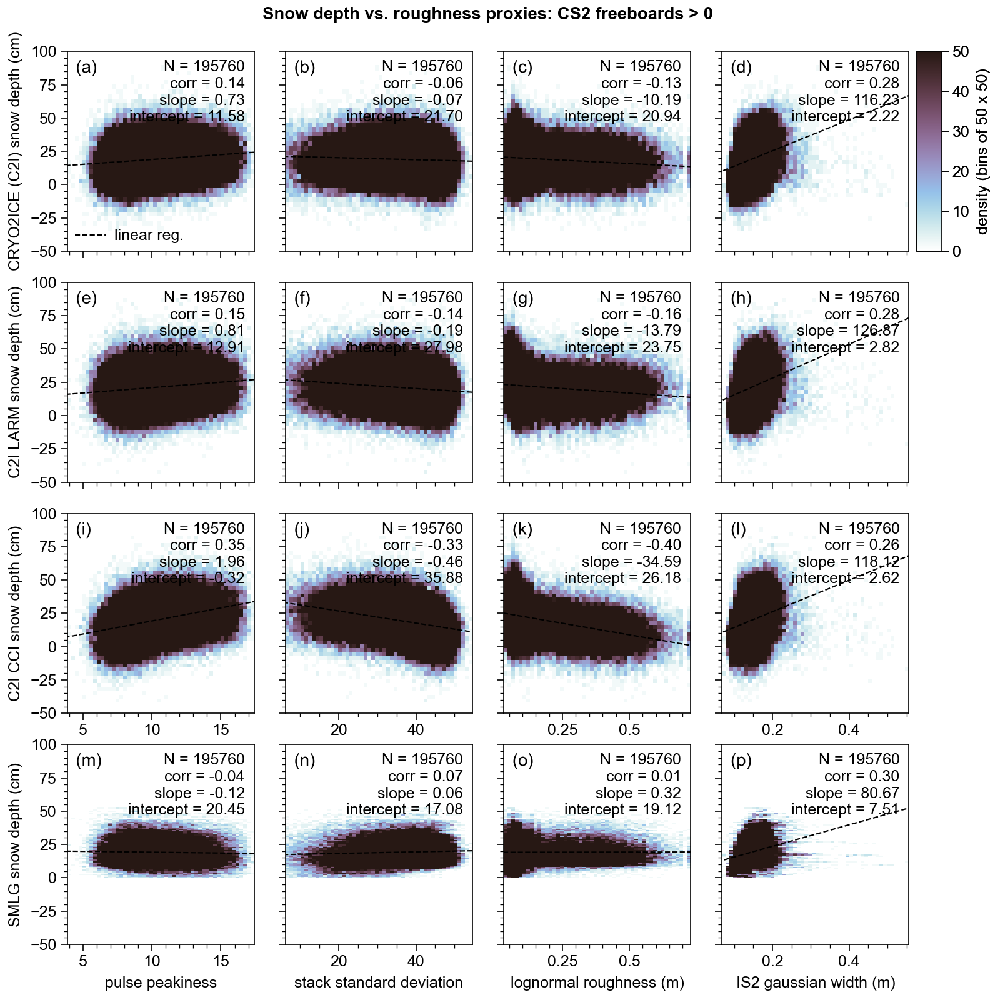

In [501]:
import proplot as pplt
fig = pplt.figure(space=2, figsize=(8,8), span=False, sharex=False, sharey=True)
ax = fig.subplots(nrows=4, ncols=4)
#fig, ax = plt.subplots(2, 3, figsize=(6,4), constrained_layout=True, sharey=True)

cmap_density = 'Glacial'
density = (50,50)

## 1 ROW - PLOTTING
im=using_hist2d(ax[0,0], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,0].format(xlabel='', ylabel='CRYO2ICE (C2I) snow depth (cm)',  xticklabels=[])

im=using_hist2d(ax[0,1], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,2], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,3], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,3].format(xlabel='', ylabel='',  xticklabels=[])

# ROW 2- PLOTTING
im=using_hist2d(ax[1,0], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,0].format(xlabel='', ylabel='C2I LARM snow depth (cm)',  xticklabels=[])

im=using_hist2d(ax[1,1], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,2], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,3], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,3].format(xlabel='', ylabel='',  xticklabels=[])

### ROW 3 - PLOTTING
im=using_hist2d(ax[2,0], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,0].format(xlabel='pulse peakiness', ylabel='C2I CCI snow depth (cm)')

im=using_hist2d(ax[2,1], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,1].format(xlabel='stack standard deviation', ylabel='')

im=using_hist2d(ax[2,2], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,2].format(xlabel='lognormal roughness (m)', ylabel='')

im=using_hist2d(ax[2,3], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,3].format(xlabel='IS2 gaussian width (m)', ylabel='')

### ROW 4 - PLOTTING
im=using_hist2d(ax[3,0], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,0].format(xlabel='pulse peakiness', ylabel='SMLG snow depth (cm)')

im=using_hist2d(ax[3,1], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,1].format(xlabel='stack standard deviation', ylabel='')

im=using_hist2d(ax[3,2], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,2].format(xlabel='lognormal roughness (m)', ylabel='')

im=using_hist2d(ax[3,3], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,3].format(xlabel='IS2 gaussian width (m)', ylabel='')

## GENERAL FORMATTING
ax[0,3].colorbar(im[3], label='density (bins of 50 x 50)', loc='r')

ax.format(
    abc='(a)', abcloc='ul',rc_kw={'abc.weight':'normal'},ylim=(-50,100)
)



## ROW 1 - TEXT
corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[0,0].text(0.95, 0.65, text_ax, transform=ax[0,0].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[0,1].text(0.95, 0.65, text_ax, transform=ax[0,1].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[0,2].text(0.95, 0.65, text_ax, transform=ax[0,2].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[0,3].text(0.95, 0.65, text_ax, transform=ax[0,3].transAxes, ha='right')

## ROW 2 - TEXT
corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[1,0].text(0.95, 0.65, text_ax, transform=ax[1,0].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[1,1].text(0.95, 0.65, text_ax, transform=ax[1,1].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[1,2].text(0.95, 0.65, text_ax, transform=ax[1,2].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[1,3].text(0.95, 0.65, text_ax, transform=ax[1,3].transAxes, ha='right')

## ROW 3 - TEXT
corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[2,0].text(0.95, 0.65, text_ax, transform=ax[2,0].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[2,1].text(0.95, 0.65, text_ax, transform=ax[2,1].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[2,2].text(0.95, 0.65, text_ax, transform=ax[2,2].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[2,3].text(0.95, 0.65, text_ax, transform=ax[2,3].transAxes, ha='right')


## ROW 4 - TEXT
corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[3,0].text(0.95, 0.65, text_ax, transform=ax[3,0].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[3,1].text(0.95, 0.65, text_ax, transform=ax[3,1].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[3,2].text(0.95, 0.65, text_ax, transform=ax[3,2].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[3,3].text(0.95, 0.65, text_ax, transform=ax[3,3].transAxes, ha='right')

# EXTRA LEGEND ITEMS
legend_elements = [Line2D([0], [0],color='k', label='linear reg.', linestyle='--', linewidth=0.8)]
ax[0,0].legend(handles=legend_elements, loc='lower left', fontsize=6,frameon=False)

plt.suptitle('Snow depth vs. roughness proxies: CS2 freeboards > 0',x=0.1, y=.95, horizontalalignment='left', verticalalignment='top')


plt.savefig('E:\demo_CRYO2ICE_overall_comp_statistics_rougness_proxies_snow_depth_positive_CS2_freeboard.png', dpi=300)

# Snow depth vs. roughness proxies: IS2 snow freeboard > quartile(0.95)

In [67]:
CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max = CRYO2ICE_LARM_SMLG_coinident[CRYO2ICE_LARM_SMLG_coinident['IS2_w_fb_MSS']>np.quantile(CRYO2ICE_LARM_SMLG_coinident['IS2_w_fb_MSS'], 0.95)]
CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max

,Unnamed: 0,Unnamed: 0.1,index,lat,lon,fb,mss,fb_no_mss,ssd,ppk,...,snow_depth_original_MSS_smoothed,snow_depth_original_MSS_LARM_smoothed,month,snow_depth_original_MSS_unit_cm,snow_depth_original_MSS_LARM_unit_cm,SMLG_snow_depth_unit_cm,snow_depth_original_MSS_smoothed_unit_cm,snow_depth_original_MSS_LARM_smoothed_unit_cm,snow_depth_original_MSS_CCI_unit_cm,IS2_w_fb_MSS
0,0,97,97,81.12026,-102.62712,0.319,6.726,-6.407,44.04,8.760796,...,0.651692,NaN,November,31.970403,30.087048,15.910046,65.169159,NaN,23.483492,0.578240
49,49,146,146,81.28648,-102.89424,0.115,7.132,-7.017,42.86,9.442830,...,0.380295,NaN,November,44.442383,36.313249,21.642907,38.029547,NaN,33.893837,0.475372
50,50,147,147,81.28912,-102.89856,0.208,7.132,-6.924,43.02,9.163720,...,0.428485,NaN,November,33.623854,32.376557,21.642907,42.848471,NaN,15.546452,0.480647
128,128,225,225,81.61312,-103.44931,0.042,7.369,-7.327,37.43,11.037794,...,0.633943,0.622675,November,57.425381,58.486822,18.824174,63.394251,62.267542,59.136136,0.507647
129,129,226,226,81.61575,-103.45395,0.069,7.314,-7.245,40.93,10.283494,...,0.605116,NaN,November,54.789372,55.317783,18.824174,60.511594,NaN,58.577679,0.513273
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58188,620,1384,1384,85.76619,-46.90568,0.272,19.702,-19.430,23.67,11.443575,...,0.467812,0.455465,April,32.352286,35.253075,21.608032,46.781166,45.546518,42.431319,0.534336
58189,621,1385,1385,85.71550,-47.27392,0.304,19.731,-19.427,35.43,9.405922,...,0.373293,NaN,April,22.283792,24.726149,21.608032,37.329291,NaN,13.450476,0.484693
58190,622,1386,1386,85.71308,-47.29124,0.107,19.731,-19.624,35.98,7.251111,...,0.283818,NaN,April,46.707709,39.952781,21.608032,28.381798,NaN,30.239585,0.485741
58258,690,1454,1454,85.04556,-51.36156,0.243,19.432,-19.189,29.57,13.177000,...,0.434303,NaN,April,29.050748,34.189680,25.088176,43.430299,NaN,39.726854,0.478565


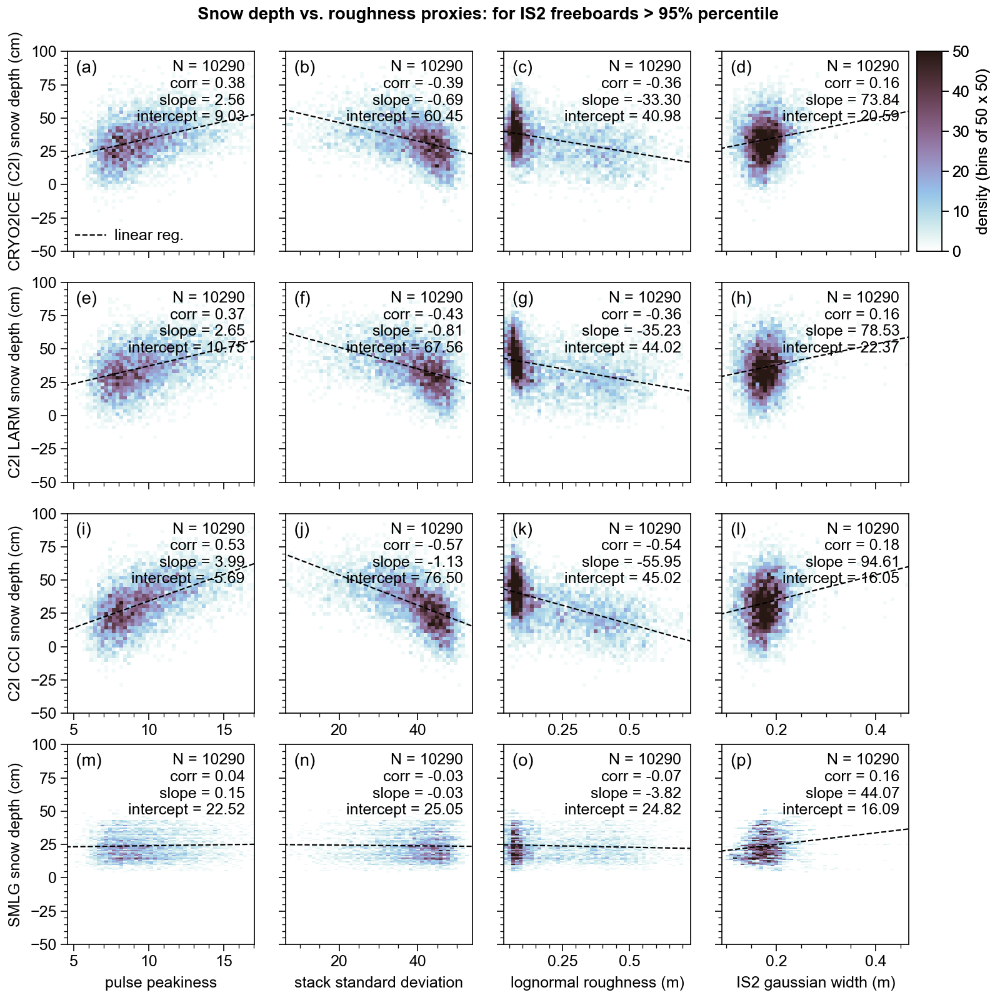

In [74]:
import proplot as pplt
fig = pplt.figure(space=2, figsize=(8,8), span=False, sharex=False, sharey=True)
ax = fig.subplots(nrows=4, ncols=4)
#fig, ax = plt.subplots(2, 3, figsize=(6,4), constrained_layout=True, sharey=True)

cmap_density = 'Glacial'
density = (50,50)

## 1 ROW - PLOTTING
im=using_hist2d(ax[0,0], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,0].format(xlabel='', ylabel='CRYO2ICE (C2I) snow depth (cm)',  xticklabels=[])

im=using_hist2d(ax[0,1], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,2], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,3], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,3].format(xlabel='', ylabel='',  xticklabels=[])

# ROW 2- PLOTTING
im=using_hist2d(ax[1,0], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,0].format(xlabel='', ylabel='C2I LARM snow depth (cm)',  xticklabels=[])

im=using_hist2d(ax[1,1], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,2], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,3], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,3].format(xlabel='', ylabel='',  xticklabels=[])

### ROW 3 - PLOTTING
im=using_hist2d(ax[2,0], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,0].format(xlabel='pulse peakiness', ylabel='C2I CCI snow depth (cm)')

im=using_hist2d(ax[2,1], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,1].format(xlabel='stack standard deviation', ylabel='')

im=using_hist2d(ax[2,2], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,2].format(xlabel='lognormal roughness (m)', ylabel='')

im=using_hist2d(ax[2,3], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,3].format(xlabel='IS2 gaussian width (m)', ylabel='')

### ROW 4 - PLOTTING
im=using_hist2d(ax[3,0], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,0].format(xlabel='pulse peakiness', ylabel='SMLG snow depth (cm)')

im=using_hist2d(ax[3,1], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,1].format(xlabel='stack standard deviation', ylabel='')

im=using_hist2d(ax[3,2], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,2].format(xlabel='lognormal roughness (m)', ylabel='')

im=using_hist2d(ax[3,3], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,3].format(xlabel='IS2 gaussian width (m)', ylabel='')

## GENERAL FORMATTING
ax[0,3].colorbar(im[3], label='density (bins of 50 x 50)', loc='r')

ax.format(
    abc='(a)', abcloc='ul',rc_kw={'abc.weight':'normal'},ylim=(-50,100)
)



## ROW 1 - TEXT
corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[0,0].text(0.95, 0.65, text_ax, transform=ax[0,0].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[0,1].text(0.95, 0.65, text_ax, transform=ax[0,1].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[0,2].text(0.95, 0.65, text_ax, transform=ax[0,2].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[0,3].text(0.95, 0.65, text_ax, transform=ax[0,3].transAxes, ha='right')

## ROW 2 - TEXT
corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[1,0].text(0.95, 0.65, text_ax, transform=ax[1,0].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[1,1].text(0.95, 0.65, text_ax, transform=ax[1,1].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[1,2].text(0.95, 0.65, text_ax, transform=ax[1,2].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_LARM_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[1,3].text(0.95, 0.65, text_ax, transform=ax[1,3].transAxes, ha='right')

## ROW 3 - TEXT
corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[2,0].text(0.95, 0.65, text_ax, transform=ax[2,0].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[2,1].text(0.95, 0.65, text_ax, transform=ax[2,1].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[2,2].text(0.95, 0.65, text_ax, transform=ax[2,2].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['snow_depth_original_MSS_CCI_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[2,3].text(0.95, 0.65, text_ax, transform=ax[2,3].transAxes, ha='right')


## ROW 4 - TEXT
corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[3,0].text(0.95, 0.65, text_ax, transform=ax[3,0].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[3,1].text(0.95, 0.65, text_ax, transform=ax[3,1].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[3,2].text(0.95, 0.65, text_ax, transform=ax[3,2].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['SMLG_snow_depth_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_max),corr, coef[0], coef[1])
ax[3,3].text(0.95, 0.65, text_ax, transform=ax[3,3].transAxes, ha='right')

# EXTRA LEGEND ITEMS
legend_elements = [Line2D([0], [0],color='k', label='linear reg.', linestyle='--', linewidth=0.8)]
ax[0,0].legend(handles=legend_elements, loc='lower left', fontsize=6,frameon=False)

plt.suptitle('Snow depth vs. roughness proxies: for IS2 freeboards > 95% percentile',x=0.1, y=.95, horizontalalignment='left', verticalalignment='top')


plt.savefig('E:\demo_CRYO2ICE_overall_comp_statistics_rougness_proxies_snow_depth_more_95_percentile.png', dpi=300)

# Snow depth vs. roughness proxies: IS2 snow freeboard < quantile(0.10)

In [70]:
CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min= CRYO2ICE_LARM_SMLG_coinident[CRYO2ICE_LARM_SMLG_coinident['IS2_w_fb_MSS']<np.quantile(CRYO2ICE_LARM_SMLG_coinident['IS2_w_fb_MSS'], 0.05)]
CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min

,Unnamed: 0,Unnamed: 0.1,index,lat,lon,fb,mss,fb_no_mss,ssd,ppk,...,snow_depth_original_MSS_smoothed,snow_depth_original_MSS_LARM_smoothed,month,snow_depth_original_MSS_unit_cm,snow_depth_original_MSS_LARM_unit_cm,SMLG_snow_depth_unit_cm,snow_depth_original_MSS_smoothed_unit_cm,snow_depth_original_MSS_LARM_smoothed_unit_cm,snow_depth_original_MSS_CCI_unit_cm,IS2_w_fb_MSS
900,900,3262,3262,83.04911,105.93064,0.048,5.719,-5.671,24.96,11.373709,...,0.254101,NaN,November,9.501380,10.176796,4.718522,25.410145,NaN,15.891980,0.125044
903,903,3265,3265,83.01798,105.85111,-0.035,5.719,-5.754,30.68,10.609533,...,0.229472,NaN,November,20.406714,20.672918,4.718522,22.947184,NaN,18.719440,0.130473
904,904,3266,3266,83.01538,105.84452,0.073,5.719,-5.646,25.28,8.994288,...,0.203217,NaN,November,7.101381,16.060538,4.718522,20.321688,NaN,10.366963,0.130583
905,905,3267,3267,83.01279,105.83793,0.028,5.719,-5.691,37.23,9.293457,...,0.135327,0.142969,November,12.669468,8.461683,4.718522,13.532735,14.296875,9.922850,0.130733
906,906,3268,3268,83.01019,105.83134,-0.022,5.719,-5.741,34.29,8.916773,...,0.119515,0.125760,November,18.857585,16.688835,4.718522,11.951454,12.576002,19.582553,0.130911
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54827,23,214,214,76.25107,-149.74339,0.115,-2.978,3.093,16.32,12.836953,...,0.077603,0.059982,April,6.823009,5.998106,12.419494,7.760270,5.998167,10.942191,0.170326
54828,24,215,215,76.25648,-149.74717,0.018,-2.978,2.996,28.43,9.342745,...,0.081916,NaN,April,17.958844,20.780957,12.419494,8.191602,NaN,11.783321,0.163624
54829,25,216,216,76.26190,-149.75094,0.150,-2.978,3.128,15.61,8.946695,...,0.057951,NaN,April,0.393486,-8.221051,12.419494,5.795066,NaN,-2.063164,0.153191
55814,1010,3452,3452,83.96083,56.46964,0.037,13.785,-13.748,17.82,13.215029,...,0.056598,NaN,April,16.487621,32.478234,28.221288,5.659794,NaN,27.662672,0.170694


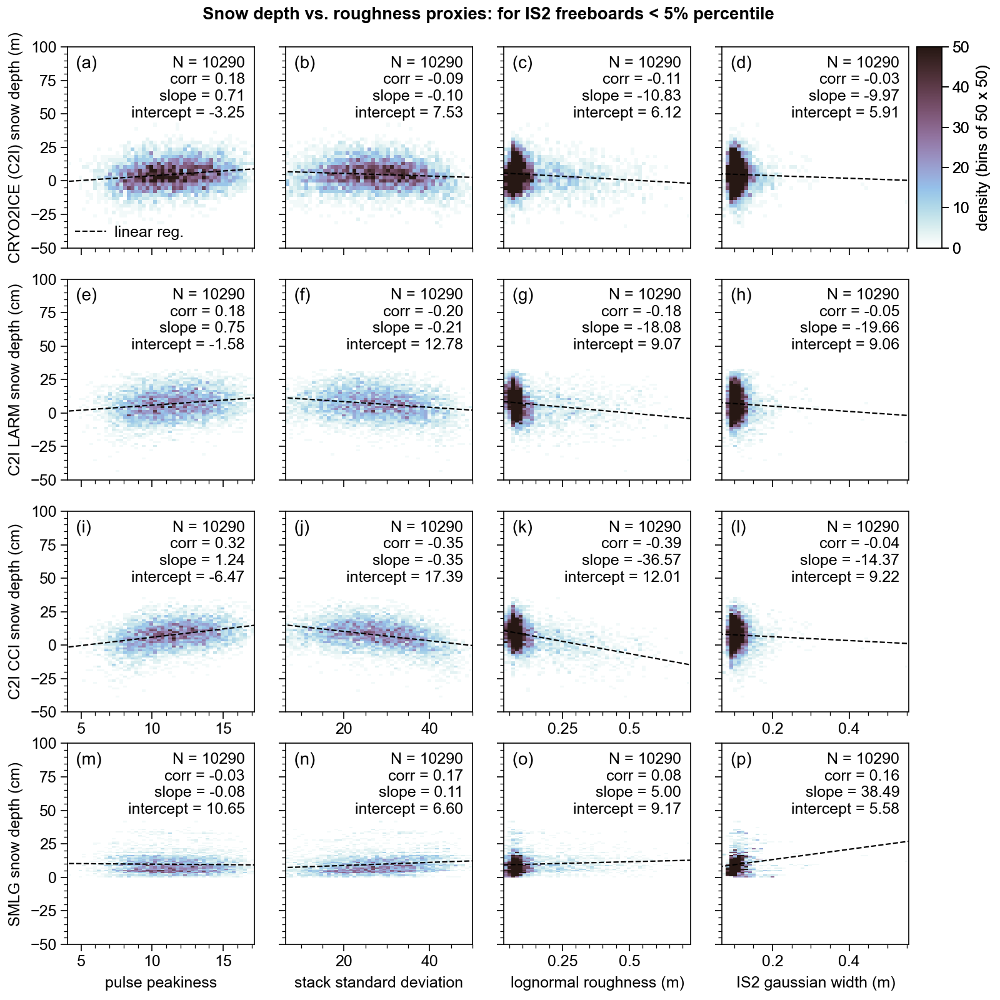

In [119]:
import proplot as pplt
fig = pplt.figure(space=2, figsize=(8,8), span=False, sharex=False, sharey=True)
ax = fig.subplots(nrows=4, ncols=4)
#fig, ax = plt.subplots(2, 3, figsize=(6,4), constrained_layout=True, sharey=True)

cmap_density = 'Glacial'
density = (50, 50)

## 1 ROW - PLOTTING
im=using_hist2d(ax[0,0], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ppk'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,0].format(xlabel='', ylabel='CRYO2ICE (C2I) snow depth (m)',  xticklabels=[])

im=using_hist2d(ax[0,1], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ssd'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,2], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['LARM_roughness'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,3], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['IS2_mean_gw'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,3].format(xlabel='', ylabel='',  xticklabels=[])

# ROW 2- PLOTTING
im=using_hist2d(ax[1,0], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ppk'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,0].format(xlabel='', ylabel='C2I LARM snow depth (cm)',  xticklabels=[])

im=using_hist2d(ax[1,1], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ssd'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,2], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['LARM_roughness'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,3], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['IS2_mean_gw'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,3].format(xlabel='', ylabel='',  xticklabels=[])

### ROW 3 - PLOTTING
im=using_hist2d(ax[2,0], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ppk'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,0].format(xlabel='pulse peakiness', ylabel='C2I CCI snow depth (cm)')

im=using_hist2d(ax[2,1], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ssd'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,1].format(xlabel='stack standard deviation', ylabel='')

im=using_hist2d(ax[2,2], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['LARM_roughness'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,2].format(xlabel='lognormal roughness (m)', ylabel='')

im=using_hist2d(ax[2,3], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['IS2_mean_gw'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,3].format(xlabel='IS2 gaussian width (m)', ylabel='')

### ROW 4 - PLOTTING
im=using_hist2d(ax[3,0], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ppk'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,0].format(xlabel='pulse peakiness', ylabel='SMLG snow depth (cm)')

im=using_hist2d(ax[3,1], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ssd'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,1].format(xlabel='stack standard deviation', ylabel='')

im=using_hist2d(ax[3,2], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['LARM_roughness'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,2].format(xlabel='lognormal roughness (m)', ylabel='')

im=using_hist2d(ax[3,3], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['IS2_mean_gw'], CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,3].format(xlabel='IS2 gaussian width (m)', ylabel='')

## GENERAL FORMATTING
ax[0,3].colorbar(im[3], label='density (bins of 50 x 50)', loc='r')

ax.format(
    abc='(a)', abcloc='ul',rc_kw={'abc.weight':'normal'},ylim=(-50,100)
)



## ROW 1 - TEXT
corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ppk'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min),corr, coef[0], coef[1])
ax[0,0].text(0.95, 0.65, text_ax, transform=ax[0,0].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ssd'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min),corr, coef[0], coef[1])
ax[0,1].text(0.95, 0.65, text_ax, transform=ax[0,1].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['LARM_roughness'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min),corr, coef[0], coef[1])
ax[0,2].text(0.95, 0.65, text_ax, transform=ax[0,2].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['IS2_mean_gw'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min),corr, coef[0], coef[1])
ax[0,3].text(0.95, 0.65, text_ax, transform=ax[0,3].transAxes, ha='right')

## ROW 2 - TEXT
corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_LARM_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ppk'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_LARM_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min),corr, coef[0], coef[1])
ax[1,0].text(0.95, 0.65, text_ax, transform=ax[1,0].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_LARM_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ssd'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_LARM_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min),corr, coef[0], coef[1])
ax[1,1].text(0.95, 0.65, text_ax, transform=ax[1,1].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_LARM_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['LARM_roughness'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_LARM_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min),corr, coef[0], coef[1])
ax[1,2].text(0.95, 0.65, text_ax, transform=ax[1,2].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_LARM_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['IS2_mean_gw'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_LARM_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min),corr, coef[0], coef[1])
ax[1,3].text(0.95, 0.65, text_ax, transform=ax[1,3].transAxes, ha='right')

## ROW 3 - TEXT
corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_CCI_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ppk'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_CCI_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min),corr, coef[0], coef[1])
ax[2,0].text(0.95, 0.65, text_ax, transform=ax[2,0].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_CCI_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ssd'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_CCI_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min),corr, coef[0], coef[1])
ax[2,1].text(0.95, 0.65, text_ax, transform=ax[2,1].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_CCI_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['LARM_roughness'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_CCI_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min),corr, coef[0], coef[1])
ax[2,2].text(0.95, 0.65, text_ax, transform=ax[2,2].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_CCI_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['IS2_mean_gw'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['snow_depth_original_MSS_CCI_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min),corr, coef[0], coef[1])
ax[2,3].text(0.95, 0.65, text_ax, transform=ax[2,3].transAxes, ha='right')


## ROW 4 - TEXT
corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['SMLG_snow_depth_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ppk'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['SMLG_snow_depth_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min),corr, coef[0], coef[1])
ax[3,0].text(0.95, 0.65, text_ax, transform=ax[3,0].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['SMLG_snow_depth_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ssd'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['SMLG_snow_depth_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min),corr, coef[0], coef[1])
ax[3,1].text(0.95, 0.65, text_ax, transform=ax[3,1].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['SMLG_snow_depth_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['LARM_roughness'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['SMLG_snow_depth_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min),corr, coef[0], coef[1])
ax[3,2].text(0.95, 0.65, text_ax, transform=ax[3,2].transAxes, ha='right')

corr = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['SMLG_snow_depth_unit_cm'].corr(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['IS2_mean_gw'])
y,x = CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['SMLG_snow_depth_unit_cm'],CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(CRYO2ICE_LARM_SMLG_coinident_IS2_filt_min),corr, coef[0], coef[1])
ax[3,3].text(0.95, 0.65, text_ax, transform=ax[3,3].transAxes, ha='right')

# EXTRA LEGEND ITEMS
legend_elements = [Line2D([0], [0],color='k', label='linear reg.', linestyle='--', linewidth=0.8)]
ax[0,0].legend(handles=legend_elements, loc='lower left', fontsize=6,frameon=False)

plt.suptitle('Snow depth vs. roughness proxies: for IS2 freeboards < 5% percentile',x=0.1, y=.95, horizontalalignment='left', verticalalignment='top')


plt.savefig('E:\demo_CRYO2ICE_overall_comp_statistics_rougness_proxies_snow_depth_less_5_percentile.png', dpi=300)

# Gridding of CRYO2ICE data 

In [98]:
def CRYO2ICE_gridding_identify_grid_NN(df3_short,df_AMSR2):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    query_lats = df3_short[['lat']].to_numpy()
    query_lons = df3_short[['lon']].to_numpy()

    tree = BallTree(np.deg2rad(df_AMSR2[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    distances, indices = tree.query(np.deg2rad(np.c_[query_lats, query_lons]), k=1)
    
    return indices

In [119]:
fname = 'E:/DTU/CRYO2ICE/AMSR2/AMSR_U2_L3_SeaIce12km_B04_20201110.he5'
file = h5py.File(fname, 'r')
file.keys()
lon = np.array(file['HDFEOS/GRIDS/NpPolarGrid12km/lon'])
lat = np.array(file['HDFEOS/GRIDS/NpPolarGrid12km/lat'])
snow_depth = np.array(file['HDFEOS/GRIDS/NpPolarGrid12km/Data Fields/SI_12km_NH_SNOWDEPTH_5DAY'])
sea_ice_concentration= np.array(file['HDFEOS/GRIDS/NpPolarGrid12km/Data Fields/SI_12km_NH_ICECON_DAY'])
file.close()

missing_snow_depth  = np.where(snow_depth != 110, np.nan, snow_depth)
land_snow_depth  = np.where(snow_depth != 120, np.nan, snow_depth)
OW_snow_depth  = np.where(snow_depth != 130, np.nan, snow_depth)
MYI_snow_depth  = np.where(snow_depth != 140, np.nan, snow_depth)
variability_snow_depth  = np.where(snow_depth != 150, np.nan, snow_depth)
melt_snow_depth  = np.where(snow_depth != 160, np.nan, snow_depth)
snow_depth_only  = np.where(snow_depth > 100, np.nan, snow_depth)
sea_ice_concentration_only = np.where(sea_ice_concentration > 100, np.nan, sea_ice_concentration)

df_AMSR2 = pd.DataFrame({'lat':lat.flatten(), 'lon':lon.flatten(), 'snow_depth':snow_depth_only.flatten(), 'sea_ice_concentration':sea_ice_concentration_only.flatten()})


In [304]:
len(lon.flatten())

544768

In [319]:
import scipy.stats as stats
from mpl_toolkits.basemap import Basemap

grid_res=25
bins = int(8e6/(grid_res*1000))
m = Basemap(projection='npstere',boundinglat=60,lon_0=0, resolution='l',round=True)

## mean gridding
lon_mesh, lat_mesh = m(lon, lat)
x, y, data_val = np.array(CRYO2ICE_nov_LARM_SMLG_coincident['lon']), np.array(CRYO2ICE_nov_LARM_SMLG_coincident['lat']), np.array(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS'])
grid_mean_snow_depth_original_MSS, xedges, yedges, binnumber = stats.binned_statistic_2d(
    lon_mesh, lat_mesh, values=data_val, statistic=np.nanmean, 
    bins=bins)
x, y, data_val = np.array(CRYO2ICE_nov_LARM_SMLG_coincident['lon']), np.array(CRYO2ICE_nov_LARM_SMLG_coincident['lat']), np.array(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_LARM'])
grid_mean_snow_depth_original_MSS_LARM, xedges, yedges, binnumber = stats.binned_statistic_2d(
    lon_mesh, lat_mesh, values=data_val, statistic=np.nanmean, 
    bins=bins)

## median gridding
x, y, data_val = np.array(CRYO2ICE_nov_LARM_SMLG_coincident['lon']), np.array(CRYO2ICE_nov_LARM_SMLG_coincident['lat']), np.array(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS'])
grid_median_snow_depth_original_MSS, xedges, yedges, binnumber = stats.binned_statistic_2d(
    lon_mesh, lat_mesh, values=data_val, statistic=np.nanmedian, 
    bins=bins)
x, y, data_val = np.array(CRYO2ICE_nov_LARM_SMLG_coincident['lon']), np.array(CRYO2ICE_nov_LARM_SMLG_coincident['lat']), np.array(CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_LARM'])
grid_median_snow_depth_original_MSS_LARM, xedges, yedges, binnumber = stats.binned_statistic_2d(
    lon_mesh, lat_mesh, values=data_val, statistic=np.nanmedian, 
    bins=bins)

ValueError: too many values to unpack (expected 2)

In [321]:
lon_mesh, lat_mesh = m(lon, lat)
lon_mesh

array([[ 4870558.29431084,  4879653.52910808,  4888748.71152816, ...,
        10377054.16001622, 10386189.0870855 , 10395323.99224383],
       [ 4861445.65083638,  4870541.34919561,  4879634.92842901, ...,
        10367900.59788842, 10377035.43695712, 10386170.46913027],
       [ 4852333.27112097,  4861427.52511109,  4870523.32360951, ...,
        10358747.27626264, 10367881.99322399, 10377016.91458079],
       ...,
       [-3255669.19509208, -3246535.09850931, -3237401.43841996, ...,
         2249540.42002035,  2258633.45137273,  2267726.70155393],
       [-3264816.02704142, -3255682.44366297, -3246548.49945874, ...,
         2240432.95117482,  2249526.05731263,  2258619.40165313],
       [-3273963.2796308 , -3264829.31410635, -3255695.89958589, ...,
         2231325.38879237,  2240418.60114209,  2249511.86729558]])

In [120]:
from scipy.spatial import ckdtree

def medip(x, y, z, Xi, Yi, n, d):
    """2D interpolation using median."""
    # Johan Nilsson, ICESat-2 Hack Week, https://github.com/ICESAT-2HackWeek/ICESat2_hackweek_tutorials/blob/master/06_Gridding_Nilsson/notebook/Gridding.ipynb 
    
    # Ravel grid coord.
    xi = Xi.ravel()
    yi = Yi.ravel()
    
    # Create output vectors
    zi = np.zeros(len(xi)) * np.nan
    
    # Create kdtree
    tree = ckdtree(np.c_[x, y])
    
    # Loop through observations
    for i in range(len(xi)):
        
        # Find closest number of observations
        (dxy, idx) = tree.query((xi[i], yi[i]), k=n)
        
        # Check max distance
        if dxy.min() > d: continue
        
        # Get parameters
        zc = z[idx]
        
        # Check for empty solutions
        if len(zc[~np.isnan(zc)]) == 0: continue
        
        # Predicted value
        zi[i] = np.nanmedian(zc)
    
    # Return interpolated points
    return zi


In [108]:
import pyproj
# Output coordinates are in WGS 84 longitude and latitude
projIn= pyproj.Proj(init='epsg:4326')

# Input coordinates are in meters on the Polar Stereographic 
# projection given in the netCDF file
projOut = pyproj.Proj('+proj=stere +lat_0=90 +lat_ts=70 +lon_0=-45 +k=1 +x_0=0 +y_0=0 +datum=WGS84 +units=m +no_defs ',preserve_units=True)
x_new, y_new = pyproj.transform(projIn, projOut, (np.float64(x)), (np.float64(y)))
x_new

C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/2186493764.py:8: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  x_new, y_new = pyproj.transform(projIn, projOut, (np.float64(x)), (np.float64(y)))


array([[inf, inf, inf, ..., inf, inf, inf],
       [inf, inf, inf, ..., inf, inf, inf],
       [inf, inf, inf, ..., inf, inf, inf],
       ...,
       [inf, inf, inf, ..., inf, inf, inf],
       [inf, inf, inf, ..., inf, inf, inf],
       [inf, inf, inf, ..., inf, inf, inf]])

In [109]:
def median_grid(df, lon, lat):
    import numpy as np
    import pyproj
    from scipy.spatial import ckdtree
    from scipy.spatial.distance import cdist
    from scipy import stats
    from scipy.ndimage import map_coordinates

    ## median gridding
    x, y, data_val, data_val_LARM = np.array(df['lon']), np.array(df['lat']), np.array(df['snow_depth_original_MSS']), np.array(df['snow_depth_original_MSS_LARM'])

    projIn= pyproj.Proj(init='epsg:4326')
    projOut = pyproj.Proj('+proj=stere +lat_0=90 +lat_ts=70 +lon_0=-45 +k=1 +x_0=0 +y_0=0 +datum=WGS84 +units=m +no_defs ',preserve_units=True)
    x_new, y_new = pyproj.transform(projIn, projOut, (np.float64(x)), (np.float64(y)))
    lon_new, lat_new = pyproj.transform(projIn, projOut, (np.float64(lon)), (np.float64(lat)))

    grid_median_nov_snow_depth_original_MSS = medip(x_new, y_new, data_val, lon_new, lat_new, n=500, d=25e3)
    grid_median_nov_snow_depth_original_MSS_LARM = medip(x_new, y_new, data_val_LARM, lon_new, lat_new, n=500, d=25e3)
    data_val = np.array(df['snow_depth_original_MSS_CCI'])
    grid_median_nov_snow_depth_original_MSS_CCI = medip(x_new, y_new, data_val, lon_new, lat_new, n=500, d=25e3)
    data_val = np.array(df['ssd'])
    grid_median_nov_snow_depth_original_MSS_SSD = medip(x_new, y_new, data_val, lon_new, lat_new, n=500, d=25e3)
    data_val = np.array(df['ppk'])
    grid_median_nov_snow_depth_original_MSS_PPK = medip(x_new, y_new, data_val, lon_new, lat_new, n=500, d=25e3)
    data_val = np.array(df['LARM_roughness'])
    grid_median_nov_snow_depth_original_MSS_roughness_LARM = medip(x_new, y_new, data_val, lon_new, lat_new, n=500, d=25e3)
    data_val = np.array(df['IS2_mean_gw'])
    grid_median_nov_snow_depth_original_MSS_IS2_gw = medip(x_new, y_new, data_val, lon_new, lat_new, n=500, d=25e3)
    data_val = np.array(df['AMSR2_snow_depth'])
    grid_median_nov_snow_depth_original_MSS_AMSR2 = medip(x_new, y_new, data_val, lon_new, lat_new, n=500, d=25e3)
    data_val = np.array(df['SMLG_snow_depth'])
    grid_median_nov_snow_depth_original_MSS_SMLG = medip(x_new, y_new, data_val, lon_new, lat_new, n=500, d=25e3)
    data_val = np.array(df['SMLG_snow_depth_v2'])
    grid_median_nov_snow_depth_original_MSS_SMLG = medip(x_new, y_new, data_val, lon_new, lat_new, n=500, d=25e3)
    
    df_grid = pd.DataFrame({'snow_depth_original_MSS':grid_median_nov_snow_depth_original_MSS,
                          'snow_depth_original_MSS_LARM':grid_median_nov_snow_depth_original_MSS_LARM, 
                          'snow_depth_original_MSS_CCI':grid_median_nov_snow_depth_original_MSS_CCI,
                          'ssd':grid_median_nov_snow_depth_original_MSS_SSD,
                          'ppk':grid_median_nov_snow_depth_original_MSS_PPK,
                          'LARM_roughness':grid_median_nov_snow_depth_original_MSS_roughness_LARM,
                          'IS2_mean_gw':grid_median_nov_snow_depth_original_MSS_IS2_gw, 
                           'AMSR2_snow_depth':grid_median_nov_snow_depth_original_MSS_AMSR2,
                           'SMLG_snow_depth':grid_median_nov_snow_depth_original_MSS_SMLG,
                          'SMLG_snow_depth_v2':grid_median_nov_snow_depth_original_MSS_SMLG})
    
    return df_grid

print('November CRYO2ICE tracks computing...')
df = CRYO2ICE_nov_LARM_SMLG_coincident
df_grid_nov = median_grid(df, lon, lat)
print('November analysis finished.')

print('December CRYO2ICE tracks computing...')
df = CRYO2ICE_dec_LARM_SMLG_coincident
df_grid_dec = median_grid(df, lon, lat)
print('December analysis finished.')

print('January CRYO2ICE tracks computing...')
df = CRYO2ICE_jan_LARM_SMLG_coincident
df_grid_jan= median_grid(df, lon, lat)
print('January analysis finished.')

print('February CRYO2ICE tracks computing...')
df = CRYO2ICE_feb_LARM_SMLG_coincident
df_grid_feb = median_grid(df, lon, lat)
print('February analysis finished.')

print('March CRYO2ICE tracks computing...')
df = CRYO2ICE_mar_LARM_SMLG_coincident
df_grid_mar = median_grid(df, lon, lat)
print('March analysis finished.')

print('April CRYO2ICE tracks computing...')
df = CRYO2ICE_apr_LARM_SMLG_coincident
df_grid_apr = median_grid(df, lon, lat)
print('April analysis finished.')

November CRYO2ICE tracks computing...


C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/2770863855.py:14: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  x_new, y_new = pyproj.transform(projIn, projOut, (np.float64(x)), (np.float64(y)))
C:\Users\rmfha\AppData\Local\Temp/ipykernel_11104/2770863855.py:15: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  lon_new, lat_new = pyproj.transform(projIn, projOut, (np.float64(lon)), (np.float64(lat)))


TypeError: 'module' object is not callable

In [367]:
df_grid_nov

,snow_depth_original_MSS,snow_depth_original_MSS_LARM,snow_depth_original_MSS_CCI,ssd,ppk,LARM_roughness,IS2_mean_gw
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...
544763,NaN,NaN,NaN,NaN,NaN,NaN,NaN
544764,NaN,NaN,NaN,NaN,NaN,NaN,NaN
544765,NaN,NaN,NaN,NaN,NaN,NaN,NaN
544766,NaN,NaN,NaN,NaN,NaN,NaN,NaN


(array([  60.,  357.,  517.,  718., 1103.,  816.,  355.,  108.,   18.,
          15.]),
 array([-0.05742721, -0.0447278 , -0.03202839, -0.01932898, -0.00662957,
         0.00606984,  0.01876925,  0.03146866,  0.04416808,  0.05686749,
         0.0695669 ]),
 <BarContainer object of 10 artists>)

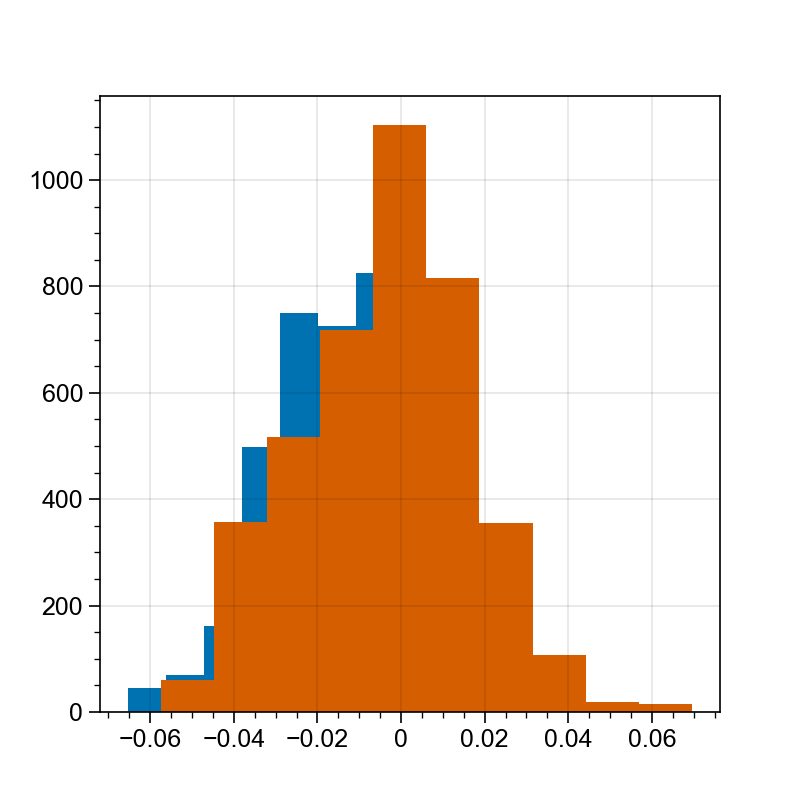

In [383]:
plt.hist(df_grid_nov['snow_depth_original_MSS']-df_grid_nov['snow_depth_original_MSS_LARM'])
plt.hist(df_grid_nov['snow_depth_original_MSS']-df_grid_nov['snow_depth_original_MSS_CCI'])

(array([  21.,  292.,  522., 1033., 1256., 1206.,  792.,  252.,   79.,
          28.]),
 array([-0.08032437, -0.06476052, -0.04919666, -0.0336328 , -0.01806895,
        -0.00250509,  0.01305877,  0.02862262,  0.04418648,  0.05975034,
         0.07531419]),
 <BarContainer object of 10 artists>)

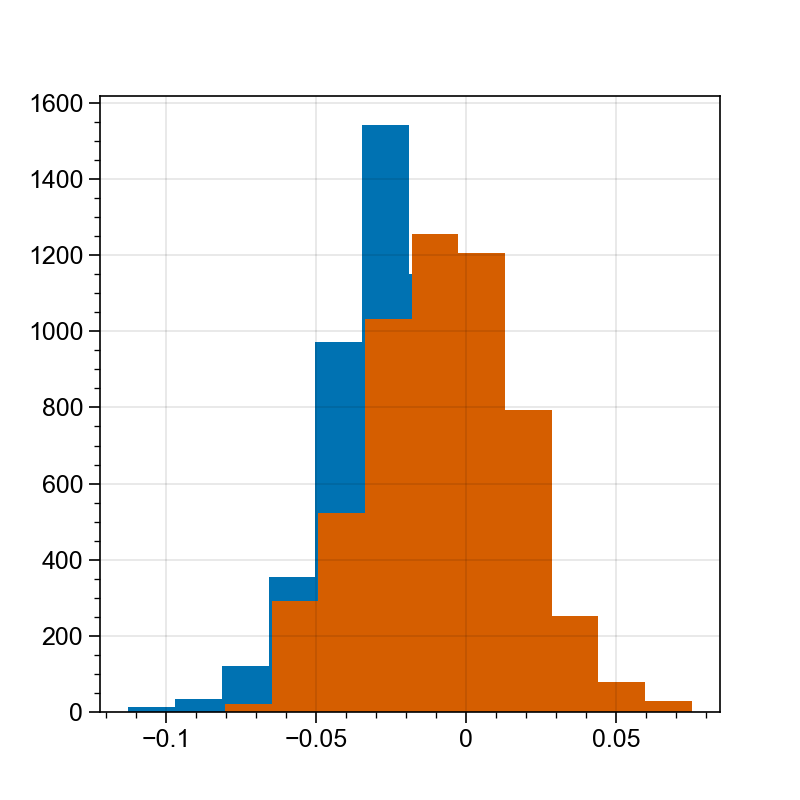

In [384]:
plt.hist(df_grid_dec['snow_depth_original_MSS']-df_grid_dec['snow_depth_original_MSS_LARM'])
plt.hist(df_grid_dec['snow_depth_original_MSS']-df_grid_dec['snow_depth_original_MSS_CCI'])

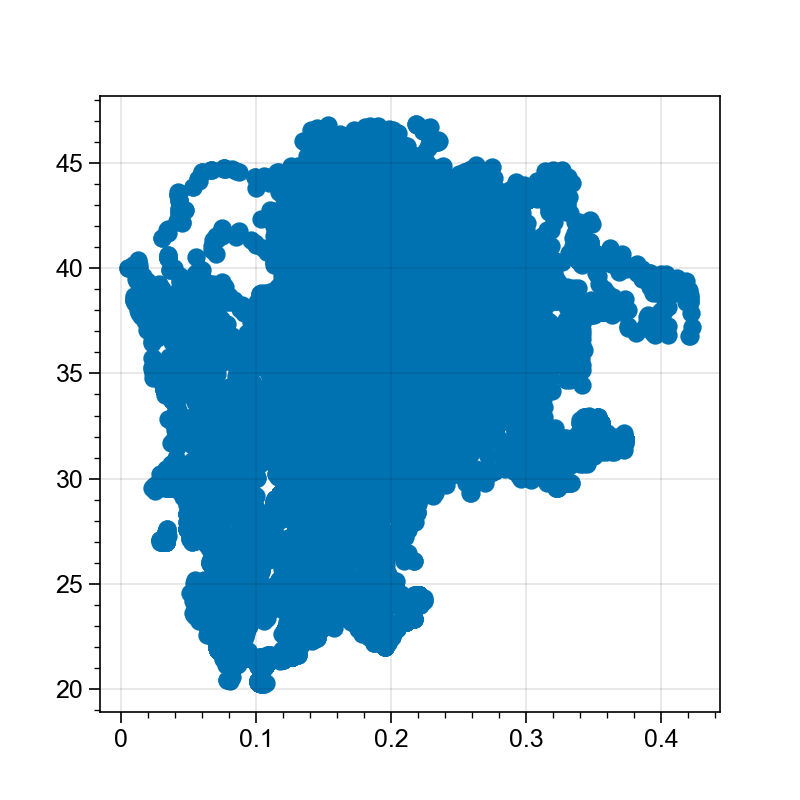

In [410]:
plt.scatter(df['snow_depth_original_MSS'],df['ssd'])

In [93]:
df_grid_nov['month']='November'
df_grid_dec['month']='December'
df_grid_jan['month']='January'
df_grid_feb['month']='February'
df_grid_mar['month']='March'
df_grid_apr['month']='April'

frames = [df_grid_nov, df_grid_dec, df_grid_jan, df_grid_feb, df_grid_mar, df_grid_apr]

grid_all = pd.concat(frames)
grid_all

NameError: name 'df_grid_nov' is not defined

In [121]:
def compute_monthly_growth(df_ASMR2, var):
    monthly_growth = [np.nan,np.nanmean(df_AMSR2[df_AMSR2['month']=='November'][var]),
                            np.nanmean(df_AMSR2[df_AMSR2['month']=='December'][var]),
                            np.nanmean(df_AMSR2[df_AMSR2['month']=='January'][var]),
                            np.nanmean(df_AMSR2[df_AMSR2['month']=='February'][var]),
                            np.nanmean(df_AMSR2[df_AMSR2['month']=='March'][var]),
                            np.nanmean(df_AMSR2[df_AMSR2['month']=='April'][var]),np.nan]
    return monthly_growth

In [122]:
df_AMSR2

,lat,lon,snow_depth,sea_ice_concentration
0,31.041601,168.335083,NaN,0.0
1,31.090008,168.249451,NaN,0.0
2,31.138325,168.163651,NaN,0.0
3,31.186554,168.077682,NaN,0.0
4,31.234695,167.991547,NaN,0.0
...,...,...,...,...
544763,34.616768,-10.346684,NaN,0.0
544764,34.564896,-10.256090,NaN,0.0
544765,34.512928,-10.165695,NaN,0.0
544766,34.460865,-10.075498,NaN,0.0


In [123]:
monthly_growth_AMSR2 = compute_monthly_growth(df_AMSR2, 'AMSR2_snow_depth')
monthly_growth_SMLG = compute_monthly_growth(df_AMSR2, 'SMLG_snow_depth_unit_cm')
monthly_growth_SMLG_v2 = compute_monthly_growth(df_AMSR2, 'SMLG_snow_depth_v2_unit_cm')
monthly_growth_C2I = compute_monthly_growth(df_AMSR2, 'snow_depth_original_MSS_unit_cm')
monthly_growth_C2I_LARM = compute_monthly_growth(df_AMSR2, 'snow_depth_original_MSS_LARM_unit_cm')
monthly_growth_C2I_CCI = compute_monthly_growth(df_AMSR2, 'snow_depth_original_MSS_CCI_unit_cm')

months = ['','November', 'December', 'January', 'February', 'March', 'April','']

KeyError: 'month'

In [486]:
monthly_growth_AMSR2[1:7]

[17.533938437253354,
 18.78369980879541,
 21.513170892327956,
 21.701077943615257,
 21.404975347377857,
 19.65188909201706]

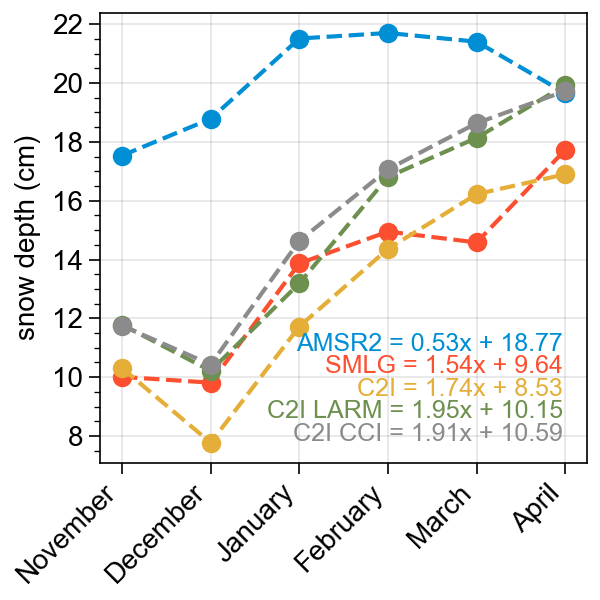

In [496]:
import proplot as pplt
fig = pplt.figure(space=2, figsize=(3,3), span=False, sharex=False, sharey=True)
ax = fig.subplots(nrows=1, ncols=1)
#fig, ax = plt.subplots(2, 3, figsize=(6,4), constrained_layout=True, sharey=True)
colours = [cmap_qual(0)[0:3],cmap_qual(1)[0:3],cmap_qual(2)[0:3],cmap_qual(3)[0:3],cmap_qual(4)[0:3],cmap_qual(5)[0:3]]


ax[0].plot(months, monthly_growth_AMSR2, linestyle='--',marker='o', c=colours[0])
ax[0].plot(months, monthly_growth_SMLG, linestyle='--',marker='o', c=colours[1])
ax[0].plot(months, monthly_growth_C2I, linestyle='--',marker='o', c=colours[2])
ax[0].plot(months, monthly_growth_C2I_LARM, linestyle='--',marker='o', c=colours[3])
ax[0].plot(months, monthly_growth_C2I_CCI, linestyle='--',marker='o', c=colours[4])

x,y = np.arange(6), monthly_growth_AMSR2[1:7]
coef = np.polyfit(x,y,1)
ax[0].text(0.95, 0.25, 'AMSR2 = {:.2f}x + {:.2f}'.format(coef[0], coef[1]), c=colours[0], transform = ax[0].transAxes, ha='right')

x,y = np.arange(6), monthly_growth_SMLG[1:7]
coef = np.polyfit(x,y,1)
ax[0].text(0.95, 0.20, 'SMLG = {:.2f}x + {:.2f}'.format(coef[0], coef[1]), c=colours[1], transform = ax[0].transAxes, ha='right')

x,y = np.arange(6), monthly_growth_C2I[1:7]
coef = np.polyfit(x,y,1)
ax[0].text(0.95, 0.15, 'C2I = {:.2f}x + {:.2f}'.format(coef[0], coef[1]), c=colours[2], transform = ax[0].transAxes, ha='right')

x,y = np.arange(6), monthly_growth_C2I_LARM[1:7]
coef = np.polyfit(x,y,1)
ax[0].text(0.95, 0.10, 'C2I LARM = {:.2f}x + {:.2f}'.format(coef[0], coef[1]),  c=colours[3], transform = ax[0].transAxes, ha='right')

x,y = np.arange(6), monthly_growth_C2I_CCI[1:7]
coef = np.polyfit(x,y,1)
ax[0].text(0.95, 0.05, 'C2I CCI = {:.2f}x + {:.2f}'.format(coef[0], coef[1]),  c=colours[4], transform = ax[0].transAxes, ha='right')

ax[0].format(xrotation=45, ylabel='snow depth (cm)', fontsize=10)

C:\Users\rmfha\AppData\Local\Temp/ipykernel_11600/2520050305.py:142: ProplotWarning: Calling arbitrary axes methods from SubplotGrid was deprecated in v0.8 and will be removed in a future release. Please index the grid or loop over the grid instead.
  ax[1,2].plot(np.arange(-50,100,10),np.arange(-50,100,10), color='grey', alpha=0.3, linestyle='--')


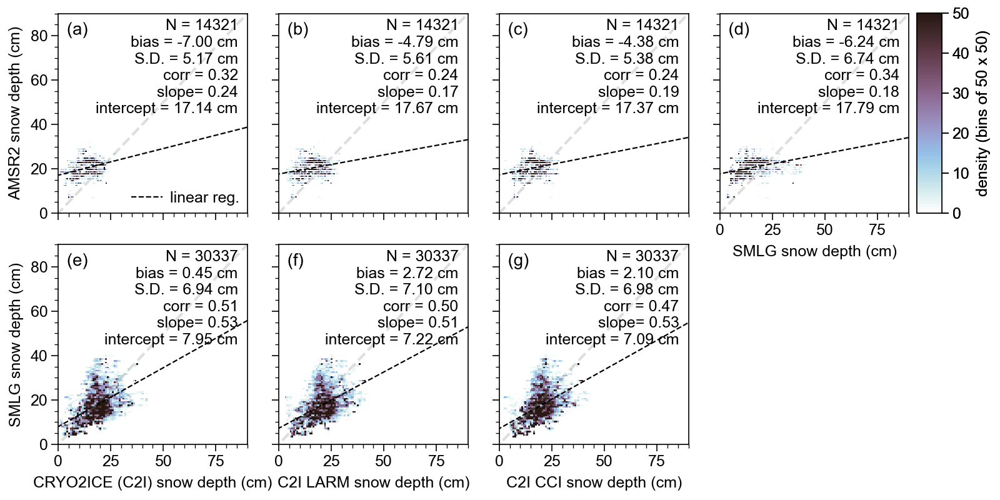

In [429]:
import proplot as pplt
fig = pplt.figure(space=2, figsize=(8,4), span=False, sharex=False)
ax = fig.subplots(nrows=2, ncols=4)
#fig, ax = plt.subplots(2, 3, figsize=(6,4), constrained_layout=True, sharey=True)

cmap_density = 'Glacial'
density = (50,50)
df = grid_all[(grid_all['SMLG_snow_depth'].notna())&(grid_all['snow_depth_original_MSS'].notna()) & (grid_all['snow_depth_original_MSS_LARM'].notna()) & grid_all['snow_depth_original_MSS_CCI'].notna()]
df['snow_depth_original_MSS_unit_cm']=df['snow_depth_original_MSS']*100
df['snow_depth_original_MSS_LARM_unit_cm']=df['snow_depth_original_MSS_LARM']*100
df['snow_depth_original_MSS_CCI_unit_cm']=df['snow_depth_original_MSS_CCI']*100
df['SMLG_snow_depth_unit_cm']=df['SMLG_snow_depth']*100
df_AMSR2 = df[df['AMSR2_snow_depth'].notna()]

im=using_hist2d(ax[0,0], df_AMSR2['snow_depth_original_MSS_unit_cm'], df_AMSR2['AMSR2_snow_depth'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,0].format(xlabel='', ylabel='AMSR2 snow depth (cm)',  xticklabels=[])

im=using_hist2d(ax[0,1], df_AMSR2['snow_depth_original_MSS_LARM_unit_cm'], df_AMSR2['AMSR2_snow_depth'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,1].format(xlabel='', ylabel='AMSR2 snow depth (cm)',  xticklabels=[])

im=using_hist2d(ax[0,2], df_AMSR2['snow_depth_original_MSS_CCI_unit_cm'], df_AMSR2['AMSR2_snow_depth'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,2].format(xlabel='', ylabel='AMSR2 snow depth (cm)',  xticklabels=[])

im=using_hist2d(ax[0,3], df_AMSR2['SMLG_snow_depth_unit_cm'], df_AMSR2['AMSR2_snow_depth'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,3].format(xlabel='SMLG snow depth (cm)', ylabel='AMSR2 snow depth (cm)')


im=using_hist2d(ax[1,0], df['snow_depth_original_MSS_unit_cm'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,0].format(xlabel='CRYO2ICE (C2I) snow depth (cm)', ylabel='SMLG snow depth (cm)')

m=using_hist2d(ax[1,1],df['snow_depth_original_MSS_LARM_unit_cm'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
ax[1,1].format(xlabel='C2I LARM snow depth (cm)', ylabel='SMLG snow depth (cm)')

m=using_hist2d(ax[1,2],df['snow_depth_original_MSS_CCI_unit_cm'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
ax[1,2].format(xlabel='C2I CCI snow depth (cm)', ylabel='SMLG snow depth (cm)')

#ax[1].set_ylabel('differnece in laser and radar freeboard (IS2-CS2) (m)')
#CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS_LARM'].corr(CRYO2ICE_LARM_SMLG_coinident['SMLG_snow_depth'])
#plt.colorbar(im[3], label='density (bins of 80 x80)',ax=ax[1,1])


## ROW 1
bias = np.nanmean(df_AMSR2['snow_depth_original_MSS_unit_cm']-df_AMSR2['AMSR2_snow_depth'])
sd = np.nanstd(df_AMSR2['snow_depth_original_MSS_unit_cm']-df_AMSR2['AMSR2_snow_depth'])
corr = df_AMSR2['snow_depth_original_MSS_unit_cm'].corr(df_AMSR2['AMSR2_snow_depth'])
x,y = df_AMSR2['snow_depth_original_MSS_unit_cm'],df_AMSR2['AMSR2_snow_depth']
coef = np.polyfit(x,y,1)
x_new = np.arange(-50,100,10)
polyval_predict = np.polyval(coef,x_new)
ax[0,0].plot(x_new, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\nbias = {:.2f} cm\nS.D. = {:.2f} cm\ncorr = {:.2f}\nslope= {:.2f}\nintercept = {:.2f} cm".format(len(df_AMSR2),bias, sd, corr, coef[0], coef[1])
ax[0,0].text(0.95, 0.5, text_ax, transform=ax[0,0].transAxes, ha='right')


bias = np.nanmean(df_AMSR2['snow_depth_original_MSS_LARM_unit_cm']-df_AMSR2['AMSR2_snow_depth'])
sd = np.nanstd(df_AMSR2['snow_depth_original_MSS_LARM_unit_cm']-df_AMSR2['AMSR2_snow_depth'])
corr = df_AMSR2['snow_depth_original_MSS_LARM_unit_cm'].corr(df_AMSR2['AMSR2_snow_depth'])
x,y = df_AMSR2['snow_depth_original_MSS_LARM_unit_cm'],df_AMSR2['AMSR2_snow_depth']
coef = np.polyfit(x,y,1)
x_new = np.arange(-50,100,10)
polyval_predict = np.polyval(coef,x_new)
ax[0,1].plot(x_new, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\nbias = {:.2f} cm\nS.D. = {:.2f} cm\ncorr = {:.2f}\nslope= {:.2f}\nintercept = {:.2f} cm".format(len(df_AMSR2),bias, sd, corr, coef[0], coef[1])
ax[0,1].text(0.95, 0.5, text_ax, transform=ax[0,1].transAxes, ha='right')

bias = np.nanmean(df_AMSR2['snow_depth_original_MSS_CCI_unit_cm']-df_AMSR2['AMSR2_snow_depth'])
sd = np.nanstd(df_AMSR2['snow_depth_original_MSS_CCI_unit_cm']-df_AMSR2['AMSR2_snow_depth'])
corr = df_AMSR2['snow_depth_original_MSS_CCI_unit_cm'].corr(df_AMSR2['AMSR2_snow_depth'])
x,y = df_AMSR2['snow_depth_original_MSS_CCI_unit_cm'],df_AMSR2['AMSR2_snow_depth']
coef = np.polyfit(x,y,1)
x_new = np.arange(-50,100,10)
polyval_predict = np.polyval(coef,x_new)
ax[0,2].plot(x_new, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\nbias = {:.2f} cm\nS.D. = {:.2f} cm\ncorr = {:.2f}\nslope= {:.2f}\nintercept = {:.2f} cm".format(len(df_AMSR2),bias, sd, corr, coef[0], coef[1])
ax[0,2].text(0.95, 0.5, text_ax, transform=ax[0,2].transAxes, ha='right')


bias = np.nanmean(df_AMSR2['SMLG_snow_depth_unit_cm']-df_AMSR2['AMSR2_snow_depth'])
sd = np.nanstd(df_AMSR2['SMLG_snow_depth_unit_cm']-df_AMSR2['AMSR2_snow_depth'])
corr = df_AMSR2['SMLG_snow_depth_unit_cm'].corr(df_AMSR2['AMSR2_snow_depth'])
x,y = df_AMSR2['SMLG_snow_depth_unit_cm'],df_AMSR2['AMSR2_snow_depth']
coef = np.polyfit(x,y,1)
x_new = np.arange(-50,100,10)
polyval_predict = np.polyval(coef,x_new)
ax[0,3].plot(x_new, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\nbias = {:.2f} cm\nS.D. = {:.2f} cm\ncorr = {:.2f}\nslope= {:.2f}\nintercept = {:.2f} cm".format(len(df_AMSR2),bias, sd, corr, coef[0], coef[1])
ax[0,3].text(0.95, 0.5, text_ax, transform=ax[0,3].transAxes, ha='right')

## ROW 2
bias = np.nanmean(df['snow_depth_original_MSS_unit_cm']-df['SMLG_snow_depth_unit_cm'])
sd = np.nanstd(df['snow_depth_original_MSS_unit_cm']-df['SMLG_snow_depth_unit_cm'])
corr = df['snow_depth_original_MSS_unit_cm'].corr(df['SMLG_snow_depth_unit_cm'])
x,y = df['snow_depth_original_MSS_unit_cm'],df['SMLG_snow_depth_unit_cm']
coef = np.polyfit(x,y,1)
x_new = np.arange(-50,100,10)
polyval_predict = np.polyval(coef,x_new)
ax[1,0].plot(x_new, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\nbias = {:.2f} cm\nS.D. = {:.2f} cm\ncorr = {:.2f}\nslope= {:.2f}\nintercept = {:.2f} cm".format(len(df),bias, sd, corr, coef[0], coef[1])
ax[1,0].text(0.95, 0.5, text_ax, transform=ax[1,0].transAxes, ha='right')


bias = np.nanmean(df['snow_depth_original_MSS_LARM_unit_cm']-df['SMLG_snow_depth_unit_cm'])
sd = np.nanstd(df['snow_depth_original_MSS_LARM_unit_cm']-df['SMLG_snow_depth_unit_cm'])
corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['SMLG_snow_depth_unit_cm'])
x,y = df['snow_depth_original_MSS_LARM_unit_cm'],df['SMLG_snow_depth_unit_cm']
coef = np.polyfit(x,y,1)
x_new = np.arange(-50,100,10)
polyval_predict = np.polyval(coef,x_new)
ax[1,1].plot(x_new, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\nbias = {:.2f} cm\nS.D. = {:.2f} cm\ncorr = {:.2f}\nslope= {:.2f}\nintercept = {:.2f} cm".format(len(df),bias, sd, corr, coef[0], coef[1])
ax[1,1].text(0.95, 0.5, text_ax, transform=ax[1,1].transAxes, ha='right')

bias = np.nanmean(df['snow_depth_original_MSS_CCI_unit_cm']-df['SMLG_snow_depth_unit_cm'])
sd = np.nanstd(df['snow_depth_original_MSS_CCI_unit_cm']-df['SMLG_snow_depth_unit_cm'])
corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['SMLG_snow_depth_unit_cm'])
x,y = df['snow_depth_original_MSS_CCI_unit_cm'],df['SMLG_snow_depth_unit_cm']
coef = np.polyfit(x,y,1)
x_new = np.arange(-50,100,10)
polyval_predict = np.polyval(coef,x_new)
ax[1,2].plot(x_new, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\nbias = {:.2f} cm\nS.D. = {:.2f} cm\ncorr = {:.2f}\nslope= {:.2f}\nintercept = {:.2f} cm".format(len(df),bias, sd, corr, coef[0], coef[1])
ax[1,2].text(0.95, 0.5, text_ax, transform=ax[1,2].transAxes, ha='right')

ax[1, 3].set_visible(False)
ax.format(
    abc='(a)', abcloc='ul', xlim=(0, 90), ylim=(0, 90),rc_kw={'abc.weight':'normal'}
)
ax[0,3].colorbar(im[3], label='density (bins of 50 x 50)', loc='r')

ax[0,0].plot(np.arange(-50,100,10),np.arange(-50,100,10), color='grey', alpha=0.3, linestyle='--')
ax[0,1].plot(np.arange(-50,100,10),np.arange(-50,100,10), color='grey', alpha=0.3, linestyle='--')
ax[0,2].plot(np.arange(-50,100,10),np.arange(-50,100,10), color='grey', alpha=0.3, linestyle='--')
ax[0,3].plot(np.arange(-50,100,10),np.arange(-50,100,10), color='grey', alpha=0.3, linestyle='--')

ax[1,0].plot(np.arange(-50,100,10),np.arange(-50,100,10), color='grey', alpha=0.3, linestyle='--')
ax[1,1].plot(np.arange(-50,100,10),np.arange(-50,100,10), color='grey', alpha=0.3, linestyle='--')
ax[1,2].plot(np.arange(-50,100,10),np.arange(-50,100,10), color='grey', alpha=0.3, linestyle='--')


legend_elements = [Line2D([0], [0],color='k', label='linear reg.', linestyle='--', linewidth=0.8)]

ax[0,0].legend(handles=legend_elements, loc='lower right', fontsize=6,frameon=False)


plt.savefig('E:\demo_CRYO2ICE_overall_comp_statistics_auxiliary_data_gridded_data.png', dpi=300)

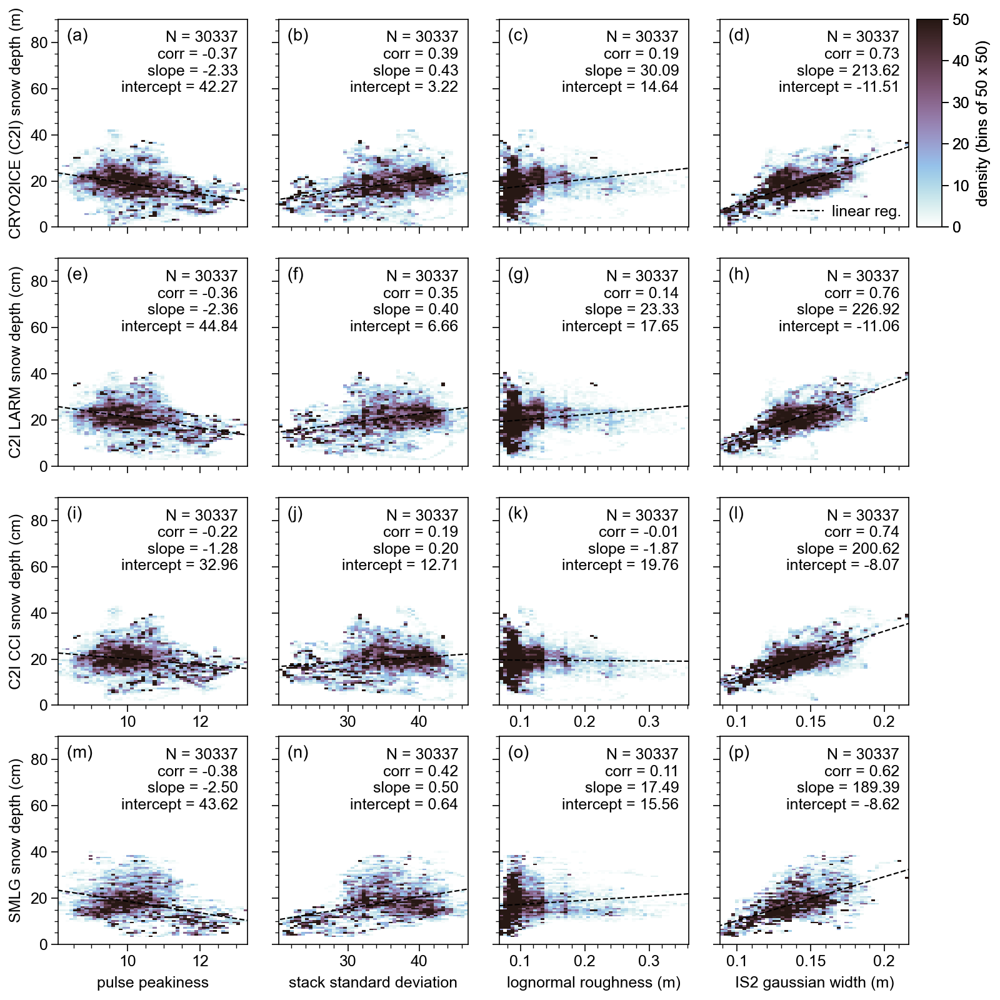

In [413]:
import proplot as pplt
fig = pplt.figure(space=2, figsize=(8,8), span=False, sharex=False, sharey=True)
ax = fig.subplots(nrows=4, ncols=4)
#fig, ax = plt.subplots(2, 3, figsize=(6,4), constrained_layout=True, sharey=True)

cmap_density = 'Glacial'
density = (50,50)

df = grid_all[(grid_all['SMLG_snow_depth'].notna())&(grid_all['snow_depth_original_MSS'].notna()) & (grid_all['snow_depth_original_MSS_LARM'].notna()) & grid_all['snow_depth_original_MSS_CCI'].notna()]
df['snow_depth_original_MSS_unit_cm']=df['snow_depth_original_MSS']*100
df['snow_depth_original_MSS_LARM_unit_cm']=df['snow_depth_original_MSS_LARM']*100
df['snow_depth_original_MSS_CCI_unit_cm']=df['snow_depth_original_MSS_CCI']*100
df['SMLG_snow_depth_unit_cm']=df['SMLG_snow_depth']*100

## 1 ROW - PLOTTING
im=using_hist2d(ax[0,0], df['ppk'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,0].format(xlabel='', ylabel='CRYO2ICE (C2I) snow depth (m)',  xticklabels=[])

im=using_hist2d(ax[0,1], df['ssd'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,2], df['LARM_roughness'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,3], df['IS2_mean_gw'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,3].format(xlabel='', ylabel='',  xticklabels=[])

# ROW 2- PLOTTING
im=using_hist2d(ax[1,0], df['ppk'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,0].format(xlabel='', ylabel='C2I LARM snow depth (cm)',  xticklabels=[])

im=using_hist2d(ax[1,1], df['ssd'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,2], df['LARM_roughness'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,3], df['IS2_mean_gw'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,3].format(xlabel='', ylabel='',  xticklabels=[])

### ROW 3 - PLOTTING
im=using_hist2d(ax[2,0], df['ppk'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,0].format(xlabel='', ylabel='C2I CCI snow depth (cm)')

im=using_hist2d(ax[2,1], df['ssd'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,1].format(xlabel='', ylabel='')

im=using_hist2d(ax[2,2], df['LARM_roughness'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,2].format(xlabel='', ylabel='')

im=using_hist2d(ax[2,3], df['IS2_mean_gw'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,3].format(xlabel=')', ylabel='')

### ROW 4 - PLOTTING
im=using_hist2d(ax[3,0], df['ppk'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,0].format(xlabel='pulse peakiness', ylabel='SMLG snow depth (cm)')

im=using_hist2d(ax[3,1], df['ssd'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,1].format(xlabel='stack standard deviation', ylabel='')

im=using_hist2d(ax[3,2], df['LARM_roughness'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,2].format(xlabel='lognormal roughness (m)', ylabel='')

im=using_hist2d(ax[3,3], df['IS2_mean_gw'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,3].format(xlabel='IS2 gaussian width (m)', ylabel='')

## GENERAL FORMATTING
ax[0,3].colorbar(im[3], label='density (bins of 50 x 50)', loc='r')

ax.format(
    abc='(a)', abcloc='ul',rc_kw={'abc.weight':'normal'},ylim=(0,90)
)



## ROW 1 - TEXT
corr = df['snow_depth_original_MSS_unit_cm'].corr(df['ppk'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,0].text(0.95, 0.65, text_ax, transform=ax[0,0].transAxes, ha='right')

corr = df['snow_depth_original_MSS_unit_cm'].corr(df['ssd'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,1].text(0.95, 0.65, text_ax, transform=ax[0,1].transAxes, ha='right')

corr = df['snow_depth_original_MSS_unit_cm'].corr(df['LARM_roughness'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,2].text(0.95, 0.65, text_ax, transform=ax[0,2].transAxes, ha='right')

corr = df['snow_depth_original_MSS_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,3].text(0.95, 0.65, text_ax, transform=ax[0,3].transAxes, ha='right')

## ROW 2 - TEXT
corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['ppk'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,0].text(0.95, 0.65, text_ax, transform=ax[1,0].transAxes, ha='right')

corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['ssd'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,1].text(0.95, 0.65, text_ax, transform=ax[1,1].transAxes, ha='right')

corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['LARM_roughness'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,2].text(0.95, 0.65, text_ax, transform=ax[1,2].transAxes, ha='right')

corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,3].text(0.95, 0.65, text_ax, transform=ax[1,3].transAxes, ha='right')

## ROW 3 - TEXT
corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['ppk'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,0].text(0.95, 0.65, text_ax, transform=ax[2,0].transAxes, ha='right')

corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['ssd'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,1].text(0.95, 0.65, text_ax, transform=ax[2,1].transAxes, ha='right')

corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['LARM_roughness'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,2].text(0.95, 0.65, text_ax, transform=ax[2,2].transAxes, ha='right')

corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,3].text(0.95, 0.65, text_ax, transform=ax[2,3].transAxes, ha='right')

## ROW 4 - TEXT
corr = df['SMLG_snow_depth_unit_cm'].corr(df['ppk'])
y,x = df['SMLG_snow_depth_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,0].text(0.95, 0.65, text_ax, transform=ax[3,0].transAxes, ha='right')

corr = df['SMLG_snow_depth_unit_cm'].corr(df['ssd'])
y,x = df['SMLG_snow_depth_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,1].text(0.95, 0.65, text_ax, transform=ax[3,1].transAxes, ha='right')

corr = df['SMLG_snow_depth_unit_cm'].corr(df['LARM_roughness'])
y,x = df['SMLG_snow_depth_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,2].text(0.95, 0.65, text_ax, transform=ax[3,2].transAxes, ha='right')

corr = df['SMLG_snow_depth_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['SMLG_snow_depth_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,3].text(0.95, 0.65, text_ax, transform=ax[3,3].transAxes, ha='right')

# EXTRA LEGEND ITEMS
legend_elements = [Line2D([0], [0],color='k', label='linear reg.', linestyle='--', linewidth=0.8)]
ax[0,3].legend(handles=legend_elements, loc='lower right', fontsize=6,frameon=False)


plt.savefig('E:\demo_CRYO2ICE_overall_comp_statistics_rougness_proxies_snow_depth_gridded.png', dpi=300)

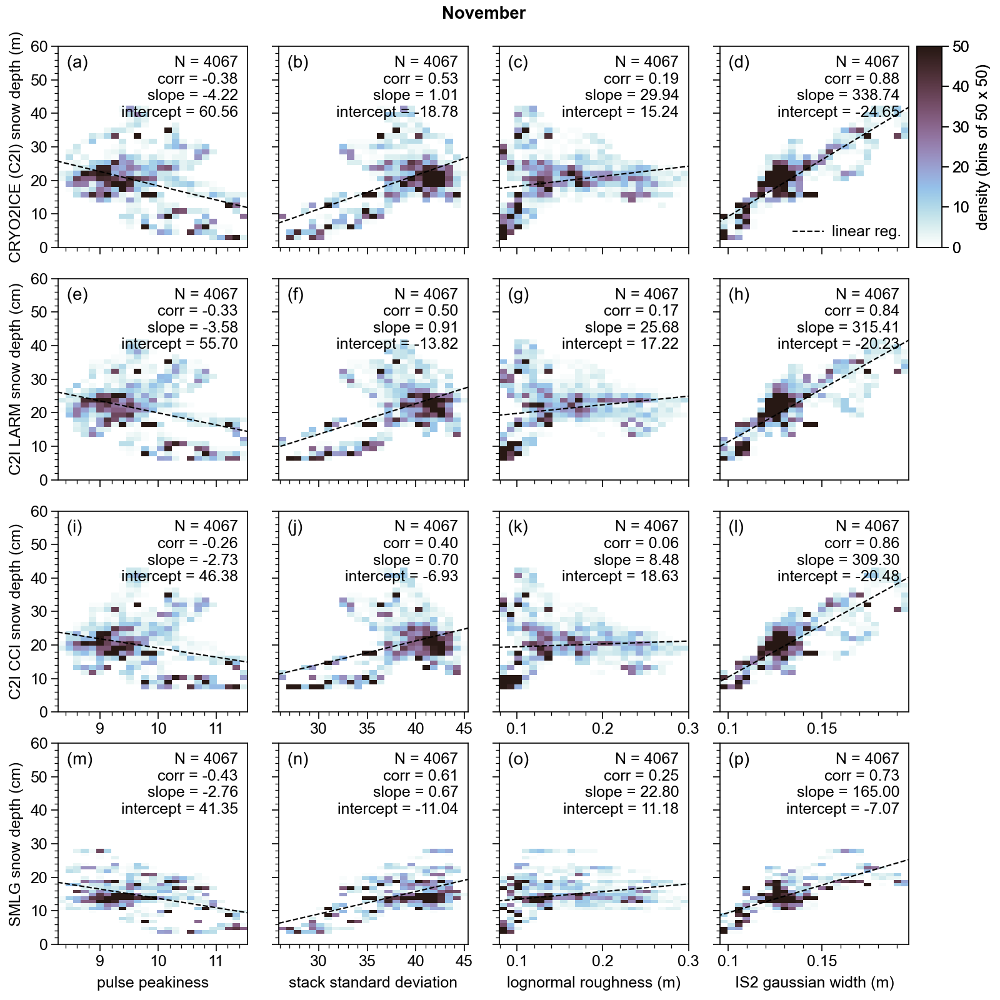

In [428]:
import proplot as pplt
fig = pplt.figure(space=2, figsize=(8,8), span=False, sharex=False, sharey=True)
ax = fig.subplots(nrows=4, ncols=4)
#fig, ax = plt.subplots(2, 3, figsize=(6,4), constrained_layout=True, sharey=True)

cmap_density = 'Glacial'
density = (25,25)

df = grid_all[(grid_all['SMLG_snow_depth'].notna())&(grid_all['snow_depth_original_MSS'].notna()) & (grid_all['snow_depth_original_MSS_LARM'].notna()) & grid_all['snow_depth_original_MSS_CCI'].notna()]
df['snow_depth_original_MSS_unit_cm']=df['snow_depth_original_MSS']*100
df['snow_depth_original_MSS_LARM_unit_cm']=df['snow_depth_original_MSS_LARM']*100
df['snow_depth_original_MSS_CCI_unit_cm']=df['snow_depth_original_MSS_CCI']*100
df['SMLG_snow_depth_unit_cm']=df['SMLG_snow_depth']*100

df = df[df['month']=='November']

## 1 ROW - PLOTTING
im=using_hist2d(ax[0,0], df['ppk'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,0].format(xlabel='', ylabel='CRYO2ICE (C2I) snow depth (m)',  xticklabels=[])

im=using_hist2d(ax[0,1], df['ssd'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,2], df['LARM_roughness'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,3], df['IS2_mean_gw'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,3].format(xlabel='', ylabel='',  xticklabels=[])

# ROW 2- PLOTTING
im=using_hist2d(ax[1,0], df['ppk'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,0].format(xlabel='', ylabel='C2I LARM snow depth (cm)',  xticklabels=[])

im=using_hist2d(ax[1,1], df['ssd'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,2], df['LARM_roughness'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,3], df['IS2_mean_gw'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,3].format(xlabel='', ylabel='',  xticklabels=[])

### ROW 3 - PLOTTING
im=using_hist2d(ax[2,0], df['ppk'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,0].format(xlabel='', ylabel='C2I CCI snow depth (cm)')

im=using_hist2d(ax[2,1], df['ssd'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,1].format(xlabel='', ylabel='')

im=using_hist2d(ax[2,2], df['LARM_roughness'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,2].format(xlabel='', ylabel='')

im=using_hist2d(ax[2,3], df['IS2_mean_gw'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,3].format(xlabel=')', ylabel='')

### ROW 4 - PLOTTING
im=using_hist2d(ax[3,0], df['ppk'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,0].format(xlabel='pulse peakiness', ylabel='SMLG snow depth (cm)')

im=using_hist2d(ax[3,1], df['ssd'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,1].format(xlabel='stack standard deviation', ylabel='')

im=using_hist2d(ax[3,2], df['LARM_roughness'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,2].format(xlabel='lognormal roughness (m)', ylabel='')

im=using_hist2d(ax[3,3], df['IS2_mean_gw'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,3].format(xlabel='IS2 gaussian width (m)', ylabel='')

## GENERAL FORMATTING
ax[0,3].colorbar(im[3], label='density (bins of 50 x 50)', loc='r')

ax.format(
    abc='(a)', abcloc='ul',rc_kw={'abc.weight':'normal'},ylim=(0,60)
)



## ROW 1 - TEXT
corr = df['snow_depth_original_MSS_unit_cm'].corr(df['ppk'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,0].text(0.95, 0.65, text_ax, transform=ax[0,0].transAxes, ha='right')

corr = df['snow_depth_original_MSS_unit_cm'].corr(df['ssd'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,1].text(0.95, 0.65, text_ax, transform=ax[0,1].transAxes, ha='right')

corr = df['snow_depth_original_MSS_unit_cm'].corr(df['LARM_roughness'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,2].text(0.95, 0.65, text_ax, transform=ax[0,2].transAxes, ha='right')

corr = df['snow_depth_original_MSS_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,3].text(0.95, 0.65, text_ax, transform=ax[0,3].transAxes, ha='right')

## ROW 2 - TEXT
corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['ppk'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,0].text(0.95, 0.65, text_ax, transform=ax[1,0].transAxes, ha='right')

corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['ssd'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,1].text(0.95, 0.65, text_ax, transform=ax[1,1].transAxes, ha='right')

corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['LARM_roughness'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,2].text(0.95, 0.65, text_ax, transform=ax[1,2].transAxes, ha='right')

corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,3].text(0.95, 0.65, text_ax, transform=ax[1,3].transAxes, ha='right')

## ROW 3 - TEXT
corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['ppk'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,0].text(0.95, 0.65, text_ax, transform=ax[2,0].transAxes, ha='right')

corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['ssd'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,1].text(0.95, 0.65, text_ax, transform=ax[2,1].transAxes, ha='right')

corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['LARM_roughness'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,2].text(0.95, 0.65, text_ax, transform=ax[2,2].transAxes, ha='right')

corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,3].text(0.95, 0.65, text_ax, transform=ax[2,3].transAxes, ha='right')

## ROW 4 - TEXT
corr = df['SMLG_snow_depth_unit_cm'].corr(df['ppk'])
y,x = df['SMLG_snow_depth_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,0].text(0.95, 0.65, text_ax, transform=ax[3,0].transAxes, ha='right')

corr = df['SMLG_snow_depth_unit_cm'].corr(df['ssd'])
y,x = df['SMLG_snow_depth_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,1].text(0.95, 0.65, text_ax, transform=ax[3,1].transAxes, ha='right')

corr = df['SMLG_snow_depth_unit_cm'].corr(df['LARM_roughness'])
y,x = df['SMLG_snow_depth_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,2].text(0.95, 0.65, text_ax, transform=ax[3,2].transAxes, ha='right')

corr = df['SMLG_snow_depth_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['SMLG_snow_depth_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,3].text(0.95, 0.65, text_ax, transform=ax[3,3].transAxes, ha='right')

# EXTRA LEGEND ITEMS
legend_elements = [Line2D([0], [0],color='k', label='linear reg.', linestyle='--', linewidth=0.8)]
ax[0,3].legend(handles=legend_elements, loc='lower right', fontsize=6,frameon=False)


plt.suptitle('November',x=0.1, y=.95, horizontalalignment='left', verticalalignment='top')
#plt.savefig('E:\demo_CRYO2ICE_barplot_combined.png', transparent=True)

plt.savefig('E:\demo_CRYO2ICE_overall_comp_statistics_rougness_proxies_snow_depth_gridded_november.png', dpi=300)


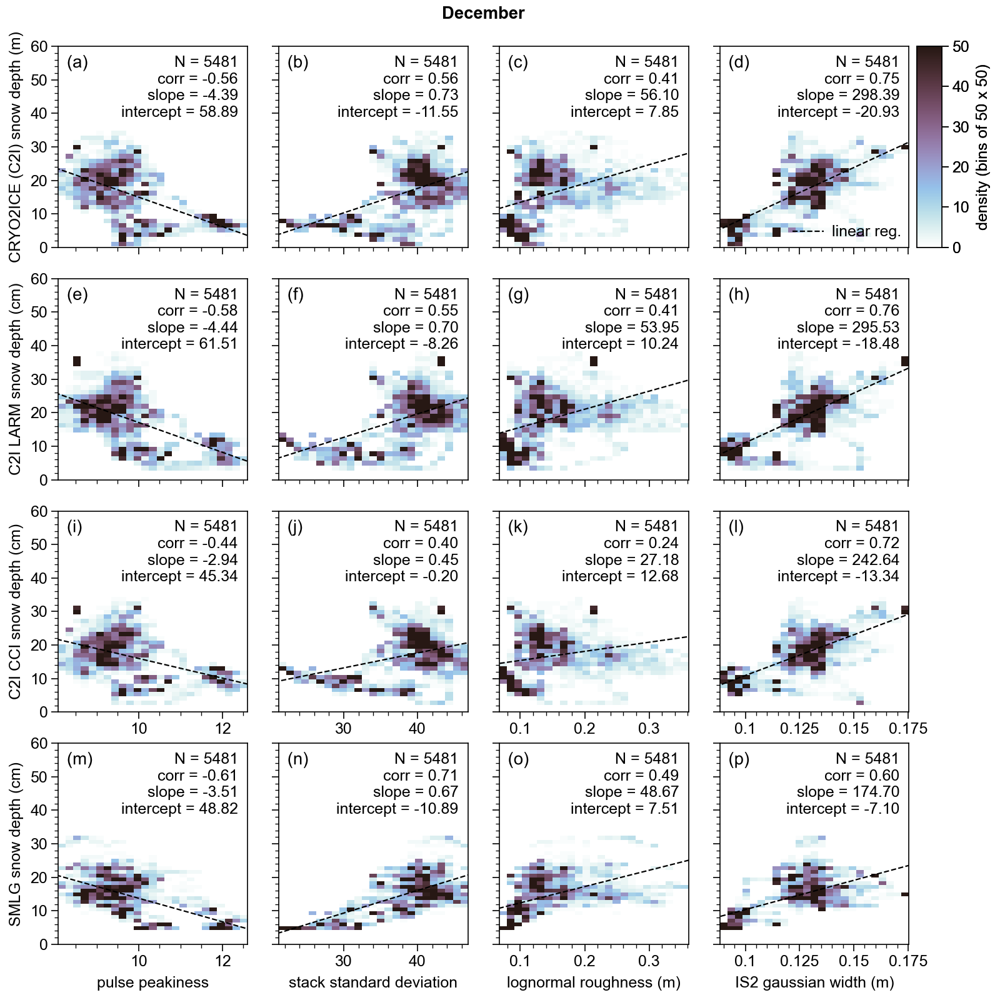

In [427]:
import proplot as pplt
fig = pplt.figure(space=2, figsize=(8,8), span=False, sharex=False, sharey=True)
ax = fig.subplots(nrows=4, ncols=4)
#fig, ax = plt.subplots(2, 3, figsize=(6,4), constrained_layout=True, sharey=True)

cmap_density = 'Glacial'
density = (25,25)

df = grid_all[(grid_all['SMLG_snow_depth'].notna())&(grid_all['snow_depth_original_MSS'].notna()) & (grid_all['snow_depth_original_MSS_LARM'].notna()) & grid_all['snow_depth_original_MSS_CCI'].notna()]
df['snow_depth_original_MSS_unit_cm']=df['snow_depth_original_MSS']*100
df['snow_depth_original_MSS_LARM_unit_cm']=df['snow_depth_original_MSS_LARM']*100
df['snow_depth_original_MSS_CCI_unit_cm']=df['snow_depth_original_MSS_CCI']*100
df['SMLG_snow_depth_unit_cm']=df['SMLG_snow_depth']*100

df = df[df['month']=='December']

## 1 ROW - PLOTTING
im=using_hist2d(ax[0,0], df['ppk'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,0].format(xlabel='', ylabel='CRYO2ICE (C2I) snow depth (m)',  xticklabels=[])

im=using_hist2d(ax[0,1], df['ssd'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,2], df['LARM_roughness'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,3], df['IS2_mean_gw'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,3].format(xlabel='', ylabel='',  xticklabels=[])

# ROW 2- PLOTTING
im=using_hist2d(ax[1,0], df['ppk'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,0].format(xlabel='', ylabel='C2I LARM snow depth (cm)',  xticklabels=[])

im=using_hist2d(ax[1,1], df['ssd'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,2], df['LARM_roughness'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,3], df['IS2_mean_gw'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,3].format(xlabel='', ylabel='',  xticklabels=[])

### ROW 3 - PLOTTING
im=using_hist2d(ax[2,0], df['ppk'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,0].format(xlabel='', ylabel='C2I CCI snow depth (cm)')

im=using_hist2d(ax[2,1], df['ssd'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,1].format(xlabel='', ylabel='')

im=using_hist2d(ax[2,2], df['LARM_roughness'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,2].format(xlabel='', ylabel='')

im=using_hist2d(ax[2,3], df['IS2_mean_gw'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,3].format(xlabel=')', ylabel='')

### ROW 4 - PLOTTING
im=using_hist2d(ax[3,0], df['ppk'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,0].format(xlabel='pulse peakiness', ylabel='SMLG snow depth (cm)')

im=using_hist2d(ax[3,1], df['ssd'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,1].format(xlabel='stack standard deviation', ylabel='')

im=using_hist2d(ax[3,2], df['LARM_roughness'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,2].format(xlabel='lognormal roughness (m)', ylabel='')

im=using_hist2d(ax[3,3], df['IS2_mean_gw'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,3].format(xlabel='IS2 gaussian width (m)', ylabel='')

## GENERAL FORMATTING
ax[0,3].colorbar(im[3], label='density (bins of 50 x 50)', loc='r')

ax.format(
    abc='(a)', abcloc='ul',rc_kw={'abc.weight':'normal'},ylim=(0,60)
)



## ROW 1 - TEXT
corr = df['snow_depth_original_MSS_unit_cm'].corr(df['ppk'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,0].text(0.95, 0.65, text_ax, transform=ax[0,0].transAxes, ha='right')

corr = df['snow_depth_original_MSS_unit_cm'].corr(df['ssd'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,1].text(0.95, 0.65, text_ax, transform=ax[0,1].transAxes, ha='right')

corr = df['snow_depth_original_MSS_unit_cm'].corr(df['LARM_roughness'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,2].text(0.95, 0.65, text_ax, transform=ax[0,2].transAxes, ha='right')

corr = df['snow_depth_original_MSS_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,3].text(0.95, 0.65, text_ax, transform=ax[0,3].transAxes, ha='right')

## ROW 2 - TEXT
corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['ppk'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,0].text(0.95, 0.65, text_ax, transform=ax[1,0].transAxes, ha='right')

corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['ssd'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,1].text(0.95, 0.65, text_ax, transform=ax[1,1].transAxes, ha='right')

corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['LARM_roughness'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,2].text(0.95, 0.65, text_ax, transform=ax[1,2].transAxes, ha='right')

corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,3].text(0.95, 0.65, text_ax, transform=ax[1,3].transAxes, ha='right')

## ROW 3 - TEXT
corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['ppk'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,0].text(0.95, 0.65, text_ax, transform=ax[2,0].transAxes, ha='right')

corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['ssd'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,1].text(0.95, 0.65, text_ax, transform=ax[2,1].transAxes, ha='right')

corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['LARM_roughness'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,2].text(0.95, 0.65, text_ax, transform=ax[2,2].transAxes, ha='right')

corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,3].text(0.95, 0.65, text_ax, transform=ax[2,3].transAxes, ha='right')

## ROW 4 - TEXT
corr = df['SMLG_snow_depth_unit_cm'].corr(df['ppk'])
y,x = df['SMLG_snow_depth_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,0].text(0.95, 0.65, text_ax, transform=ax[3,0].transAxes, ha='right')

corr = df['SMLG_snow_depth_unit_cm'].corr(df['ssd'])
y,x = df['SMLG_snow_depth_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,1].text(0.95, 0.65, text_ax, transform=ax[3,1].transAxes, ha='right')

corr = df['SMLG_snow_depth_unit_cm'].corr(df['LARM_roughness'])
y,x = df['SMLG_snow_depth_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,2].text(0.95, 0.65, text_ax, transform=ax[3,2].transAxes, ha='right')

corr = df['SMLG_snow_depth_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['SMLG_snow_depth_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,3].text(0.95, 0.65, text_ax, transform=ax[3,3].transAxes, ha='right')

# EXTRA LEGEND ITEMS
legend_elements = [Line2D([0], [0],color='k', label='linear reg.', linestyle='--', linewidth=0.8)]
ax[0,3].legend(handles=legend_elements, loc='lower right', fontsize=6,frameon=False)


plt.suptitle('December',x=0.1, y=.95, horizontalalignment='left', verticalalignment='top')
#plt.savefig('E:\demo_CRYO2ICE_barplot_combined.png', transparent=True)

plt.savefig('E:\demo_CRYO2ICE_overall_comp_statistics_rougness_proxies_snow_depth_gridded_december.png', dpi=300)


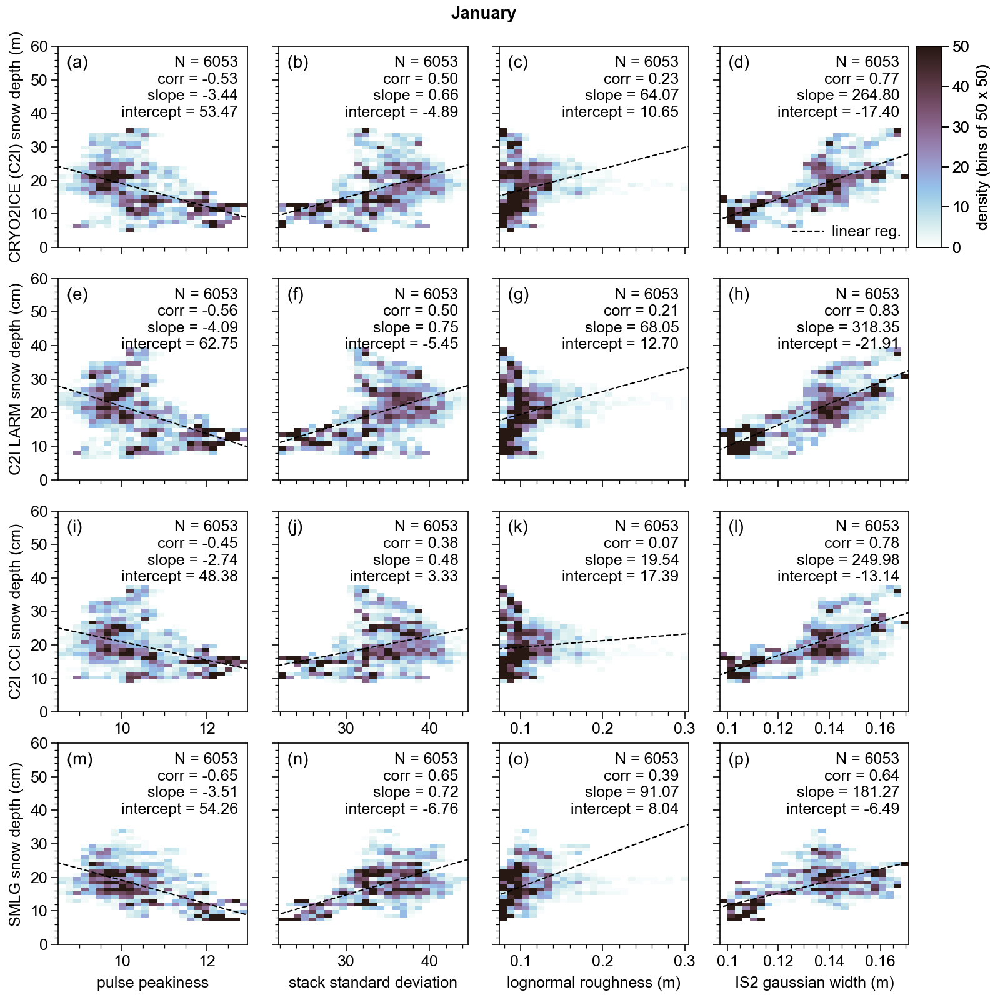

In [426]:
import proplot as pplt
fig = pplt.figure(space=2, figsize=(8,8), span=False, sharex=False, sharey=True)
ax = fig.subplots(nrows=4, ncols=4)
#fig, ax = plt.subplots(2, 3, figsize=(6,4), constrained_layout=True, sharey=True)

cmap_density = 'Glacial'
density = (25,25)

df = grid_all[(grid_all['SMLG_snow_depth'].notna())&(grid_all['snow_depth_original_MSS'].notna()) & (grid_all['snow_depth_original_MSS_LARM'].notna()) & grid_all['snow_depth_original_MSS_CCI'].notna()]
df['snow_depth_original_MSS_unit_cm']=df['snow_depth_original_MSS']*100
df['snow_depth_original_MSS_LARM_unit_cm']=df['snow_depth_original_MSS_LARM']*100
df['snow_depth_original_MSS_CCI_unit_cm']=df['snow_depth_original_MSS_CCI']*100
df['SMLG_snow_depth_unit_cm']=df['SMLG_snow_depth']*100

df = df[df['month']=='January']

## 1 ROW - PLOTTING
im=using_hist2d(ax[0,0], df['ppk'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,0].format(xlabel='', ylabel='CRYO2ICE (C2I) snow depth (m)',  xticklabels=[])

im=using_hist2d(ax[0,1], df['ssd'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,2], df['LARM_roughness'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,3], df['IS2_mean_gw'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,3].format(xlabel='', ylabel='',  xticklabels=[])

# ROW 2- PLOTTING
im=using_hist2d(ax[1,0], df['ppk'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,0].format(xlabel='', ylabel='C2I LARM snow depth (cm)',  xticklabels=[])

im=using_hist2d(ax[1,1], df['ssd'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,2], df['LARM_roughness'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,3], df['IS2_mean_gw'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,3].format(xlabel='', ylabel='',  xticklabels=[])

### ROW 3 - PLOTTING
im=using_hist2d(ax[2,0], df['ppk'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,0].format(xlabel='', ylabel='C2I CCI snow depth (cm)')

im=using_hist2d(ax[2,1], df['ssd'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,1].format(xlabel='', ylabel='')

im=using_hist2d(ax[2,2], df['LARM_roughness'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,2].format(xlabel='', ylabel='')

im=using_hist2d(ax[2,3], df['IS2_mean_gw'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,3].format(xlabel=')', ylabel='')

### ROW 4 - PLOTTING
im=using_hist2d(ax[3,0], df['ppk'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,0].format(xlabel='pulse peakiness', ylabel='SMLG snow depth (cm)')

im=using_hist2d(ax[3,1], df['ssd'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,1].format(xlabel='stack standard deviation', ylabel='')

im=using_hist2d(ax[3,2], df['LARM_roughness'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,2].format(xlabel='lognormal roughness (m)', ylabel='')

im=using_hist2d(ax[3,3], df['IS2_mean_gw'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,3].format(xlabel='IS2 gaussian width (m)', ylabel='')

## GENERAL FORMATTING
ax[0,3].colorbar(im[3], label='density (bins of 50 x 50)', loc='r')

ax.format(
    abc='(a)', abcloc='ul',rc_kw={'abc.weight':'normal'},ylim=(0,60)
)



## ROW 1 - TEXT
corr = df['snow_depth_original_MSS_unit_cm'].corr(df['ppk'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,0].text(0.95, 0.65, text_ax, transform=ax[0,0].transAxes, ha='right')

corr = df['snow_depth_original_MSS_unit_cm'].corr(df['ssd'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,1].text(0.95, 0.65, text_ax, transform=ax[0,1].transAxes, ha='right')

corr = df['snow_depth_original_MSS_unit_cm'].corr(df['LARM_roughness'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,2].text(0.95, 0.65, text_ax, transform=ax[0,2].transAxes, ha='right')

corr = df['snow_depth_original_MSS_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,3].text(0.95, 0.65, text_ax, transform=ax[0,3].transAxes, ha='right')

## ROW 2 - TEXT
corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['ppk'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,0].text(0.95, 0.65, text_ax, transform=ax[1,0].transAxes, ha='right')

corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['ssd'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,1].text(0.95, 0.65, text_ax, transform=ax[1,1].transAxes, ha='right')

corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['LARM_roughness'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,2].text(0.95, 0.65, text_ax, transform=ax[1,2].transAxes, ha='right')

corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,3].text(0.95, 0.65, text_ax, transform=ax[1,3].transAxes, ha='right')

## ROW 3 - TEXT
corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['ppk'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,0].text(0.95, 0.65, text_ax, transform=ax[2,0].transAxes, ha='right')

corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['ssd'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,1].text(0.95, 0.65, text_ax, transform=ax[2,1].transAxes, ha='right')

corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['LARM_roughness'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,2].text(0.95, 0.65, text_ax, transform=ax[2,2].transAxes, ha='right')

corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,3].text(0.95, 0.65, text_ax, transform=ax[2,3].transAxes, ha='right')

## ROW 4 - TEXT
corr = df['SMLG_snow_depth_unit_cm'].corr(df['ppk'])
y,x = df['SMLG_snow_depth_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,0].text(0.95, 0.65, text_ax, transform=ax[3,0].transAxes, ha='right')

corr = df['SMLG_snow_depth_unit_cm'].corr(df['ssd'])
y,x = df['SMLG_snow_depth_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,1].text(0.95, 0.65, text_ax, transform=ax[3,1].transAxes, ha='right')

corr = df['SMLG_snow_depth_unit_cm'].corr(df['LARM_roughness'])
y,x = df['SMLG_snow_depth_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,2].text(0.95, 0.65, text_ax, transform=ax[3,2].transAxes, ha='right')

corr = df['SMLG_snow_depth_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['SMLG_snow_depth_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,3].text(0.95, 0.65, text_ax, transform=ax[3,3].transAxes, ha='right')

# EXTRA LEGEND ITEMS
legend_elements = [Line2D([0], [0],color='k', label='linear reg.', linestyle='--', linewidth=0.8)]
ax[0,3].legend(handles=legend_elements, loc='lower right', fontsize=6,frameon=False)


plt.suptitle('January',x=0.1, y=.95, horizontalalignment='left', verticalalignment='top')
#plt.savefig('E:\demo_CRYO2ICE_barplot_combined.png', transparent=True)

plt.savefig('E:\demo_CRYO2ICE_overall_comp_statistics_rougness_proxies_snow_depth_gridded_january.png', dpi=300)


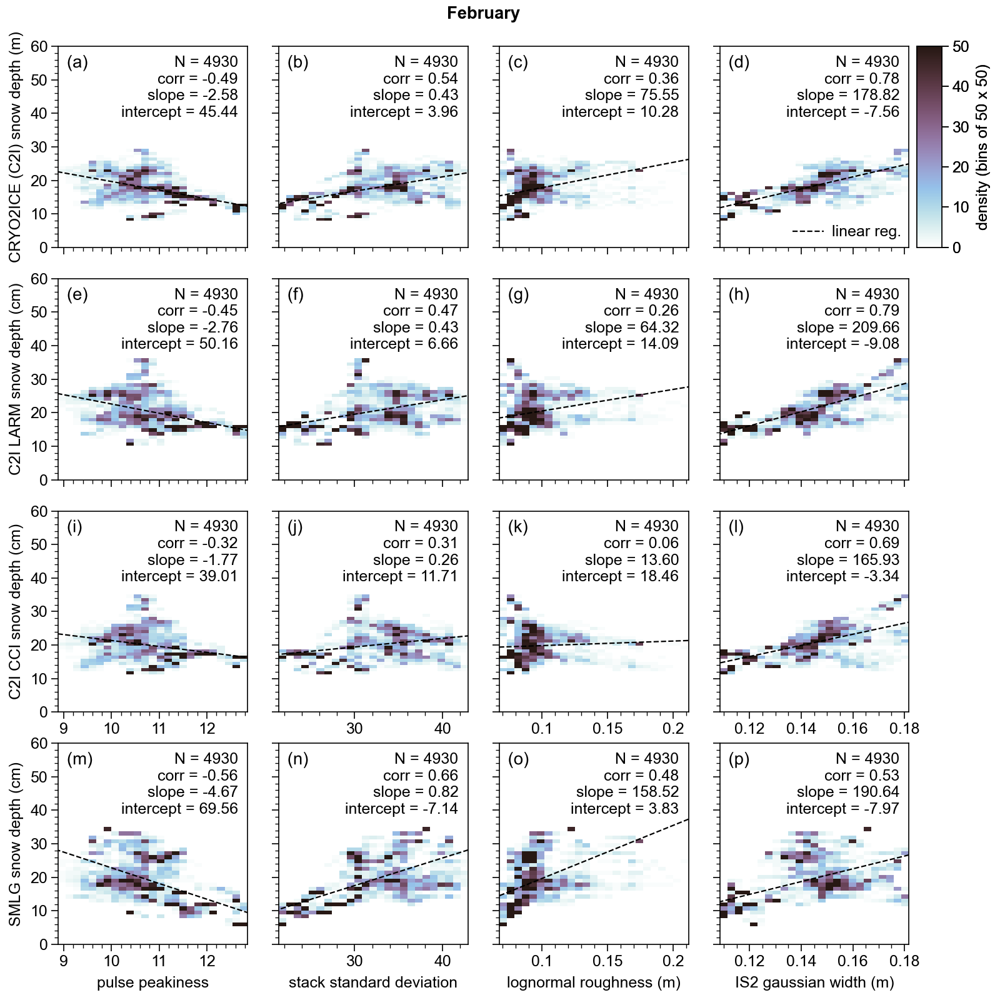

In [422]:
import proplot as pplt
fig = pplt.figure(space=2, figsize=(8,8), span=False, sharex=False, sharey=True)
ax = fig.subplots(nrows=4, ncols=4)
#fig, ax = plt.subplots(2, 3, figsize=(6,4), constrained_layout=True, sharey=True)

cmap_density = 'Glacial'
density = (25,25)

df = grid_all[(grid_all['SMLG_snow_depth'].notna())&(grid_all['snow_depth_original_MSS'].notna()) & (grid_all['snow_depth_original_MSS_LARM'].notna()) & grid_all['snow_depth_original_MSS_CCI'].notna()]
df['snow_depth_original_MSS_unit_cm']=df['snow_depth_original_MSS']*100
df['snow_depth_original_MSS_LARM_unit_cm']=df['snow_depth_original_MSS_LARM']*100
df['snow_depth_original_MSS_CCI_unit_cm']=df['snow_depth_original_MSS_CCI']*100
df['SMLG_snow_depth_unit_cm']=df['SMLG_snow_depth']*100

df = df[df['month']=='February']

## 1 ROW - PLOTTING
im=using_hist2d(ax[0,0], df['ppk'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,0].format(xlabel='', ylabel='CRYO2ICE (C2I) snow depth (m)',  xticklabels=[])

im=using_hist2d(ax[0,1], df['ssd'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,2], df['LARM_roughness'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,3], df['IS2_mean_gw'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,3].format(xlabel='', ylabel='',  xticklabels=[])

# ROW 2- PLOTTING
im=using_hist2d(ax[1,0], df['ppk'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,0].format(xlabel='', ylabel='C2I LARM snow depth (cm)',  xticklabels=[])

im=using_hist2d(ax[1,1], df['ssd'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,2], df['LARM_roughness'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,3], df['IS2_mean_gw'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,3].format(xlabel='', ylabel='',  xticklabels=[])

### ROW 3 - PLOTTING
im=using_hist2d(ax[2,0], df['ppk'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,0].format(xlabel='', ylabel='C2I CCI snow depth (cm)')

im=using_hist2d(ax[2,1], df['ssd'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,1].format(xlabel='', ylabel='')

im=using_hist2d(ax[2,2], df['LARM_roughness'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,2].format(xlabel='', ylabel='')

im=using_hist2d(ax[2,3], df['IS2_mean_gw'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,3].format(xlabel=')', ylabel='')

### ROW 4 - PLOTTING
im=using_hist2d(ax[3,0], df['ppk'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,0].format(xlabel='pulse peakiness', ylabel='SMLG snow depth (cm)')

im=using_hist2d(ax[3,1], df['ssd'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,1].format(xlabel='stack standard deviation', ylabel='')

im=using_hist2d(ax[3,2], df['LARM_roughness'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,2].format(xlabel='lognormal roughness (m)', ylabel='')

im=using_hist2d(ax[3,3], df['IS2_mean_gw'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,3].format(xlabel='IS2 gaussian width (m)', ylabel='')

## GENERAL FORMATTING
ax[0,3].colorbar(im[3], label='density (bins of 50 x 50)', loc='r')

ax.format(
    abc='(a)', abcloc='ul',rc_kw={'abc.weight':'normal'},ylim=(0,60)
)



## ROW 1 - TEXT
corr = df['snow_depth_original_MSS_unit_cm'].corr(df['ppk'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,0].text(0.95, 0.65, text_ax, transform=ax[0,0].transAxes, ha='right')

corr = df['snow_depth_original_MSS_unit_cm'].corr(df['ssd'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,1].text(0.95, 0.65, text_ax, transform=ax[0,1].transAxes, ha='right')

corr = df['snow_depth_original_MSS_unit_cm'].corr(df['LARM_roughness'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,2].text(0.95, 0.65, text_ax, transform=ax[0,2].transAxes, ha='right')

corr = df['snow_depth_original_MSS_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,3].text(0.95, 0.65, text_ax, transform=ax[0,3].transAxes, ha='right')

## ROW 2 - TEXT
corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['ppk'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,0].text(0.95, 0.65, text_ax, transform=ax[1,0].transAxes, ha='right')

corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['ssd'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,1].text(0.95, 0.65, text_ax, transform=ax[1,1].transAxes, ha='right')

corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['LARM_roughness'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,2].text(0.95, 0.65, text_ax, transform=ax[1,2].transAxes, ha='right')

corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,3].text(0.95, 0.65, text_ax, transform=ax[1,3].transAxes, ha='right')

## ROW 3 - TEXT
corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['ppk'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,0].text(0.95, 0.65, text_ax, transform=ax[2,0].transAxes, ha='right')

corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['ssd'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,1].text(0.95, 0.65, text_ax, transform=ax[2,1].transAxes, ha='right')

corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['LARM_roughness'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,2].text(0.95, 0.65, text_ax, transform=ax[2,2].transAxes, ha='right')

corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,3].text(0.95, 0.65, text_ax, transform=ax[2,3].transAxes, ha='right')

## ROW 4 - TEXT
corr = df['SMLG_snow_depth_unit_cm'].corr(df['ppk'])
y,x = df['SMLG_snow_depth_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,0].text(0.95, 0.65, text_ax, transform=ax[3,0].transAxes, ha='right')

corr = df['SMLG_snow_depth_unit_cm'].corr(df['ssd'])
y,x = df['SMLG_snow_depth_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,1].text(0.95, 0.65, text_ax, transform=ax[3,1].transAxes, ha='right')

corr = df['SMLG_snow_depth_unit_cm'].corr(df['LARM_roughness'])
y,x = df['SMLG_snow_depth_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,2].text(0.95, 0.65, text_ax, transform=ax[3,2].transAxes, ha='right')

corr = df['SMLG_snow_depth_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['SMLG_snow_depth_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,3].text(0.95, 0.65, text_ax, transform=ax[3,3].transAxes, ha='right')

# EXTRA LEGEND ITEMS
legend_elements = [Line2D([0], [0],color='k', label='linear reg.', linestyle='--', linewidth=0.8)]
ax[0,3].legend(handles=legend_elements, loc='lower right', fontsize=6,frameon=False)


plt.suptitle('February',x=0.1, y=.95, horizontalalignment='left', verticalalignment='top')
#plt.savefig('E:\demo_CRYO2ICE_barplot_combined.png', transparent=True)

plt.savefig('E:\demo_CRYO2ICE_overall_comp_statistics_rougness_proxies_snow_depth_gridded_february.png', dpi=300)


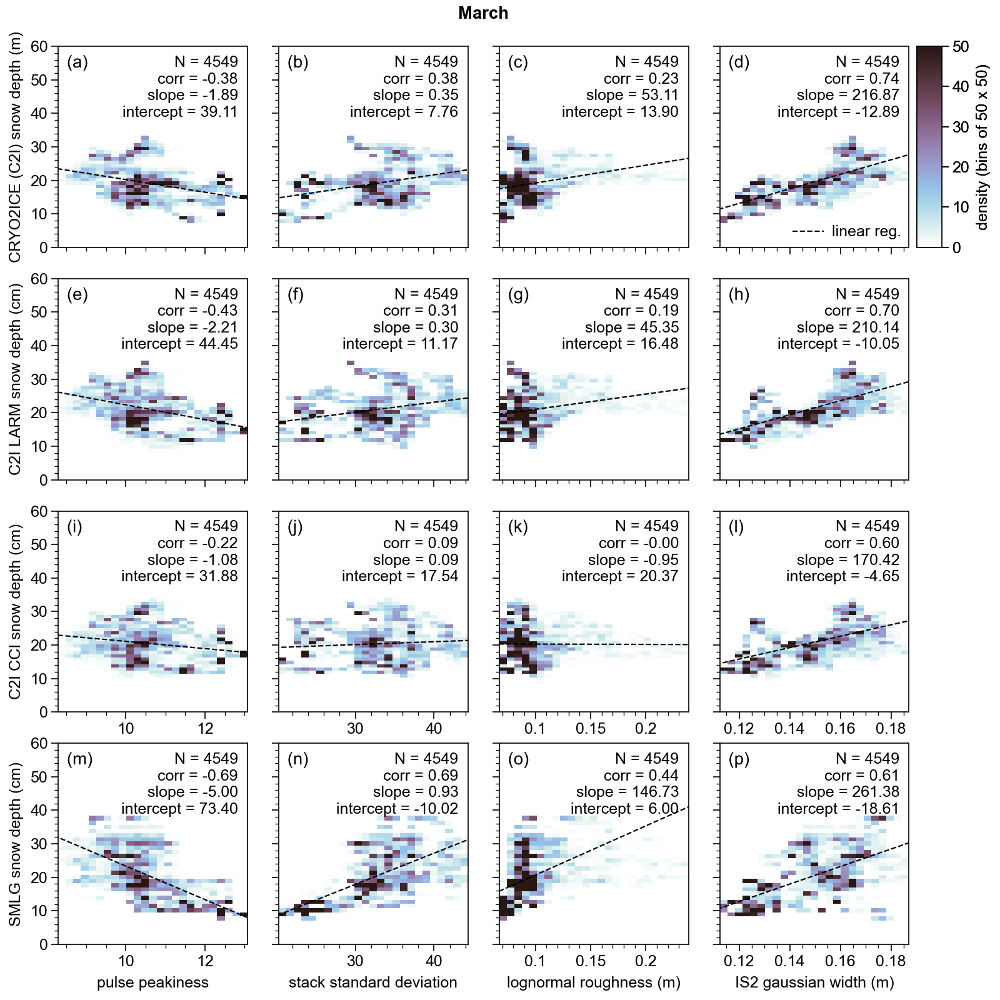

In [424]:
import proplot as pplt
fig = pplt.figure(space=2, figsize=(8,8), span=False, sharex=False, sharey=True)
ax = fig.subplots(nrows=4, ncols=4)
#fig, ax = plt.subplots(2, 3, figsize=(6,4), constrained_layout=True, sharey=True)

cmap_density = 'Glacial'
density = (25,25)

df = grid_all[(grid_all['SMLG_snow_depth'].notna())&(grid_all['snow_depth_original_MSS'].notna()) & (grid_all['snow_depth_original_MSS_LARM'].notna()) & grid_all['snow_depth_original_MSS_CCI'].notna()]
df['snow_depth_original_MSS_unit_cm']=df['snow_depth_original_MSS']*100
df['snow_depth_original_MSS_LARM_unit_cm']=df['snow_depth_original_MSS_LARM']*100
df['snow_depth_original_MSS_CCI_unit_cm']=df['snow_depth_original_MSS_CCI']*100
df['SMLG_snow_depth_unit_cm']=df['SMLG_snow_depth']*100

df = df[df['month']=='March']

## 1 ROW - PLOTTING
im=using_hist2d(ax[0,0], df['ppk'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,0].format(xlabel='', ylabel='CRYO2ICE (C2I) snow depth (m)',  xticklabels=[])

im=using_hist2d(ax[0,1], df['ssd'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,2], df['LARM_roughness'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,3], df['IS2_mean_gw'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,3].format(xlabel='', ylabel='',  xticklabels=[])

# ROW 2- PLOTTING
im=using_hist2d(ax[1,0], df['ppk'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,0].format(xlabel='', ylabel='C2I LARM snow depth (cm)',  xticklabels=[])

im=using_hist2d(ax[1,1], df['ssd'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,2], df['LARM_roughness'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,3], df['IS2_mean_gw'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,3].format(xlabel='', ylabel='',  xticklabels=[])

### ROW 3 - PLOTTING
im=using_hist2d(ax[2,0], df['ppk'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,0].format(xlabel='', ylabel='C2I CCI snow depth (cm)')

im=using_hist2d(ax[2,1], df['ssd'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,1].format(xlabel='', ylabel='')

im=using_hist2d(ax[2,2], df['LARM_roughness'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,2].format(xlabel='', ylabel='')

im=using_hist2d(ax[2,3], df['IS2_mean_gw'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,3].format(xlabel=')', ylabel='')

### ROW 4 - PLOTTING
im=using_hist2d(ax[3,0], df['ppk'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,0].format(xlabel='pulse peakiness', ylabel='SMLG snow depth (cm)')

im=using_hist2d(ax[3,1], df['ssd'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,1].format(xlabel='stack standard deviation', ylabel='')

im=using_hist2d(ax[3,2], df['LARM_roughness'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,2].format(xlabel='lognormal roughness (m)', ylabel='')

im=using_hist2d(ax[3,3], df['IS2_mean_gw'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,3].format(xlabel='IS2 gaussian width (m)', ylabel='')

## GENERAL FORMATTING
ax[0,3].colorbar(im[3], label='density (bins of 50 x 50)', loc='r')

ax.format(
    abc='(a)', abcloc='ul',rc_kw={'abc.weight':'normal'},ylim=(0,60)
)



## ROW 1 - TEXT
corr = df['snow_depth_original_MSS_unit_cm'].corr(df['ppk'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,0].text(0.95, 0.65, text_ax, transform=ax[0,0].transAxes, ha='right')

corr = df['snow_depth_original_MSS_unit_cm'].corr(df['ssd'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,1].text(0.95, 0.65, text_ax, transform=ax[0,1].transAxes, ha='right')

corr = df['snow_depth_original_MSS_unit_cm'].corr(df['LARM_roughness'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,2].text(0.95, 0.65, text_ax, transform=ax[0,2].transAxes, ha='right')

corr = df['snow_depth_original_MSS_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,3].text(0.95, 0.65, text_ax, transform=ax[0,3].transAxes, ha='right')

## ROW 2 - TEXT
corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['ppk'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,0].text(0.95, 0.65, text_ax, transform=ax[1,0].transAxes, ha='right')

corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['ssd'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,1].text(0.95, 0.65, text_ax, transform=ax[1,1].transAxes, ha='right')

corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['LARM_roughness'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,2].text(0.95, 0.65, text_ax, transform=ax[1,2].transAxes, ha='right')

corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,3].text(0.95, 0.65, text_ax, transform=ax[1,3].transAxes, ha='right')

## ROW 3 - TEXT
corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['ppk'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,0].text(0.95, 0.65, text_ax, transform=ax[2,0].transAxes, ha='right')

corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['ssd'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,1].text(0.95, 0.65, text_ax, transform=ax[2,1].transAxes, ha='right')

corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['LARM_roughness'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,2].text(0.95, 0.65, text_ax, transform=ax[2,2].transAxes, ha='right')

corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,3].text(0.95, 0.65, text_ax, transform=ax[2,3].transAxes, ha='right')

## ROW 4 - TEXT
corr = df['SMLG_snow_depth_unit_cm'].corr(df['ppk'])
y,x = df['SMLG_snow_depth_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,0].text(0.95, 0.65, text_ax, transform=ax[3,0].transAxes, ha='right')

corr = df['SMLG_snow_depth_unit_cm'].corr(df['ssd'])
y,x = df['SMLG_snow_depth_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,1].text(0.95, 0.65, text_ax, transform=ax[3,1].transAxes, ha='right')

corr = df['SMLG_snow_depth_unit_cm'].corr(df['LARM_roughness'])
y,x = df['SMLG_snow_depth_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,2].text(0.95, 0.65, text_ax, transform=ax[3,2].transAxes, ha='right')

corr = df['SMLG_snow_depth_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['SMLG_snow_depth_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,3].text(0.95, 0.65, text_ax, transform=ax[3,3].transAxes, ha='right')

# EXTRA LEGEND ITEMS
legend_elements = [Line2D([0], [0],color='k', label='linear reg.', linestyle='--', linewidth=0.8)]
ax[0,3].legend(handles=legend_elements, loc='lower right', fontsize=6,frameon=False)


plt.suptitle('March',x=0.1, y=.95, horizontalalignment='left', verticalalignment='top')
#plt.savefig('E:\demo_CRYO2ICE_barplot_combined.png', transparent=True)

plt.savefig('E:\demo_CRYO2ICE_overall_comp_statistics_rougness_proxies_snow_depth_gridded_march.png', dpi=300)


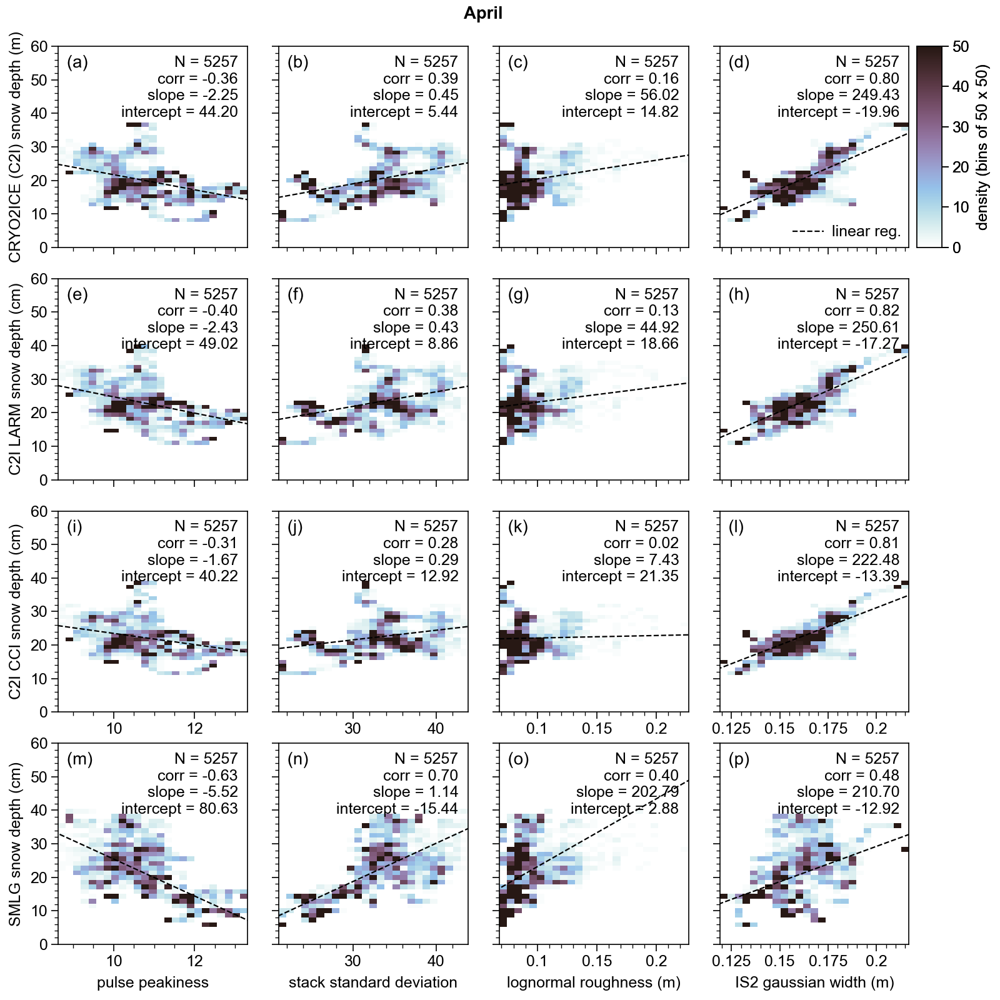

In [425]:
import proplot as pplt
fig = pplt.figure(space=2, figsize=(8,8), span=False, sharex=False, sharey=True)
ax = fig.subplots(nrows=4, ncols=4)
#fig, ax = plt.subplots(2, 3, figsize=(6,4), constrained_layout=True, sharey=True)

cmap_density = 'Glacial'
density = (25,25)

df = grid_all[(grid_all['SMLG_snow_depth'].notna())&(grid_all['snow_depth_original_MSS'].notna()) & (grid_all['snow_depth_original_MSS_LARM'].notna()) & grid_all['snow_depth_original_MSS_CCI'].notna()]
df['snow_depth_original_MSS_unit_cm']=df['snow_depth_original_MSS']*100
df['snow_depth_original_MSS_LARM_unit_cm']=df['snow_depth_original_MSS_LARM']*100
df['snow_depth_original_MSS_CCI_unit_cm']=df['snow_depth_original_MSS_CCI']*100
df['SMLG_snow_depth_unit_cm']=df['SMLG_snow_depth']*100

df = df[df['month']=='April']

## 1 ROW - PLOTTING
im=using_hist2d(ax[0,0], df['ppk'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,0].format(xlabel='', ylabel='CRYO2ICE (C2I) snow depth (m)',  xticklabels=[])

im=using_hist2d(ax[0,1], df['ssd'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,2], df['LARM_roughness'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[0,3], df['IS2_mean_gw'], df['snow_depth_original_MSS_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[0,3].format(xlabel='', ylabel='',  xticklabels=[])

# ROW 2- PLOTTING
im=using_hist2d(ax[1,0], df['ppk'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,0].format(xlabel='', ylabel='C2I LARM snow depth (cm)',  xticklabels=[])

im=using_hist2d(ax[1,1], df['ssd'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,1].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,2], df['LARM_roughness'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,2].format(xlabel='', ylabel='',  xticklabels=[])

im=using_hist2d(ax[1,3], df['IS2_mean_gw'], df['snow_depth_original_MSS_LARM_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[1,3].format(xlabel='', ylabel='',  xticklabels=[])

### ROW 3 - PLOTTING
im=using_hist2d(ax[2,0], df['ppk'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,0].format(xlabel='', ylabel='C2I CCI snow depth (cm)')

im=using_hist2d(ax[2,1], df['ssd'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,1].format(xlabel='', ylabel='')

im=using_hist2d(ax[2,2], df['LARM_roughness'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,2].format(xlabel='', ylabel='')

im=using_hist2d(ax[2,3], df['IS2_mean_gw'], df['snow_depth_original_MSS_CCI_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[2,3].format(xlabel=')', ylabel='')

### ROW 4 - PLOTTING
im=using_hist2d(ax[3,0], df['ppk'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,0].format(xlabel='pulse peakiness', ylabel='SMLG snow depth (cm)')

im=using_hist2d(ax[3,1], df['ssd'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,1].format(xlabel='stack standard deviation', ylabel='')

im=using_hist2d(ax[3,2], df['LARM_roughness'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,2].format(xlabel='lognormal roughness (m)', ylabel='')

im=using_hist2d(ax[3,3], df['IS2_mean_gw'], df['SMLG_snow_depth_unit_cm'], bins=density, cmap=cmap_density)
#plt.colorbar(im[3], label='density (bins of 80 x 80)',ax=ax[0], location='bottom')
ax[3,3].format(xlabel='IS2 gaussian width (m)', ylabel='')

## GENERAL FORMATTING
ax[0,3].colorbar(im[3], label='density (bins of 50 x 50)', loc='r')

ax.format(
    abc='(a)', abcloc='ul',rc_kw={'abc.weight':'normal'},ylim=(0,60)
)



## ROW 1 - TEXT
corr = df['snow_depth_original_MSS_unit_cm'].corr(df['ppk'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,0].text(0.95, 0.65, text_ax, transform=ax[0,0].transAxes, ha='right')

corr = df['snow_depth_original_MSS_unit_cm'].corr(df['ssd'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,1].text(0.95, 0.65, text_ax, transform=ax[0,1].transAxes, ha='right')

corr = df['snow_depth_original_MSS_unit_cm'].corr(df['LARM_roughness'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,2].text(0.95, 0.65, text_ax, transform=ax[0,2].transAxes, ha='right')

corr = df['snow_depth_original_MSS_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['snow_depth_original_MSS_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[0,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[0,3].text(0.95, 0.65, text_ax, transform=ax[0,3].transAxes, ha='right')

## ROW 2 - TEXT
corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['ppk'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,0].text(0.95, 0.65, text_ax, transform=ax[1,0].transAxes, ha='right')

corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['ssd'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,1].text(0.95, 0.65, text_ax, transform=ax[1,1].transAxes, ha='right')

corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['LARM_roughness'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,2].text(0.95, 0.65, text_ax, transform=ax[1,2].transAxes, ha='right')

corr = df['snow_depth_original_MSS_LARM_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['snow_depth_original_MSS_LARM_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[1,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[1,3].text(0.95, 0.65, text_ax, transform=ax[1,3].transAxes, ha='right')

## ROW 3 - TEXT
corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['ppk'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,0].text(0.95, 0.65, text_ax, transform=ax[2,0].transAxes, ha='right')

corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['ssd'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,1].text(0.95, 0.65, text_ax, transform=ax[2,1].transAxes, ha='right')

corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['LARM_roughness'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,2].text(0.95, 0.65, text_ax, transform=ax[2,2].transAxes, ha='right')

corr = df['snow_depth_original_MSS_CCI_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['snow_depth_original_MSS_CCI_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[2,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[2,3].text(0.95, 0.65, text_ax, transform=ax[2,3].transAxes, ha='right')

## ROW 4 - TEXT
corr = df['SMLG_snow_depth_unit_cm'].corr(df['ppk'])
y,x = df['SMLG_snow_depth_unit_cm'],df['ppk']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,20,2)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,0].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,0].text(0.95, 0.65, text_ax, transform=ax[3,0].transAxes, ha='right')

corr = df['SMLG_snow_depth_unit_cm'].corr(df['ssd'])
y,x = df['SMLG_snow_depth_unit_cm'],df['ssd']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,100,5)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,1].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,1].text(0.95, 0.65, text_ax, transform=ax[3,1].transAxes, ha='right')

corr = df['SMLG_snow_depth_unit_cm'].corr(df['LARM_roughness'])
y,x = df['SMLG_snow_depth_unit_cm'],df['LARM_roughness']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,2].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,2].text(0.95, 0.65, text_ax, transform=ax[3,2].transAxes, ha='right')

corr = df['SMLG_snow_depth_unit_cm'].corr(df['IS2_mean_gw'])
y,x = df['SMLG_snow_depth_unit_cm'],df['IS2_mean_gw']
coef = np.polyfit(x,y,1)
x_ppk = np.arange(0,2,0.1)
polyval_predict = np.polyval(coef,x_ppk)
ax[3,3].plot(x_ppk, polyval_predict, 'k', linewidth=0.8, linestyle='--')
text_ax = "N = {}\ncorr = {:.2f}\nslope = {:.2f}\nintercept = {:.2f}".format(len(df),corr, coef[0], coef[1])
ax[3,3].text(0.95, 0.65, text_ax, transform=ax[3,3].transAxes, ha='right')

# EXTRA LEGEND ITEMS
legend_elements = [Line2D([0], [0],color='k', label='linear reg.', linestyle='--', linewidth=0.8)]
ax[0,3].legend(handles=legend_elements, loc='lower right', fontsize=6,frameon=False)


plt.suptitle('April',x=0.1, y=.95, horizontalalignment='left', verticalalignment='top')
#plt.savefig('E:\demo_CRYO2ICE_barplot_combined.png', transparent=True)

plt.savefig('E:\demo_CRYO2ICE_overall_comp_statistics_rougness_proxies_snow_depth_gridded_april.png', dpi=300)


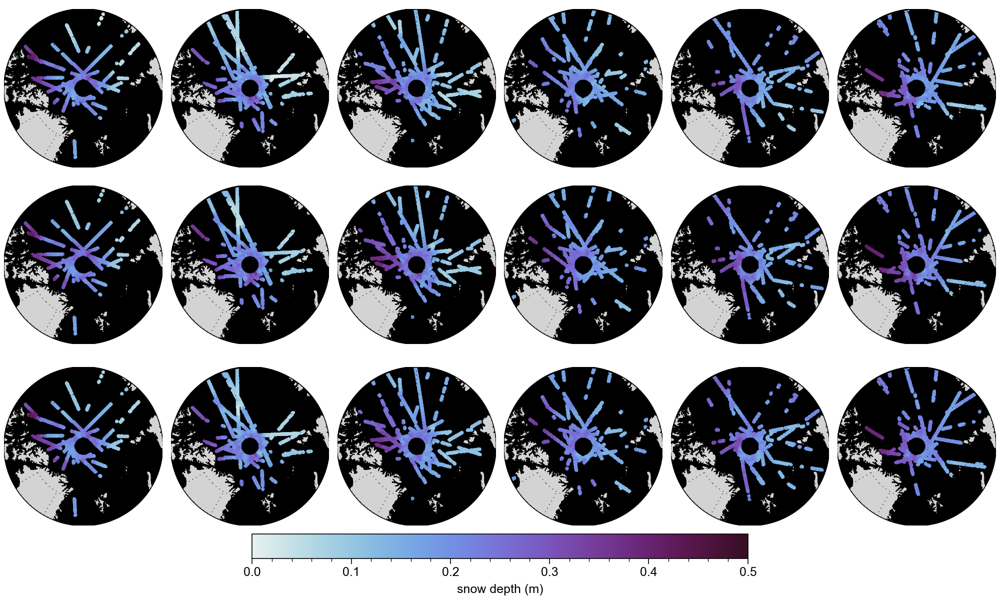

In [380]:
def plot_panArctic10(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90
    cmap1 = plt.get_cmap('greys', 4)

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=75,lon_0=0, resolution='i',ax=ax, round=True)
    m.drawmeridians(np.arange(0,360,30),labels=[0,0,0,0],linewidth=0.5, fontsize=10, dashes=[1,5])
    m.drawparallels(np.arange(-90,90,15),linewidth=0.5, fontsize=10, dashes=[1,5],labels=[0,0,0,0])
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='lightgray')
    #m.fillcontinents(color='darkgray')
    m.drawmapboundary(fill_color='black')
    #cbar = m.etopo()
    x=m.scatter(lon, lat, latlon=True, c=sit, s=0.5,vmin = min_set, vmax=max_set, cmap=cmap_set, zorder=1)
     #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x

from matplotlib.lines import Line2D
fig, ax = plt.subplots(ncols=6, nrows=3, figsize=(10,6), constrained_layout=True)
title = ''
#im = plot_panArctic8(lon, lat, missing_snow_depth, 0, 50, 'red', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, land_snow_depth, 0, 50, 'brown', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, OW_snow_depth, 0, 50, 'blue', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, MYI_snow_depth, 0, 50, 'grey', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, variability_snow_depth, 0, 50, 'magenta', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, melt_snow_depth, 0, 50, 'orange', 'radar freeboard (m)','max', ax,fig)

cmap = 'Dense'
im = plot_panArctic10(lon, lat, df_grid_nov['snow_depth_original_MSS'], 0, 0.5, cmap, 'radar freeboard (m)','max', ax[0, 0],fig)
im = plot_panArctic10(lon, lat, df_grid_nov['snow_depth_original_MSS_LARM'], 0, 0.5, cmap, 'radar freeboard (m)','max', ax[1, 0],fig)
im = plot_panArctic10(lon, lat, df_grid_nov['snow_depth_original_MSS_CCI'], 0, 0.5, cmap, 'radar freeboard (m)','max', ax[2, 0],fig)

im = plot_panArctic10(lon, lat, df_grid_dec['snow_depth_original_MSS'], 0, 0.5, cmap, 'radar freeboard (m)','max', ax[0, 1],fig)
im = plot_panArctic10(lon, lat, df_grid_dec['snow_depth_original_MSS_LARM'], 0, 0.5, cmap, 'radar freeboard (m)','max', ax[1, 1],fig)
im = plot_panArctic10(lon, lat, df_grid_dec['snow_depth_original_MSS_CCI'], 0, 0.5, cmap, 'radar freeboard (m)','max', ax[2, 1],fig)

im = plot_panArctic10(lon, lat, df_grid_jan['snow_depth_original_MSS'], 0, 0.5, cmap, 'radar freeboard (m)','max', ax[0, 2],fig)
im = plot_panArctic10(lon, lat, df_grid_jan['snow_depth_original_MSS_LARM'], 0, 0.5, cmap, 'radar freeboard (m)','max', ax[1, 2],fig)
im = plot_panArctic10(lon, lat, df_grid_jan['snow_depth_original_MSS_CCI'], 0, 0.5, cmap, 'radar freeboard (m)','max', ax[2, 2],fig)

im = plot_panArctic10(lon, lat, df_grid_feb['snow_depth_original_MSS'], 0, 0.5, cmap, 'radar freeboard (m)','max', ax[0, 3],fig)
im = plot_panArctic10(lon, lat, df_grid_feb['snow_depth_original_MSS_LARM'], 0, 0.5, cmap, 'radar freeboard (m)','max', ax[1, 3],fig)
im = plot_panArctic10(lon, lat, df_grid_feb['snow_depth_original_MSS_CCI'], 0, 0.5, cmap, 'radar freeboard (m)','max', ax[2, 3],fig)

im = plot_panArctic10(lon, lat, df_grid_mar['snow_depth_original_MSS'], 0, 0.5, cmap, 'radar freeboard (m)','max', ax[0, 4],fig)
im = plot_panArctic10(lon, lat, df_grid_mar['snow_depth_original_MSS_LARM'], 0, 0.5, cmap, 'radar freeboard (m)','max', ax[1, 4],fig)
im = plot_panArctic10(lon, lat, df_grid_mar['snow_depth_original_MSS_CCI'], 0, 0.5, cmap, 'radar freeboard (m)','max', ax[2, 4],fig)

im = plot_panArctic10(lon, lat, df_grid_apr['snow_depth_original_MSS'], 0, 0.5, cmap, 'radar freeboard (m)','max', ax[0, 5],fig)
im = plot_panArctic10(lon, lat, df_grid_apr['snow_depth_original_MSS_LARM'], 0, 0.5, cmap, 'radar freeboard (m)','max', ax[1, 5],fig)
im = plot_panArctic10(lon, lat, df_grid_apr['snow_depth_original_MSS_CCI'], 0, 0.5, cmap, 'radar freeboard (m)','max', ax[2, 5],fig)

#im = plot_panArctic6(lon, lat, grid_mean_snow_depth_original_MSS_LARM, 0, 0.5, cmap, 'radar freeboard (m)','max', ax[0, 1],fig)
#im = plot_panArctic6(lon, lat, grid_median_snow_depth_original_MSS, 0, 0.5, cmap, 'radar freeboard (m)','max', ax[1, 0],fig)
#im = plot_panArctic6(lon, lat, grid_median_snow_depth_original_MSS_LARM, 0, 0.5, cmap, 'radar freeboard (m)','max', ax[1, 1],fig)

plt.colorbar(im, ax=ax[2, :],orientation = 'horizontal', label='snow depth (m)', shrink=0.5)

plt.savefig('E:\CRYO2ICE_gridded_snow_depths_comparison.png', transparent=True)

In [312]:
lon

array([[168.33508 , 168.24945 , 168.16365 , ..., 102.52881 , 102.44166 ,
        102.35468 ],
       [168.39143 , 168.30573 , 168.21986 , ..., 102.47321 , 102.38599 ,
        102.29893 ],
       [168.44795 , 168.36218 , 168.27623 , ..., 102.41744 , 102.33014 ,
        102.243004],
       ...,
       [-80.85486 , -80.766304, -80.67754 , ..., -10.039622,  -9.94928 ,
         -9.859137],
       [-80.79103 , -80.70254 , -80.61385 , ..., -10.102758, -10.012488,
         -9.922417],
       [-80.7274  , -80.63898 , -80.550354, ..., -10.165695, -10.075498,
         -9.985498]], dtype=float32)

In [424]:
indices_NN_nov = CRYO2ICE_gridding_identify_grid_NN(CRYO2ICE_nov_LARM_SMLG_coincident,df_AMSR2)

In [426]:
np.max(indices_NN_nov)

339035

In [334]:
df_AMSR2['lon'][int(indices_NN_nov[0])]

160.61832

In [427]:
len(indices_NN_nov)

24566

In [476]:
def create_empty_vec(df_AMSR2):
    vec_zero =  np.empty((1, len(df_AMSR2)))
    vec_zero.fill(np.nan)
    
    return vec_zero
#np.full([1,len(df_AMSR2)], np.nan)

k = 0
CRYO2ICE_nov_LARM_SMLG_coincident_test = CRYO2ICE_nov_LARM_SMLG_coincident.reset_index()
list_CRYO2ICE, list_CRYO2ICE_LARM = [], []
for i in indices_NN_nov:
    vec_CRYO2ICE_test, vec_CRYO2ICE_LARM_test = create_empty_vec(df_AMSR2), create_empty_vec(df_AMSR2)
    if k == 0:
        vec_CRYO2ICE_test[0][int(i)] = CRYO2ICE_nov_LARM_SMLG_coincident_test['snow_depth_original_MSS'][k]
        vec_CRYO2ICE_LARM_test[0][int(i)] = CRYO2ICE_nov_LARM_SMLG_coincident_test['snow_depth_original_MSS_LARM'][k]
        k = k+1
        
        list_CRYO2ICE = np.append(list_CRYO2ICE, vec_CRYO2ICE_test)
        list_CRYO2ICE_LARM = np.append(list_CRYO2ICE_LARM, vec_CRYO2ICE_LARM_test)
        print(list_CRYO2ICE)
    else:
        vec_CRYO2ICE_test, vec_CRYO2ICE_LARM_test = create_empty_vec(df_AMSR2), create_empty_vec(df_AMSR2)
        
        vec_CRYO2ICE_test[0][int(i)] = CRYO2ICE_nov_LARM_SMLG_coincident_test['snow_depth_original_MSS'][k]
        vec_CRYO2ICE_LARM_test[0][int(i)] = CRYO2ICE_nov_LARM_SMLG_coincident_test['snow_depth_original_MSS_LARM'][k]
        
        list_CRYO2ICE =np.append(list_CRYO2ICE, vec_CRYO2ICE_test)
        list_CRYO2ICE_LARM = np.append(list_CRYO2ICE_LARM, vec_CRYO2ICE_LARM_test)
        print(list_CRYO2ICE)
        
        k=k+1  
    print(k)
    
    

vec_CRYO2ICE =np.concatenate(list_CRYO2ICE)
vec_CRYO2ICE_LARM= np.concatenate(list_CRYO2ICE_LARM)

    

[nan nan nan ... nan nan nan]
1
[nan nan nan ... nan nan nan]
2
[nan nan nan ... nan nan nan]
3
[nan nan nan ... nan nan nan]
4
[nan nan nan ... nan nan nan]
5
[nan nan nan ... nan nan nan]
6
[nan nan nan ... nan nan nan]
7
[nan nan nan ... nan nan nan]
8
[nan nan nan ... nan nan nan]
9
[nan nan nan ... nan nan nan]
10
[nan nan nan ... nan nan nan]
11
[nan nan nan ... nan nan nan]
12
[nan nan nan ... nan nan nan]
13
[nan nan nan ... nan nan nan]
14
[nan nan nan ... nan nan nan]
15
[nan nan nan ... nan nan nan]
16
[nan nan nan ... nan nan nan]
17
[nan nan nan ... nan nan nan]
18
[nan nan nan ... nan nan nan]
19
[nan nan nan ... nan nan nan]
20
[nan nan nan ... nan nan nan]
21
[nan nan nan ... nan nan nan]
22
[nan nan nan ... nan nan nan]
23
[nan nan nan ... nan nan nan]
24
[nan nan nan ... nan nan nan]
25
[nan nan nan ... nan nan nan]
26
[nan nan nan ... nan nan nan]
27
[nan nan nan ... nan nan nan]
28
[nan nan nan ... nan nan nan]
29
[nan nan nan ... nan nan nan]
30
[nan nan nan ... na

[nan nan nan ... nan nan nan]
246
[nan nan nan ... nan nan nan]
247
[nan nan nan ... nan nan nan]
248
[nan nan nan ... nan nan nan]
249
[nan nan nan ... nan nan nan]
250
[nan nan nan ... nan nan nan]
251
[nan nan nan ... nan nan nan]
252
[nan nan nan ... nan nan nan]
253
[nan nan nan ... nan nan nan]
254
[nan nan nan ... nan nan nan]
255
[nan nan nan ... nan nan nan]
256
[nan nan nan ... nan nan nan]
257
[nan nan nan ... nan nan nan]
258
[nan nan nan ... nan nan nan]
259
[nan nan nan ... nan nan nan]
260
[nan nan nan ... nan nan nan]
261
[nan nan nan ... nan nan nan]
262
[nan nan nan ... nan nan nan]
263
[nan nan nan ... nan nan nan]
264
[nan nan nan ... nan nan nan]
265
[nan nan nan ... nan nan nan]
266
[nan nan nan ... nan nan nan]
267
[nan nan nan ... nan nan nan]
268
[nan nan nan ... nan nan nan]
269
[nan nan nan ... nan nan nan]
270
[nan nan nan ... nan nan nan]
271
[nan nan nan ... nan nan nan]
272
[nan nan nan ... nan nan nan]
273
[nan nan nan ... nan nan nan]
274
[nan nan nan .

[nan nan nan ... nan nan nan]
487
[nan nan nan ... nan nan nan]
488
[nan nan nan ... nan nan nan]
489
[nan nan nan ... nan nan nan]
490
[nan nan nan ... nan nan nan]
491
[nan nan nan ... nan nan nan]
492
[nan nan nan ... nan nan nan]
493
[nan nan nan ... nan nan nan]
494
[nan nan nan ... nan nan nan]
495
[nan nan nan ... nan nan nan]
496
[nan nan nan ... nan nan nan]
497
[nan nan nan ... nan nan nan]
498
[nan nan nan ... nan nan nan]
499
[nan nan nan ... nan nan nan]
500
[nan nan nan ... nan nan nan]
501
[nan nan nan ... nan nan nan]
502
[nan nan nan ... nan nan nan]
503
[nan nan nan ... nan nan nan]
504
[nan nan nan ... nan nan nan]
505
[nan nan nan ... nan nan nan]
506
[nan nan nan ... nan nan nan]
507
[nan nan nan ... nan nan nan]
508
[nan nan nan ... nan nan nan]
509
[nan nan nan ... nan nan nan]
510
[nan nan nan ... nan nan nan]
511
[nan nan nan ... nan nan nan]
512
[nan nan nan ... nan nan nan]
513
[nan nan nan ... nan nan nan]
514
[nan nan nan ... nan nan nan]
515
[nan nan nan .

[nan nan nan ... nan nan nan]
728
[nan nan nan ... nan nan nan]
729
[nan nan nan ... nan nan nan]
730
[nan nan nan ... nan nan nan]
731
[nan nan nan ... nan nan nan]
732
[nan nan nan ... nan nan nan]
733
[nan nan nan ... nan nan nan]
734
[nan nan nan ... nan nan nan]
735
[nan nan nan ... nan nan nan]
736
[nan nan nan ... nan nan nan]
737
[nan nan nan ... nan nan nan]
738
[nan nan nan ... nan nan nan]
739
[nan nan nan ... nan nan nan]
740
[nan nan nan ... nan nan nan]
741
[nan nan nan ... nan nan nan]
742
[nan nan nan ... nan nan nan]
743
[nan nan nan ... nan nan nan]
744
[nan nan nan ... nan nan nan]
745
[nan nan nan ... nan nan nan]
746
[nan nan nan ... nan nan nan]
747
[nan nan nan ... nan nan nan]
748
[nan nan nan ... nan nan nan]
749
[nan nan nan ... nan nan nan]
750
[nan nan nan ... nan nan nan]
751
[nan nan nan ... nan nan nan]
752
[nan nan nan ... nan nan nan]
753
[nan nan nan ... nan nan nan]
754
[nan nan nan ... nan nan nan]
755
[nan nan nan ... nan nan nan]
756
[nan nan nan .

KeyboardInterrupt: 

In [454]:
vec_CRYO2ICE =np.vstack((vec_CRYO2ICE, vec_CRYO2ICE_test)) 
len(vec_CRYO2ICE)

6

In [405]:
CRYO2ICE_nov_LARM_SMLG_coincident.reset_index()

,level_0,Unnamed: 0,Unnamed: 0.1,index,lat,lon,fb,mss,fb_no_mss,ssd,...,CS2_LARM_fb_smoothed,ID,snow_depth_original_MSS_smoothed,snow_depth_original_MSS_LARM_smoothed,month,snow_depth_original_MSS_unit_cm,snow_depth_original_MSS_LARM_unit_cm,SMLG_snow_depth_unit_cm,snow_depth_original_MSS_smoothed_unit_cm,snow_depth_original_MSS_LARM_smoothed_unit_cm
0,0,0,97,97,81.12026,-102.62712,0.319,6.726,-6.407,44.04,...,NaN,0,0.651692,NaN,November,31.970403,30.087048,15.910046,65.169159,NaN
1,2,2,99,99,81.12554,-102.63546,-0.041,6.726,-6.767,30.74,...,NaN,0,0.335377,NaN,November,58.991731,55.594650,21.642907,33.537707,NaN
2,3,3,100,100,81.13610,-102.65215,0.316,6.726,-6.410,46.54,...,NaN,0,0.417619,NaN,November,18.108448,23.906487,21.642907,41.761945,NaN
3,4,4,101,101,81.13874,-102.65633,0.262,6.726,-6.464,46.18,...,NaN,0,0.377309,NaN,November,25.003912,26.357264,21.642907,37.730924,NaN
4,10,10,107,107,81.15457,-102.68146,0.040,6.857,-6.817,41.30,...,NaN,0,0.441852,NaN,November,48.871470,46.616803,21.642907,44.185168,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24561,44360,267,1043,1043,87.96033,-6.60651,0.123,16.977,-16.854,44.50,...,NaN,33,0.349152,NaN,November,31.264825,27.776049,9.904400,34.915208,NaN
24562,44363,270,1046,1046,87.95659,-7.13300,0.080,16.977,-16.897,28.62,...,NaN,33,0.415568,NaN,November,36.722543,41.001187,9.904400,41.556834,NaN
24563,44364,271,1047,1047,87.95604,-7.20806,0.034,16.977,-16.943,32.53,...,NaN,33,0.347304,NaN,November,42.647743,51.763138,9.904400,34.730358,NaN
24564,44365,272,1048,1048,87.95549,-7.28307,0.217,16.977,-16.760,40.39,...,NaN,33,0.252504,NaN,November,20.514774,29.376373,9.904400,25.250407,NaN


In [421]:
vec_zero = create_empty_vec(df_AMSR2)
len(vec_zero[0][:])

544768

In [388]:
np.empty((1, len(df_AMSR2))).fill(np.nan)

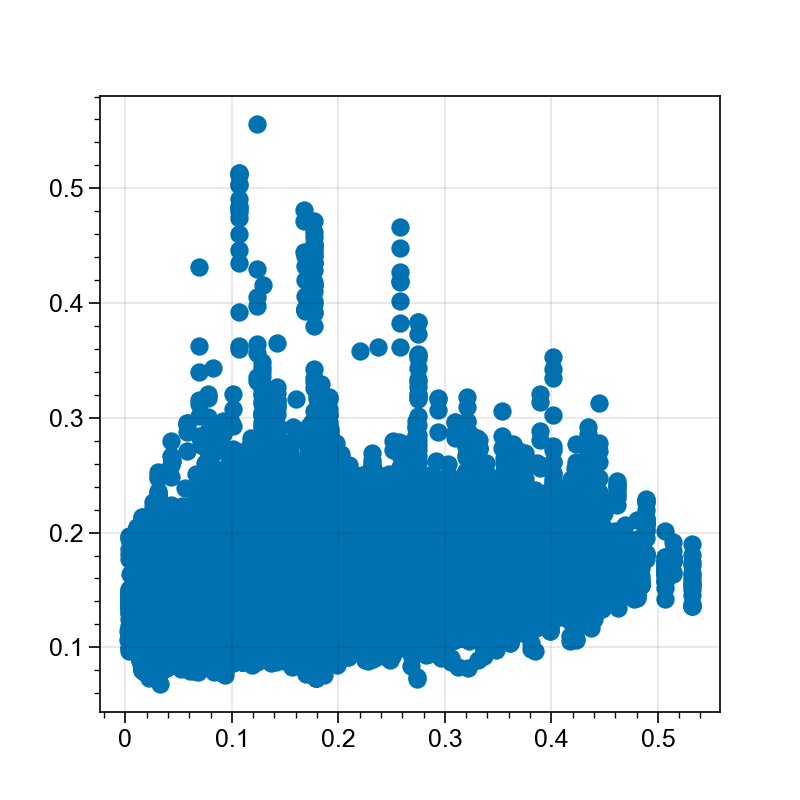

In [458]:
plt.scatter(CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS'], CRYO2ICE_LARM_SMLG_coinident['IS2_mean_gw'])


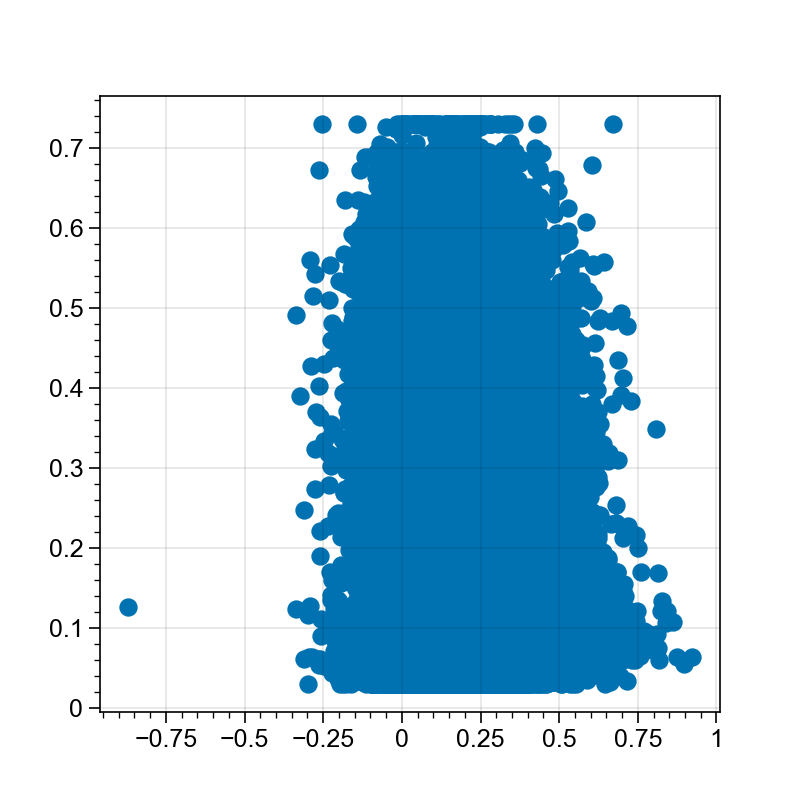

In [460]:
plt.scatter(CRYO2ICE_LARM_SMLG_coinident['snow_depth_original_MSS'], CRYO2ICE_LARM_SMLG_coinident['LARM_roughness'])

In [ ]:
fig, ax = plt.subplots(1,1, figsize=(3,4),constrained_layout=True)
colours = [cmap_qual(0)[0:3],cmap_qual(1)[0:3],cmap_qual(2)[0:3]]
bbox2 = ax.boxplot([CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['snow_depth_original_MSS_LARM_unit_cm'], CRYO2ICE_nov_LARM_SMLG_coincident['SMLG_snow_depth_unit_cm']], showfliers=False, patch_artist=True)
for patch, color, medians in zip(bbox2['boxes'], colours, bbox2['medians']):
    patch.set_facecolor(color)
    medians.set_color('black')

ax.set_xticklabels(['CRYO2ICE', 'CRYO2ICE LARM', 'SMLG'], rotation=45, ha='right', rotation_mode='anchor')
ax.text(0.05, 0.95, 'November',transform = ax.transAxes,weight='bold')
ax.set_title('LARM and SMLG coincident: n = {}'.format(len(CRYO2ICE_nov_LARM_SMLG_coincident)))

In [290]:
colours

[(0.0, 0.5607843137254902, 0.8352941176470589)]

In [30]:
[np.mean(CRYO2ICE_nov['IS2_w_fb_DTU21MSS']), np.mean(CRYO2ICE_dec['IS2_w_fb_DTU21MSS']), np.mean(CRYO2ICE_jan['IS2_w_fb_DTU21MSS']), np.mean(CRYO2ICE_feb['IS2_w_fb_DTU21MSS'])]

[0.3234396466359138,
 0.30879728014172586,
 0.3163971049931643,
 0.31270773218441555]

In [31]:
[np.mean(CRYO2ICE_nov['CS2_fb_DTU21MSS']), np.mean(CRYO2ICE_dec['CS2_fb_DTU21MSS']), np.mean(CRYO2ICE_jan['CS2_fb_DTU21MSS']), np.mean(CRYO2ICE_feb['CS2_fb_DTU21MSS'])]

[0.18060837530345866,
 0.20115358721087803,
 0.19203575272012643,
 0.1875908979885234]

(0.0, 3500.0)

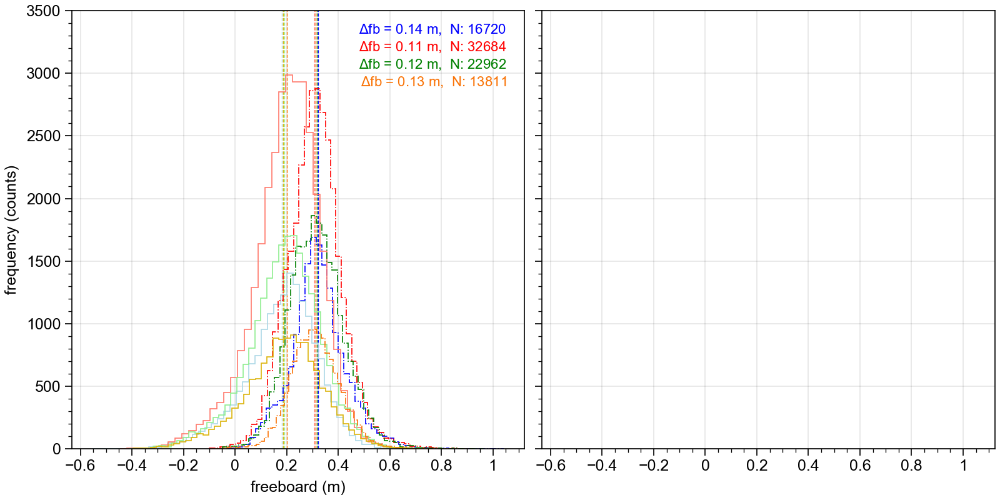

In [84]:
fig,ax = plt.subplots(nrows=1, ncols=2,figsize=(8,4),constrained_layout=True, sharex=True, sharey=True)
n=0
N = len(CRYO2ICE_nov)
y, x, _ = ax[n].hist(CRYO2ICE_nov['IS2_w_fb_DTU21MSS'], bins=50,histtype='step', label='IS2 (laser fb)', ls='-.', color='blue')
max_counts = y.max()*1.25
ax[n].hist(CRYO2ICE_nov['CS2_fb_DTU21MSS'], histtype='step',bins=50, label='CS2 (radar fb)', color='lightblue')
ax[n].vlines(np.mean(CRYO2ICE_nov['CS2_fb_DTU21MSS']), 0,5000, ls='--', color='lightblue', linewidth=0.5, label='_nolegend_')
ax[n].vlines(np.mean(CRYO2ICE_nov['IS2_w_fb_DTU21MSS']), 0,5000, ls='--', color='blue', linewidth=0.5, label='_nolegend_')
ax[n].set_ylim([0,max_counts])
m = np.mean(CRYO2ICE_nov['IS2_w_fb_DTU21MSS'])-np.mean(CRYO2ICE_nov['CS2_fb_DTU21MSS'])
text_mean = r'$\Delta$fb = {0:.2f} m,  N: {1}'.format(m, N)
ax[n].text(0.96,0.94,text_mean,horizontalalignment='right', verticalalignment='bottom',transform = ax[n].transAxes,fontsize=8, color='blue')
#ax[n].legend(loc='upper left')
ax[n].set_xlabel('freeboard (m)')
ax[n].set_ylabel('frequency (counts)')

N = len(CRYO2ICE_dec)
y, x, _ = ax[n].hist(CRYO2ICE_dec['IS2_w_fb_DTU21MSS'], histtype='step', bins=50,label='IS2 (laser fb)', ls='-.', color='red')
max_counts = y.max()*1.25
ax[n].hist(CRYO2ICE_dec['CS2_fb_DTU21MSS'], histtype='step', bins=50,label='CS2 (radar fb)', color='salmon')
ax[n].vlines(np.mean(CRYO2ICE_dec['CS2_fb_DTU21MSS']), 0,5000, ls='--', color='orange', linewidth=0.5, label='_nolegend_')
ax[n].vlines(np.mean(CRYO2ICE_dec['IS2_w_fb_DTU21MSS']), 0,5000, ls='--', color='salmon', linewidth=0.5, label='_nolegend_')
ax[n].set_ylim([0,max_counts])
m = np.mean(CRYO2ICE_dec['IS2_w_fb_DTU21MSS'])-np.mean(CRYO2ICE_dec['CS2_fb_DTU21MSS'])
text_mean = r'$\Delta$fb = {0:.2f} m,  N: {1}'.format(m, N)
ax[n].text(0.96,0.90,text_mean,horizontalalignment='right', verticalalignment='bottom',transform = ax[n].transAxes,fontsize=8, color='red')
#ax[n].legend(loc='upper left')
ax[n].set_xlabel('freeboard (m)')
ax[n].set_ylabel('frequency (counts)')

N = len(CRYO2ICE_jan)
y, x, _ = ax[n].hist(CRYO2ICE_jan['IS2_w_fb_DTU21MSS'], histtype='step', bins=50,label='IS2 (laser fb)', ls='-.', color='green')
max_counts = y.max()*1.25
ax[n].hist(CRYO2ICE_jan['CS2_fb_DTU21MSS'], histtype='step', bins=50,label='CS2 (radar fb)', color='lightgreen')
ax[n].vlines(np.mean(CRYO2ICE_jan['CS2_fb_DTU21MSS']), 0,5000, ls='--', color='lightgreen', linewidth=0.5, label='_nolegend_')
ax[n].vlines(np.mean(CRYO2ICE_jan['IS2_w_fb_DTU21MSS']), 0,5000, ls='--', color='green', linewidth=0.5, label='_nolegend_')
ax[n].set_ylim([0,max_counts])
m = np.mean(CRYO2ICE_jan['IS2_w_fb_DTU21MSS'])-np.mean(CRYO2ICE_jan['CS2_fb_DTU21MSS'])
text_mean = r'$\Delta$fb = {0:.2f} m,  N: {1}'.format(m, N)
ax[n].text(0.96,0.86,text_mean,horizontalalignment='right', verticalalignment='bottom',transform = ax[n].transAxes,fontsize=8, color='green')
#ax[n].legend(loc='upper left')
ax[n].set_xlabel('freeboard (m)')
ax[n].set_ylabel('frequency (counts)')

N = len(CRYO2ICE_feb)
y, x, _ = ax[n].hist(CRYO2ICE_feb['IS2_w_fb_DTU21MSS'], histtype='step', bins=50,label='IS2 (laser fb)', ls='-.', color='orange')
max_counts = y.max()*1.25
ax[n].hist(CRYO2ICE_feb['CS2_fb_DTU21MSS'], histtype='step', bins=50,label='CS2 (radar fb)', color='gold')
ax[n].vlines(np.mean(CRYO2ICE_feb['CS2_fb_DTU21MSS']), 0,5000, ls='--', color='gold', linewidth=0.5, label='_nolegend_')
ax[n].vlines(np.mean(CRYO2ICE_feb['IS2_w_fb_DTU21MSS']), 0,5000, ls='--', color='orange', linewidth=0.5, label='_nolegend_')
ax[n].set_ylim([0,max_counts])
m = np.mean(CRYO2ICE_feb['IS2_w_fb_DTU21MSS'])-np.mean(CRYO2ICE_feb['CS2_fb_DTU21MSS'])
text_mean = r'$\Delta$fb = {0:.2f} m,  N: {1}'.format(m, N)
ax[n].text(0.96,0.82,text_mean,horizontalalignment='right', verticalalignment='bottom',transform = ax[n].transAxes,fontsize=8, color='orange')
#ax[n].legend(loc='upper left')
ax[n].set_xlabel('freeboard (m)')
ax[n].set_ylabel('frequency (counts)')

ax[n].set_ylim(0,3500)



In [559]:
df3

,Unnamed: 0,index,lat,lon,fb,mss,fb_no_mss,ssd,ppk,IS2_mean_fb,IS2_w_mean_fb,IS2_mean_gw,IS2_mean_MSS,MSS_DTU21,snow_depth_DTU21MSS,CS2_fb_DTU21MSS,IS2_fb_DTU21MSS,IS2_w_fb_DTU21MSS
0,0,0,83.864174,-63.222596,0.304,20.705,-20.401,38.60,8.444045,-21.090385,-21.086557,0.189343,21.533983,21.535,0.030356,0.420,0.444615,0.448442
1,1,1,83.866734,-63.231089,0.335,20.705,-20.370,44.63,5.842980,-21.115220,-21.095448,0.171515,21.525171,21.521,-0.038502,0.437,0.405780,0.425552
2,2,2,83.869294,-63.239589,0.284,20.705,-20.421,44.26,6.861725,-21.099749,-21.085574,0.169356,21.515912,21.521,0.043473,0.386,0.421251,0.435426
3,3,3,83.871854,-63.248097,0.126,20.705,-20.579,45.45,7.306298,-21.069651,-21.076430,0.168657,21.506866,21.521,0.275442,0.228,0.451349,0.444570
4,4,4,83.874413,-63.256611,0.286,20.705,-20.419,43.65,5.559673,-21.054134,-21.086160,0.168942,21.497671,21.521,0.097260,0.388,0.466865,0.434840
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1485,2147,2147,77.619604,143.729910,0.001,1.482,-1.481,23.61,12.729966,-2.177901,-2.177371,0.080005,2.254366,2.307,0.021087,0.112,0.129099,0.129629
1486,2148,2148,76.516996,142.870864,0.173,0.877,-0.704,33.43,8.310737,-1.552997,-1.556328,0.088260,1.620613,1.613,-0.166483,0.195,0.060003,0.056672
1487,2149,2149,76.514317,142.868932,0.113,0.877,-0.764,23.52,12.152392,-1.545628,-1.548171,0.086326,1.616544,1.613,-0.083401,0.135,0.067372,0.064829
1488,2150,2150,76.498243,142.857354,0.150,0.877,-0.727,21.41,14.574363,-1.509180,-1.508925,0.079681,1.596564,1.613,-0.084082,0.172,0.103820,0.104075


In [32]:
df3_short = df3[500:1350]
print(len(df3_short))
print(len(df3_short[(df3_short['ppk']<9) & (df3_short['ssd']>6.29)]))
print(np.mean(df3_short['snow_depth_DTU21MSS']))
print(np.mean(df3_short[(df3_short['ppk']<9) & (df3_short['ssd']>6.29)]['snow_depth_DTU21MSS']))
print(np.std(df3_short['snow_depth_DTU21MSS']))
print(np.std(df3_short[(df3_short['ppk']<9) & (df3_short['ssd']>6.29)]['snow_depth_DTU21MSS']))

NameError: name 'df3' is not defined

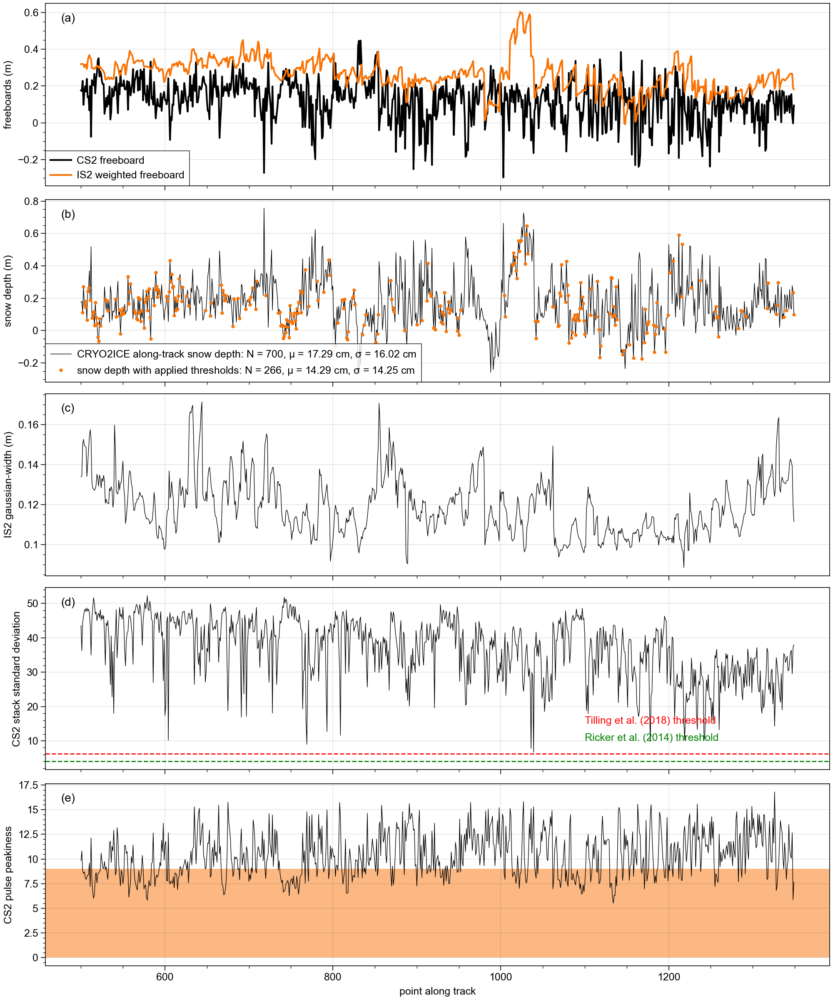

In [561]:
fig, axs = plt.subplots(5, figsize=(10,12), constrained_layout=True, sharex=True)
#axs[0].plot(df_IS2_new['lat'], df_IS2_new['fb'], c='grey', ls='', marker='.', markersize=0.8)
axs[0].plot(df3_short['CS2_fb_DTU21MSS'] , c='k', ls='-')
axs[0].plot(df3_short['IS2_w_fb_DTU21MSS'], c='orange', ls='-')

axs[1].plot(df3_short['snow_depth_DTU21MSS'] , c='k',ls='-', linewidth=0.5)
axs[1].plot(df3_short[(df3_short['ppk']<9) & (df3_short['ssd']>6.29)]['snow_depth_DTU21MSS'] , 'o', c='orange', markersize=2)

axs[2].plot(df3_short['IS2_mean_gw'], c='k',ls='-', linewidth=0.5)

axs[3].plot(df3_short['ssd'], c='k',ls='-', linewidth=0.5)
axs[3].axhline(y=4, c='green',ls='--', linewidth=1)
axs[3].axhline(y=6.29, c='r',ls='--', linewidth=1)
axs[3].text(1100, 15, 'Tilling et al. (2018) threshold', color='r')
axs[3].text(1100, 10, 'Ricker et al. (2014) threshold', color='green')

axs[4].plot(df3_short['ppk'], c='k',ls='-', linewidth=0.5)
axs[4].axhspan(0,9, facecolor='orange', alpha=0.5)
#axs[0].set_ylim([-0.3, 1.5])
#axs[0].set_xlim([float(data_check['lat'].head(1)), float(data_check['lat'].tail(1))])

axs[0].set_ylabel('freeboards (m)')
axs[1].set_ylabel('snow depth (m)')
axs[2].set_ylabel('IS2 gaussian-width (m)')
axs[3].set_ylabel('CS2 stack standard deviation')
axs[4].set_ylabel('CS2 pulse peakiness')

legend=axs[0].legend(['CS2 freeboard', 'IS2 weighted freeboard'], loc='lower left', scatterpoints=3)
legend.legendHandles[0]._legmarker.set_markersize(5)
legend.legendHandles[1]._legmarker.set_markersize(5)
plt.xlabel('point along track')
#axs[0].set_xlim([77, 78])

legend=axs[1].legend([r'CRYO2ICE along-track snow depth: N = 850, $\mu$ = 17.41 cm, $\sigma$ = 15.60 cm', r'snow depth with applied thresholds: N = 291, $\mu$ = 14.77 cm, $\sigma$ = 14.42 cm'], loc='lower left', scatterpoints=3)


axs[0].text(0.02, 0.9, '(a)', transform = axs[0].transAxes, fontsize=10)
axs[1].text(0.02, 0.9, '(b)', transform = axs[1].transAxes, fontsize=10)
axs[2].text(0.02, 0.9, '(c)', transform = axs[2].transAxes, fontsize=10)
axs[3].text(0.02, 0.9, '(d)', transform = axs[3].transAxes, fontsize=10)
axs[4].text(0.02, 0.9, '(e)', transform = axs[4].transAxes, fontsize=10)
plt.savefig('E:\demo_CRYO2ICE_roughness.png', transparent=True)

In [47]:
def plot_panArctic6(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90
    cmap1 = plt.get_cmap('greys', 4)

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=75,lon_0=0, resolution='i',ax=ax, round=True)
    m.drawmeridians(np.arange(0,360,30),labels=[0,0,0,0],linewidth=0.5, fontsize=10, dashes=[1,5])
    m.drawparallels(np.arange(-90,90,15),linewidth=0.5, fontsize=10, dashes=[1,5],labels=[0,0,0,0])
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='lightgray')
    #m.fillcontinents(color='darkgray')
    m.drawmapboundary(fill_color='black')
    #cbar = m.etopo()
    x=m.scatter(lon, lat, latlon=True, c=sit, s=5,vmin = min_set, vmax=max_set, cmap=cmap_set, zorder=1)
     #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x

def plot_panArctic7(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90
    cmap1 = plt.get_cmap('greys', 4)

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=75,lon_0=0, resolution='i',ax=ax, round=True)
    m.drawmeridians(np.arange(0,360,30),labels=[0,0,0,0],linewidth=0.5, fontsize=10, dashes=[1,5])
    m.drawparallels(np.arange(-90,90,15),linewidth=0.5, fontsize=10, dashes=[1,5],labels=[0,0,0,0])
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='lightgray')
    #m.fillcontinents(color='darkgray')
    m.drawmapboundary(fill_color='black')
    #cbar = m.etopo()
    x=m.scatter(lon, lat, latlon=True, c=sit, s=50,vmin = min_set, vmax=max_set, cmap=cmap_set, zorder=1, marker='X')
     #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x

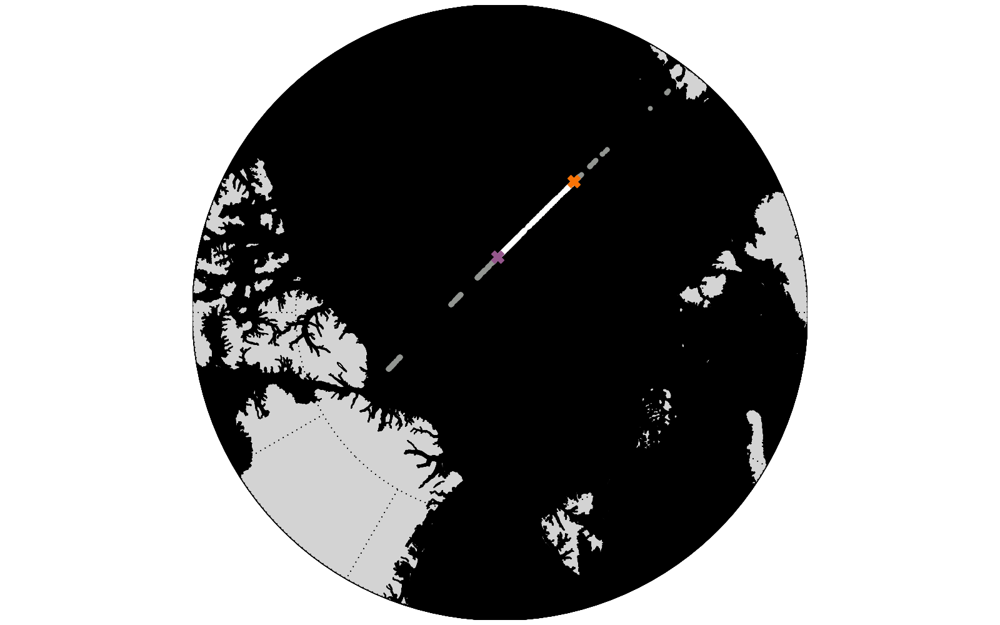

In [562]:
from matplotlib.lines import Line2D
fig, ax = plt.subplots(figsize=(8,5), constrained_layout=True)
title = ''
im = plot_panArctic6(np.array(df3['lon']), np.array(df3['lat']), 'grey', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic6(np.array(df3['lon'][500:1350]), np.array(df3['lat'][500:1350]), 'white', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic7(np.array(df3['lon'][500]), np.array(df3['lat'][500]), 'purple', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic7(np.array(df3['lon'][1350]), np.array(df3['lat'][1350]), 'orange', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)

plt.savefig('E:\demo_CRYO2ICE_roughness_location.png', transparent=True)

In [420]:
def read_data_snow_depth_AMSR2(fname, bbox=None):
    '''
    Read ATL03 data file and output 6 reduced files. 
    
    Extract variables of interest and separate the ATL03 file
    into each beam (ground track) and ascending/descending orbits. 
    '''

    with h5py.File(fname, 'r') as fi:
        #sc = fi['/orbit_info/sc_orient'][:]

        #if sc == 1:
        #    g = ['/gt3r', '/gt3l', '/gtl2r', '/gt2l', '/gt1r', '/gt1l']   

        lon = fi['HDFEOS/GRIDS/NpPolarGrid12km/lon'][:]
        lat = fi['/HDFEOS/GRIDS/NpPolarGrid12km/lat'][:]
        snow_depth = fi['/HDFEOS/GRIDS/NpPolarGrid12km/Data_Fields/SI_12km_NH_SNOWDEPTH_5DAY'][:]
        sea_ice_concentration = fi['/HDFEOS/GRIDS/NpPolarGrid12km/Data_Fields/SI_12km_NH_ICECON_DAY'][:]
        
    #---------------------------------------------#
    # 2) Filter data according region and quality #
    #---------------------------------------------#

    # Test for no data
    #if len(lat_fb) == 0: continue

    #-------------------------------------#
    # 3) Convert time and separate tracks #
    #-------------------------------------#

    # Time in GPS seconds (secs since 1980...)
    #t_gps, delta_t_gps = t_ref + t_dt, t_ref + delta_t

    # Time in decimal years
    #t_year, delta_t_year = gps2dyr(t_gps), gps2dyr(delta_t_gps)

    # Determine orbit type
    #i_asc, i_des = track_type(t_year, lat)

    #-----------------------#
    # 4) Save selected data #
    #-----------------------#

    # Define output file name
    ofile = fname.replace('.h5', '_snow_depth_SIC.h5')

    # Save variables
    with h5py.File(ofile, 'w') as f:
        f['lon'] = lon
        f['lat'] = lat
        f['snow_depth'] = snow_depth
        f['sea_ice_concentration'] = sea_ice_concentration


        print('out ->', ofile)


In [423]:
files = !ls E:/DTU/CRYO2ICE/Data/AMSR2/*.he5
files

['E:/DTU/CRYO2ICE/Data/AMSR2/AMSR_U2_L3_SeaIce12km_B04_20201110.he5']

In [422]:

njobs = 1

# bbox = [lonmin, lonmax, latmin, latmax]
bbox = [0,360, 60, 90]

if njobs == 1:
    print('running in serial ...')
    [read_data_snow_depth_AMSR2(f, bbox) for f in files]

else:
    print('running in parallel (%d jobs) ...' % njobs)
    from joblib import Parallel, delayed
    Parallel(n_jobs=njobs, verbose=5)(delayed(read_data_snow_depth_AMSR2)(f, bbox) for f in files)

running in serial ...


KeyError: 'Unable to open object (component not found)'

In [729]:
fname = 'E:/DTU/CRYO2ICE/Data/AMSR2/AMSR_U2_L3_SeaIce12km_B04_20201110.he5'
file = h5py.File(fname, 'r')
file.keys()
lon = np.array(file['HDFEOS/GRIDS/NpPolarGrid12km/lon'])
lat = np.array(file['HDFEOS/GRIDS/NpPolarGrid12km/lat'])
snow_depth = np.array(file['HDFEOS/GRIDS/NpPolarGrid12km/Data Fields/SI_12km_NH_SNOWDEPTH_5DAY'])
sea_ice_concentration= np.array(file['HDFEOS/GRIDS/NpPolarGrid12km/Data Fields/SI_12km_NH_ICECON_DAY'])
file.close()

In [730]:
missing_snow_depth  = np.where(snow_depth != 110, np.nan, snow_depth)
land_snow_depth  = np.where(snow_depth != 120, np.nan, snow_depth)
OW_snow_depth  = np.where(snow_depth != 130, np.nan, snow_depth)
MYI_snow_depth  = np.where(snow_depth != 140, np.nan, snow_depth)
variability_snow_depth  = np.where(snow_depth != 150, np.nan, snow_depth)
melt_snow_depth  = np.where(snow_depth != 160, np.nan, snow_depth)
snow_depth_only  = np.where(snow_depth > 100, np.nan, snow_depth)

sea_ice_concentration_only = np.where(sea_ice_concentration > 100, np.nan, sea_ice_concentration)

NameError: name 'plot_panArctic6' is not defined

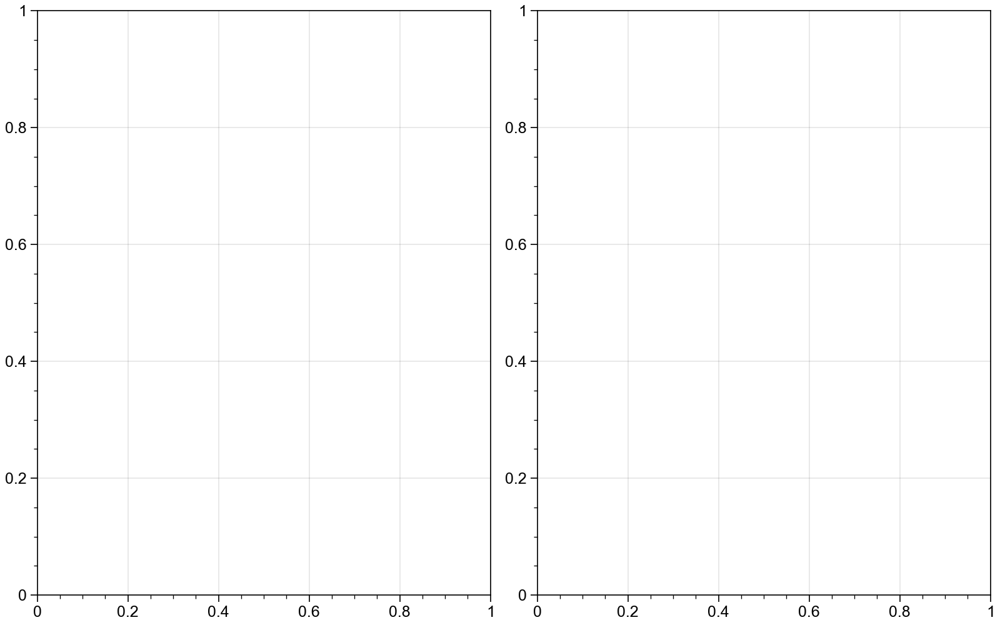

In [13]:
def plot_panArctic8(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90
    
    lat_new = np.where(sit == np.nan, np.nan, lat)
    lon_new = np.where(sit == np.nan, np.nan, lon)

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=75,lon_0=0, resolution='i',ax=ax, round=True)
    m.drawmeridians(np.arange(0,360,30),labels=[0,0,0,0],linewidth=0.5, fontsize=10, dashes=[1,5])
    m.drawparallels(np.arange(-90,90,15),linewidth=0.5, fontsize=10, dashes=[1,5],labels=[0,0,0,0])
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='lightgray')
    #m.fillcontinents(color='darkgray')
    m.drawmapboundary(fill_color='white')
    #cbar = m.etopo()
    x=m.scatter(lon_new, lat_new, latlon=True, c=cmap_set, s=50, zorder=1, marker='.')
     #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x

def plot_panArctic9(lon, lat, sit, min_set, max_set, cmap_set, label, extend_info, ax, fig):
    #fig = plt.figure(figsize=(6,5))
    fig.patch.set_facecolor('white')
    #ax = plt.gca()
    #m = Basemap(projection='ortho',lat_0=90,lon_0=0,resolution='l', ax=ax);
    x1 = -180
    x2 = 180
    y1 = 0
    y2 = 90
    cmap1 = plt.get_cmap('greys', 4)

    m = Basemap(projection='npstere', llcrnrlat=y1,urcrnrlat=y2,llcrnrlon=x1,urcrnrlon=x2,boundinglat=75,lon_0=0, resolution='i',ax=ax, round=True)
    m.drawmeridians(np.arange(0,360,30),labels=[0,0,0,0],linewidth=0.5, fontsize=10, dashes=[1,5])
    m.drawparallels(np.arange(-90,90,15),linewidth=0.5, fontsize=10, dashes=[1,5],labels=[0,0,0,0])
    m.drawcoastlines(linewidth=0.5)
    m.fillcontinents(color='lightgray')
    #m.fillcontinents(color='darkgray')
    m.drawmapboundary(fill_color='white')
    #cbar = m.etopo()
    x=m.scatter(lon, lat, latlon=True, c=sit, s=5,vmin = min_set, vmax=max_set, cmap=cmap_set, zorder=1)
     #cbar = plt.colorbar(x, extend =extend_info, orientation="horizontal",ax=ax)
    #cbar.set_label(label)

    ax.set_title(title, y=1.08,fontsize=18)
    return x

from matplotlib.lines import Line2D
fig, ax = plt.subplots(ncols=2, figsize=(8,5), constrained_layout=True)
title = ''
#im = plot_panArctic8(lon, lat, missing_snow_depth, 0, 50, 'red', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, land_snow_depth, 0, 50, 'brown', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, OW_snow_depth, 0, 50, 'blue', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, MYI_snow_depth, 0, 50, 'grey', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, variability_snow_depth, 0, 50, 'magenta', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, melt_snow_depth, 0, 50, 'orange', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic6(lon, lat, snow_depth_only, 0, 50, 'summer', 'radar freeboard (m)','max', ax[0],fig)

plt.colorbar(im, ax=ax[0],orientation = 'horizontal', label='snow depth (cm)', extend='max')

im = plot_panArctic6(lon, lat, sea_ice_concentration_only, 0, 100, 'blues', 'radar freeboard (m)','max', ax[1],fig)

plt.colorbar(im, ax=ax[1],orientation = 'horizontal', label='sea ice concentration (%)')

im = plot_panArctic6(np.array(df3['lon']), np.array(df3['lat']), 'grey', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax[0],fig)
im = plot_panArctic6(np.array(df3['lon'][500:1350]), np.array(df3['lat'][500:1350]), 'white', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax[0],fig)
im = plot_panArctic7(np.array(df3['lon'][500]), np.array(df3['lat'][500]), 'purple', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax[0],fig)
im = plot_panArctic7(np.array(df3['lon'][1350]), np.array(df3['lat'][1350]), 'orange', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax[0],fig)


im = plot_panArctic6(np.array(df3['lon']), np.array(df3['lat']), 'grey', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax[1],fig)
im = plot_panArctic6(np.array(df3['lon'][500:1350]), np.array(df3['lat'][500:1350]), 'white', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax[1],fig)
im = plot_panArctic7(np.array(df3['lon'][500]), np.array(df3['lat'][500]), 'purple', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax[1],fig)
im = plot_panArctic7(np.array(df3['lon'][1350]), np.array(df3['lat'][1350]), 'orange', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax[1],fig)

plt.savefig('E:\CRYO2ICE_AMSR2_comparison.png', transparent=True)

In [731]:
def CRYO2ICE_AMSR2_NN(df3_short,df_AMSR2):
    from sklearn.neighbors import BallTree
    import numpy as np
    import pandas as pd

    ## Only data within 825 m of CryoSat-2 footprint (find approximate area of coincident data)
    query_lats = df3_short[['lat']].to_numpy()
    query_lons = df3_short[['lon']].to_numpy()

    tree = BallTree(np.deg2rad(df_AMSR2[['lat', 'lon']].values), leaf_size =15, metric='haversine')

    distances, indices = tree.query(np.deg2rad(np.c_[query_lats, query_lons]), k=1)
    
    data_check = df3_short
    NN_SIC, NN_SD= [], []
    for i in indices:
        NN_SIC = np.append(NN_SIC, df_AMSR2['sea_ice_concentration'][int(i)])
        NN_SD = np.append(NN_SD, df_AMSR2['snow_depth'][int(i)])

    data_check['AMSR2_SIC'] = NN_SIC
    data_check['AMSR2_snow_depth'] = NN_SD
    
    return data_check


In [732]:
df_AMSR2 = pd.DataFrame({'lat':lat.flatten(), 'lon':lon.flatten(), 'snow_depth':snow_depth_only.flatten(), 'sea_ice_concentration':sea_ice_concentration_only.flatten()})

df3_short = CRYO2ICE_AMSR2_NN(df3_short,df_AMSR2)

NameError: name 'df3_short' is not defined

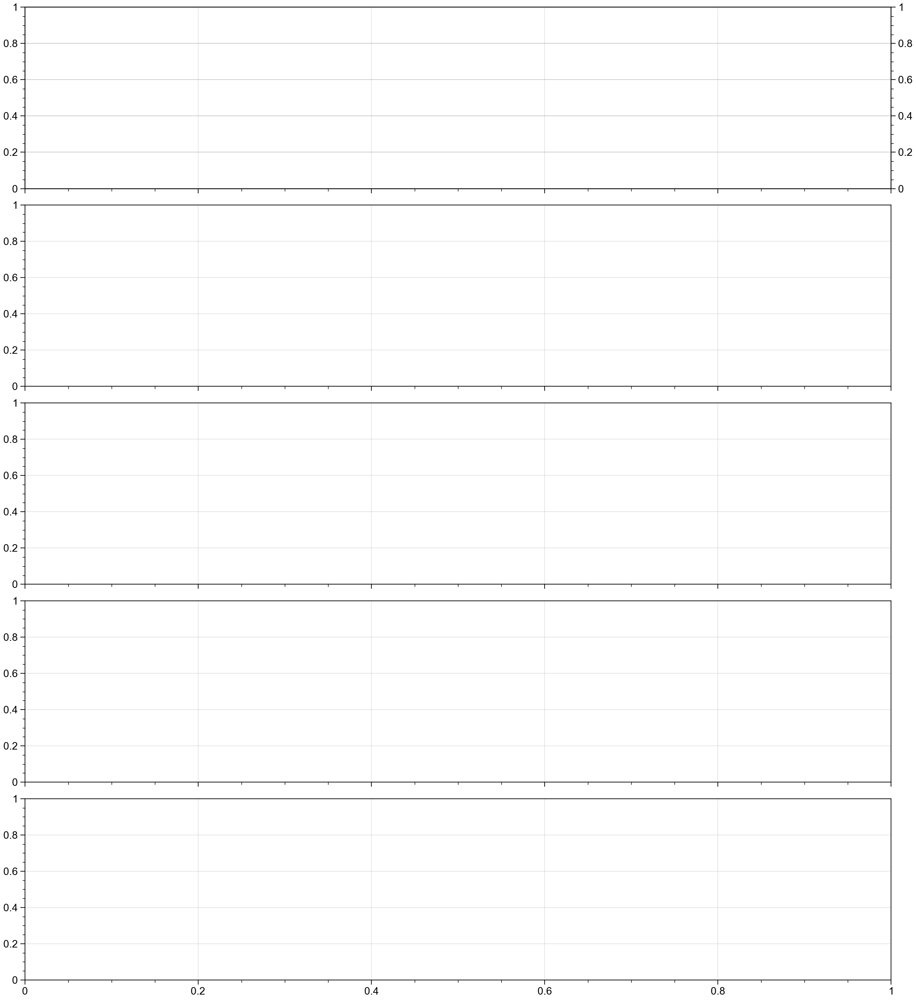

In [33]:
fig, axs = plt.subplots(5, figsize=(11,12), constrained_layout=True, sharex=True)
#axs[0].plot(df_IS2_new['lat'], df_IS2_new['fb'], c='grey', ls='', marker='.', markersize=0.8)

ax2 = axs[0].twinx()
axs[0].plot(df3_short['lat'], df3_short['CS2_fb_DTU21MSS'] ,'o', c='k', markersize=2, ls='--', lw=0.5)
axs[0].plot(df3_short['lat'],df3_short['IS2_w_fb_DTU21MSS'], 'o',c='red', markersize=2, ls='--', lw=0.5)
axs[0].vlines(df_CS2_lead_check[df_CS2_lead_check['lead_CS2']>0]['lat'], -0.5, 1,ls='-', color='grey', linewidth=0.2, label='_nolegend_')
ax2.plot(df3_short['lat'],df3_short['AMSR2_SIC'], c='navy', ls='-')
ax2.set_ylabel('sea ice concentration (%)', color='navy')
ax2.grid(ls='-.')

axs[1].plot(df3_short['lat'],df3_short['snow_depth_DTU21MSS'] , c='k',ls='-', linewidth=0.5)
axs[1].plot(df3_short[(df3_short['ppk']<9) & (df3_short['ssd']>6.29)]['lat'],df3_short[(df3_short['ppk']<9) & (df3_short['ssd']>6.29)]['snow_depth_DTU21MSS'] , 'o', c='red', markersize=2)
axs[1].plot(df3_short['lat'],(df3_short['AMSR2_snow_depth'])/100 ,'o', c='navy',markersize=2)
#axs[1].plot(df3_short['lead_CS2'], 'o')


axs[2].plot(df3_short['lat'], df3_short['IS2_mean_gw'], c='k',ls='-', linewidth=0.5)
axs[2].text(0.92, 0.9, 'p = 0.30', c='red',fontsize=10, transform = axs[2].transAxes)
axs[2].text(0.92, 0.82, 'p = 0.11', c='k', fontsize=10, transform = axs[2].transAxes)

axs[3].plot(df3_short['lat'], df3_short['ssd'], c='k',ls='-', linewidth=0.5)
axs[3].axhline(y=4, c='green',ls='--', linewidth=1)
axs[3].axhline(y=6.29, c='r',ls='--', linewidth=1)
axs[3].text(86, 15, 'Tilling et al. (2018) threshold', color='cyan')
axs[3].text(86, 10, 'Ricker et al. (2014) threshold', color='green')
axs[3].text(0.92, 0.9, 'p = 0.23', c='orange',fontsize=10, transform = axs[3].transAxes)
axs[3].text(0.92, 0.82, 'p = 0.32', c='k', fontsize=10, transform = axs[3].transAxes)

axs[4].plot(df3_short['lat'], df3_short['ppk'], c='k',ls='-', linewidth=0.5)
axs[4].axhspan(0,9, facecolor='red', alpha=0.5)
#axs[0].set_ylim([-0.3, 1.5])
#axs[0].set_xlim([float(data_check['lat'].head(1)), float(data_check['lat'].tail(1))])
axs[4].text(0.92, 0.9, 'p = -0.15', c='red',fontsize=10, transform = axs[4].transAxes)
axs[4].text(0.92, 0.82, 'p = -0.30', c='k', fontsize=10, transform = axs[4].transAxes)

axs[0].set_ylabel('freeboards (m)')
axs[1].set_ylabel('snow depth (m)')
axs[2].set_ylabel('IS2 gaussian-width (m)')
axs[3].set_ylabel('CS2 stack standard deviation')
axs[4].set_ylabel('CS2 pulse peakiness')

legend=axs[0].legend(['CS2 freeboard', 'IS2 weighted freeboard'], loc='lower left', scatterpoints=3)
legend.legendHandles[0]._legmarker.set_markersize(5)
legend.legendHandles[1]._legmarker.set_markersize(5)
#axs[0].set_xlim([77, 78])

legend=axs[1].legend([r'CRYO2ICE along-track snow depth: N = 850, $\mu$ = 17.41 cm, $\sigma$ = 15.60 cm', r'snow depth with applied thresholds: N = 291, $\mu$ = 14.77 cm, $\sigma$ = 14.42 cm', 'AMSR2 snow depth'], loc='lower left', scatterpoints=3)
axs[0].set_ylim(df3_short['CS2_fb_DTU21MSS'].min()-0.1, df3_short['IS2_w_fb_DTU21MSS'].max()+0.1)
axs[0].set_xlim(87.5, 82.5)
axs[4].set_xlabel('latitude (degrees N)')

axs[0].text(0.02, 0.9, '(a)', transform = axs[0].transAxes, fontsize=10)
axs[1].text(0.02, 0.9, '(b)', transform = axs[1].transAxes, fontsize=10)
axs[2].text(0.02, 0.9, '(c)', transform = axs[2].transAxes, fontsize=10)
axs[3].text(0.02, 0.9, '(d)', transform = axs[3].transAxes, fontsize=10)
axs[4].text(0.02, 0.9, '(e)', transform = axs[4].transAxes, fontsize=10)
plt.savefig('E:\demo_CRYO2ICE_roughness_including_leads.png', transparent=True)



Text(0.5, -1.9885555555555694, 'point along track')

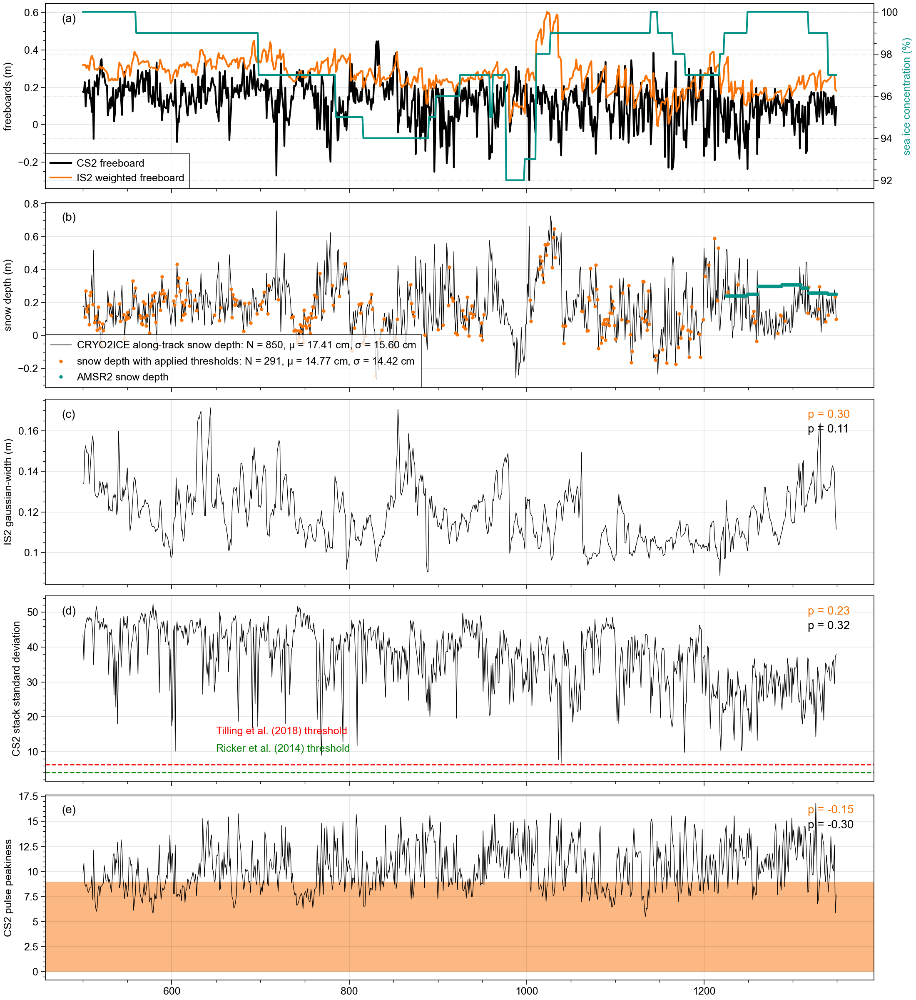

In [592]:
fig, axs = plt.subplots(5, figsize=(11,12), constrained_layout=True, sharex=True)
#axs[0].plot(df_IS2_new['lat'], df_IS2_new['fb'], c='grey', ls='', marker='.', markersize=0.8)
ax2 = axs[0].twinx()
axs[0].plot(df3_short['CS2_fb_DTU21MSS'] , c='k', ls='-')
axs[0].plot(df3_short['IS2_w_fb_DTU21MSS'], c='orange', ls='-')
ax2.plot(df3_short['AMSR2_SIC'], c='teal', ls='-')
ax2.set_ylabel('sea ice concentration (%)', color='teal')
ax2.grid(ls='-.')

axs[1].plot(df3_short['snow_depth_DTU21MSS'] , c='k',ls='-', linewidth=0.5)
axs[1].plot(df3_short[(df3_short['ppk']<9) & (df3_short['ssd']>6.29)]['snow_depth_DTU21MSS'] , 'o', c='orange', markersize=2)
axs[1].plot(df3_short['AMSR2_snow_depth']/100 ,'o', c='teal',markersize=2)

axs[2].plot(df3_short['IS2_mean_gw'], c='k',ls='-', linewidth=0.5)
axs[2].text(0.92, 0.9, 'p = 0.30', c='orange',fontsize=10, transform = axs[2].transAxes)
axs[2].text(0.92, 0.82, 'p = 0.11', c='k', fontsize=10, transform = axs[2].transAxes)

axs[3].plot(df3_short['ssd'], c='k',ls='-', linewidth=0.5)
axs[3].axhline(y=4, c='green',ls='--', linewidth=1)
axs[3].axhline(y=6.29, c='r',ls='--', linewidth=1)
axs[3].text(650, 15, 'Tilling et al. (2018) threshold', color='r')
axs[3].text(650, 10, 'Ricker et al. (2014) threshold', color='green')
axs[3].text(0.92, 0.9, 'p = 0.23', c='orange',fontsize=10, transform = axs[3].transAxes)
axs[3].text(0.92, 0.82, 'p = 0.32', c='k', fontsize=10, transform = axs[3].transAxes)

axs[4].plot(df3_short['ppk'], c='k',ls='-', linewidth=0.5)
axs[4].axhspan(0,9, facecolor='orange', alpha=0.5)
#axs[0].set_ylim([-0.3, 1.5])
#axs[0].set_xlim([float(data_check['lat'].head(1)), float(data_check['lat'].tail(1))])
axs[4].text(0.92, 0.9, 'p = -0.15', c='orange',fontsize=10, transform = axs[4].transAxes)
axs[4].text(0.92, 0.82, 'p = -0.30', c='k', fontsize=10, transform = axs[4].transAxes)

axs[0].set_ylabel('freeboards (m)')
axs[1].set_ylabel('snow depth (m)')
axs[2].set_ylabel('IS2 gaussian-width (m)')
axs[3].set_ylabel('CS2 stack standard deviation')
axs[4].set_ylabel('CS2 pulse peakiness')

legend=axs[0].legend(['CS2 freeboard', 'IS2 weighted freeboard'], loc='lower left', scatterpoints=3)
legend.legendHandles[0]._legmarker.set_markersize(5)
legend.legendHandles[1]._legmarker.set_markersize(5)
#axs[0].set_xlim([77, 78])

legend=axs[1].legend([r'CRYO2ICE along-track snow depth: N = 850, $\mu$ = 17.41 cm, $\sigma$ = 15.60 cm', r'snow depth with applied thresholds: N = 291, $\mu$ = 14.77 cm, $\sigma$ = 14.42 cm', 'AMSR2 snow depth'], loc='lower left', scatterpoints=3)


axs[0].text(0.02, 0.9, '(a)', transform = axs[0].transAxes, fontsize=10)
axs[1].text(0.02, 0.9, '(b)', transform = axs[1].transAxes, fontsize=10)
axs[2].text(0.02, 0.9, '(c)', transform = axs[2].transAxes, fontsize=10)
axs[3].text(0.02, 0.9, '(d)', transform = axs[3].transAxes, fontsize=10)
axs[4].text(0.02, 0.9, '(e)', transform = axs[4].transAxes, fontsize=10)
plt.savefig('E:\demo_CRYO2ICE_roughness_including_leads.png', transparent=True)

axs[4].set_xlabel('point along track')

In [593]:
df3_short.corr()

,Unnamed: 0,index,lat,lon,fb,mss,fb_no_mss,ssd,ppk,IS2_mean_fb,IS2_w_mean_fb,IS2_mean_gw,IS2_mean_MSS,MSS_DTU21,snow_depth_DTU21MSS,CS2_fb_DTU21MSS,IS2_fb_DTU21MSS,IS2_w_fb_DTU21MSS,AMSR2_SIC,AMSR2_snow_depth
Unnamed: 0,1.000000,1.000000,-0.978171,0.272833,-0.257701,-0.983456,0.983394,-0.521193,0.241116,0.984702,0.984693,-0.289917,-0.984847,-0.984525,-0.066542,-0.303608,-0.477187,-0.475576,0.061996,0.221755
index,1.000000,1.000000,-0.978171,0.272833,-0.257701,-0.983456,0.983394,-0.521193,0.241116,0.984702,0.984693,-0.289917,-0.984847,-0.984525,-0.066542,-0.303608,-0.477187,-0.475576,0.061996,0.221755
lat,-0.978171,-0.978171,1.000000,-0.180435,0.270895,0.989511,-0.988944,0.528867,-0.223416,-0.989928,-0.989926,0.244445,0.989676,0.989408,0.072914,0.291430,0.470817,0.469010,-0.210687,-0.267529
lon,0.272833,0.272833,-0.180435,1.000000,-0.014090,-0.192040,0.193601,-0.098938,0.092090,0.197536,0.197517,-0.217802,-0.196246,-0.194847,0.053431,-0.080886,-0.026615,-0.026720,-0.273506,-0.294006
fb,-0.257701,-0.257701,0.270895,-0.014090,1.000000,0.280581,-0.240336,0.332995,-0.313278,-0.280921,-0.280886,0.067840,0.280996,0.280417,-0.712325,0.895719,0.124324,0.124692,-0.046402,0.136940
mss,-0.983456,-0.983456,0.989511,-0.192040,0.280581,1.000000,-0.999131,0.529787,-0.246502,-0.999384,-0.999381,0.230604,0.999713,0.999771,0.087085,0.297947,0.499060,0.497267,-0.126377,-0.480236
fb_no_mss,0.983394,0.983394,-0.988944,0.193601,-0.240336,-0.999131,1.000000,-0.521323,0.235689,0.998493,0.998492,-0.230268,-0.998823,-0.998906,-0.118998,-0.262427,-0.499308,-0.497479,0.125792,0.480689
ssd,-0.521193,-0.521193,0.528867,-0.098938,0.332995,0.529787,-0.521323,1.000000,-0.690842,-0.530738,-0.530692,0.091524,0.531606,0.529427,-0.122548,0.315835,0.225521,0.225709,-0.061597,0.204698
ppk,0.241116,0.241116,-0.223416,0.092090,-0.313278,-0.246502,0.235689,-0.690842,1.000000,0.245761,0.245673,0.060237,-0.247240,-0.246959,0.160622,-0.299761,-0.151453,-0.153225,-0.115107,0.132192
IS2_mean_fb,0.984702,0.984702,-0.989928,0.197536,-0.280921,-0.999384,0.998493,-0.530738,0.245761,1.000000,0.999999,-0.225062,-0.999826,-0.999429,-0.064337,-0.303873,-0.474408,-0.472550,0.130179,0.441604


In [595]:
df3_short['lat'].max()

87.2729135

In [596]:
df3_short['lon'].min()

-179.9749036

In [597]:
df3_short['lon'].max()

179.9864862

In [601]:
df3_ex_short = df3[1200:1350]

In [741]:
print(df3_short['lat'].min())
print(df3_short['lat'].max())
print(df3_short['lon'].min())
print(df3_short['lon'].max())

82.6337691
87.2729135
-179.9749036
179.9864862


In [742]:
fp1 = r'E:\DTU\CRYO2ICE\Data\CS_OFFL_SIR_SAR_2__20201110T090903_20201110T091432_D001.nc'
ds = netCDF4.Dataset(fp1, 'r')
CS2_lead = ds.variables['height_sea_ice_lead_20_ku'][:]
lat_lead = ds.variables['lat_poca_20_ku'][:]
lon_lead = ds.variables['lon_poca_20_ku'][:]
df_CS2_lead = pd.DataFrame({'lead_CS2':CS2_lead, 'lat':lat_lead, 'lon':lon_lead})

In [750]:
df_CS2_lead_check = df_CS2_lead[(df_CS2_lead['lat']>82.6334) & (df_CS2_lead['lon']>0)]

In [749]:
lat_lead[(lat_lead<87.27) & (lat_lead>82.63) & (lon_lead>0) & (lat_lead<179.98)]

masked_array(data=[87.1506656, 87.1487408, 87.1468147, ..., 82.6363763,
                   82.6337691, 82.6311619],
             mask=False,
       fill_value=1e+20)

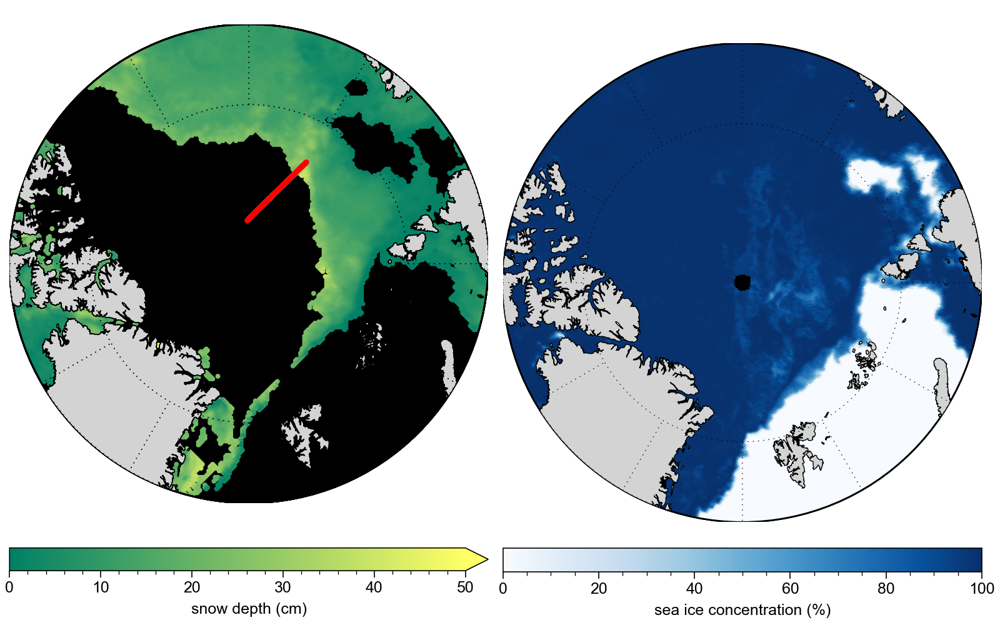

In [751]:
from matplotlib.lines import Line2D
fig, ax = plt.subplots(ncols=2, figsize=(8,5), constrained_layout=True)
title = ''
#im = plot_panArctic8(lon, lat, missing_snow_depth, 0, 50, 'red', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, land_snow_depth, 0, 50, 'brown', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, OW_snow_depth, 0, 50, 'blue', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, MYI_snow_depth, 0, 50, 'grey', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, variability_snow_depth, 0, 50, 'magenta', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic8(lon, lat, melt_snow_depth, 0, 50, 'orange', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic6(lon, lat, snow_depth_only, 0, 50, 'summer', 'radar freeboard (m)','max', ax[0],fig)

plt.colorbar(im, ax=ax[0],orientation = 'horizontal', label='snow depth (cm)', extend='max')

im = plot_panArctic6(lon, lat, sea_ice_concentration_only, 0, 100, 'blues', 'radar freeboard (m)','max', ax[1],fig)

plt.colorbar(im, ax=ax[1],orientation = 'horizontal', label='sea ice concentration (%)')

im = plot_panArctic6(np.array(df_CS2_lead_check['lon']), np.array(df_CS2_lead_check['lat']), 'grey', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax[0],fig)
im = plot_panArctic6(np.array(df3_short['lon']), np.array(df3_short['lat']), 'r', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax[0],fig)

plt.savefig('E:\CRYO2ICE_AMSR2_comparison.png', transparent=True)

In [748]:
df3_short

,Unnamed: 0,index,lat,lon,fb,mss,fb_no_mss,ssd,ppk,IS2_mean_fb,IS2_w_mean_fb,IS2_mean_gw,IS2_mean_MSS,MSS_DTU21,snow_depth_DTU21MSS,CS2_fb_DTU21MSS,IS2_fb_DTU21MSS,IS2_w_fb_DTU21MSS,AMSR2_SIC,AMSR2_snow_depth
500,1132,1132,87.272914,-177.392851,0.112,10.226,-10.114,43.51,9.829070,-10.686173,-10.684946,0.133824,11.026772,11.004,0.174907,0.176,0.317827,0.319054,100.0,NaN
501,1133,1133,87.271077,-177.434924,0.110,10.226,-10.116,36.20,10.809118,-10.683542,-10.682701,0.134430,11.026330,11.003,0.180617,0.173,0.319458,0.320299,100.0,NaN
502,1134,1134,87.263718,-177.602653,0.170,10.226,-10.056,44.53,8.800973,-10.678559,-10.678948,0.150106,11.024527,10.998,0.112768,0.228,0.319441,0.319052,100.0,NaN
503,1135,1135,87.261875,-177.644445,0.038,10.226,-10.188,46.30,8.526113,-10.682189,-10.681329,0.152636,11.024064,11.000,0.271079,0.098,0.317811,0.318671,100.0,NaN
504,1136,1136,87.260030,-177.686181,0.112,10.226,-10.114,47.70,8.690694,-10.695280,-10.693510,0.149472,11.023635,10.995,0.163676,0.167,0.299720,0.301490,100.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1345,1986,1986,82.680687,150.731761,0.069,2.844,-2.775,35.73,10.330610,-3.367820,-3.366369,0.142758,3.616321,3.635,0.149444,0.146,0.267180,0.268631,97.0,25.0
1346,1987,1987,82.678081,150.725730,0.079,2.844,-2.765,36.36,10.078774,-3.372340,-3.370322,0.141074,3.614883,3.635,0.131537,0.156,0.262660,0.264678,97.0,25.0
1347,1988,1988,82.675475,150.719702,-0.040,2.844,-2.884,29.48,12.666302,-3.372945,-3.372364,0.139398,3.613375,3.639,0.277546,0.041,0.266055,0.266636,97.0,25.0
1348,1989,1989,82.636376,150.629788,-0.086,2.811,-2.897,37.20,5.854033,-3.419983,-3.419873,0.119826,3.590854,3.608,0.235569,-0.003,0.188017,0.188127,97.0,25.0


# Semivariogram analysis

In [78]:
## November
fpa = r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_data\IS2\Monthly_data\November\ATL10-01_20201110055822_07190901_005_02_gt1l_no_mss_corr.h5'
fpb = r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_data\IS2\Monthly_data\November\ATL10-01_20201110055822_07190901_005_02_gt2l_no_mss_corr.h5'
fpc = r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_data\IS2\Monthly_data\November\ATL10-01_20201110055822_07190901_005_02_gt3l_no_mss_corr.h5'


fp2 = r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_data\CS2\L1b\CS_OFFL_SIR_SAR_1B_20201110T090903_20201110T091432_D001.nc'
fp1 =r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_data\CS2\L2\CS_OFFL_SIR_SAR_2__20201110T090903_20201110T091432_D001.nc'


### January
#fpa = r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_data\IS2\Monthly_data\January\ATL10-01_20210130103743_05721001_005_01_gt1l_no_mss_corr.h5'
#fpb = r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_data\IS2\Monthly_data\January\ATL10-01_20210130103743_05721001_005_01_gt2l_no_mss_corr.h5'
#fpc = r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_data\IS2\Monthly_data\January\ATL10-01_20210130103743_05721001_005_01_gt3l_no_mss_corr.h5'


#fp2 = r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_data\CS2\Monthly_data\L1b\January\CS_OFFL_SIR_SAR_1B_20210130T133202_20210130T134203_D001.nc'
#fp1 =r'E:\DTU\CRYO2ICE\Data\CRYO2ICE_data\CS2\Monthly_data\L2\January\CS_OFFL_SIR_SAR_2__20210130T133202_20210130T134203_D001.nc'

def run_IS2_CS2_one_track_CRYO2ICE(fpa, fpb, fpc, fp1, fp2):
    
    lon_gt2l, lat_gt2l,fb_gt2l, gw_gt2l, fb_mss, mss = read_h5(fpa, ['lon_fb', 'lat_fb', 'fb', 'gw', 'fb_with_mss', 'mss'])
    gw_gt2l[fb_gt2l>5] = np.nan
    fb_gt2l[fb_gt2l>5] = np.nan
    df_IS2a = pd.DataFrame({'lat':lat_gt2l, 'lon':lon_gt2l, 'fb':fb_gt2l, 'gw':gw_gt2l, 'fb_with_mss':fb_mss, 'mss_IS2':mss})
    df_IS2a['beam_ID']=1

    lon_gt2l, lat_gt2l,fb_gt2l, gw_gt2l, fb_mss, mss = read_h5(fpb, ['lon_fb', 'lat_fb', 'fb', 'gw', 'fb_with_mss', 'mss'])
    gw_gt2l[fb_gt2l>5] = np.nan
    fb_gt2l[fb_gt2l>5] = np.nan
    df_IS2b = pd.DataFrame({'lat':lat_gt2l, 'lon':lon_gt2l, 'fb':fb_gt2l, 'gw':gw_gt2l, 'fb_with_mss':fb_mss, 'mss_IS2':mss})
    df_IS2b['beam_ID']=2

    lon_gt2l, lat_gt2l,fb_gt2l, gw_gt2l, fb_mss, mss = read_h5(fpc, ['lon_fb', 'lat_fb', 'fb', 'gw', 'fb_with_mss', 'mss'])
    gw_gt2l[fb_gt2l>5] = np.nan
    fb_gt2l[fb_gt2l>5] = np.nan
    df_IS2c = pd.DataFrame({'lat':lat_gt2l, 'lon':lon_gt2l, 'fb':fb_gt2l, 'gw':gw_gt2l, 'fb_with_mss':fb_mss, 'mss_IS2':mss})
    df_IS2c['beam_ID']=3

    frames = [df_IS2a, df_IS2b, df_IS2c]
    df_IS2 = pd.concat(frames)
    df_IS2 = df_IS2.dropna().reset_index()
    
    lon, lat,fb, mss, ssd, ppk= load_data(fp1, fp2)
    df_CS2 = pd.DataFrame({'lat':lat, 'lon':lon, 'fb':fb, 'mss':mss, 'fb_no_mss':fb-mss, 'ssd':ssd, 'ppk':ppk})
    df_CS2 = df_CS2[(df_CS2['lat']>60)].reset_index()
    
    return df_IS2, df_CS2

In [79]:
df_IS2_semi, df_CS2_semi = run_IS2_CS2_one_track_CRYO2ICE(fpa, fpb, fpc, fp1, fp2)

In [83]:
df_IS2_semi = identify_DTU21MSS_along_CRYO2ICE_track(df_IS2_semi, df_grid_DTU21)

In [84]:
df_IS2_semi

,index,lat,lon,fb,gw,fb_with_mss,mss_IS2,beam_ID,MSS_DTU21
0,8263,82.601575,-59.999958,-18.080372,0.314,0.648919,18.729290,1,18.721001
1,8264,82.601613,-60.000044,-18.285681,0.287,0.443680,18.729361,1,18.721001
2,8265,82.601654,-60.000138,-18.436371,0.160,0.293144,18.729515,1,18.721001
3,8266,82.601704,-60.000251,-18.497082,0.193,0.232519,18.729601,1,18.721001
4,8267,82.601760,-60.000379,-18.587709,0.163,0.141917,18.729626,1,18.721001
...,...,...,...,...,...,...,...,...,...
574263,239625,76.520146,142.642618,-1.571665,0.081,0.025512,1.597177,3,1.612000
574264,239626,76.520061,142.642557,-1.564278,0.090,0.032770,1.597048,3,1.612000
574265,239627,76.519952,142.642479,-1.557707,0.120,0.039217,1.596924,3,1.612000
574266,239628,76.519868,142.642419,-1.577042,0.113,0.019757,1.596799,3,1.612000


In [88]:
df_IS2_semi.to_csv("E:\IS2_ATL10-01_20201110055822_07190901_005_02_DTU21MSS.csv", header=True)

In [2]:
df_IS2_semi = pd.read_csv("E:\IS2_ATL10-01_20201110055822_07190901_005_02_DTU21MSS.csv")

coordinates = np.array(df_IS2_semi['lon'], df_IS2_semi['lat'])
values = df_IS2_semi['fb_with_mss']-df_IS2_semi['mss_IS2']+df_IS2_semi['MSS_DTU21']

In [3]:
def WGS84_to_polarstereo(IS2_ref): 
    import pyproj
    # Output coordinates are in WGS 84 longitude and latitude
    projIn= pyproj.Proj(init='epsg:4326')

    # Input coordinates are in meters on the Polar Stereographic 
    # projection given in the netCDF file
    projOut = pyproj.Proj('+proj=stere +lat_0=90 +lat_ts=70 +lon_0=-45 +k=1 +x_0=0 +y_0=0 +datum=WGS84 +units=m +no_defs ',preserve_units=True)
    X, Y = pyproj.transform(projIn, projOut, (np.float64(IS2_ref['lon'])), (np.float64(IS2_ref['lat'])))
    IS2_ref['X'] = X
    IS2_ref['Y'] = Y
    IS2_ref = IS2_ref.reset_index()
    
    return IS2_ref


df_IS2_semi = WGS84_to_polarstereo(df_IS2_semi)

C:\Users\rmfha\Anaconda3\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\rmfha\AppData\Local\Temp/ipykernel_32160/3987027593.py:9: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  X, Y = pyproj.transform(projIn, projOut, (np.float64(IS2_ref['lon'])), (np.float64(IS2_ref['lat'])))


In [4]:
df_IS2_semi_beam1 = df_IS2_semi[df_IS2_semi['beam_ID']==1]
df_IS2_semi_beam2 = df_IS2_semi[df_IS2_semi['beam_ID']==2]
df_IS2_semi_beam3 = df_IS2_semi[df_IS2_semi['beam_ID']==3]

In [12]:
np.shape(df_IS2_semi_beam3)

(183296, 13)

In [78]:
n1, n2 = 0000, 5000
coordinates = np.array(df_IS2_semi_beam1['X'][n1:n2], df_IS2_semi_beam1['Y'][n1:n2])
values = df_IS2_semi_beam1['fb_with_mss'][n1:n2]-df_IS2_semi_beam1['mss_IS2'][n1:n2]+df_IS2_semi_beam1['MSS_DTU21'][n1:n2]

coordinates = np.append(np.array(df_IS2_semi_beam2['X'][n1:n2], df_IS2_semi_beam2['Y'][n1:n2]),coordinates)
values = np.append(df_IS2_semi_beam2['fb_with_mss'][n1:n2]-df_IS2_semi_beam2['mss_IS2'][n1:n2]+df_IS2_semi_beam2['MSS_DTU21'][n1:n2], values)

coordinates = np.append(np.array(df_IS2_semi_beam3['X'][n1:n2], df_IS2_semi_beam3['Y'][n1:n2]),coordinates)
values = np.append(df_IS2_semi_beam3['fb_with_mss'][n1:n2]-df_IS2_semi_beam3['mss_IS2'][n1:n2]+df_IS2_semi_beam3['MSS_DTU21'][n1:n2], values)

spherical Variogram
-------------------
Estimator:         matheron
Effective Range:   265.70
Sill:              0.09
Nugget:            0.00
        


C:\Users\rmfha\Anaconda3\lib\site-packages\skgstat\plotting\variogram_plot.py:123: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


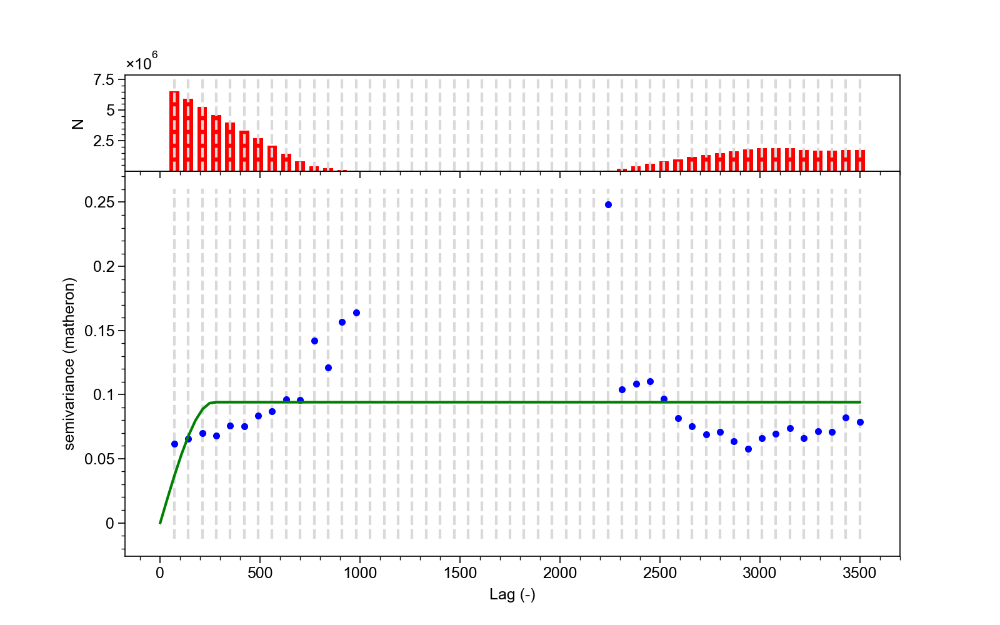

In [79]:
import numpy as np
import skgstat as skg


V=[] 
V = skg.Variogram(coordinates=coordinates, values=values,n_lags=50,model='spherical', maxlag=3500)
print(V)
V.plot()
plt.show()

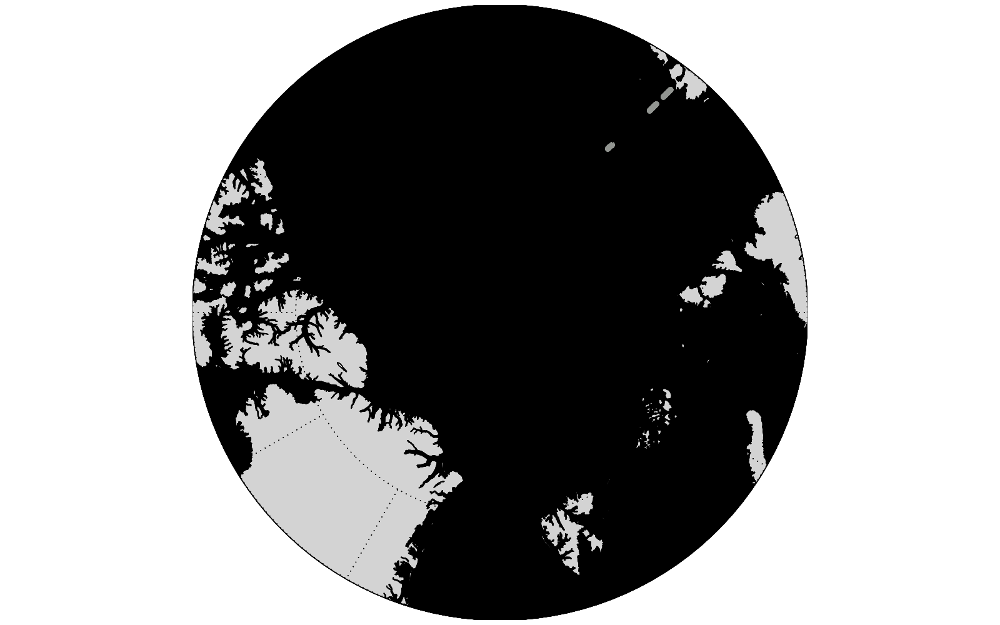

In [52]:
from matplotlib.lines import Line2D
fig, ax = plt.subplots(figsize=(8,5), constrained_layout=True)
title = ''
im = plot_panArctic6(np.array(df_IS2_semi_beam1['lon'][n1:n2]), np.array(df_IS2_semi_beam1['lat'][n1:n2]), 'grey', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic6(np.array(df_IS2_semi_beam2['lon'][n1:n2]), np.array(df_IS2_semi_beam2['lat'][n1:n2]), 'grey', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
im = plot_panArctic6(np.array(df_IS2_semi_beam3['lon'][n1:n2]), np.array(df_IS2_semi_beam3['lat'][n1:n2]), 'grey', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)


#im = plot_panArctic6(np.array(df3['lon'][500:1350]), np.array(df3['lat'][500:1350]), 'white', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic7(np.array(df3['lon'][500]), np.array(df3['lat'][500]), 'purple', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
#im = plot_panArctic7(np.array(df3['lon'][1350]), np.array(df3['lat'][1350]), 'orange', 0, 0.4, 'viridis', 'radar freeboard (m)','max', ax,fig)
